In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import glob
import numpy as np
import os
import sys
plt.rcParams.update({'font.size': 14})


from subprocess import Popen, PIPE

import logging


In [2]:
from scipy.optimize import curve_fit

try:
    import seaborn as sns
    sns.set_style("ticks") 
    #sns.set_style({"axes.axisbelow": False})
    sns.set_style({"xtick.direction": "in" ,"ytick.direction": "in"})
except:
    print("sns problem")



In [4]:
import visa


In [14]:
def flare_func_w_const(ts, amp, tpeak, trise, tdecay, const):
    #negative peak
    rise_slice = np.where(ts<=tpeak)
    decay_slice = np.where(ts>tpeak)
    fs = np.zeros_like(ts).astype('float')
    fs[rise_slice] = const-amp*np.exp((ts[rise_slice]-tpeak)/trise)
    fs[decay_slice] = const-amp*np.exp(-(ts[decay_slice]-tpeak)/tdecay)
    return fs

def chisq(y_vals, y_expected, y_errs, num_params=1):
    #returns chi2, dof, red_chi2
    #  for reduced chisq test, under the assumption of Poisson counting
    #  we have lnL = const - (1/2.)*chi2
    if y_vals.shape[0] != y_expected.shape[0]:
        print("Inconsistent input sizes")
        return
    #z = (y_vals[i] - y_expected[i]) / y_errs[i]    
    z = (y_vals - y_expected) / y_errs
    chi2 = np.sum(z ** 2)
    chi2dof = chi2 / (y_vals.shape[0] - num_params)
    return chi2, (y_vals.shape[0] - num_params), chi2dof

def FWHM(X,Y, negY=True, baseline=0, verbose=True):
        assert len(X)==len(Y)
        factor=1
        if negY:
            factor=-1
        baseline=factor*baseline
        Y=factor*Y-baseline
        #plt.plot(X, Y)
        half_max = max(Y) / 2.
        indices = [x for x in range(len(Y)) if Y[x] > half_max]
        right_idx = max(indices)
        left_idx = min(indices)
        #print(min(indices), max(indices))
        #print(X[right_idx] - X[left_idx])
        #print(half_max)
        if verbose:
            print("FWHM is {}".format(factor*half_max))
        return X[right_idx] - X[left_idx], factor*half_max+factor*baseline, left_idx, right_idx #return the difference (full width)






TEKTRONIX,DPO2014B,C010383,CF:91.1CT FV:v1.52 

Set data acquisition start and stop to
50000
 65000



INFO: 2019-02-07 11:26:00 AM ymult 0.04, yoff 75.5, yzero 0.0
INFO: 2019-02-07 11:26:00 AM ymult 0.04, yoff 75.5, yzero 0.0
INFO: 2019-02-07 11:26:00 AM ymult 0.04, yoff 75.5, yzero 0.0
INFO: 2019-02-07 11:26:00 AM ymult 0.04, yoff 75.5, yzero 0.0
INFO: 2019-02-07 11:26:00 AM ymult 0.04, yoff 75.5, yzero 0.0
INFO: 2019-02-07 11:26:00 AM ymult 0.04, yoff 75.5, yzero 0.0


0.04 75.5 0.0
Clippinng the trace between -10000000.0 and 2e-07
2019-02-07 11:26:00,756 - flasher_log - INFO - ymult 0.04, yoff 75.5, yzero 0.0


INFO: 2019-02-07 11:26:00 AM Clippinng the trace between -10000000.0 and 2e-07
INFO: 2019-02-07 11:26:00 AM Clippinng the trace between -10000000.0 and 2e-07
INFO: 2019-02-07 11:26:00 AM Clippinng the trace between -10000000.0 and 2e-07
INFO: 2019-02-07 11:26:00 AM Clippinng the trace between -10000000.0 and 2e-07
INFO: 2019-02-07 11:26:00 AM Clippinng the trace between -10000000.0 and 2e-07
INFO: 2019-02-07 11:26:00 AM Clippinng the trace between -10000000.0 and 2e-07


2019-02-07 11:26:00,762 - flasher_log - INFO - Clippinng the trace between -10000000.0 and 2e-07


INFO: 2019-02-07 11:26:00 AM saving trace to file testLEDtest_pot3p5k_trace_0.csv
INFO: 2019-02-07 11:26:00 AM saving trace to file testLEDtest_pot3p5k_trace_0.csv
INFO: 2019-02-07 11:26:00 AM saving trace to file testLEDtest_pot3p5k_trace_0.csv
INFO: 2019-02-07 11:26:00 AM saving trace to file testLEDtest_pot3p5k_trace_0.csv
INFO: 2019-02-07 11:26:00 AM saving trace to file testLEDtest_pot3p5k_trace_0.csv
INFO: 2019-02-07 11:26:00 AM saving trace to file testLEDtest_pot3p5k_trace_0.csv


Flare exponential fit param 0 (amplitude) = 0.5769 +/- 0.01225
Flare exponential fit param 1 (tpeak) = 9.801e-08 +/- 9.923e-11
Flare exponential fit param 2 (trise) = 3.824e-09 +/- 1.882e-10
Flare exponential fit param 3 (tdecay) = 5.503e-09 +/- 2.157e-10
Flare exponential fit param 4 (const) = -0.01103 +/- 0.001431
fit Chisq is 0.066, dof is 197, reduced Chisq is 0.00
Log likelihood lnL=-0.03317611728217695
FWHM is -0.25
saving trace to file testLEDtest_pot3p5k_trace_0.csv
2019-02-07 11:26:00,778 - flasher_log - INFO - saving trace to file testLEDtest_pot3p5k_trace_0.csv


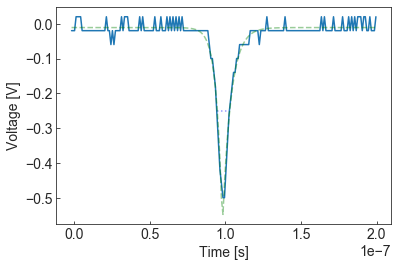

In [254]:
LEDnum="test"

plot_tek_trace(dfname="testLED{}_pot3p5k_trace.csv".format(LEDnum), 
               plot_name="testLED{}_pot3p5k_trace.png".format(LEDnum), 
               width_file="test_flasher_fwhm.csv", 
               data_start=50000, data_stop=65000,
                   tstart=-1e7, tstop=2e-7, initial_params=[0.1, 8.e-8, 1.e-9, 10.e-9, 0.], 
                   pot_setting=3.5e3, onLEDs=[LEDnum], verbose=True, 
                   num_read=1)


In [4]:
def setup_logger(logger_name, log_file, level=logging.INFO, show_log=True):
    log_setup = logging.getLogger(logger_name)
    formatter = logging.Formatter('%(levelname)s: %(asctime)s %(message)s', datefmt='%Y-%m-%d %I:%M:%S %p')
    fileHandler = logging.FileHandler(log_file, mode='a')
    fileHandler.setFormatter(formatter)
    streamHandler = logging.StreamHandler()
    streamHandler.setFormatter(formatter)
    log_setup.setLevel(level)
    log_setup.addHandler(fileHandler)
    log_setup.addHandler(streamHandler)
    if show_log:
        ch = logging.StreamHandler(sys.stdout)
        ch.setLevel(logging.DEBUG)
        formatter = logging.Formatter('%(asctime)s - %(name)s - %(levelname)s - %(message)s')
        ch.setFormatter(formatter)
        log_setup.addHandler(ch)

        
def FWHM(X,Y, negY=True, baseline=0, verbose=True):
        assert len(X)==len(Y)
        factor=1
        if negY:
            factor=-1
        baseline=factor*baseline
        Y=factor*Y-baseline
        #plt.plot(X, Y)
        half_max = max(Y) / 2.
        indices = [x for x in range(len(Y)) if Y[x] > half_max]
        right_idx = max(indices)
        left_idx = min(indices)
        #print(min(indices), max(indices))
        #print(X[right_idx] - X[left_idx])
        #print(half_max)
        if verbose:
            print("FWHM is {}".format(factor*half_max))
        return X[right_idx] - X[left_idx], factor*half_max+factor*baseline, left_idx, right_idx #return the difference (full width)


def plot_tek_trace(tekname='USB0::0x0699::0x039F::C010383::INSTR', scope_resource=None, 
                   dfname="pocket_pulser.csv", plot_name="pocket_pulser.png", width_file="Flasher_fwhm.csv", 
                   log_file="Flasher_characterization.log", 
                   data_start=40000, data_stop=60000,
                   tstart=0, tstop=1e-7, initial_params=[0.1, 8.e-8, 1.e-9, 10.e-9, 0.], 
                   pot_setting=1.55e3, onLEDs=[1],  verbose=True, show=False, 
                   num_read=10):
    ##initial_params: amp, tpeak, trise, tdecay, const
    
    setup_logger("flasher_log", log_file,
                         level=logging.INFO, show_log=verbose)
    logger = logging.getLogger('flasher_log')
    
    # establish comm to scope DPO2014B
    if scope_resource is None:
        rm = visa.ResourceManager()
        #print(rm.list_resources())
        tek = rm.open_resource(tekname)
        print(tek.query('*IDN?'))
        tek.timeout=10000
        tek.write('DATA:ENC ASCI')
        
    tek.write("DATa:STARt {}".format(data_start))
    tek.write("DATa:STOP {}".format(data_stop))
    print("Set data acquisition start and stop to")
    print(tek.query("DATa:STARt?"),tek.query("DATa:STOP?"))  



    
    for i_trace in range(num_read):
        # get the trace
        vs = np.array(tek.query_ascii_values('CURV?'))

        xin = float(tek.query('wfmpre:XIN?'))
        xze = float(tek.query('wfmpre:XZE?'))
        x_start = xze+data_start*xin
        ts = np.arange(x_start, x_start+vs.shape[0]*xin, xin)

        ymult = float(tek.query("wfmpre:ymult?"))
        yoff = float(tek.query("wfmpre:yoff?"))
        yzero = float(tek.query("wfmpre:yzero?"))

        

        vs = (vs - yoff) * ymult  + yzero

        ind = np.where((ts>tstart) & (ts<tstop) )
        if verbose:
            print(ymult, yoff, yzero)
            print("Clippinng the trace between {} and {}".format(tstart, tstop))
        logger.info("ymult {}, yoff {}, yzero {}".format(ymult, yoff, yzero))
        logger.info("Clippinng the trace between {} and {}".format(tstart, tstop))
        #logger.info()
        ts = ts[ind]
        vs = vs[ind]
        #plt.plot(ts[ind], vs[ind])


        # Fit the trace w exponential 
        #params: amp, tpeak, trise, tdecay, const
        parLCL3, covLCL3 = curve_fit(flare_func_w_const, ts,
                                vs, p0=initial_params, 
                                ) #, 
                                #method='trf', ftol=1e-10, loss='soft_l1') #approx abs

        par_names8=['amplitude', 'tpeak', 'trise', 'tdecay', 'const']
        if verbose:
            for i in range(len(par_names8)):
                print("Flare exponential fit param %d (%s) = %.4g +/- %.4g" % (i, par_names8[i], 
                                                                                                parLCL3[i], 
                                                                                                np.sqrt(abs(covLCL3[i,i]))))

        #def chisq(y_vals, y_expected, y_errs, num_params=1):
            #  for reduced chisq test, under the assumption of Poisson counting
            #  we have lnL = const - (1/2.)*chi2
        chi2LC3L1, dof3L1, redchi2LC3L1 = chisq(vs, 
                                          flare_func_w_const(ts, *parLCL3), 
                                          1, 
                                          5)
        lnL_LC3L1 = -0.5*chi2LC3L1
        if verbose:
            print("fit Chisq is %.3f, dof is %d, reduced Chisq is %.2f" % (chi2LC3L1, dof3L1, redchi2LC3L1))
            print("Log likelihood lnL={0}".format(lnL_LC3L1))



        # calc FWHM
        #wid, half_max, lind, rind = FWHM(ts[ind], vs[ind])
        wid, half_max, lind, rind = FWHM(ts, vs, verbose=verbose)

        #print(wid, half_max, lind, rind, ts[lind], ts[rind])


        # save info
        df = pd.DataFrame({'T': ts, 'V': vs}, columns=['T', 'V'])
        trace_file = dfname.split('.')[0]+'_{}'.format(i_trace)+'.'+dfname.split('.')[1]
        if verbose:
            print("saving trace to file {}".format(trace_file))
        logger.info("saving trace to file {}".format(trace_file))
        #logger.info()
        df.to_csv(trace_file)

        if os.path.exists(width_file):
            df_wid = pd.read_csv(width_file)
            df_wid_new = pd.DataFrame({'LEDs': onLEDs, 'pot_value_ohm': pot_setting, 
                                   'FWHM_s': wid, 'half_max_V':half_max,
                                   'fit_trise_s':parLCL3[2], 'fit_tdecay_s':parLCL3[3], 
                                         'fit_peak_V':parLCL3[0],   'fit_tpeak_s':parLCL3[1],
                                        'fit_baseline_V':parLCL3[4]}, 
                                  columns=['LEDs', 'pot_value_ohm', 'FWHM_s', 'half_max_V', 'fit_trise_s', 
                                  'fit_tdecay_s', 'fit_peak_V', 'fit_tpeak_s', 'fit_baseline_V'])
            df_full = df_wid.append(df_wid_new, ignore_index=True)
            df_full.to_csv(width_file, index=False)
        else:
            df_wid = pd.DataFrame({'LEDs': onLEDs, 'pot_value_ohm': pot_setting, 
                                   'FWHM_s': wid, 'half_max_V':half_max,
                                   'fit_trise_s':parLCL3[2], 'fit_tdecay_s':parLCL3[3], 
                                         'fit_peak_V':parLCL3[0],   'fit_tpeak_s':parLCL3[1],
                                        'fit_baseline_V':parLCL3[4]}, 
                                  columns=['LEDs', 'pot_value_ohm', 'FWHM_s', 'half_max_V', 'fit_trise_s', 
                                  'fit_tdecay_s', 'fit_peak_V', 'fit_tpeak_s', 'fit_baseline_V'])
            df_wid.to_csv(width_file, index=False)


        # plot
        fig=plt.figure()
        plt.plot(ts, vs)
        plt.hlines(half_max, ts[lind], ts[rind], colors='b', linestyles=":", alpha=0.4)
        plt.plot(ts, flare_func_w_const(ts, *parLCL3), 'g--', alpha=0.4) 

        plt.xlabel('Time [s]')
        plt.ylabel('Voltage [V]')
        plot_name_ = plot_name.split('.')[0]+'_{}'.format(i_trace)+'.'+plot_name.split('.')[1]
        plt.savefig(plot_name_)
        if show:
            plt.show()

    


    #plt.plot(ts, vs)








In [12]:
def recalc_trace(filename="flasher_fwhm_pot2p5k_Feb19.csv", calcLEDs=[4,5], 
                 trace_dir="flasher_data/pot_2p5k_Feb19/", verbose=False, 
                 trace_kw="_pot2p5k_Feb19_trace_", 
                 initial_params=[0.1, 8.e-8, 5.e-9, 7.e-9, 0.]):
    df = pd.read_csv(filename)
    all_data_duration_s=2e-7
    Rterm=50.0
    e=1.602177e-19
    #for ii, i in enumerate([6,1,7,8,2,9,3,10,4,5]):
    for LED_ in calcLEDs:
        #for i_trace in range(df[df.LEDs==LED_].shape[0]):
        i_trace=0
        print("Fixing LED {}".format(LED_))
        for index, row in df.iterrows():
            if LED_ != row['LEDs']:
                #LED_ = row['LEDs']
                continue
            f_ = os.path.join(trace_dir,"LED{}{}{}.csv".format(LED_, trace_kw, i_trace))
            i_trace = i_trace+1
            if not os.path.exists(f_):
                print("Not Found {}".format(f_))
                continue
            df_trace_ = pd.read_csv(f_)

            ts = df_trace_['T'].values
            vs = df_trace_['V'].values


            # Fit the trace w exponential
            # params: amp, tpeak, trise, tdecay, const
            parLCL3, covLCL3 = curve_fit(flare_func_w_const, ts,
                                         vs, p0=initial_params,
                                         )  # ,
            # method='trf', ftol=1e-10, loss='soft_l1') #approx abs

            par_names8 = ['amplitude', 'tpeak', 'trise', 'tdecay', 'const']
            if verbose:
                for i in range(len(par_names8)):
                    print("Flare exponential fit param %d (%s) = %.4g +/- %.4g" % (i, par_names8[i],
                                                                                   parLCL3[i],
                                                                                   np.sqrt(abs(covLCL3[i, i]))))

                    # def chisq(y_vals, y_expected, y_errs, num_params=1):
                    #  for reduced chisq test, under the assumption of Poisson counting
                    #  we have lnL = const - (1/2.)*chi2


            # calc FWHM
            # wid, half_max, lind, rind = FWHM(ts[ind], vs[ind])
            wid, half_max, lind, rind = FWHM(ts, vs, verbose=False)

            # integrate charge:
            start_window = parLCL3[1] - 1.5 * np.e * parLCL3[2]
            stop_window = parLCL3[1] + 3 * np.e * parLCL3[3]

            charge_all = np.trapz(vs, ts)
            #print("integral all = {}".format(np.trapz(vs, ts)))

            int_slice = np.where((ts >= start_window) & (ts <= stop_window))
            charge_window=np.trapz(vs[int_slice], ts[int_slice])

        
            int_slice = np.where((ts >= start_window) & (ts <= stop_window))
            charge_window=np.trapz(vs[int_slice], ts[int_slice])
            #print("integral window = {}".format(np.trapz(vs[int_slice], ts[int_slice])))

            df.loc[index, 'integrate_window_start'] = start_window
            df.loc[index, 'integrate_window_stop'] = stop_window
            df.loc[index, 'integrated_charge_all'] = charge_all
            df.loc[index, 'integrated_charge_window'] = charge_window
            df.loc[index, 'fit_trise_s'] = parLCL3[2]
            df.loc[index, 'fit_tdecay_s'] = parLCL3[3]
            df.loc[index, 'fit_peak_V'] = parLCL3[0]
            df.loc[index, 'fit_tpeak_s'] = parLCL3[1]
            df.loc[index, 'fit_baseline_V'] = parLCL3[4]
            df.loc[index, 'FWHM_s'] = wid
            df.loc[index, 'half_max_V'] = half_max




    return df


        

In [459]:
df_feb19_2p5_recalc[df_feb19_2p5_recalc.LEDs==4]

,LEDs,pot_value_ohm,FWHM_s,half_max_V,fit_trise_s,fit_tdecay_s,fit_peak_V,fit_tpeak_s,fit_baseline_V,fit_redchisq,integrate_window_start,integrate_window_stop,integrated_charge_all,integrated_charge_window
2999,4,2p5k_Feb19,5.000000e-09,-0.00306,2.006492e-09,4.787895e-09,0.007538,8.202784e-08,0.000139,-0.0,7.384653e-08,1.210724e-07,-2.304000e-11,-4.686000e-11
3000,4,2p5k_Feb19,6.000000e-09,-0.00252,2.264546e-09,3.174620e-09,0.006609,8.202242e-08,0.000067,-0.0,7.278891e-08,1.079110e-07,-2.298000e-11,-3.480000e-11
3001,4,2p5k_Feb19,4.000000e-09,-0.00192,2.400859e-09,3.111780e-09,0.004885,8.211421e-08,0.000258,-0.0,7.232490e-08,1.074903e-07,2.418000e-11,-2.988000e-11
3002,4,2p5k_Feb19,4.000000e-09,-0.00300,2.899643e-09,3.354485e-09,0.007095,8.230926e-08,0.000200,-0.0,7.048619e-08,1.096646e-07,-4.560000e-12,-4.356000e-11
3003,4,2p5k_Feb19,5.000000e-09,-0.00378,2.624827e-09,3.371630e-09,0.009848,8.200417e-08,0.000198,-0.0,7.130164e-08,1.094993e-07,-1.932000e-11,-5.718000e-11
3004,4,2p5k_Feb19,6.000000e-09,-0.00258,1.689151e-09,6.309585e-09,0.006414,8.081347e-08,0.000429,-0.0,7.392609e-08,1.322672e-07,3.432000e-11,-3.144000e-11
3005,4,2p5k_Feb19,4.000000e-09,-0.00240,2.324451e-09,2.251054e-09,0.006465,8.214964e-08,0.000096,-0.0,7.267188e-08,1.005066e-07,-9.720000e-12,-2.610000e-11
3006,4,2p5k_Feb19,5.000000e-09,-0.00180,2.113303e-09,6.615762e-09,0.003836,8.285799e-08,-0.000112,-0.0,7.424116e-08,1.368085e-07,-5.598000e-11,-3.486000e-11
3007,4,2p5k_Feb19,4.000000e-09,-0.00276,1.092770e-09,6.219843e-09,0.006173,8.118032e-08,0.000131,-0.0,7.672464e-08,1.319022e-07,-1.878000e-11,-3.444000e-11
3008,4,2p5k_Feb19,3.000000e-09,-0.00168,2.897813e-09,1.073388e-08,0.002949,8.149801e-08,0.000351,-0.0,6.968240e-08,1.690312e-07,2.964000e-11,-7.440000e-12


In [458]:
df_feb19_2p5_recalc=recalc_trace(filename="flasher_fwhm_pot2p5k_Feb19.csv", calcLEDs=[4,5], 
                 trace_dir="flasher_data/pot_2p5k_Feb19/", 
                 trace_kw="_pot2p5k_Feb19_trace_", 
                 initial_params=[0.1, 8.e-8, 5.e-9, 7.e-9, 0.])

Fixing LED 4
Fixing LED 5


In [460]:
df_feb19_2p5_recalc.to_csv("flasher_fwhm_pot2p5k_Feb19.csv",  index=False)

In [6]:
def replot_traces(df, initial_params=[0.1, 8.e-8, 1.e-9, 10.e-9, 0.], verbose=False, ns=True):
        ts=df['T'].values
        if ns:
            ts = ts*1e9
            initial_params=[0.1, 80., 5., 10., 0.]
        vs=df.V.values
        print(ts.shape, vs.shape)
        # Fit the trace w exponential 
        #params: amp, tpeak, trise, tdecay, const
        parLCL3, covLCL3 = curve_fit(flare_func_w_const, ts,
                                vs, p0=initial_params, 
                                ) #, 
                                #method='trf', ftol=1e-10, loss='soft_l1') #approx abs

        par_names8=['amplitude', 'tpeak', 'trise', 'tdecay', 'const']
        if verbose:
            for i in range(len(par_names8)):
                print("Flare exponential fit param %d (%s) = %.4g +/- %.4g" % (i, par_names8[i], 
                                                                                                parLCL3[i], 
                                                                                                np.sqrt(abs(covLCL3[i,i]))))

        #def chisq(y_vals, y_expected, y_errs, num_params=1):
            #  for reduced chisq test, under the assumption of Poisson counting
            #  we have lnL = const - (1/2.)*chi2
        chi2LC3L1, dof3L1, redchi2LC3L1 = chisq(vs, 
                                          flare_func_w_const(ts, *parLCL3), 
                                          1, 
                                          5)
        lnL_LC3L1 = -0.5*chi2LC3L1
        if verbose:
            print("fit Chisq is %.3f, dof is %d, reduced Chisq is %.2f" % (chi2LC3L1, dof3L1, redchi2LC3L1))
            print("Log likelihood lnL={0}".format(lnL_LC3L1))



        # calc FWHM
        #wid, half_max, lind, rind = FWHM(ts[ind], vs[ind])
        wid, half_max, lind, rind = FWHM(ts, vs, verbose=verbose)

        print(wid, half_max, lind, rind, ts[lind], ts[rind])


        
        #fig=plt.figure()
        fig, ax = plt.subplots()
        plt.plot(ts, vs)
        plt.hlines(half_max, ts[lind], ts[rind], colors='b', linestyles=":", alpha=0.4)
        plt.plot(ts, flare_func_w_const(ts, *parLCL3), 'g--', alpha=0.4) 

        start_window = parLCL3[1] - 1.5*np.e*parLCL3[2]
        stop_window = parLCL3[1] + 3*np.e*parLCL3[3]

        ax.vlines(start_window,0, 2*half_max, colors='c', 
                          #linestyles=":", 
                          linestyles="--",
                          alpha=0.4)
        ax.vlines(stop_window,0, 2*half_max, colors='c', 
                          #linestyles=":", 
                          linestyles="--",
                          alpha=0.4)

        ax.hlines(half_max*2, start_window, stop_window, colors='c', 
                          #linestyles=":", 
                          linestyles="--",
                          alpha=0.4)




        print("Start window {} s, stop window {} s, window width {} s (or ns)".format(start_window, stop_window, stop_window-start_window))
        ax.plot(ts, vs, color='c', marker='o', alpha=0.5)#, label=k)

        print("integral all = {}".format(np.trapz(vs, ts)))

        int_slice = np.where((ts>=start_window) & (ts <=stop_window))
        print("integral window = {}".format(np.trapz(vs[int_slice], ts[int_slice])))

        print("integral all subtract baseline = {}".format(np.trapz(vs-parLCL3[4], ts)))
        print("integral all subtract baseline direct = {}".format(np.trapz(vs, ts)- (parLCL3[4] * 2e-7 )))


        if ns:
            plt.xlabel('Time [ns]')
        else:
            plt.xlabel('Time [s]')
        plt.ylabel('Voltage [V]')
        #plot_name_ = plot_name.split('.')[0]+'_{}'.format(i_trace)+'.'+plot_name.split('.')[1]
        #plt.savefig(plot_name_)
        #if show:
        #    plt.show()




In [7]:
def adjust_scope_scale(tek, LED=1, timeout=30):
    import signal
    class MyException(Exception):
        pass
    def my_timeout(signum, frame):
        "called when read times out"
        print('Timed out!')
        raise MyException
    def my_input():
        try:
            foo = raw_input()
            return foo
        except:
            # timeout
            return


    current_scale = float(tek.query("CH1:Scale?"))

    happy=False

    while not happy:
        current_scale = float(tek.query("CH1:Scale?"))
        print("Current scale of CH1 of the oscilloscope is {} V.".format(current_scale))
        print("Check waveform in the oscilloscope! Enter a new scale value (in unit V) in {} sec: \n".format(timeout))

        signal.signal(signal.SIGALRM, my_timeout)
        # set alarm
        signal.alarm(timeout)
        s = my_input()

        if s:
            signal.alarm(0)
            new_scale = float(s)
            print("Are we happy?")
            signal.signal(signal.SIGALRM, my_timeout)
            # set alarm
            signal.alarm(timeout)
            inhap = my_input()
            if inhap == 'y':
                signal.alarm(0)
                happy = True
                print ("Good. Continuing...")

        else:
            print("Oops, no input was received in {} sec.".format(timeout))
            if LED in [4,5]:
                new_scale=current_scale * 0.1
                print("This is a dim LED, guessing a new value {} V.".format(new_scale))
            elif LED==6:
                new_scale=current_scale * 10
                print("Guess we were on a dim LED just now, guessing a new value {} V.".format(new_scale))
            else:
                new_scale=current_scale
                print("Guess we set to the same value as before")
            print("Setting CH1:Scale to {}".format(new_scale))
            tek.write("CH1:Scale {}".format(new_scale))
            happy=True
    return








In [96]:
ch1_settings = []
for s_ in settings:
    if 'CH1' in s_:
        ch1_settings.append(s_)
ch1_settings

[':SELECT:CH1 1',
 'CONTROL CH1',
 ':CH1:AMPSVIAVOLTS:ENABLE 0',
 ':CH1:AMPSVIAVOLTS:FACTOR 10.0000',
 ':CH1:PROBE:GAIN 1.0000',
 ':CH1:PROBE:FORCEDRANGE 0.0E+0',
 ':CH1:BANDWIDTH 100.0000E+6',
 ':CH1:COUPLING AC',
 ':CH1:DESKEW 1.0000E-9',
 ':CH1:OFFSET 0.0E+0',
 ':CH1:INVERT 0',
 ':CH1:POSITION 560.0000E-3',
 ':CH1:SCALE 500.0000E-3',
 ':CH1:YUNITS "V"',
 ':CH1:TERMINATION 1.0000E+6',
 ':CH1:LABEL ""',
 'DEFINE "FFT(CH1, HANNING, LOGRMS)"',
 'LEVEL:CH1 -200.0000E-3',
 ':TRIGGER:A:UPPERTHRESHOLD:CH1 2.1800',
 ':TRIGGER:A:LOWERTHRESHOLD:CH1 -200.0000E-3',
 ':TRIGGER:A:EDGE:SOURCE CH1',
 'THRESHOLD:CH1 -200.0000E-3',
 ':TRIGGER:A:LOGIC:INPUT:CH1 X',
 ':TRIGGER:A:SETHOLD:CLOCK:SOURCE CH1',
 ':SEARCH:SEARCH1:STATE 0',
 'LEVEL:CH1 0.0E+0',
 ':SEARCH:SEARCH1:TRIGGER:A:UPPERTHRESHOLD:CH1 1.4000',
 ':SEARCH:SEARCH1:TRIGGER:A:LOWERTHRESHOLD:CH1 0.0E+0',
 ':SEARCH:SEARCH1:TRIGGER:A:EDGE:SOURCE CH1',
 ':SEARCH:SEARCH1:TRIGGER:A:LOGIC:FUNCTION AND',
 'THRESHOLD:CH1 0.0E+0',
 ':SEARCH:SEARCH1:TRIG

In [23]:
tek.timeout = 10000

/anaconda3/lib/python3.7/site-packages/pyvisa/resources/messagebased.py:573: FutureWarning: ask is deprecated and will be removed in 1.10, use query instead.
  '1.10, use query instead.', FutureWarning)


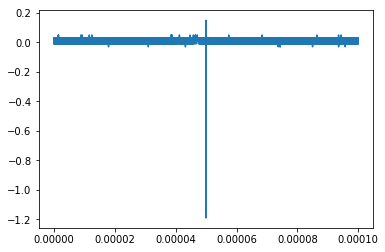

In [168]:
from struct import unpack
scope = rm.open_resource('USB0::0x0699::0x039F::C010383::INSTR')

scope.write('DATA:SOU CH1')
scope.write('DATA:WIDTH 1')
scope.write('DATA:ENC RPB')


ymult = float(scope.ask('WFMPRE:YMULT?'))
yzero = float(scope.ask('WFMPRE:YZERO?'))
yoff = float(scope.ask('WFMPRE:YOFF?'))
xincr = float(scope.ask('WFMPRE:XINCR?'))


scope.write('CURVE?')
data = scope.read_raw()
headerlen = 2 + int(data[1])
header = data[:headerlen]
ADC_wave = data[headerlen:-1]

ADC_wave = np.array(unpack('%sB' % len(ADC_wave),ADC_wave))

Volts = (ADC_wave - yoff) * ymult  + yzero

Time = np.arange(0, xincr * len(Volts), xincr)

plt.plot(Time, Volts)
plt.show()

In [19]:
tek.encoding

'ascii'

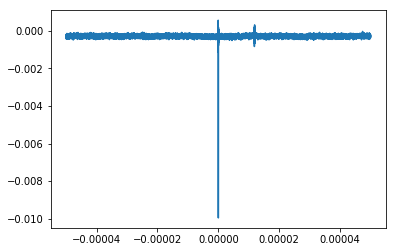

In [47]:
df1 = pd.read_csv("T0000RF1.CSV", skiprows=15)
plt.plot(df1.TIME, df1.REF1)

In [62]:
df1.shape

(100000, 2)

In [61]:
df1.TIME.values[-1]-df1.TIME.values[0]

9.9999e-05

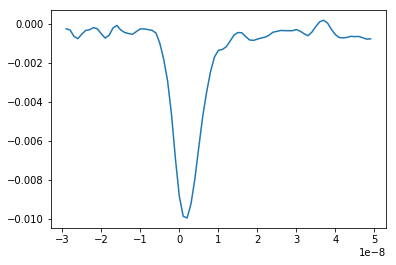

In [57]:

df1_c = df1[(df1.TIME>-3e-8) & (df1.TIME<5e-8) ]
plt.plot(df1_c.TIME, df1_c.REF1)

In [59]:
np.diff(df1.TIME)

array([1.e-09, 1.e-09, 1.e-09, ..., 1.e-09, 1.e-09, 1.e-09])

[1.e-09 1.e-09 1.e-09 ... 1.e-09 1.e-09 1.e-09]


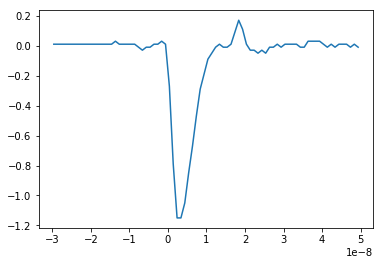

In [144]:
df1 = pd.read_csv("T0001RF1.CSV", skiprows=15)
#df1_c=df1
df1_c = df1[(df1.TIME>-3e-8) & (df1.TIME<5e-8) ]
plt.plot(df1_c.TIME, df1_c.REF1)
print(np.diff(df1.TIME))

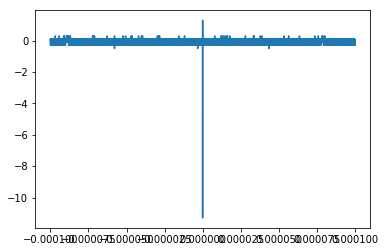

In [191]:
plt.plot(df1.TIME, df1.CH1)



In [145]:
ind = np.where((df1.TIME.values>-3e-8) & (df1.TIME.values<5e-8) )

In [178]:
vs.shape, ts.shape

((99952,), (100000,))

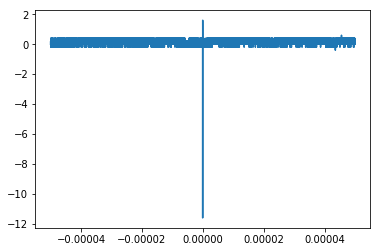

In [198]:
from struct import unpack
scope = rm.open_resource('USB0::0x0699::0x039F::C010383::INSTR')

scope.write('DATA:SOU CH1')
#scope.write('DATA:WIDTH 1')
scope.write('DATA:ENC RPB')


ymult = float(scope.query('WFMPRE:YMULT?'))
yzero = float(scope.query('WFMPRE:YZERO?'))
yoff = float(scope.query('WFMPRE:YOFF?'))
xincr = float(scope.query('WFMPRE:XINCR?'))
xze = float(tek.query('wfmpre:XZE?'))



scope.write('CURVE?')
data = scope.read_raw()
headerlen = 2 + int(data[1])
header = data[:headerlen]
ADC_wave = data[headerlen:-1]

ADC_wave = np.array(unpack('%sB' % len(ADC_wave),ADC_wave))

Volts = (ADC_wave - yoff) * ymult  + yzero

Time = np.arange(xze, xze+xincr * len(Volts), xincr)

ind = np.where((Time>-3e-8) & (Time<5e-8) )



#plt.plot(Time[ind], Volts[ind])
plt.plot(Time, Volts)

plt.show()


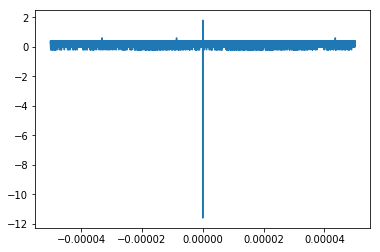

In [202]:
plt.plot(df1.TIME, df1.CH1)



In [192]:
print(ymult, yoff, yzero, xincr)



0.2 154.0 0.0 1e-09


[2.4e-09 2.0e-09 2.0e-09 ... 2.0e-09 2.0e-09 2.0e-09]


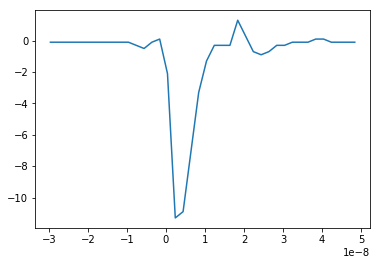

In [181]:
df1 = pd.read_csv("T0002CH1.CSV", skiprows=15)
#df1_c=df1
df1_c = df1[(df1.TIME>-3e-8) & (df1.TIME<5e-8) ]
#plt.plot(df1_c.TIME, df1_c.REF1)
plt.plot(df1_c.TIME, df1_c.CH1)

print(np.diff(df1.TIME))


[1.e-09 1.e-09 1.e-09 ... 1.e-09 1.e-09 1.e-09]


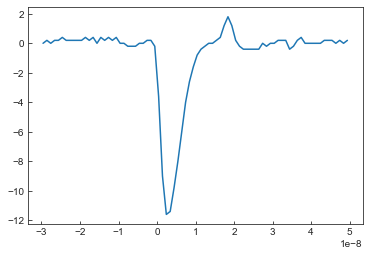

In [224]:
df1 = pd.read_csv("T0003CH1.CSV", skiprows=15)
#df1_c=df1
df1_c = df1[(df1.TIME>-3e-8) & (df1.TIME<5e-8) ]
#plt.plot(df1_c.TIME, df1_c.REF1)
plt.plot(df1_c.TIME, df1_c.CH1)


print(np.diff(df1.TIME))





('ASRL1::INSTR', 'ASRL2::INSTR')
TEKTRONIX,DPO2014B,C010383,CF:91.1CT FV:v1.52 

0.2 26.0 0.0


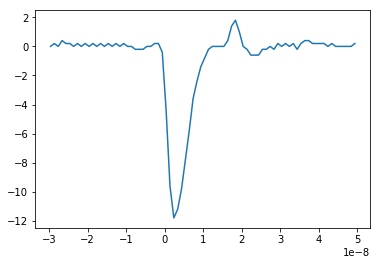

In [209]:
rm = visa.ResourceManager()
print(rm.list_resources())
tek = rm.open_resource('USB0::0x0699::0x039F::C010383::INSTR')
print(tek.query('*IDN?'))

tek.timeout=10000

tek.write('DATA:ENC ASCI')


vs = np.array(tek.query_ascii_values('CURV?'))

xin = float(tek.query('wfmpre:XIN?'))
xze = float(tek.query('wfmpre:XZE?'))

ts = np.arange(xze, xze+vs.shape[0]*xin, xin)

ymult = float(tek.query("wfmpre:ymult?"))
yoff = float(tek.query("wfmpre:yoff?"))
yzero = float(tek.query("wfmpre:yzero?"))

print(ymult, yoff, yzero)

vs = (vs - yoff) * ymult  + yzero


ind = np.where((ts>-3e-8) & (ts<5e-8) )


plt.plot(ts[ind], vs[ind])

#plt.plot(ts, vs)






In [7]:
#params: amp, tpeak, trise, tdecay, const
parLCL3, covLCL3 = curve_fit(flare_func_w_const, ts,
                        vs, p0=[10., 1.e-9, 1.e-9, 10.e-9, 0.], 
                        ) #, 
                        #method='trf', ftol=1e-10, loss='soft_l1') #approx abs

#min_of_mjd((start_mjd+end_mjd)/2., mjd0=57666.165), f_runwise/plot_f_unit, xerr=15, yerr=df_runwise/plot_f_unit,
par_names8=['amplitude', 'tpeak', 'trise', 'tdecay', 'const']
for i in range(len(par_names8)):
    print("Flare exponential fit param %d (%s) = %.4g +/- %.4g" % (i, par_names8[i], 
                                                                                        parLCL3[i], 
                                                                                        np.sqrt(abs(covLCL3[i,i]))))

#def chisq(y_vals, y_expected, y_errs, num_params=1):
    #  for reduced chisq test, under the assumption of Poisson counting
    #  we have lnL = const - (1/2.)*chi2
chi2LC3L1, dof3L1, redchi2LC3L1 = chisq(vs, 
                                  flare_func_w_const(ts, *parLCL3), 
                                  1, 
                                  5)
lnL_LC3L1 = -0.5*chi2LC3L1
print("fit Chisq is %.3f, dof is %d, reduced Chisq is %.2f" % (chi2LC3L1, dof3L1, redchi2LC3L1))
print("Log likelihood lnL={0}".format(lnL_LC3L1))



def FWHM(X,Y):
    half_max = max(Y) / 2.
    #find when function crosses line half_max (when sign of diff flips)
    #take the 'derivative' of signum(half_max - Y[])
    d = sign(half_max - array(Y[0:-1])) - sign(half_max - array(Y[1:]))
    #plot(X[0:len(d)],d) #if you are interested
    #find the left and right most indexes
    left_idx = find(d > 0)[0]
    right_idx = find(d < 0)[-1]
    return X[right_idx] - X[left_idx], left_idx, right_idx #return the difference (full width)



plt.plot(ts[ind], vs[ind])

wid, lind, rind = FWHM(ts[ind], vs[ind])
print(wid, lind, rind)


#plt.plot(ts, 
#         flare_func_w_const(ts, *parLCL3), 'g--', alpha=0.3) #, label="Best fit 4-min")
plt.plot(ts[ind], 
         flare_func_w_const(ts[ind], *parLCL3), 'g--', alpha=0.3) #, label="Best fit 4-min")



plt.xlabel('Time [s]')
plt.ylabel('Voltage [V]')

#plt.legend(loc='upper left', ncol=1, fontsize=11)



NameError: name 'ts' is not defined

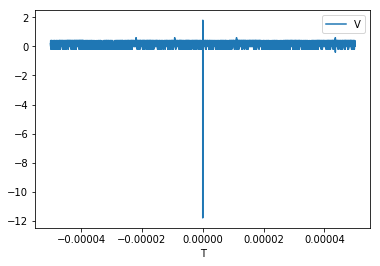

In [215]:
df = pd.DataFrame({'T': ts, 'V': vs}, columns=['T', 'V'])
df.plot(x='T', y='V')

TEKTRONIX,DPO2014B,C010383,CF:91.1CT FV:v1.52 

Clippinng the trace between 0 and 2e-07
FWHM is -0.044
Clippinng the trace between 0 and 2e-07
FWHM is -0.054
Clippinng the trace between 0 and 2e-07
FWHM is -0.064
Clippinng the trace between 0 and 2e-07
FWHM is -0.048
Clippinng the trace between 0 and 2e-07
FWHM is -0.054
Clippinng the trace between 0 and 2e-07
FWHM is -0.04
Clippinng the trace between 0 and 2e-07
FWHM is -0.05
Clippinng the trace between 0 and 2e-07
FWHM is -0.048
Clippinng the trace between 0 and 2e-07
FWHM is -0.062
Clippinng the trace between 0 and 2e-07
FWHM is -0.052000000000000005
Clippinng the trace between 0 and 2e-07
FWHM is -0.052000000000000005
Clippinng the trace between 0 and 2e-07
FWHM is -0.038
Clippinng the trace between 0 and 2e-07
FWHM is -0.048
Clippinng the trace between 0 and 2e-07
FWHM is -0.056
Clippinng the trace between 0 and 2e-07
FWHM is -0.04
Clippinng the trace between 0 and 2e-07
FWHM is -0.04
Clippinng the trace between 0 and 2e-07
FWHM i

/anaconda3/lib/python3.7/site-packages/matplotlib/pyplot.py:522: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


Clippinng the trace between 0 and 2e-07
FWHM is -0.058
Clippinng the trace between 0 and 2e-07
FWHM is -0.06
Clippinng the trace between 0 and 2e-07
FWHM is -0.052000000000000005
Clippinng the trace between 0 and 2e-07
FWHM is -0.058
Clippinng the trace between 0 and 2e-07
FWHM is -0.062
Clippinng the trace between 0 and 2e-07
FWHM is -0.042
Clippinng the trace between 0 and 2e-07
FWHM is -0.056
Clippinng the trace between 0 and 2e-07
FWHM is -0.04
Clippinng the trace between 0 and 2e-07
FWHM is -0.052000000000000005
Clippinng the trace between 0 and 2e-07
FWHM is -0.056
Clippinng the trace between 0 and 2e-07
FWHM is -0.046
Clippinng the trace between 0 and 2e-07
FWHM is -0.05
Clippinng the trace between 0 and 2e-07
FWHM is -0.052000000000000005
Clippinng the trace between 0 and 2e-07
FWHM is -0.054
Clippinng the trace between 0 and 2e-07
FWHM is -0.04
Clippinng the trace between 0 and 2e-07
FWHM is -0.054
Clippinng the trace between 0 and 2e-07
FWHM is -0.054
Clippinng the trace betw

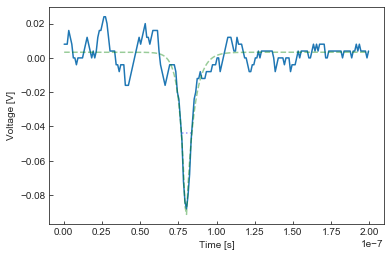

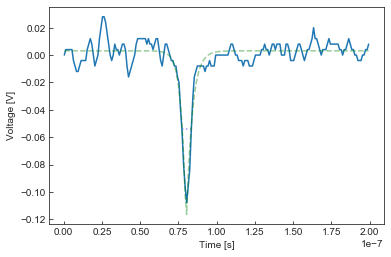

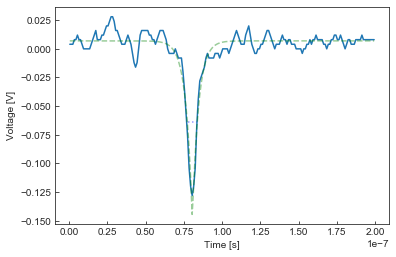

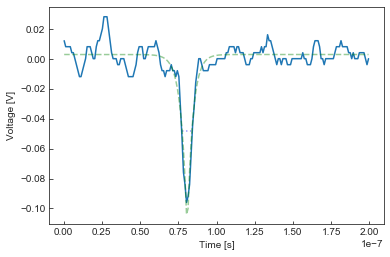

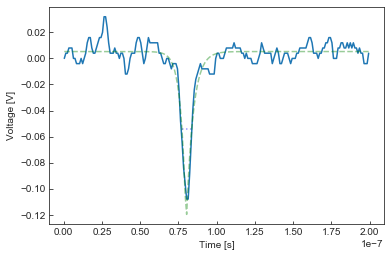

...

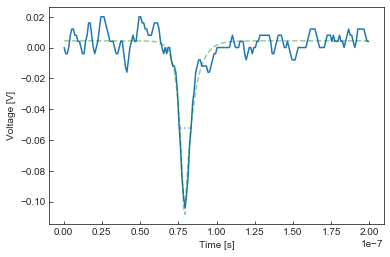

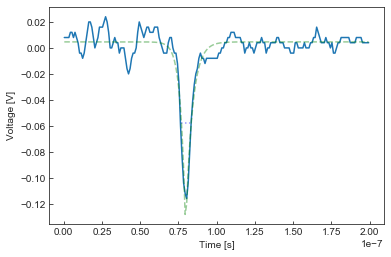

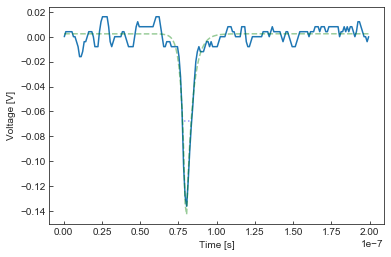

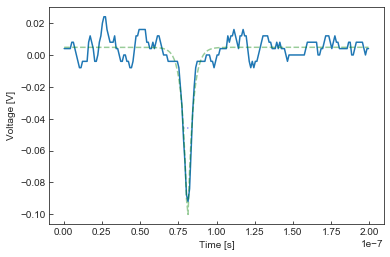

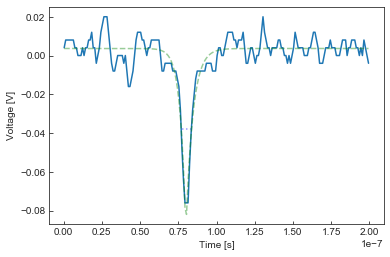

In [295]:
plot_tek_trace(dfname="flasher_data/pot_1p55k/LED1_pot1p55k_trace.csv", 
               plot_name="flasher_data/pot_1p55k/LED1_pot1p55k_trace.png", 
               width_file="flasher_fwhm.csv", 
                   tstart=0, tstop=2e-7, initial_params=[0.1, 8.e-8, 1.e-9, 10.e-9, 0.], 
                   pot_setting=1.55e3, onLEDs=[1], verbose=False, 
                   num_read=50)

TEKTRONIX,DPO2014B,C010383,CF:91.1CT FV:v1.52 

Clippinng the trace between 0 and 2e-07
FWHM is -0.018000000000000002


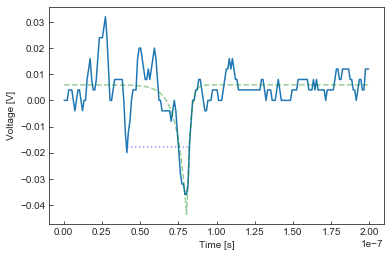

In [296]:
plot_tek_trace(dfname="testLED2_pot1p55k_trace.csv", 
               plot_name="testLED2_pot1p55k_trace.png", 
               width_file="test_flasher_fwhm.csv", 
                   tstart=0, tstop=2e-7, initial_params=[0.1, 8.e-8, 1.e-9, 10.e-9, 0.], 
                   pot_setting=1.55e3, onLEDs=[2], verbose=False, 
                   num_read=1)

TEKTRONIX,DPO2014B,C010383,CF:91.1CT FV:v1.52 

Clippinng the trace between 0 and 2e-07
FWHM is -0.014
Clippinng the trace between 0 and 2e-07
FWHM is -0.018000000000000002
Clippinng the trace between 0 and 2e-07
FWHM is -0.024
Clippinng the trace between 0 and 2e-07
FWHM is -0.02
Clippinng the trace between 0 and 2e-07
FWHM is -0.018000000000000002
Clippinng the trace between 0 and 2e-07
FWHM is -0.02
Clippinng the trace between 0 and 2e-07
FWHM is -0.018000000000000002
Clippinng the trace between 0 and 2e-07
FWHM is -0.014
Clippinng the trace between 0 and 2e-07
FWHM is -0.022
Clippinng the trace between 0 and 2e-07
FWHM is -0.022
Clippinng the trace between 0 and 2e-07
FWHM is -0.018000000000000002
Clippinng the trace between 0 and 2e-07
FWHM is -0.014
Clippinng the trace between 0 and 2e-07
FWHM is -0.018000000000000002
Clippinng the trace between 0 and 2e-07
FWHM is -0.018000000000000002
Clippinng the trace between 0 and 2e-07
FWHM is -0.026000000000000002
Clippinng the trace betw

/anaconda3/lib/python3.7/site-packages/matplotlib/pyplot.py:522: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


Clippinng the trace between 0 and 2e-07
FWHM is -0.018000000000000002
Clippinng the trace between 0 and 2e-07
FWHM is -0.016
Clippinng the trace between 0 and 2e-07
FWHM is -0.022
Clippinng the trace between 0 and 2e-07
FWHM is -0.02
Clippinng the trace between 0 and 2e-07
FWHM is -0.016
Clippinng the trace between 0 and 2e-07
FWHM is -0.024
Clippinng the trace between 0 and 2e-07
FWHM is -0.02
Clippinng the trace between 0 and 2e-07
FWHM is -0.016
Clippinng the trace between 0 and 2e-07
FWHM is -0.02
Clippinng the trace between 0 and 2e-07
FWHM is -0.01
Clippinng the trace between 0 and 2e-07
FWHM is -0.01
Clippinng the trace between 0 and 2e-07
FWHM is -0.024
Clippinng the trace between 0 and 2e-07
FWHM is -0.036000000000000004
Clippinng the trace between 0 and 2e-07
FWHM is -0.016
Clippinng the trace between 0 and 2e-07
FWHM is -0.018000000000000002
Clippinng the trace between 0 and 2e-07
FWHM is -0.014
Clippinng the trace between 0 and 2e-07
FWHM is -0.024
Clippinng the trace betwe

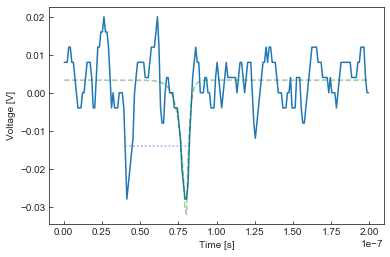

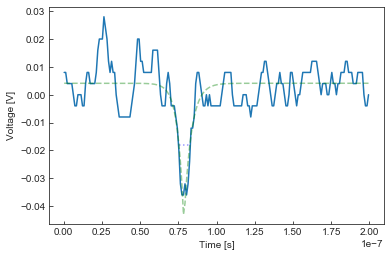

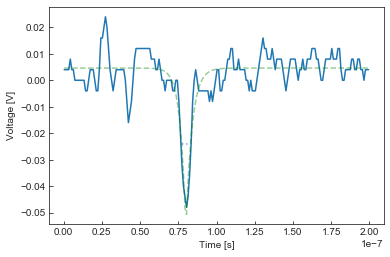

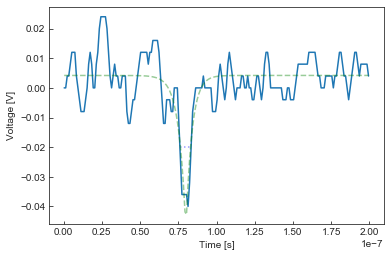

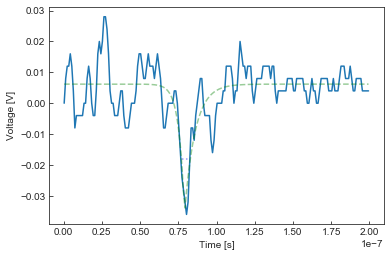

...

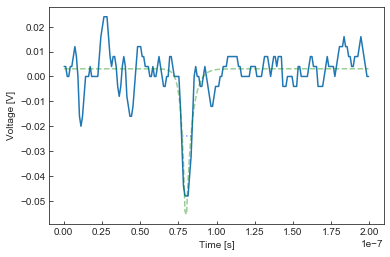

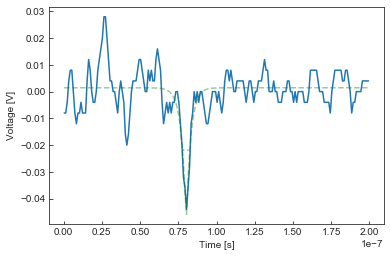

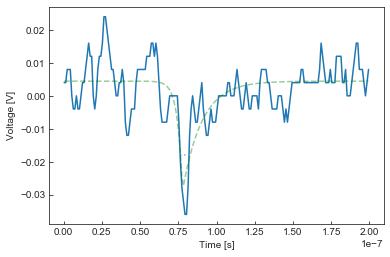

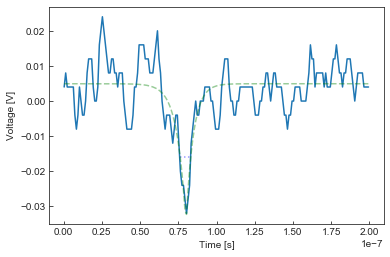

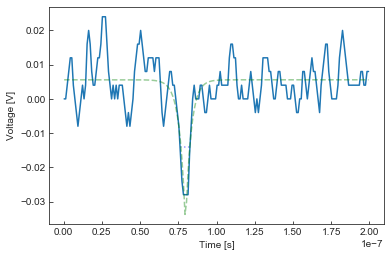

In [297]:
plot_tek_trace(dfname="flasher_data/pot_1p55k/LED2_pot1p55k_trace.csv", 
               plot_name="flasher_data/pot_1p55k/LED2_pot1p55k_trace.png", 
               width_file="flasher_fwhm.csv", 
                   tstart=0, tstop=2e-7, initial_params=[0.1, 8.e-8, 1.e-9, 10.e-9, 0.], 
                   pot_setting=1.55e3, onLEDs=[2], verbose=False, 
                   num_read=50)

TEKTRONIX,DPO2014B,C010383,CF:91.1CT FV:v1.52 

Clippinng the trace between 0 and 2e-07
FWHM is -0.006


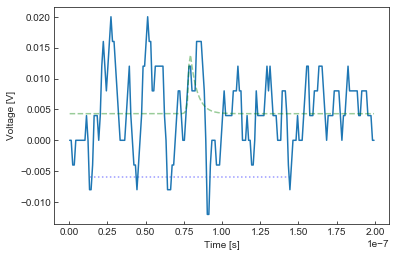

In [300]:
LEDnum=4

plot_tek_trace(dfname="testLED{}_pot1p55k_trace.csv".format(LEDnum), 
               plot_name="testLED{}_pot1p55k_trace.png".format(LEDnum), 
               width_file="test_flasher_fwhm.csv", 
                   tstart=0, tstop=2e-7, initial_params=[0.1, 8.e-8, 1.e-9, 10.e-9, 0.], 
                   pot_setting=1.55e3, onLEDs=[LEDnum], verbose=False, 
                   num_read=1)

TEKTRONIX,DPO2014B,C010383,CF:91.1CT FV:v1.52 

Clippinng the trace between 0 and 2e-07
FWHM is -0.038
Clippinng the trace between 0 and 2e-07
FWHM is -0.054
Clippinng the trace between 0 and 2e-07
FWHM is -0.05
Clippinng the trace between 0 and 2e-07
FWHM is -0.056
Clippinng the trace between 0 and 2e-07
FWHM is -0.042
Clippinng the trace between 0 and 2e-07
FWHM is -0.038
Clippinng the trace between 0 and 2e-07
FWHM is -0.046
Clippinng the trace between 0 and 2e-07
FWHM is -0.046
Clippinng the trace between 0 and 2e-07
FWHM is -0.046
Clippinng the trace between 0 and 2e-07
FWHM is -0.042
Clippinng the trace between 0 and 2e-07
FWHM is -0.048
Clippinng the trace between 0 and 2e-07
FWHM is -0.034
Clippinng the trace between 0 and 2e-07
FWHM is -0.04
Clippinng the trace between 0 and 2e-07
FWHM is -0.044
Clippinng the trace between 0 and 2e-07
FWHM is -0.048
Clippinng the trace between 0 and 2e-07
FWHM is -0.04
Clippinng the trace between 0 and 2e-07
FWHM is -0.046
Clippinng the trace 

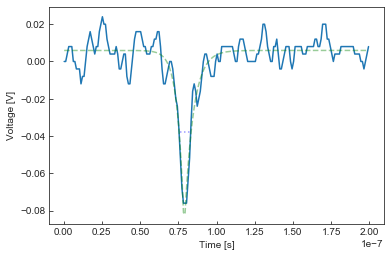

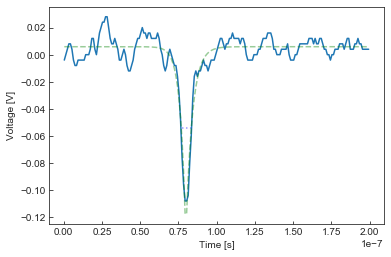

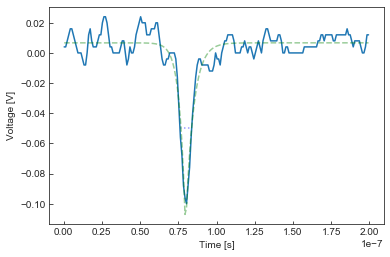

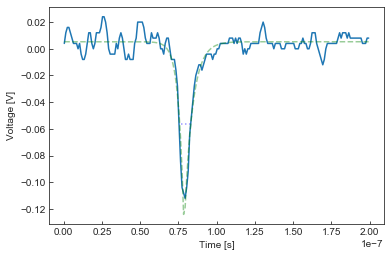

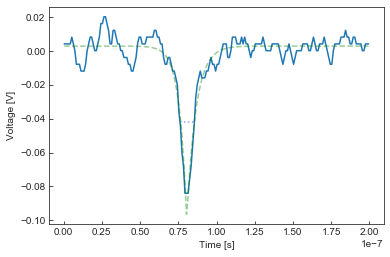

...

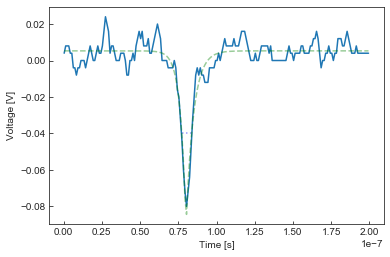

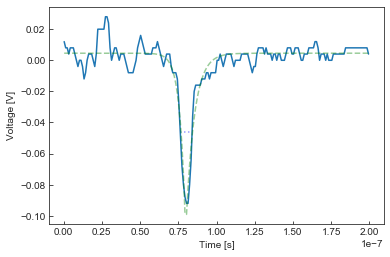

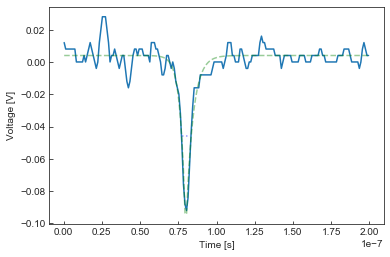

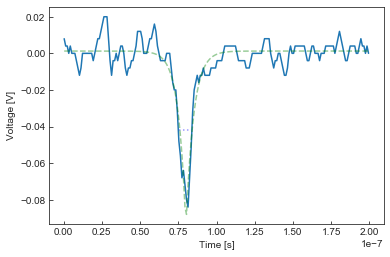

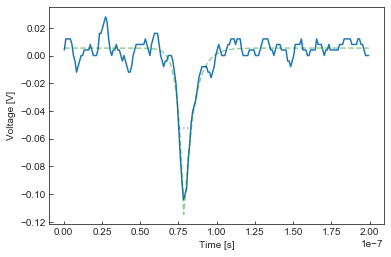

In [307]:
LEDnum=10
plot_tek_trace(dfname="flasher_data/pot_1p55k/LED{}_pot1p55k_trace.csv".format(LEDnum), 
               plot_name="flasher_data/pot_1p55k/LED{}_pot1p55k_trace.png".format(LEDnum), 
               width_file="flasher_fwhm.csv", 
                   tstart=0, tstop=2e-7, initial_params=[0.1, 8.e-8, 1.e-9, 10.e-9, 0.], 
                   pot_setting=1.55e3, onLEDs=[LEDnum], verbose=False, 
                   num_read=20)

TEKTRONIX,DPO2014B,C010383,CF:91.1CT FV:v1.52 

Clippinng the trace between 0 and 2e-07
FWHM is -0.352
Clippinng the trace between 0 and 2e-07
FWHM is -0.352
Clippinng the trace between 0 and 2e-07
FWHM is -0.342
Clippinng the trace between 0 and 2e-07
FWHM is -0.352
Clippinng the trace between 0 and 2e-07
FWHM is -0.352
Clippinng the trace between 0 and 2e-07
FWHM is -0.342
Clippinng the trace between 0 and 2e-07
FWHM is -0.352
Clippinng the trace between 0 and 2e-07
FWHM is -0.34400000000000003
Clippinng the trace between 0 and 2e-07
FWHM is -0.34
Clippinng the trace between 0 and 2e-07
FWHM is -0.34
Clippinng the trace between 0 and 2e-07
FWHM is -0.352
Clippinng the trace between 0 and 2e-07
FWHM is -0.352
Clippinng the trace between 0 and 2e-07
FWHM is -0.342
Clippinng the trace between 0 and 2e-07
FWHM is -0.352
Clippinng the trace between 0 and 2e-07
FWHM is -0.352
Clippinng the trace between 0 and 2e-07
FWHM is -0.352
Clippinng the trace between 0 and 2e-07
FWHM is -0.328
Clipp

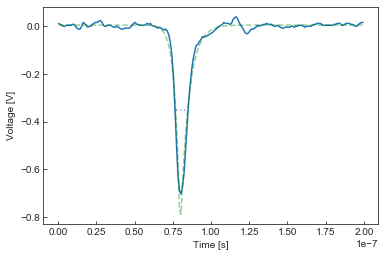

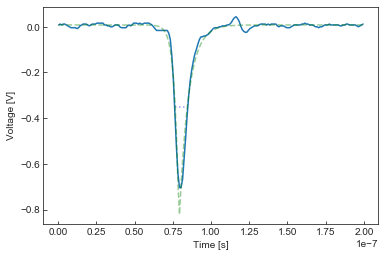

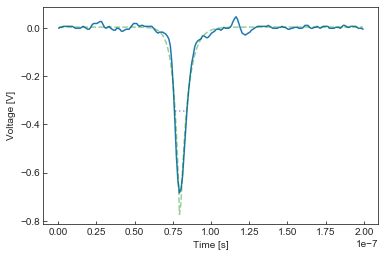

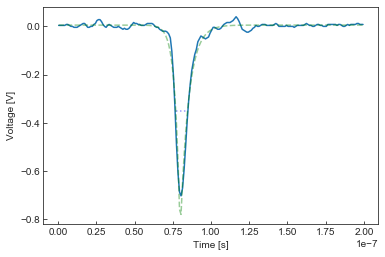

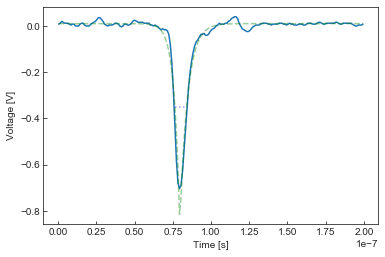

...

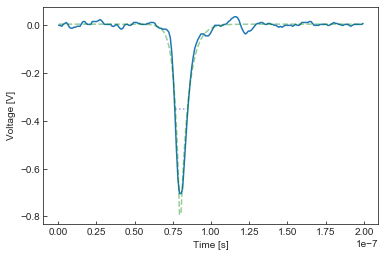

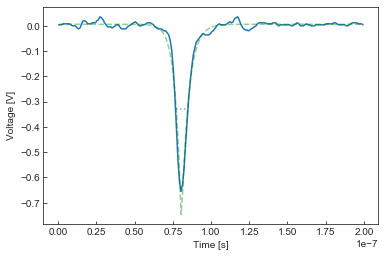

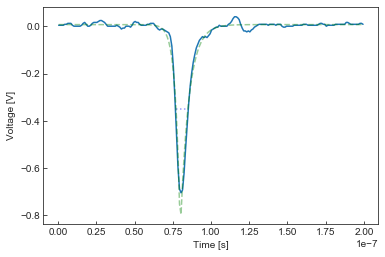

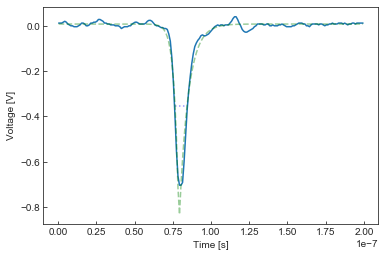

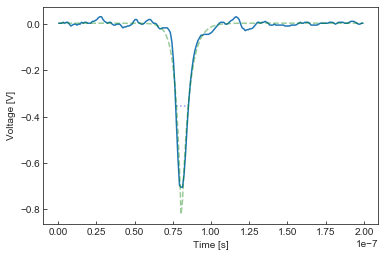

In [325]:
LEDnum="6_7_8_9_10"
plot_tek_trace(dfname="flasher_data/pot_1p55k/LED{}_pot1p55k_trace.csv".format(LEDnum), 
               plot_name="flasher_data/pot_1p55k/LED{}_pot1p55k_trace.png".format(LEDnum), 
               width_file="flasher_fwhm.csv", 
                   tstart=0, tstop=2e-7, initial_params=[0.1, 8.e-8, 1.e-9, 10.e-9, 0.], 
                   pot_setting=1.55e3, onLEDs=[LEDnum], verbose=False, 
                   num_read=20)

TEKTRONIX,DPO2014B,C010383,CF:91.1CT FV:v1.52 

Clippinng the trace between 0 and 2e-07
FWHM is -0.212


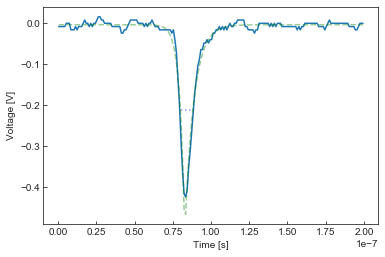

In [340]:
LEDnum="1"

plot_tek_trace(dfname="testLED{}_pot2k_trace.csv".format(LEDnum), 
               plot_name="testLED{}_pot2k_trace.png".format(LEDnum), 
               width_file="test_flasher_fwhm.csv", 
                   tstart=0, tstop=2e-7, initial_params=[0.1, 8.e-8, 1.e-9, 10.e-9, 0.], 
                   pot_setting=2e3, onLEDs=[LEDnum], verbose=False, 
                   num_read=1)

###
10 0000000100
TEKTRONIX,DPO2014B,C010383,CF:91.1CT FV:v1.52 

0.008 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.008 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.008 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.008 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.008 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.008 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.008 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.008 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.008 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.008 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.008 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.008 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.008 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.008 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.008 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.008 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.008 49.0 0.0
Clippinng the trace between 0 and 2e-07

/anaconda3/lib/python3.7/site-packages/matplotlib/pyplot.py:522: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


0.008 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.008 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.008 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.008 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.008 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.008 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.008 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.008 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.008 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.008 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.008 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.008 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.008 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.008 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.008 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.008 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.008 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.008 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.008 49.0

/anaconda3/lib/python3.7/site-packages/matplotlib/pyplot.py:522: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


0.008 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.008 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.008 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.008 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.008 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.008 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.008 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.008 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.008 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.008 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.008 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.008 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.008 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.008 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.008 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.008 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.008 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.008 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.008 49.0

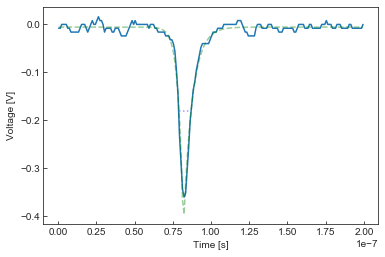

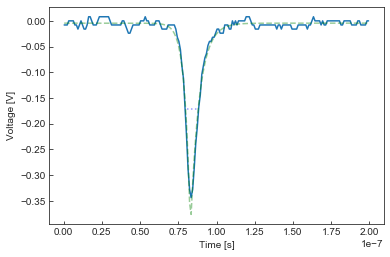

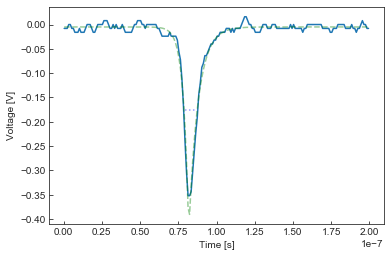

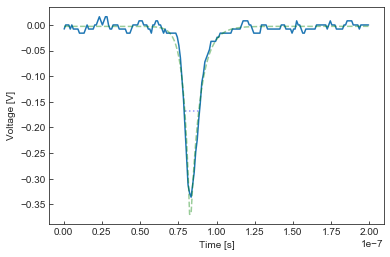

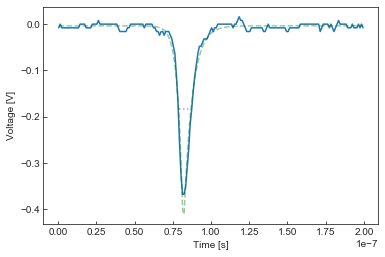

...

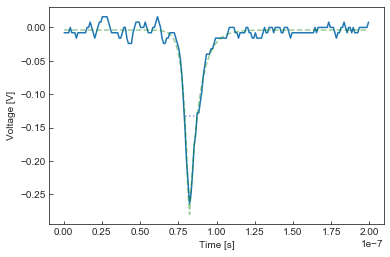

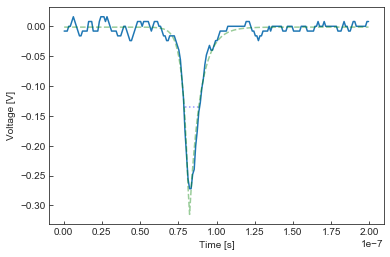

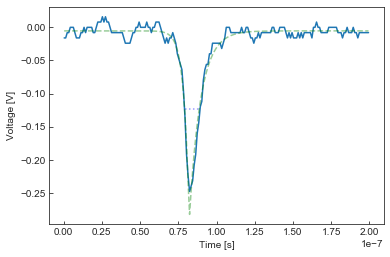

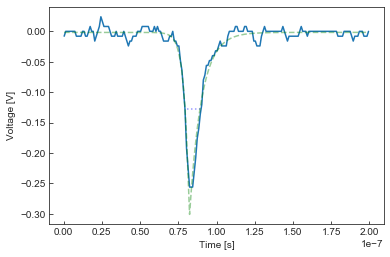

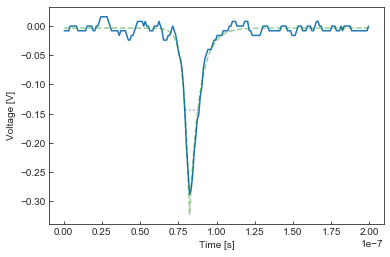

In [351]:
#LEDnum="6_7_8_9_10"
#LEDnum=7

for LEDnum, trig in zip([8,9,10], ['0000000100','0000000010','0000000001']):
    print("###")
    print(LEDnum, trig)
    process = Popen(['python2', 'LED_Flasher_TestQF.py', trig], stdout=PIPE, stderr=PIPE)
    stdout, stderr = process.communicate()
    plot_tek_trace(dfname="flasher_data/pot_2k/LED{}_pot2k_trace.csv".format(LEDnum), 
               plot_name="flasher_data/pot_2k/LED{}_pot2k_trace.png".format(LEDnum), 
               width_file="flasher_fwhm_pot2k.csv", 
                   tstart=0, tstop=2e-7, initial_params=[0.1, 8.e-8, 1.e-9, 10.e-9, 0.], 
                   pot_setting=2e3, onLEDs=[LEDnum], verbose=False, 
                   num_read=20)

In [350]:
for Ln, trig in zip([8,9,10], ['0000000100','0000000010','0000000001']):
    print(Ln, trig)
    process = Popen(['python2', 'LED_Flasher_TestQF.py', trig], stdout=PIPE, stderr=PIPE)
    stdout, stderr = process.communicate()



8 0000000100
9 0000000010
10 0000000001


In [349]:
from subprocess import Popen, PIPE

process = Popen(['python2', 'LED_Flasher_TestQF.py', '0000010000'], stdout=PIPE, stderr=PIPE)
stdout, stderr = process.communicate()


TEKTRONIX,DPO2014B,C010383,CF:91.1CT FV:v1.52 

0.008 49.0 0.0
Clippinng the trace between 0 and 2e-07


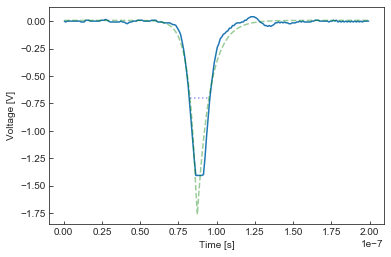

In [355]:
LEDnum="9"

process = Popen(['python2', 'LED_Flasher_TestQF.py', '0000000010'], stdout=PIPE, stderr=PIPE)
stdout, stderr = process.communicate()


plot_tek_trace(dfname="testLED{}_pot3k_trace.csv".format(LEDnum), 
               plot_name="testLED{}_pot3k_trace.png".format(LEDnum), 
               width_file="test_flasher_fwhm.csv", 
                   tstart=0, tstop=2e-7, initial_params=[0.1, 8.e-8, 1.e-9, 10.e-9, 0.], 
                   pot_setting=3e3, onLEDs=[LEDnum], verbose=False, 
                   num_read=1)

###
1 1000000000
TEKTRONIX,DPO2014B,C010383,CF:91.1CT FV:v1.52 

0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Cli

/anaconda3/lib/python3.7/site-packages/matplotlib/pyplot.py:522: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the 

/anaconda3/lib/python3.7/site-packages/matplotlib/pyplot.py:522: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the 

/anaconda3/lib/python3.7/site-packages/matplotlib/pyplot.py:522: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07


/anaconda3/lib/python3.7/site-packages/scipy/optimize/minpack.py:794: OptimizeWarning: Covariance of the parameters could not be estimated
  category=OptimizeWarning)


0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
###
5 0000100000
TEKTRONIX,DPO2014B,C010383,CF:91.1CT FV:v1.52 

0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07


/anaconda3/lib/python3.7/site-packages/matplotlib/pyplot.py:522: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the 

/anaconda3/lib/python3.7/site-packages/matplotlib/pyplot.py:522: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the 

/anaconda3/lib/python3.7/site-packages/matplotlib/pyplot.py:522: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the 

/anaconda3/lib/python3.7/site-packages/matplotlib/pyplot.py:522: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the 

/anaconda3/lib/python3.7/site-packages/matplotlib/pyplot.py:522: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the 

/anaconda3/lib/python3.7/site-packages/matplotlib/pyplot.py:522: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the trace between 0 and 2e-07
0.02 49.0 0.0
Clippinng the 

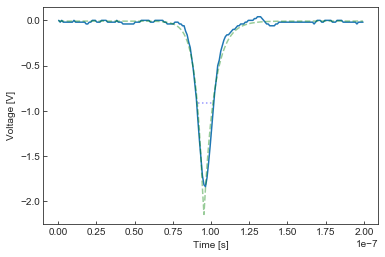

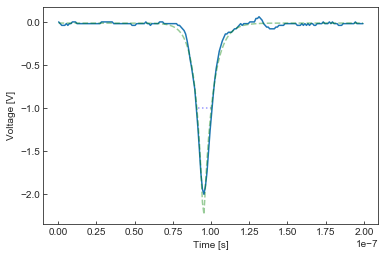

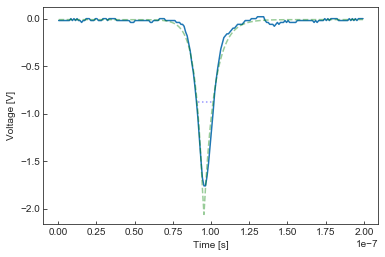

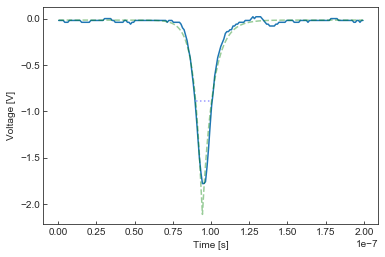

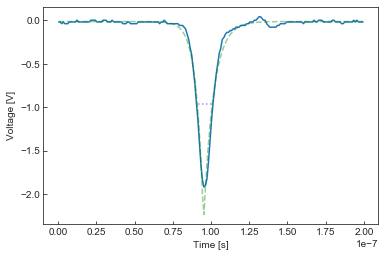

...

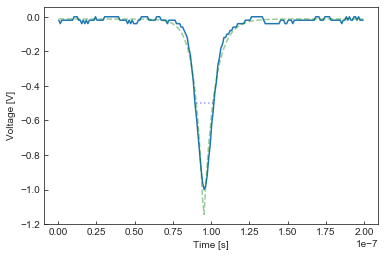

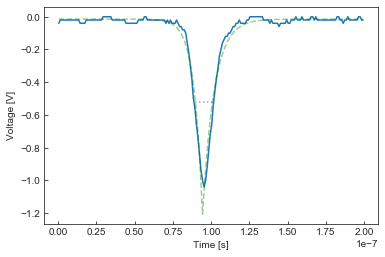

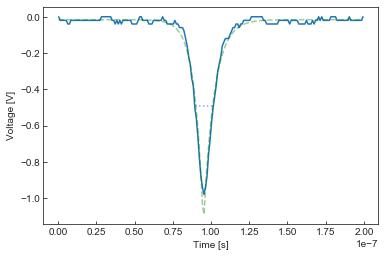

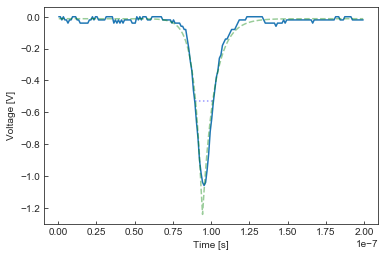

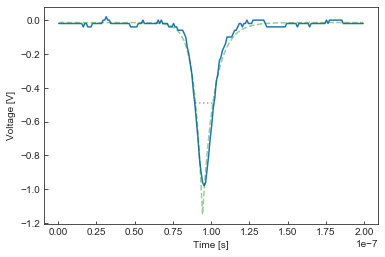

In [22]:
#LEDnum="6_7_8_9_10"
pot_val = "3k"
for LEDnum, trig in zip([1,2,3,4,5,6,7,8,9,10], 
                        ['1000000000', '0100000000', '0010000000', '0001000000', '0000100000',
                         '0000010000', '0000001000', '0000000100', '0000000010', '0000000001']):
    print("###")
    print(LEDnum, trig)
    process = Popen(['python2', 'LED_Flasher_TestQF.py', trig], stdout=PIPE, stderr=PIPE)
    stdout, stderr = process.communicate()
    plot_tek_trace(dfname="flasher_data/pot_{}/LED{}_pot{}_trace.csv".format(pot_val, LEDnum, pot_val), 
               plot_name="flasher_data/pot_{}/LED{}_pot{}_trace.png".format(pot_val, LEDnum, pot_val), 
               width_file="flasher_fwhm_pot{}.csv".format(pot_val), 
                   tstart=0, tstop=2e-7, initial_params=[0.1, 8.e-8, 1.e-9, 10.e-9, 0.], 
                   pot_setting=3e3, onLEDs=[LEDnum], verbose=False, 
                   num_read=20)

Check oscilloscope and adjust scale! Press Enter to continue... 

Please press Ctrl-C when you wish to proceed.
Oops, no input was received in 60 sec. Will continue.


###
1 1000000000
TEKTRONIX,DPO2014B,C010383,CF:91.1CT FV:v1.52 

0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace b

/anaconda3/lib/python3.7/site-packages/matplotlib/pyplot.py:522: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and

/anaconda3/lib/python3.7/site-packages/matplotlib/pyplot.py:522: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and

/anaconda3/lib/python3.7/site-packages/matplotlib/pyplot.py:522: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and

/anaconda3/lib/python3.7/site-packages/matplotlib/pyplot.py:522: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07


/anaconda3/lib/python3.7/site-packages/scipy/optimize/minpack.py:794: OptimizeWarning: Covariance of the parameters could not be estimated
  category=OptimizeWarning)


0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07


/anaconda3/lib/python3.7/site-packages/scipy/optimize/minpack.py:794: OptimizeWarning: Covariance of the parameters could not be estimated
  category=OptimizeWarning)


0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07


/anaconda3/lib/python3.7/site-packages/scipy/optimize/minpack.py:794: OptimizeWarning: Covariance of the parameters could not be estimated
  category=OptimizeWarning)


0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07


/anaconda3/lib/python3.7/site-packages/scipy/optimize/minpack.py:794: OptimizeWarning: Covariance of the parameters could not be estimated
  category=OptimizeWarning)


0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07


/anaconda3/lib/python3.7/site-packages/scipy/optimize/minpack.py:794: OptimizeWarning: Covariance of the parameters could not be estimated
  category=OptimizeWarning)


0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07


/anaconda3/lib/python3.7/site-packages/scipy/optimize/minpack.py:794: OptimizeWarning: Covariance of the parameters could not be estimated
  category=OptimizeWarning)


0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07


/anaconda3/lib/python3.7/site-packages/scipy/optimize/minpack.py:794: OptimizeWarning: Covariance of the parameters could not be estimated
  category=OptimizeWarning)


0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and

/anaconda3/lib/python3.7/site-packages/scipy/optimize/minpack.py:794: OptimizeWarning: Covariance of the parameters could not be estimated
  category=OptimizeWarning)


0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07
0.2 75.5 0.0
Clippinng the trace between 0 and 2e-07


KeyboardInterrupt: 

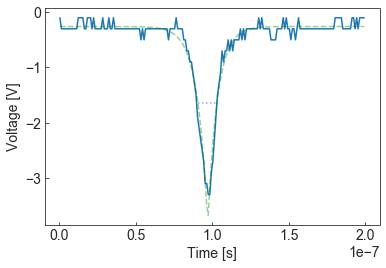

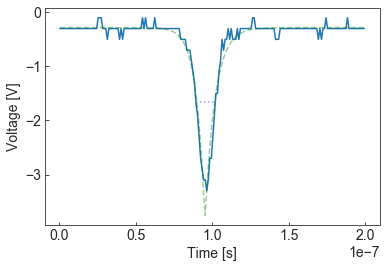

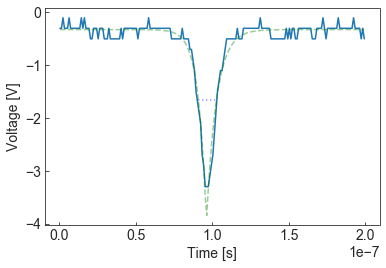

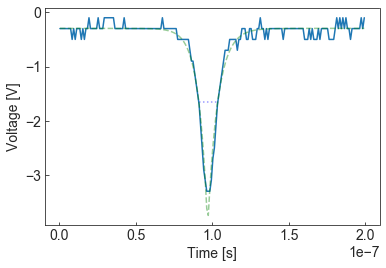

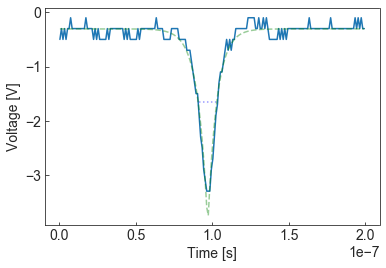

...

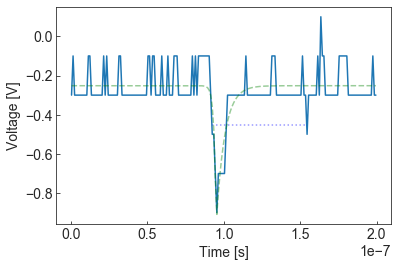

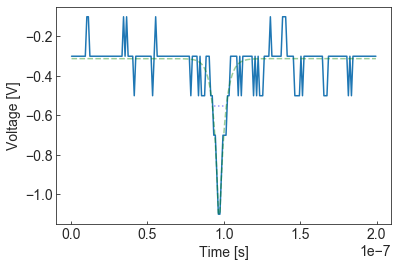

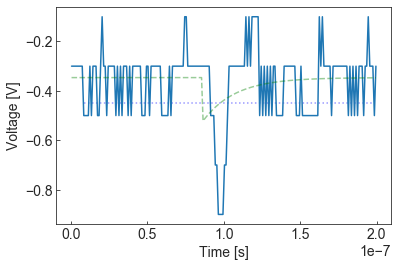

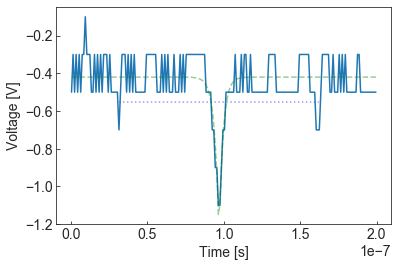

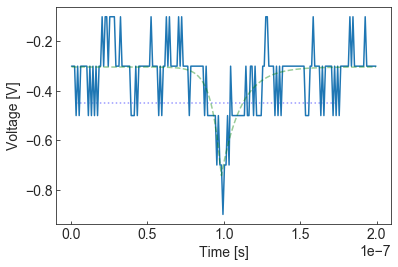

In [187]:

#LEDnum="6_7_8_9_10"
pot_val = "3p5k"
for LEDnum, trig in zip([1,2,3,4,5,6,7,8,9,10], 
                        ['1000000000', '0100000000', '0010000000', '0001000000', '0000100000',
                         '0000010000', '0000001000', '0000000100', '0000000010', '0000000001']):
    print("###")
    print(LEDnum, trig)
    process = Popen(['python2', 'LED_Flasher_TestQF.py', trig], stdout=PIPE, stderr=PIPE)
    stdout, stderr = process.communicate()
    if not os.path.exists("flasher_data/pot_{}/".format(pot_val)):
        os.mkdir( "flasher_data/pot_{}/".format(pot_val));
    prompt_with_timeout()
    log_file="flasher_fwhm_pot{}.log".format(pot_val)
    setup_logger("flasher_log", log_file,
                         level=logging.INFO, show_log=verbose)
    logger = logging.getLogger('flasher_log')
    logger.info("Starting characterization LED pattern {}, pot {}".format(LEDnum, pot_val))
    print("Starting characterization LED pattern {}, pot {}".format(LEDnum, pot_val))
    plot_tek_trace(dfname="flasher_data/pot_{}/LED{}_pot{}_trace.csv".format(pot_val, LEDnum, pot_val), 
               plot_name="flasher_data/pot_{}/LED{}_pot{}_trace.png".format(pot_val, LEDnum, pot_val), 
               width_file="flasher_fwhm_pot{}.csv".format(pot_val), 
                log_file="flasher_fwhm_pot{}.log".format(pot_val),
                   tstart=0, tstop=2e-7, initial_params=[0.1, 8.e-8, 1.e-9, 10.e-9, 0.], 
                   pot_setting=3.5e3, onLEDs=[LEDnum], verbose=False, 
                   num_read=100)

In [326]:
df_flasher = pd.read_csv("flasher_fwhm.csv")

df_flasher_stat = pd.DataFrame(df_flasher.groupby('LEDs').describe())

#L2 L5 L7 L9 L10 setting to 01001
#L1 L3 L4 L6 L8 setting to 00000

LED_level_map = {1:2, 2:5, 3:7, 4:9, 5:10, 6:1, 7:3, 8:4, 9:6, 10:8}



In [188]:
df_flasher_stat

FWHM_s                                                          \
      count          mean           std           min           25%   
LEDs                                                                  
1      20.0  7.450000e-09  6.048053e-10  7.000000e-09  7.000000e-09   
2      20.0  7.150000e-09  7.451598e-10  6.000000e-09  7.000000e-09   
3      20.0  7.100000e-09  6.407233e-10  6.000000e-09  7.000000e-09   
4      20.0  1.474500e-07  3.945881e-08  6.400000e-08  1.305000e-07   
5      20.0  1.382500e-07  4.543460e-08  3.000000e-09  1.087500e-07   
6      20.0  7.900000e-09  7.181848e-10  7.000000e-09  7.000000e-09   
7      20.0  8.200000e-09  4.103913e-10  8.000000e-09  8.000000e-09   
8      20.0  8.050000e-09  6.863327e-10  7.000000e-09  8.000000e-09   
9      20.0  7.850000e-09  4.893605e-10  7.000000e-09  8.000000e-09   
10     20.0  8.350000e-09  6.708204e-10  7.000000e-09  8.000000e-09   

                                               fit_baseline_V            \
               50%           75%           max          count      mean   
LEDs                                                                      
1     7.000000e-09  8.000000e-09  9.000000e-09           20.0 -0.003111   
2     7.000000e-09  7.250000e-09  9.000000e-09           20.0 -0.003686   
3     7.000000e-09  7.250000e-09  8.000000e-09           20.0 -0.003607   
4     1.520000e-07  1.792500e-07  1.950000e-07           20.0 -0.004521   
5     1.465000e-07  1.737500e-07  1.900000e-07           20.0 -0.004340   
6     8.000000e-09  8.000000e-09  9.000000e-09           20.0 -0.002909   
7     8.000000e-09  8.000000e-09  9.000000e-09           20.0 -0.002663   
8     8.000000e-09  8.250000e-09  9.000000e-09           20.0 -0.003808   
9     8.000000e-09  8.000000e-09  9.000000e-09           20.0 -0.003342   
10    8.000000e-09  9.000000e-09  9.000000e-09           20.0 -0.003327   

       ...   half_max_V        pot_value_ohm                               \
       ...          75%    max         count    mean  std     min     25%   
LEDs   ...                                                                  
1      ...        0.204  0.168          20.0  2000.0  0.0  2000.0  2000.0   
2      ...        0.111  0.096          20.0  2000.0  0.0  2000.0  2000.0   
3      ...        0.111  0.100          20.0  2000.0  0.0  2000.0  2000.0   
4      ...        0.008  0.008          20.0  2000.0  0.0  2000.0  2000.0   
5      ...        0.011  0.008          20.0  2000.0  0.0  2000.0  2000.0   
6      ...        0.155  0.144          20.0  2000.0  0.0  2000.0  2000.0   
7      ...        0.353  0.332          20.0  2000.0  0.0  2000.0  2000.0   
8      ...        0.172  0.152          20.0  2000.0  0.0  2000.0  2000.0   
9      ...        0.235  0.216          20.0  2000.0  0.0  2000.0  2000.0   
10     ...        0.135  0.124          20.0  2000.0  0.0  2000.0  2000.0   

                              
         50%     75%     max  
LEDs                          
1     2000.0  2000.0  2000.0  
2     2000.0  2000.0  2000.0  
3     2000.0  2000.0  2000.0  
4     2000.0  2000.0  2000.0  
5     2000.0  2000.0  2000.0  
6     2000.0  2000.0  2000.0  
7     2000.0  2000.0  2000.0  
8     2000.0  2000.0  2000.0  
9     2000.0  2000.0  2000.0  
10    2000.0  2000.0  2000.0  

[10 rows x 64 columns]

In [344]:
df_feb16_2p5.head()

,LEDs,pot_value_ohm,FWHM_s,half_max_V,fit_trise_s,fit_tdecay_s,fit_peak_V,fit_tpeak_s,fit_baseline_V,fit_redchisq,integrate_window_start,integrate_window_stop,integrated_charge_all,integrated_charge_window
0,1,2p5k_Feb16,9.000000e-09,-0.03564,3.800525e-09,5.950136e-09,0.087147,8.127604e-08,-0.000692,0.000011,6.577970e-08,1.297985e-07,-9.864000e-10,-8.528400e-10
1,1,2p5k_Feb16,8.000000e-09,-0.03708,3.849174e-09,5.611848e-09,0.087398,8.126988e-08,-0.000868,0.000007,6.557517e-08,1.270336e-07,-9.979200e-10,-8.521200e-10
2,1,2p5k_Feb16,8.000000e-09,-0.03852,3.426058e-09,5.883052e-09,0.092203,8.141271e-08,-0.000707,0.000011,6.744322e-08,1.293881e-07,-9.990000e-10,-8.668800e-10
3,1,2p5k_Feb16,8.000000e-09,-0.03708,3.581337e-09,6.458572e-09,0.088700,8.142124e-08,-0.000603,0.000013,6.681861e-08,1.340899e-07,-1.011600e-09,-8.982000e-10
4,1,2p5k_Feb16,9.000000e-09,-0.03996,3.797334e-09,5.815755e-09,0.095037,8.127199e-08,-0.000751,0.000009,6.578865e-08,1.286986e-07,-1.062000e-09,-9.270000e-10


Text(0,0.5,'Pulse height variance/N [V$^2$]')

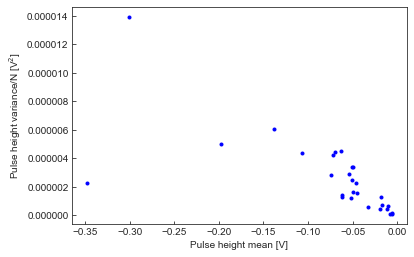

In [332]:
df_sortV = df_flasher_stat['half_max_V'].sort_values(by=['mean'])
new_ind = df_sortV.index

plt.plot(df_flasher_stat.half_max_V.loc[new_ind, 'mean'], (df_flasher_stat.half_max_V.loc[new_ind, 'std'])**2/(df_flasher_stat.half_max_V.loc[new_ind, 'count']),
        marker='.', color='b', ls="")

plt.xlabel("Pulse height mean [V]")
plt.ylabel(r"Pulse height variance/N [V$^2$]")



In [339]:
df_flasher_stat[df_flasher_stat.index.isin(["1","2","3", "4", "5", "6", "7", "8", "9", "10"])]


FWHM_s                                                          \
      count          mean           std           min           25%   
LEDs                                                                  
1      50.0  6.020000e-09  5.529144e-10  5.000000e-09  6.000000e-09   
10     20.0  6.450000e-09  1.145931e-09  4.000000e-09  6.000000e-09   
2      50.0  1.058000e-08  1.516453e-08  4.000000e-09  5.000000e-09   
3      20.0  3.950000e-08  2.697465e-08  2.000000e-09  6.250000e-09   
4      20.0  6.985000e-08  5.179644e-08  2.000000e-09  3.025000e-08   
5      20.0  7.050000e-08  4.177572e-08  1.000000e-09  5.675000e-08   
6      20.0  6.350000e-09  5.871429e-10  6.000000e-09  6.000000e-09   
7      20.0  6.850000e-09  6.708204e-10  6.000000e-09  6.000000e-09   
8      20.0  6.400000e-09  6.805570e-10  5.000000e-09  6.000000e-09   
9      20.0  6.650000e-09  7.451598e-10  5.000000e-09  6.000000e-09   

                                               fit_baseline_V            \
               50%           75%           max          count      mean   
LEDs                                                                      
1     6.000000e-09  6.000000e-09  7.000000e-09           50.0  0.004070   
10    6.000000e-09  7.000000e-09  9.000000e-09           20.0  0.004079   
2     6.000000e-09  6.750000e-09  7.500000e-08           50.0  0.004327   
3     4.100000e-08  5.700000e-08  8.600000e-08           20.0  0.003639   
4     5.950000e-08  1.055000e-07  1.610000e-07           20.0  0.003861   
5     6.500000e-08  9.000000e-08  1.400000e-07           20.0  0.003623   
6     6.000000e-09  7.000000e-09  8.000000e-09           20.0  0.004055   
7     7.000000e-09  7.000000e-09  8.000000e-09           20.0  0.004143   
8     6.000000e-09  7.000000e-09  8.000000e-09           20.0  0.003674   
9     7.000000e-09  7.000000e-09  8.000000e-09           20.0  0.004258   

       ...   half_max_V        pot_value_ohm                               \
       ...          75%    max         count    mean  std     min     25%   
LEDs   ...                                                                  
1      ...      -0.0460 -0.034          50.0  1550.0  0.0  1550.0  1550.0   
10     ...      -0.0415 -0.034          20.0  1550.0  0.0  1550.0  1550.0   
2      ...      -0.0160 -0.010          50.0  1550.0  0.0  1550.0  1550.0   
3      ...      -0.0100 -0.006          20.0  1550.0  0.0  1550.0  1550.0   
4      ...      -0.0060 -0.004          20.0  1550.0  0.0  1550.0  1550.0   
5      ...      -0.0055 -0.004          20.0  1550.0  0.0  1550.0  1550.0   
6      ...      -0.0440 -0.034          20.0  1550.0  0.0  1550.0  1550.0   
7      ...      -0.1000 -0.092          20.0  1550.0  0.0  1550.0  1550.0   
8      ...      -0.0480 -0.042          20.0  1550.0  0.0  1550.0  1550.0   
9      ...      -0.0695 -0.064          20.0  1550.0  0.0  1550.0  1550.0   

                              
         50%     75%     max  
LEDs                          
1     1550.0  1550.0  1550.0  
10    1550.0  1550.0  1550.0  
2     1550.0  1550.0  1550.0  
3     1550.0  1550.0  1550.0  
4     1550.0  1550.0  1550.0  
5     1550.0  1550.0  1550.0  
6     1550.0  1550.0  1550.0  
7     1550.0  1550.0  1550.0  
8     1550.0  1550.0  1550.0  
9     1550.0  1550.0  1550.0  

[10 rows x 64 columns]

Text(0,0.5,'Pulse height variance/N [V$^2$]')

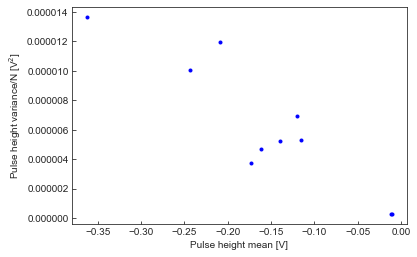

In [14]:
df_flasher = pd.read_csv("flasher_fwhm_pot2k.csv")

df_flasher_stat = pd.DataFrame(df_flasher.groupby('LEDs').describe())


df_sortV = df_flasher_stat['half_max_V'].sort_values(by=['mean'])
new_ind = df_sortV.index


plt.plot(df_flasher_stat.half_max_V.loc[new_ind, 'mean'], (df_flasher_stat.half_max_V.loc[new_ind, 'std'])**2/(df_flasher_stat.half_max_V.loc[new_ind, 'count']),
        marker='.', color='b', ls="")


plt.xlabel("Pulse height mean [V]")
plt.ylabel(r"Pulse height variance/N [V$^2$]")




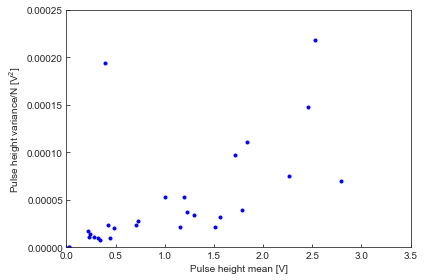

In [97]:
df_flasher_stat155 = pd.DataFrame(df_flasher155.groupby('LEDs').describe())

for df_ in [df_flasher_stat155, df_flasher_stat2, df_flasher_stat3, df_flasher_stat35]:
    plt.plot(df_.half_max_V['mean']*2, 
             -2*(df_.half_max_V['std'])**2/(df_.half_max_V['count']),
        marker='.', color='b', ls="")

plt.ylim(0,2.5e-4)
plt.xlim(0,3.5)

plt.xlabel("Pulse height mean [V]")
plt.ylabel(r"Pulse height variance/N [V$^2$]")
plt.tight_layout()
plt.savefig("flasher_var_vs_mean.png")


/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in sqrt
  after removing the cwd from sys.path.


<ErrorbarContainer object of 3 artists>

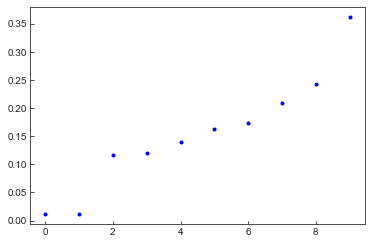

In [18]:
df_flasher_stat['half_max_V']=-df_flasher_stat['half_max_V']
df_sortV = df_flasher_stat['half_max_V'].sort_values(by=['mean'])
plt.errorbar(range(df_sortV.shape[0]), df_sortV['mean'].values, 
             yerr=df_sortV['std']/np.sqrt(df_sortV['count']), fmt='.', color='b', ecolor='b', capthick=0)

In [ ]:
df_flasher3 = pd.read_csv("flasher_fwhm_pot3k.csv")

df_flasher_stat3 = pd.DataFrame(df_flasher3.groupby('LEDs').describe())

df_flasher_stat3['half_max_V']=-df_flasher_stat3['half_max_V']
df_flasher_stat3['max_V']=2*df_flasher_stat3['half_max_V']



df_sortV3 = df_flasher_stat3['half_max_V'].sort_values(by=['mean'])
new_ind = df_sortV3.index


plt.errorbar(range(df_sortV3.shape[0]), df_sortV3['mean'].values, 
             yerr=df_sortV3['std']/np.sqrt(df_sortV3['count']), fmt='.', color='b', ecolor='b', capthick=0)


/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:19: RuntimeWarning: invalid value encountered in sqrt
/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:53: RuntimeWarning: invalid value encountered in sqrt
/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:56: RuntimeWarning: invalid value encountered in sqrt


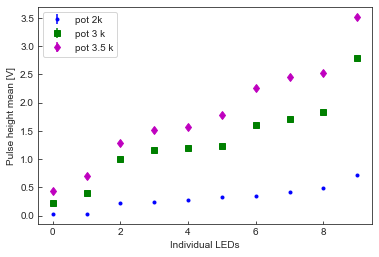

In [62]:

df_flasher2 = pd.read_csv("flasher_fwhm_pot2k.csv")

df_flasher_stat2 = pd.DataFrame(df_flasher2.groupby('LEDs').describe())

df_flasher_stat2['half_max_V']=-df_flasher_stat2['half_max_V']
#df_flasher_stat3['max_V']=2*df_flasher_stat3['half_max_V']



df_sortV2 = df_flasher_stat2['half_max_V'].sort_values(by=['mean'])
new_ind2 = df_sortV2.index





plt.errorbar(range(df_sortV2.shape[0]), df_sortV2['mean'].values*2, 
             yerr=df_sortV2['std']/np.sqrt(df_sortV2['count'])*np.sqrt(2), fmt='.', color='b', ecolor='b', capthick=0, label="pot 2k")





df_flasher3 = pd.read_csv("flasher_fwhm_pot3k.csv")

df_flasher_stat3 = pd.DataFrame(df_flasher3.groupby('LEDs').describe())

df_flasher_stat3['half_max_V']=-df_flasher_stat3['half_max_V']
#df_flasher_stat3['max_V']=2*df_flasher_stat3['half_max_V']



df_sortV3 = df_flasher_stat3['half_max_V'].sort_values(by=['mean'])
new_ind = df_sortV3.index

df_flasher35 = pd.read_csv("flasher_fwhm_pot3p5k.csv")

df_flasher_stat35 = pd.DataFrame(df_flasher35.groupby('LEDs').describe())

df_flasher_stat35['half_max_V']=-df_flasher_stat35['half_max_V']
#df_flasher_stat3['max_V']=2*df_flasher_stat3['half_max_V']



df_sortV35 = df_flasher_stat35['half_max_V'].sort_values(by=['mean'])
#new_ind35 = df_sortV35.index




plt.errorbar(range(df_sortV3.shape[0]), df_sortV3['mean'].values*2, 
             yerr=df_sortV3['std']/np.sqrt(df_sortV3['count'])*np.sqrt(2), fmt='s', color='g', ecolor='g', capthick=0, label="pot 3 k")

plt.errorbar(range(df_sortV35.shape[0]), df_sortV35['mean'].values*2, 
             yerr=df_sortV35['std']/np.sqrt(df_sortV35['count'])*np.sqrt(2), fmt='d', color='m', ecolor='m', capthick=0, label="pot 3.5 k")

plt.legend()
plt.xlabel("Individual LEDs")
plt.ylabel("Pulse height mean [V]")

#plt.yscale('log')
#plt.savefig("LED_light_2k_3k_3p5k_log.pdf")
plt.savefig("LED_light_2k_3k_3p5k.pdf")






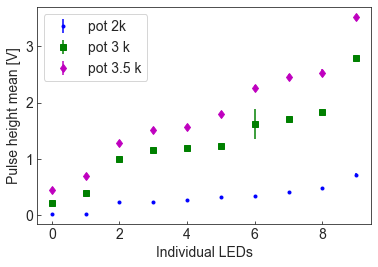

In [184]:

df_flasher2 = pd.read_csv("flasher_fwhm_pot2k.csv")

df_flasher_stat2 = pd.DataFrame(df_flasher2.groupby('LEDs').describe())

df_flasher_stat2['half_max_V']=-df_flasher_stat2['half_max_V']
#df_flasher_stat3['max_V']=2*df_flasher_stat3['half_max_V']



df_sortV2 = df_flasher_stat2['half_max_V'].sort_values(by=['mean'])
new_ind2 = df_sortV2.index





plt.errorbar(range(df_sortV2.shape[0]), df_sortV2['mean'].values*2, 
             yerr=df_sortV2['std']*np.sqrt(2), fmt='.', color='b', ecolor='b', capthick=0, label="pot 2k")





df_flasher3 = pd.read_csv("flasher_fwhm_pot3k.csv")

df_flasher_stat3 = pd.DataFrame(df_flasher3.groupby('LEDs').describe())

df_flasher_stat3['half_max_V']=-df_flasher_stat3['half_max_V']
#df_flasher_stat3['max_V']=2*df_flasher_stat3['half_max_V']



df_sortV3 = df_flasher_stat3['half_max_V'].sort_values(by=['mean'])
new_ind = df_sortV3.index

df_flasher35 = pd.read_csv("flasher_fwhm_pot3p5k.csv")

df_flasher_stat35 = pd.DataFrame(df_flasher35.groupby('LEDs').describe())

df_flasher_stat35['half_max_V']=-df_flasher_stat35['half_max_V']
#df_flasher_stat3['max_V']=2*df_flasher_stat3['half_max_V']



df_sortV35 = df_flasher_stat35['half_max_V'].sort_values(by=['mean'])
#new_ind35 = df_sortV35.index




plt.errorbar(range(df_sortV3.shape[0]), df_sortV3['mean'].values*2, 
             yerr=df_sortV3['std']*np.sqrt(2), fmt='s', color='g', ecolor='g', capthick=0, label="pot 3 k")

plt.errorbar(range(df_sortV35.shape[0]), df_sortV35['mean'].values*2, 
             yerr=df_sortV35['std']*np.sqrt(2), fmt='d', color='m', ecolor='m', capthick=0, label="pot 3.5 k")

plt.legend()
plt.xlabel("Individual LEDs")
plt.ylabel("Pulse height mean [V]")

#plt.yscale('log')
#plt.savefig("LED_light_2k_3k_3p5k_log.pdf")
plt.savefig("LED_light_2k_3k_3p5k_v2.pdf")







In [170]:
df_flasher155.head()

,LEDs,pot_value_ohm,FWHM_s,half_max_V,fit_trise_s,fit_tdecay_s,fit_peak_V,fit_tpeak_s,fit_baseline_V
0,1,1550.0,6.000000e-09,-0.044,3.677078e-09,5.024650e-09,0.103841,7.993043e-08,0.003308
1,1,1550.0,6.000000e-09,-0.054,3.061868e-09,3.848389e-09,0.130607,8.005918e-08,0.003102
2,1,1550.0,6.000000e-09,-0.064,4.163325e-09,3.993240e-09,0.157058,8.055273e-08,0.006952
3,1,1550.0,6.000000e-09,-0.048,3.861169e-09,3.579074e-09,0.119995,8.085088e-08,0.002791
4,1,1550.0,6.000000e-09,-0.054,3.394328e-09,4.455605e-09,0.134147,8.008797e-08,0.005277


In [171]:
df_flasher155.columns

Index(['LEDs', 'pot_value_ohm', 'FWHM_s', 'half_max_V', 'fit_trise_s',
       'fit_tdecay_s', 'fit_peak_V', 'fit_tpeak_s', 'fit_baseline_V'],
      dtype='object')

In [168]:
df_flasher_stat155

count                                          mean            ...   \
     count  mean std   min   25%   50%   75%   max count      mean  ...    
LEDs                                                                ...    
1      1.0 -20.0 NaN -20.0 -20.0 -20.0 -20.0 -20.0   1.0  1.264000  ...    
2      1.0 -20.0 NaN -20.0 -20.0 -20.0 -20.0 -20.0   1.0  0.894500  ...    
3      1.0 -20.0 NaN -20.0 -20.0 -20.0 -20.0 -20.0   1.0  1.230000  ...    
4      1.0 -20.0 NaN -20.0 -20.0 -20.0 -20.0 -20.0   1.0  0.221500  ...    
5      1.0 -20.0 NaN -20.0 -20.0 -20.0 -20.0 -20.0   1.0  0.353000  ...    
6      1.0 -20.0 NaN -20.0 -20.0 -20.0 -20.0 -20.0   1.0  0.754500  ...    
7      1.0 -20.0 NaN -20.0 -20.0 -20.0 -20.0 -20.0   1.0  1.760000  ...    
8      1.0 -20.0 NaN -20.0 -20.0 -20.0 -20.0 -20.0   1.0  0.780500  ...    
9      1.0 -20.0 NaN -20.0 -20.0 -20.0 -20.0 -20.0   1.0  1.133000  ...    
10     1.0 -19.0 NaN -19.0 -19.0 -19.0 -19.0 -19.0   1.0  0.646316  ...    

         75%           max                                          
         75%     max count  mean std   min   25%   50%   75%   max  
LEDs                                                                
1     1.2400  1.2400   1.0  1.20 NaN  1.20  1.20  1.20  1.20  1.20  
2     0.8800  0.8800   1.0  0.86 NaN  0.86  0.86  0.86  0.86  0.86  
3     1.2000  1.2000   1.0  1.16 NaN  1.16  1.16  1.16  1.16  1.16  
4     0.2175  0.2175   1.0  0.20 NaN  0.20  0.20  0.20  0.20  0.20  
5     0.3400  0.3400   1.0  0.32 NaN  0.32  0.32  0.32  0.32  0.32  
6     0.7400  0.7400   1.0  0.72 NaN  0.72  0.72  0.72  0.72  0.72  
7     1.7600  1.7600   1.0  1.76 NaN  1.76  1.76  1.76  1.76  1.76  
8     0.7675  0.7675   1.0  0.75 NaN  0.75  0.75  0.75  0.75  0.75  
9     1.1175  1.1175   1.0  1.08 NaN  1.08  1.08  1.08  1.08  1.08  
10    0.6400  0.6400   1.0  0.60 NaN  0.60  0.60  0.60  0.60  0.60  

[10 rows x 64 columns]

In [172]:
df_flasher_stat155

count                                          mean            ...   \
     count  mean std   min   25%   50%   75%   max count      mean  ...    
LEDs                                                                ...    
1      1.0 -20.0 NaN -20.0 -20.0 -20.0 -20.0 -20.0   1.0  1.264000  ...    
2      1.0 -20.0 NaN -20.0 -20.0 -20.0 -20.0 -20.0   1.0  0.894500  ...    
3      1.0 -20.0 NaN -20.0 -20.0 -20.0 -20.0 -20.0   1.0  1.230000  ...    
4      1.0 -20.0 NaN -20.0 -20.0 -20.0 -20.0 -20.0   1.0  0.221500  ...    
5      1.0 -20.0 NaN -20.0 -20.0 -20.0 -20.0 -20.0   1.0  0.353000  ...    
6      1.0 -20.0 NaN -20.0 -20.0 -20.0 -20.0 -20.0   1.0  0.754500  ...    
7      1.0 -20.0 NaN -20.0 -20.0 -20.0 -20.0 -20.0   1.0  1.760000  ...    
8      1.0 -20.0 NaN -20.0 -20.0 -20.0 -20.0 -20.0   1.0  0.780500  ...    
9      1.0 -20.0 NaN -20.0 -20.0 -20.0 -20.0 -20.0   1.0  1.133000  ...    
10     1.0 -19.0 NaN -19.0 -19.0 -19.0 -19.0 -19.0   1.0  0.646316  ...    

         75%           max                                          
         75%     max count  mean std   min   25%   50%   75%   max  
LEDs                                                                
1     1.2400  1.2400   1.0  1.20 NaN  1.20  1.20  1.20  1.20  1.20  
2     0.8800  0.8800   1.0  0.86 NaN  0.86  0.86  0.86  0.86  0.86  
3     1.2000  1.2000   1.0  1.16 NaN  1.16  1.16  1.16  1.16  1.16  
4     0.2175  0.2175   1.0  0.20 NaN  0.20  0.20  0.20  0.20  0.20  
5     0.3400  0.3400   1.0  0.32 NaN  0.32  0.32  0.32  0.32  0.32  
6     0.7400  0.7400   1.0  0.72 NaN  0.72  0.72  0.72  0.72  0.72  
7     1.7600  1.7600   1.0  1.76 NaN  1.76  1.76  1.76  1.76  1.76  
8     0.7675  0.7675   1.0  0.75 NaN  0.75  0.75  0.75  0.75  0.75  
9     1.1175  1.1175   1.0  1.08 NaN  1.08  1.08  1.08  1.08  1.08  
10    0.6400  0.6400   1.0  0.60 NaN  0.60  0.60  0.60  0.60  0.60  

[10 rows x 64 columns]

In [178]:
df_flasher155.LEDs.unique()

array(['1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '9_10',
       '8_9_10', '1_10', '2_10', '4_10', '3_10', '5_10', '1_2', '1_3',
       '1_4', '1_5', '4_5', '3_5', '2_5', '2_4', '2_3', '7_8_9_10',
       '6_7_8_9_10'], dtype=object)

In [181]:
df_flasher155_10LEDs = df_flasher155[df_flasher155.LEDs.isin(['1','2','3','4','5','6','7','8','9','10'])]

/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:26: RuntimeWarning: invalid value encountered in sqrt
/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:31: RuntimeWarning: invalid value encountered in sqrt
/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:67: RuntimeWarning: invalid value encountered in sqrt
/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: invalid value encountered in sqrt


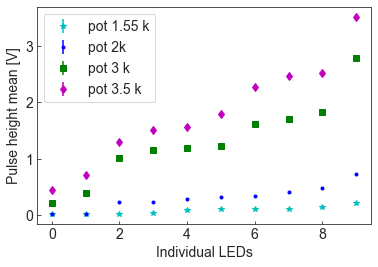

In [182]:

df_flasher2 = pd.read_csv("flasher_fwhm_pot2k.csv")

df_flasher_stat2 = pd.DataFrame(df_flasher2.groupby('LEDs').describe())

df_flasher_stat2['half_max_V']=-df_flasher_stat2['half_max_V']
#df_flasher_stat3['max_V']=2*df_flasher_stat3['half_max_V']



df_sortV2 = df_flasher_stat2['half_max_V'].sort_values(by=['mean'])
new_ind2 = df_sortV2.index



df_flasher_stat155 = pd.DataFrame(df_flasher155_10LEDs.groupby('LEDs').describe())

df_flasher_stat155['half_max_V']=-df_flasher_stat155['half_max_V']
#df_flasher_stat3['max_V']=2*df_flasher_stat3['half_max_V']



df_flasher_stat155 = df_flasher_stat155['half_max_V'].sort_values(by=['mean'])
#new_ind35 = df_sortV35.index
plt.errorbar(range(df_flasher_stat155.shape[0]), df_flasher_stat155['mean'].values*2, 
             yerr=df_flasher_stat155['std']/np.sqrt(df_flasher_stat155['count'])*np.sqrt(2), fmt='*', color='c', ecolor='c', capthick=0, label="pot 1.55 k")



plt.errorbar(range(df_sortV2.shape[0]), df_sortV2['mean'].values*2, 
             yerr=df_sortV2['std']/np.sqrt(df_sortV2['count'])*np.sqrt(2), fmt='.', color='b', ecolor='b', capthick=0, label="pot 2k")





df_flasher3 = pd.read_csv("flasher_fwhm_pot3k.csv")

df_flasher_stat3 = pd.DataFrame(df_flasher3.groupby('LEDs').describe())

df_flasher_stat3['half_max_V']=-df_flasher_stat3['half_max_V']
#df_flasher_stat3['max_V']=2*df_flasher_stat3['half_max_V']



df_sortV3 = df_flasher_stat3['half_max_V'].sort_values(by=['mean'])
new_ind = df_sortV3.index

df_flasher35 = pd.read_csv("flasher_fwhm_pot3p5k.csv")

df_flasher_stat35 = pd.DataFrame(df_flasher35.groupby('LEDs').describe())

df_flasher_stat35['half_max_V']=-df_flasher_stat35['half_max_V']
#df_flasher_stat3['max_V']=2*df_flasher_stat3['half_max_V']



df_sortV35 = df_flasher_stat35['half_max_V'].sort_values(by=['mean'])
#new_ind35 = df_sortV35.index






plt.errorbar(range(df_sortV3.shape[0]), df_sortV3['mean'].values*2, 
             yerr=df_sortV3['std']/np.sqrt(df_sortV3['count'])*np.sqrt(2), fmt='s', color='g', ecolor='g', capthick=0, label="pot 3 k")

plt.errorbar(range(df_sortV35.shape[0]), df_sortV35['mean'].values*2, 
             yerr=df_sortV35['std']/np.sqrt(df_sortV35['count'])*np.sqrt(2), fmt='d', color='m', ecolor='m', capthick=0, label="pot 3.5 k")


plt.legend()
plt.xlabel("Individual LEDs")
plt.ylabel("Pulse height mean [V]")

#plt.yscale('log')
#plt.savefig("LED_light_2k_3k_3p5k_log.pdf")
plt.savefig("LED_light_1p55k_2k_3k_3p5k.pdf")







/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:26: RuntimeWarning: invalid value encountered in sqrt
/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:31: RuntimeWarning: invalid value encountered in sqrt
/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:67: RuntimeWarning: invalid value encountered in sqrt
/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:70: RuntimeWarning: invalid value encountered in sqrt


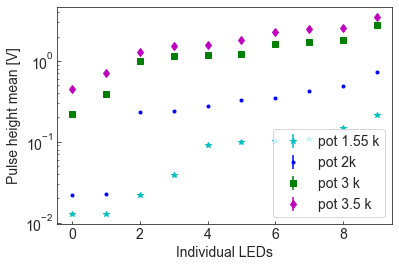

In [183]:

df_flasher2 = pd.read_csv("flasher_fwhm_pot2k.csv")

df_flasher_stat2 = pd.DataFrame(df_flasher2.groupby('LEDs').describe())

df_flasher_stat2['half_max_V']=-df_flasher_stat2['half_max_V']
#df_flasher_stat3['max_V']=2*df_flasher_stat3['half_max_V']



df_sortV2 = df_flasher_stat2['half_max_V'].sort_values(by=['mean'])
new_ind2 = df_sortV2.index



df_flasher_stat155 = pd.DataFrame(df_flasher155_10LEDs.groupby('LEDs').describe())

df_flasher_stat155['half_max_V']=-df_flasher_stat155['half_max_V']
#df_flasher_stat3['max_V']=2*df_flasher_stat3['half_max_V']



df_flasher_stat155 = df_flasher_stat155['half_max_V'].sort_values(by=['mean'])
#new_ind35 = df_sortV35.index
plt.errorbar(range(df_flasher_stat155.shape[0]), df_flasher_stat155['mean'].values*2, 
             yerr=df_flasher_stat155['std']/np.sqrt(df_flasher_stat155['count'])*np.sqrt(2), fmt='*', color='c', ecolor='c', capthick=0, label="pot 1.55 k")



plt.errorbar(range(df_sortV2.shape[0]), df_sortV2['mean'].values*2, 
             yerr=df_sortV2['std']/np.sqrt(df_sortV2['count'])*np.sqrt(2), fmt='.', color='b', ecolor='b', capthick=0, label="pot 2k")





df_flasher3 = pd.read_csv("flasher_fwhm_pot3k.csv")

df_flasher_stat3 = pd.DataFrame(df_flasher3.groupby('LEDs').describe())

df_flasher_stat3['half_max_V']=-df_flasher_stat3['half_max_V']
#df_flasher_stat3['max_V']=2*df_flasher_stat3['half_max_V']



df_sortV3 = df_flasher_stat3['half_max_V'].sort_values(by=['mean'])
new_ind = df_sortV3.index

df_flasher35 = pd.read_csv("flasher_fwhm_pot3p5k.csv")

df_flasher_stat35 = pd.DataFrame(df_flasher35.groupby('LEDs').describe())

df_flasher_stat35['half_max_V']=-df_flasher_stat35['half_max_V']
#df_flasher_stat3['max_V']=2*df_flasher_stat3['half_max_V']



df_sortV35 = df_flasher_stat35['half_max_V'].sort_values(by=['mean'])
#new_ind35 = df_sortV35.index






plt.errorbar(range(df_sortV3.shape[0]), df_sortV3['mean'].values*2, 
             yerr=df_sortV3['std']/np.sqrt(df_sortV3['count'])*np.sqrt(2), fmt='s', color='g', ecolor='g', capthick=0, label="pot 3 k")

plt.errorbar(range(df_sortV35.shape[0]), df_sortV35['mean'].values*2, 
             yerr=df_sortV35['std']/np.sqrt(df_sortV35['count'])*np.sqrt(2), fmt='d', color='m', ecolor='m', capthick=0, label="pot 3.5 k")


plt.legend()
plt.xlabel("Individual LEDs")
plt.ylabel("Pulse height mean [V]")

plt.yscale('log')
plt.savefig("LED_light_1p55k_2k_3k_3p5k_log.pdf")
#plt.savefig("LED_light_1p55k_2k_3k_3p5k.pdf")








/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


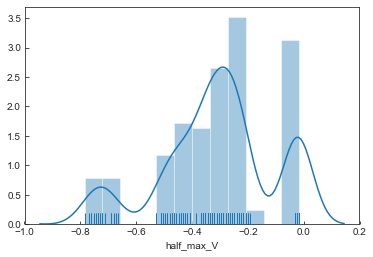

In [34]:
sns.distplot(df_flasher2.half_max_V*2,rug=True)

/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


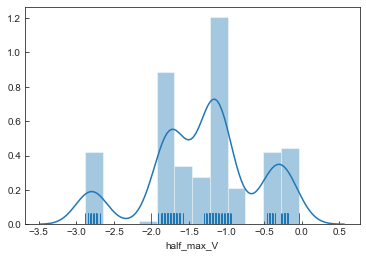

In [35]:
sns.distplot(df_flasher3.half_max_V*2,rug=True)

/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


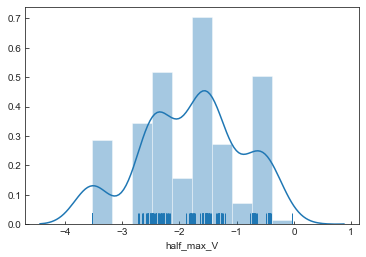

In [36]:
sns.distplot(df_flasher35.half_max_V*2,rug=True)


In [51]:
df_flasher_stat2

FWHM_s                                                          \
      count          mean           std           min           25%   
LEDs                                                                  
1      20.0  7.450000e-09  6.048053e-10  7.000000e-09  7.000000e-09   
2      20.0  7.150000e-09  7.451598e-10  6.000000e-09  7.000000e-09   
3      20.0  7.100000e-09  6.407233e-10  6.000000e-09  7.000000e-09   
4      20.0  1.474500e-07  3.945881e-08  6.400000e-08  1.305000e-07   
5      20.0  1.382500e-07  4.543460e-08  3.000000e-09  1.087500e-07   
6      20.0  7.900000e-09  7.181848e-10  7.000000e-09  7.000000e-09   
7      20.0  8.200000e-09  4.103913e-10  8.000000e-09  8.000000e-09   
8      20.0  8.050000e-09  6.863327e-10  7.000000e-09  8.000000e-09   
9      20.0  7.850000e-09  4.893605e-10  7.000000e-09  8.000000e-09   
10     20.0  8.350000e-09  6.708204e-10  7.000000e-09  8.000000e-09   

                                               fit_baseline_V            \
               50%           75%           max          count      mean   
LEDs                                                                      
1     7.000000e-09  8.000000e-09  9.000000e-09           20.0 -0.003111   
2     7.000000e-09  7.250000e-09  9.000000e-09           20.0 -0.003686   
3     7.000000e-09  7.250000e-09  8.000000e-09           20.0 -0.003607   
4     1.520000e-07  1.792500e-07  1.950000e-07           20.0 -0.004521   
5     1.465000e-07  1.737500e-07  1.900000e-07           20.0 -0.004340   
6     8.000000e-09  8.000000e-09  9.000000e-09           20.0 -0.002909   
7     8.000000e-09  8.000000e-09  9.000000e-09           20.0 -0.002663   
8     8.000000e-09  8.250000e-09  9.000000e-09           20.0 -0.003808   
9     8.000000e-09  8.000000e-09  9.000000e-09           20.0 -0.003342   
10    8.000000e-09  9.000000e-09  9.000000e-09           20.0 -0.003327   

       ...   half_max_V        pot_value_ohm                               \
       ...          75%    max         count    mean  std     min     25%   
LEDs   ...                                                                  
1      ...        0.204  0.168          20.0  2000.0  0.0  2000.0  2000.0   
2      ...        0.111  0.096          20.0  2000.0  0.0  2000.0  2000.0   
3      ...        0.111  0.100          20.0  2000.0  0.0  2000.0  2000.0   
4      ...        0.008  0.008          20.0  2000.0  0.0  2000.0  2000.0   
5      ...        0.011  0.008          20.0  2000.0  0.0  2000.0  2000.0   
6      ...        0.155  0.144          20.0  2000.0  0.0  2000.0  2000.0   
7      ...        0.353  0.332          20.0  2000.0  0.0  2000.0  2000.0   
8      ...        0.172  0.152          20.0  2000.0  0.0  2000.0  2000.0   
9      ...        0.235  0.216          20.0  2000.0  0.0  2000.0  2000.0   
10     ...        0.135  0.124          20.0  2000.0  0.0  2000.0  2000.0   

                              
         50%     75%     max  
LEDs                          
1     2000.0  2000.0  2000.0  
2     2000.0  2000.0  2000.0  
3     2000.0  2000.0  2000.0  
4     2000.0  2000.0  2000.0  
5     2000.0  2000.0  2000.0  
6     2000.0  2000.0  2000.0  
7     2000.0  2000.0  2000.0  
8     2000.0  2000.0  2000.0  
9     2000.0  2000.0  2000.0  
10    2000.0  2000.0  2000.0  

[10 rows x 64 columns]

/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


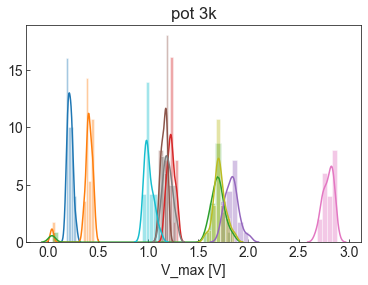

In [125]:
for ii, i in enumerate([4,5,3,2,1,6,7,8,9,10]):
    sns.distplot(-df_flasher3[df_flasher3.LEDs==i].half_max_V*2,rug=False, axlabel="V_max [V]")#, label="LED {}".format(ii+1))
#plt.legend(ncol=2)
plt.title("pot 3k")
plt.savefig("flasher_level_3k.png")

/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


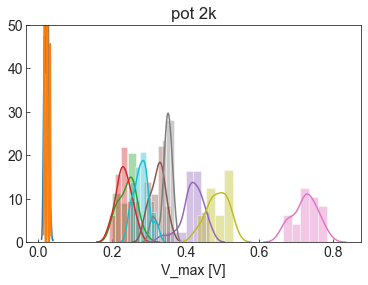

In [124]:
for ii, i in enumerate([4,5,3,2,1,6,7,8,9,10]):
    sns.distplot(-df_flasher2[df_flasher2.LEDs==i].half_max_V*2,rug=False, axlabel="V_max [V]")#, label="LED {}".format(ii+1))
#plt.legend(ncol=2)
plt.ylim(0,50)
plt.title("pot 2k")
plt.savefig("flasher_level_2k.png")

/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval
/anaconda3/lib/python3.7/site-packages/statsmodels/nonparametric/kde.py:488: RuntimeWarning: invalid value encountered in true_divide
  binned = fast_linbin(X, a, b, gridsize) / (delta * nobs)
/anaconda3/lib/python3.7/site-packages/statsmodels/nonparametric/kdetools.py:34: RuntimeWarning: invalid value encountered in double_scalars
  FAC1 = 2*(np.pi*bw/RANGE)**2
/anaconda3/lib/python3.7/site-packages/numpy/core/fromnumeric.py:83: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)


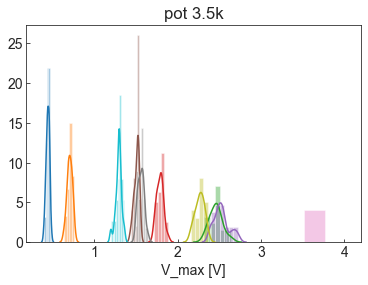

In [123]:
for ii, i in enumerate([4,5,3,2,1,6,7,8,9,10]):
    sns.distplot(-df_flasher35[df_flasher35.LEDs==i].half_max_V*2,rug=False, axlabel="V_max [V]")#, label="LED {}".format(ii+1))
#plt.legend(ncol=2)
#plt.ylim(0,50)
plt.title("pot 3.5k")
plt.savefig("flasher_level_3p5k.png")

In [71]:
df_flasher155=pd.read_csv("flasher_fwhm.csv")
df_flasher155_10LEDs = df_flasher155[df_flasher155.LEDs.isin(['1','2','3','4','5','6','7','8','9','10'])]

/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


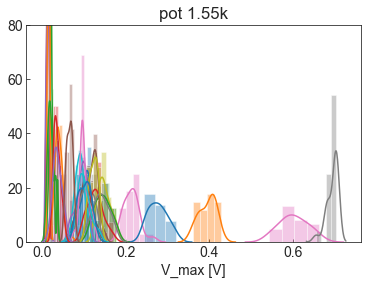

In [122]:
for l in df_flasher155.LEDs.unique():
    sns.distplot(-df_flasher155[df_flasher155.LEDs==l].half_max_V*2,rug=False, axlabel="V_max [V]")#, label="LED {}".format(ii+1))
#plt.legend(ncol=2)
plt.ylim(0,80)
plt.title("pot 1.55k")
plt.savefig("flasher_level_1p55k.png")

/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


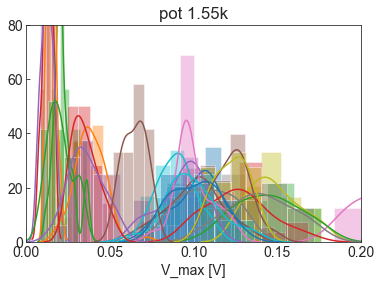

In [164]:
for l in df_flasher155.LEDs.unique():
    sns.distplot(-df_flasher155[df_flasher155.LEDs==l].half_max_V*2,rug=False, axlabel="V_max [V]")#, label="LED {}".format(ii+1))
#plt.legend(ncol=2)
plt.ylim(0,80)
plt.xlim(0,0.2)

plt.title("pot 1.55k")
plt.savefig("flasher_level_1p55k_zoom.png")

In [98]:
df_flasher2.columns

Index(['LEDs', 'pot_value_ohm', 'FWHM_s', 'half_max_V', 'fit_trise_s',
       'fit_tdecay_s', 'fit_peak_V', 'fit_tpeak_s', 'fit_baseline_V'],
      dtype='object')

/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


Text(0.5,1,'pot 2k')

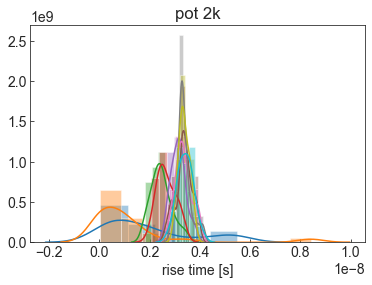

In [121]:
for ii, i in enumerate([4,5,3,2,1,6,7,8,9,10]):
    sns.distplot(df_flasher2[df_flasher2.LEDs==i].fit_trise_s,rug=False, axlabel="rise time [s]")#, label="LED {}".format(ii+1))
#plt.legend(ncol=2)
#plt.ylim(0,50)
plt.title("pot 2k")
#plt.savefig("flasher_level_2k.png")

/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


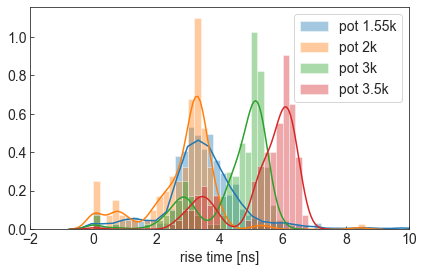

In [126]:
for df_, lab_ in zip([df_flasher155, df_flasher2,df_flasher3,df_flasher35], ["pot 1.55k","pot 2k","pot 3k","pot 3.5k"]):
    sns.distplot(df_.fit_trise_s*1e9,rug=False, axlabel="rise time [ns]", label=lab_, 
                bins=np.arange(-2,10,0.2))


plt.legend()
plt.tight_layout()
plt.xlim(-2,10)
plt.savefig("rise_time.png")

/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


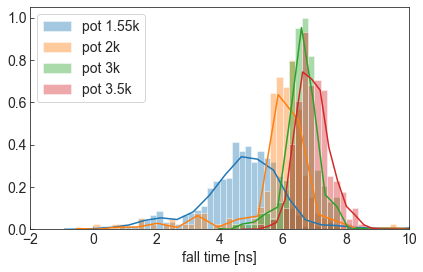

In [127]:
for df_, lab_ in zip([df_flasher155, df_flasher2,df_flasher3,df_flasher35], ["pot 1.55k","pot 2k","pot 3k","pot 3.5k"]):
    sns.distplot(df_.fit_tdecay_s*1e9,rug=False, axlabel="fall time [ns]", label=lab_,
                                 bins=np.arange(-2,10,0.2))




plt.legend()
plt.tight_layout()
plt.xlim(-2,10)
plt.savefig("fall_time.png")

/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


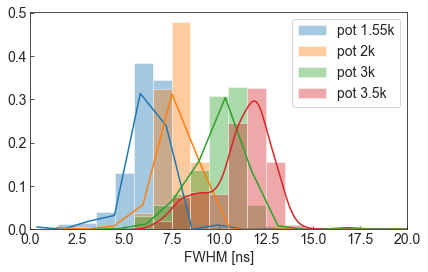

In [138]:
for df_, lab_ in zip([df_flasher155, df_flasher2,df_flasher3,df_flasher35], ["pot 1.55k","pot 2k","pot 3k","pot 3.5k"]):
    sns.distplot(df_.FWHM_s*1e9,rug=False, axlabel="FWHM [ns]", label=lab_,
                bins=np.arange(0.5,20.5,1))




plt.legend()
plt.tight_layout()
plt.xlim(0,20)
plt.savefig("fwhm.png")

/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


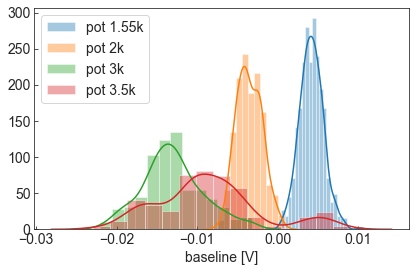

In [117]:
plt.rcParams.update({'font.size': 14})

for df_, lab_ in zip([df_flasher155, df_flasher2,df_flasher3,df_flasher35], ["pot 1.55k","pot 2k","pot 3k","pot 3.5k"]):
    sns.distplot(df_.fit_baseline_V,rug=False, axlabel="baseline [V]", label=lab_)


plt.legend()
plt.tight_layout()
#plt.xlim(0,20)
plt.savefig("baseline.png")

# trace avg: 

In [141]:
import glob

for ii, i in enumerate([4,5,3,2,1,6,7,8,9,10]):
    for f_ in glob.iglob('flasher_data/pot_2k/LED{}*.csv'.format(i)):
        print(f_)
        break
    

flasher_data/pot_2k/LED4_pot2k_trace_5.csv
flasher_data/pot_2k/LED5_pot2k_trace_3.csv
flasher_data/pot_2k/LED3_pot2k_trace_10.csv
flasher_data/pot_2k/LED2_pot2k_trace_0.csv
flasher_data/pot_2k/LED1_pot2k_trace_19.csv
flasher_data/pot_2k/LED6_pot2k_trace_5.csv
flasher_data/pot_2k/LED7_pot2k_trace_3.csv
flasher_data/pot_2k/LED8_pot2k_trace_15.csv
flasher_data/pot_2k/LED9_pot2k_trace_18.csv
flasher_data/pot_2k/LED10_pot2k_trace_19.csv


In [185]:
df_ = pd.read_csv(f_)
df_

,Unnamed: 0,T,V
0,0,4.000001e-10,-0.008
1,1,1.400000e-09,-0.008
2,2,2.400000e-09,-0.008
3,3,3.400000e-09,-0.008
4,4,4.400000e-09,0.000
5,5,5.400000e-09,0.000
6,6,6.400000e-09,0.000
7,7,7.400000e-09,0.000
8,8,8.400000e-09,0.000
9,9,9.400000e-09,-0.008


In [8]:
def process_csv(csv_file="flasher_fwhm_pot4k_diffuser.csv"):
    df_flasher35 = pd.read_csv(csv_file)
    df_flasher_stat35 = pd.DataFrame(df_flasher35.groupby('LEDs').describe())
    df_flasher_stat35['half_max_V']=-df_flasher_stat35['half_max_V']
    #df_flasher_stat35['max_V']=2*df_flasher_stat35['half_max_V']
    df_sortV35 = df_flasher_stat35['half_max_V'].sort_values(by=['mean'])
    return df_flasher35, df_flasher_stat35, df_sortV35



/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:28: RuntimeWarning: invalid value encountered in sqrt
/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:33: RuntimeWarning: invalid value encountered in sqrt
/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:69: RuntimeWarning: invalid value encountered in sqrt
/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:72: RuntimeWarning: invalid value encountered in sqrt
/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:85: RuntimeWarning: invalid value encountered in sqrt


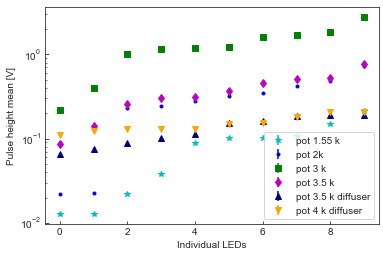

In [31]:
df_flasher155=pd.read_csv("flasher_fwhm.csv")
df_flasher155_10LEDs = df_flasher155[df_flasher155.LEDs.isin(['1','2','3','4','5','6','7','8','9','10'])]

df_flasher2 = pd.read_csv("flasher_fwhm_pot2k.csv")

df_flasher_stat2 = pd.DataFrame(df_flasher2.groupby('LEDs').describe())

df_flasher_stat2['half_max_V']=-df_flasher_stat2['half_max_V']
#df_flasher_stat3['max_V']=2*df_flasher_stat3['half_max_V']



df_sortV2 = df_flasher_stat2['half_max_V'].sort_values(by=['mean'])
new_ind2 = df_sortV2.index



df_flasher_stat155 = pd.DataFrame(df_flasher155_10LEDs.groupby('LEDs').describe())

df_flasher_stat155['half_max_V']=-df_flasher_stat155['half_max_V']
#df_flasher_stat3['max_V']=2*df_flasher_stat3['half_max_V']



df_flasher_stat155 = df_flasher_stat155['half_max_V'].sort_values(by=['mean'])
#new_ind35 = df_sortV35.index
plt.errorbar(range(df_flasher_stat155.shape[0]), df_flasher_stat155['mean'].values*2, 
             yerr=df_flasher_stat155['std']/np.sqrt(df_flasher_stat155['count'])*np.sqrt(2), fmt='*', color='c', ecolor='c', capthick=0, label="pot 1.55 k")



plt.errorbar(range(df_sortV2.shape[0]), df_sortV2['mean'].values*2, 
             yerr=df_sortV2['std']/np.sqrt(df_sortV2['count'])*np.sqrt(2), fmt='.', color='b', ecolor='b', capthick=0, label="pot 2k")





df_flasher3 = pd.read_csv("flasher_fwhm_pot3k.csv")

df_flasher_stat3 = pd.DataFrame(df_flasher3.groupby('LEDs').describe())

df_flasher_stat3['half_max_V']=-df_flasher_stat3['half_max_V']
#df_flasher_stat3['max_V']=2*df_flasher_stat3['half_max_V']



df_sortV3 = df_flasher_stat3['half_max_V'].sort_values(by=['mean'])
new_ind = df_sortV3.index

df_flasher35 = pd.read_csv("flasher_fwhm_pot3p5k.csv")

df_flasher_stat35 = pd.DataFrame(df_flasher35.groupby('LEDs').describe())

df_flasher_stat35['half_max_V']=-df_flasher_stat35['half_max_V']
#df_flasher_stat3['max_V']=2*df_flasher_stat3['half_max_V']



df_sortV35 = df_flasher_stat35['half_max_V'].sort_values(by=['mean'])
#new_ind35 = df_sortV35.index






plt.errorbar(range(df_sortV3.shape[0]), df_sortV3['mean'].values*2, 
             yerr=df_sortV3['std']/np.sqrt(df_sortV3['count'])*np.sqrt(2), fmt='s', color='g', ecolor='g', capthick=0, label="pot 3 k")

plt.errorbar(range(df_sortV35.shape[0]), df_sortV35['mean'].values*2, 
             yerr=df_sortV35['std']/np.sqrt(df_sortV35['count'])*np.sqrt(2), fmt='d', color='m', ecolor='m', capthick=0, label="pot 3.5 k")


df_flasherdiff35, df_flasher_statdiff35, df_sortVdiff35 = process_csv(csv_file="flasher_fwhm_pot3p5k_diffuser.csv")

plt.errorbar(range(df_sortVdiff35.shape[0]), df_sortVdiff35['mean'].values*2, 
             yerr=df_sortVdiff35['std'], fmt='^', color='navy', ecolor='navy', capthick=0, label="pot 3.5 k diffuser")


df_flasher4, df_flasher_stat4, df_sortV4 = process_csv(csv_file="flasher_fwhm_pot4k_diffuser.csv")


plt.errorbar(range(df_sortV4.shape[0]), df_sortV4['mean'].values*2, 
             yerr=df_sortV4['std']/np.sqrt(df_sortV4['count'])*np.sqrt(2), fmt='v', color='orange', ecolor='orange', capthick=0, label="pot 4 k diffuser")



plt.legend()
plt.xlabel("Individual LEDs")
plt.ylabel("Pulse height mean [V]")

plt.yscale('log')
#plt.savefig("LED_light_2k_3k_3p5k_log.pdf")
#plt.savefig("LED_light_1p55k_2k_3k_3p5k.pdf")








Text(0,0.5,'Pulse height mean [V]')

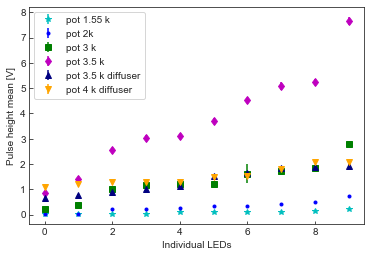

In [51]:
# std as error
df_flasher155=pd.read_csv("flasher_fwhm.csv")
df_flasher155_10LEDs = df_flasher155[df_flasher155.LEDs.isin(['1','2','3','4','5','6','7','8','9','10'])]

df_flasher2 = pd.read_csv("flasher_fwhm_pot2k.csv")

df_flasher_stat2 = pd.DataFrame(df_flasher2.groupby('LEDs').describe())

df_flasher_stat2['half_max_V']=-df_flasher_stat2['half_max_V']
#df_flasher_stat3['max_V']=2*df_flasher_stat3['half_max_V']



df_sortV2 = df_flasher_stat2['half_max_V'].sort_values(by=['mean'])
new_ind2 = df_sortV2.index



df_flasher_stat155 = pd.DataFrame(df_flasher155_10LEDs.groupby('LEDs').describe())

df_flasher_stat155['half_max_V']=-df_flasher_stat155['half_max_V']
#df_flasher_stat3['max_V']=2*df_flasher_stat3['half_max_V']



df_flasher_stat155 = df_flasher_stat155['half_max_V'].sort_values(by=['mean'])
#new_ind35 = df_sortV35.index



df_flasher3 = pd.read_csv("flasher_fwhm_pot3k.csv")

df_flasher_stat3 = pd.DataFrame(df_flasher3.groupby('LEDs').describe())

df_flasher_stat3['half_max_V']=-df_flasher_stat3['half_max_V']
#df_flasher_stat3['max_V']=2*df_flasher_stat3['half_max_V']



df_sortV3 = df_flasher_stat3['half_max_V'].sort_values(by=['mean'])
new_ind = df_sortV3.index

df_flasher35 = pd.read_csv("flasher_fwhm_pot3p5k.csv")

df_flasher_stat35 = pd.DataFrame(df_flasher35.groupby('LEDs').describe())

df_flasher_stat35['half_max_V']=-df_flasher_stat35['half_max_V']
#df_flasher_stat3['max_V']=2*df_flasher_stat3['half_max_V']



df_sortV35 = df_flasher_stat35['half_max_V'].sort_values(by=['mean'])
#new_ind35 = df_sortV35.index




plt.errorbar(range(df_flasher_stat155.shape[0]), df_flasher_stat155['mean'].values*2, 
             yerr=df_flasher_stat155['std']*2, fmt='*', color='c', ecolor='c', capthick=0, label="pot 1.55 k")



plt.errorbar(range(df_sortV2.shape[0]), df_sortV2['mean'].values*2, 
             yerr=df_sortV2['std']*2, fmt='.', color='b', ecolor='b', capthick=0, label="pot 2k")



plt.errorbar(range(df_sortV3.shape[0]), df_sortV3['mean'].values*2, 
             yerr=df_sortV3['std']*2, fmt='s', color='g', ecolor='g', capthick=0, label="pot 3 k")

plt.errorbar(range(df_sortV35.shape[0]), df_sortV35['mean'].values*20, 
             yerr=df_sortV35['std']*20, fmt='d', color='m', ecolor='m', capthick=0, label="pot 3.5 k")


df_flasherdiff35, df_flasher_statdiff35, df_sortVdiff35 = process_csv(csv_file="flasher_fwhm_pot3p5k_diffuser.csv")

plt.errorbar(range(df_sortVdiff35.shape[0]), df_sortVdiff35['mean'].values*20, 
             yerr=df_sortVdiff35['std']*20, fmt='^', color='navy', ecolor='navy', capthick=0, label="pot 3.5 k diffuser")


df_flasher4, df_flasher_stat4, df_sortV4 = process_csv(csv_file="flasher_fwhm_pot4k_diffuser.csv")


plt.errorbar(range(df_sortV4.shape[0]), df_sortV4['mean'].values*20, 
             yerr=df_sortV4['std']*np.sqrt(20), fmt='v', color='orange', ecolor='orange', capthick=0, label="pot 4 k diffuser")



plt.legend()
plt.xlabel("Individual LEDs")
plt.ylabel("Pulse height mean [V]")

#plt.yscale('log')
#plt.savefig("LED_light_2k_3k_3p5k_log.pdf")
#plt.savefig("LED_light_1p55k_2k_3k_3p5k.pdf")










Text(0,0.5,'Pulse height mean [V]')

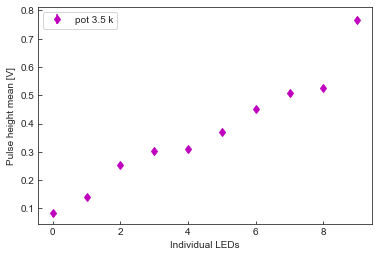

In [42]:
plt.errorbar(range(df_sortV35.shape[0]), df_sortV35['mean'].values*2, 
             yerr=df_sortV35['std']*np.sqrt(2), fmt='d', color='m', ecolor='m', capthick=0, label="pot 3.5 k")



plt.legend()
plt.xlabel("Individual LEDs")
plt.ylabel("Pulse height mean [V]")



Text(0,0.5,'Pulse height mean [V]')

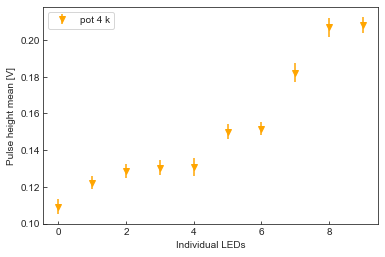

In [43]:
plt.errorbar(range(df_sortV4.shape[0]), df_sortV4['mean'].values*2, 
             yerr=df_sortV4['std']*np.sqrt(2), fmt='v', color='orange', ecolor='orange', capthick=0, label="pot 4 k")



plt.legend()
plt.xlabel("Individual LEDs")
plt.ylabel("Pulse height mean [V]")




In [9]:
# lo:  L2 L5 L7 L9 L10 0  1  1
# hi:  L1 L3 L4 L6 L8  1  1  1
def plot_LED_hist(df_flasher35, title="pot 3.5k", outfile="flasher_level_3p5k_Feb8.png", 
                 show_label=True, ylim=None, 
                 bins=None):
    for ii, i in enumerate([6,1,7,8,2,9,3,10,4,5]):
    #for ii, i in enumerate([4,5,3,2,1,6,7,8,9,10]):
        if show_label:
            sns.distplot(-df_flasher35[df_flasher35.LEDs==i].half_max_V*2, bins=bins, rug=False, axlabel="V_max [V]", label="LED {}".format(ii+1))
        else:
            sns.distplot(-df_flasher35[df_flasher35.LEDs==i].half_max_V*2, bins=bins, rug=False, axlabel="V_max [V]")#, label="LED {}".format(ii+1))
    if show_label:
        plt.legend(ncol=2)
    if ylim is not None:
        plt.ylim(ylim)
    plt.title(title)
    plt.savefig(outfile)



/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


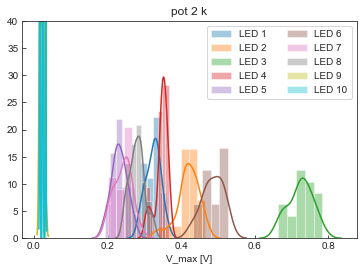

In [45]:
plot_LED_hist(df_flasher2, title="pot 2 k", outfile="flasher_level_2k_Feb8.png", ylim=[0,40])


/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


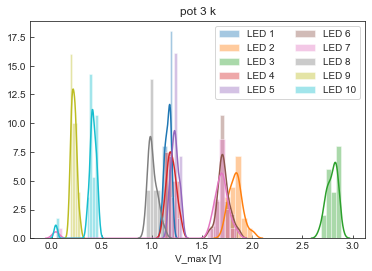

In [40]:
plot_LED_hist(df_flasher3, title="pot 3 k", outfile="flasher_level_3k_Feb8.png")#, ylim=[0,40])



/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


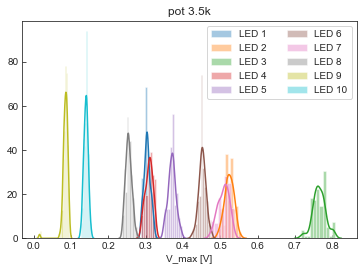

In [28]:
plot_LED_hist(df_flasher35, title="pot 3.5k", outfile="flasher_level_3p5k_Feb8.png")

/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


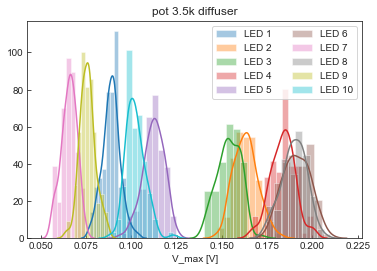

In [49]:
plot_LED_hist(df_flasherdiff35, title="pot 3.5k diffuser", outfile="flasher_level_3p5k_diffuser_Feb8.png")

/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


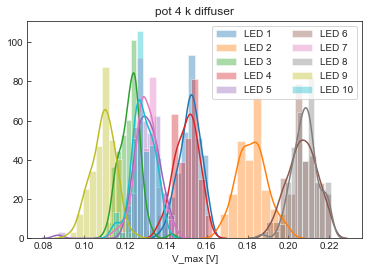

In [36]:
plot_LED_hist(df_flasher4, title="pot 4 k diffuser", outfile="flasher_level_4k_diffuser_Feb8.png")

/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


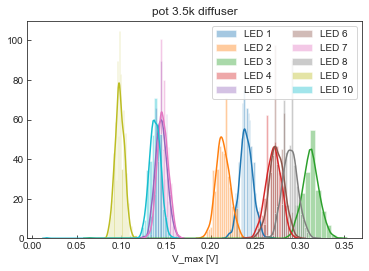

In [12]:
# lo:  L2 L5 L7 L9 L10 0  1  1
# hi:  L1 L3 L4 L6 L8  1  1  1


df_feb16_3p5 = pd.read_csv("flasher_fwhm_pot3p5k_Feb16.csv")

plot_LED_hist(df_feb16_3p5, title="pot 3.5k diffuser", outfile="flasher_level_3p5k_diffuser_Feb16.png")


/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


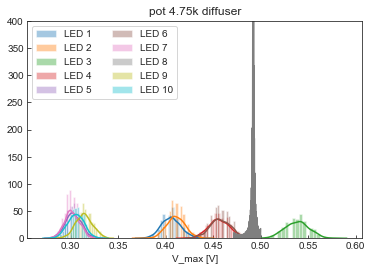

In [161]:
plot_LED_hist(df_feb18_4p75, title="pot 4.75k diffuser", 
              #bins=np.arange(.22,0.6,0.01),
              ylim=[0,400],
              outfile="flasher_level_4p75k_diffuser_Feb18.png")



In [10]:
# lo:  L2 L5 L7 L9 L10 0  1  1
# hi:  L1 L3 L4 L6 L8  1  1  1
def plot_LED_hists(dfs, outfile="flasher_levels_test.png", 
                 show_label=True, ylim=None, xlim=None, plot_dims=[3,2], 
                 bins=None):
    for i, df_flasher35 in enumerate(dfs):
        plt.subplot(plot_dims[0],plot_dims[1],i+1)
        plt.title(df_flasher35.pot_value_ohm[0])
        #plt.xticks([]),plt.yticks([])
        for ii, i in enumerate([6,1,7,8,2,9,3,10,4,5]):
        #for ii, i in enumerate([4,5,3,2,1,6,7,8,9,10]):
            if show_label:
                sns.distplot(-df_flasher35[df_flasher35.LEDs==i].half_max_V*2, bins=bins, rug=False, axlabel="V_max [V]", label="LED {}".format(ii+1))
            else:
                sns.distplot(-df_flasher35[df_flasher35.LEDs==i].half_max_V*2, bins=bins, rug=False, axlabel="V_max [V]")#, label="LED {}".format(ii+1))
        if show_label:
            plt.legend(ncol=4)
        if ylim is not None:
            plt.ylim(ylim)
        if xlim is not None:
            plt.xlim(xlim)
        #plt.title(title)
    plt.tight_layout()
    plt.savefig(outfile)



In [94]:
# lo:  L2 L5 L7 L9 L10 0  1  1
# hi:  L1 L3 L4 L6 L8  1  1  1
def plot_LED_histsC(dfs, outfile="flasher_levels_charge_hist.png", 
                    subtract_baseline=False, all_data_duration_s=2e-7, 
                 show_label=True, ylim=None, xlim=None, plot_dims=[3,2], 
                 bins=None):
    Rterm=50.0
    for i, df_flasher35 in enumerate(dfs):
        plt.subplot(plot_dims[0],plot_dims[1],i+1)
        plt.title(df_flasher35.pot_value_ohm[0])
        #plt.xticks([]),plt.yticks([])
        for ii, i in enumerate([6,1,7,8,2,9,3,10,4,5]):
        #for ii, i in enumerate([4,5,3,2,1,6,7,8,9,10]):
            if subtract_baseline:
                cs_ = -(df_flasher35[df_flasher35.LEDs==i].integrated_charge_window - df_flasher35[df_flasher35.LEDs==i].fit_baseline_V * all_data_duration_s)/Rterm
            else: 
                cs_ = -df_flasher35[df_flasher35.LEDs==i].integrated_charge_window/Rterm
            if show_label:
                sns.distplot(cs_, bins=bins, rug=False, axlabel="Integrated Charge [C]", label="LED {}".format(ii+1))
            else:
                sns.distplot(cs_, bins=bins, rug=False, axlabel="Integrated Charge [C]")#, label="LED {}".format(ii+1))
        if show_label:
            plt.legend(ncol=4)
        if ylim is not None:
            plt.ylim(ylim)
        if xlim is not None:
            plt.xlim(xlim)
        #plt.title(title)
    plt.tight_layout()
    plt.savefig(outfile)




In [99]:
24432.818955597588/424640.19626784447

0.0575376970205299

In [257]:
# lo:  L2 L5 L7 L9 L10 0  1  1
# hi:  L1 L3 L4 L6 L8  1  1  1
#gain 424640.19626784447, 24432.818955597588

def plot_LED_hists_e(dfs, outfile="flasher_levels_charge_hist.png", gain=3.93e5, 
                    subtract_baseline=False, all_data_duration_s=2e-7, 
                 show_label=True, ylim=None, xlim=None, plot_dims=[3,2], 
                 bins=None):
    Rterm=50.0
    e=1.602177e-19
    for i, df_flasher35 in enumerate(dfs):
        plt.subplot(plot_dims[0],plot_dims[1],i+1)
        plt.title(df_flasher35.pot_value_ohm[0])
        #plt.xticks([]),plt.yticks([])
        for ii, i in enumerate([6,1,7,8,2,9,3,10,4,5]):
        #for ii, i in enumerate([4,5,3,2,1,6,7,8,9,10]):
            if subtract_baseline:
                cs_ = -(df_flasher35[df_flasher35.LEDs==i].integrated_charge_window - \
                        df_flasher35[df_flasher35.LEDs==i].fit_baseline_V * all_data_duration_s)/Rterm/e/gain
            else: 
                cs_ = -df_flasher35[df_flasher35.LEDs==i].integrated_charge_window/Rterm/e/gain
            if show_label:
                sns.distplot(cs_, bins=bins, rug=False, axlabel="Number of PEs", label="LED {}".format(ii+1))
            else:
                sns.distplot(cs_, bins=bins, rug=False, axlabel="Number of PEs")#, label="LED {}".format(ii+1))
        if show_label:
            plt.legend(ncol=4)
        if ylim is not None:
            plt.ylim(ylim)
        if xlim is not None:
            plt.xlim(xlim)
        #plt.title(title)
    plt.tight_layout()
    plt.savefig(outfile)





In [309]:
# lo:  L2 L5 L7 L9 L10 0  1  1
# hi:  L1 L3 L4 L6 L8  1  1  1
#gain 424640.19626784447, 24432.818955597588

def plot_LED_hists_e_scaled(dfs, outfile="flasher_levels_charge_hist.png", gain=3.93e5, 
                            dist_measure = 0.91, dist_cam = 1.86, 
                            pix_measure = 18, pixel_cam=36, ys=None, 
                    subtract_baseline=False, all_data_duration_s=2e-7, 
                 show_label=True, ylim=None, xlim=None, plot_dims=[3,2], 
                 bins=None):
    Rterm=50.0
    e=1.602177e-19
    scale_factor = 1./Rterm/e/gain/pix_measure*pixel_cam*dist_measure*dist_measure/dist_cam/dist_cam
    for kk, df_flasher35 in enumerate(dfs):
        plt.subplot(plot_dims[0],plot_dims[1],kk+1)
        plt.title(df_flasher35.pot_value_ohm[0])
        #plt.xticks([]),plt.yticks([])
        for ii, i in enumerate([6,1,7,8,2,9,3,10,4,5]):
        #for ii, i in enumerate([4,5,3,2,1,6,7,8,9,10]):
            if subtract_baseline:
                cs_ = -(df_flasher35[df_flasher35.LEDs==i].integrated_charge_window - \
                        df_flasher35[df_flasher35.LEDs==i].fit_baseline_V * all_data_duration_s)*scale_factor
            else: 
                cs_ = -df_flasher35[df_flasher35.LEDs==i].integrated_charge_window*scale_factor
            if show_label:
                sns.distplot(cs_, bins=bins, rug=False, axlabel="Number of PEs per pSCT pixel", label="LED {}".format(ii+1))
            else:
                sns.distplot(cs_, bins=bins, rug=False, axlabel="Number of PEs per pSCT pixel")#, label="LED {}".format(ii+1))
        if show_label:
            plt.legend(ncol=4)
        if ylim is not None:
            if ys is not None:
                #print(kk)
                if kk in ys:
                    print("scale {}".format(kk))
                    plt.ylim(ylim)
            else:
                plt.ylim(ylim)
        if xlim is not None:
            plt.xlim(xlim)
        #plt.title(title)
    plt.tight_layout()
    plt.savefig(outfile)



In [28]:
df_stat3p5 = pd.DataFrame(df_feb16_3p5.groupby('LEDs').describe())



In [30]:
df_stat3p5.head()

FWHM_s                                                          \
       count          mean           std           min           25%   
LEDs                                                                   
1     1000.0  1.075100e-08  5.434099e-10  1.000000e-08  1.000000e-08   
2     1000.0  1.029300e-08  5.945624e-10  9.000000e-09  1.000000e-08   
3     1000.0  1.003800e-08  5.337048e-10  8.000000e-09  1.000000e-08   
4     1000.0  7.743000e-09  5.012008e-10  6.000000e-09  7.000000e-09   
5     1000.0  8.388000e-09  2.322682e-09  7.000000e-09  8.000000e-09   

                                               fit_baseline_V            \
               50%           75%           max          count      mean   
LEDs                                                                      
1     1.100000e-08  1.100000e-08  1.200000e-08         1000.0 -0.000858   
2     1.000000e-08  1.100000e-08  1.200000e-08         1000.0 -0.000829   
3     1.000000e-08  1.000000e-08  1.100000e-08         1000.0 -0.000976   
4     8.000000e-09  8.000000e-09  9.000000e-09         1000.0 -0.000521   
5     8.000000e-09  9.000000e-09  8.000000e-08         1000.0 -0.001207   

          ...      integrated_charge_all                \
          ...                        75%           max   
LEDs      ...                                            
1         ...              -3.201000e-09 -2.991000e-09   
2         ...              -2.122400e-09 -1.885800e-09   
3         ...              -2.115000e-09 -1.964400e-09   
4         ...              -1.130400e-09 -9.700000e-10   
5         ...              -1.777800e-09 -2.130000e-10   

     integrated_charge_window                                            \
                        count          mean           std           min   
LEDs                                                                      
1                      1000.0 -3.027198e-09  8.019510e-11 -3.284000e-09   
2                      1000.0 -1.987864e-09  6.536281e-11 -2.249100e-09   
3                      1000.0 -1.953656e-09  6.266713e-11 -2.139000e-09   
4                      1000.0 -1.053073e-09  4.813272e-11 -1.223600e-09   
5                      1000.0 -1.596915e-09  7.619151e-11 -1.767600e-09   

                                                              
               25%           50%           75%           max  
LEDs                                                          
1    -3.078250e-09 -3.027000e-09 -2.974000e-09 -2.772000e-09  
2    -2.031400e-09 -1.987650e-09 -1.942500e-09 -1.726900e-09  
3    -1.995600e-09 -1.954200e-09 -1.914000e-09 -1.783800e-09  
4    -1.087600e-09 -1.052200e-09 -1.020300e-09 -8.996000e-10  
5    -1.637400e-09 -1.598400e-09 -1.559400e-09 -6.360000e-11  

[5 rows x 96 columns]

In [31]:
df_stat3p5.columns

MultiIndex(levels=[['FWHM_s', 'fit_baseline_V', 'fit_peak_V', 'fit_redchisq', 'fit_tdecay_s', 'fit_tpeak_s', 'fit_trise_s', 'half_max_V', 'integrate_window_start', 'integrate_window_stop', 'integrated_charge_all', 'integrated_charge_window'], ['count', 'mean', 'std', 'min', '25%', '50%', '75%', 'max']],
           labels=[[0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 4, 4, 4, 4, 4, 4, 4, 4, 5, 5, 5, 5, 5, 5, 5, 5, 6, 6, 6, 6, 6, 6, 6, 6, 7, 7, 7, 7, 7, 7, 7, 7, 8, 8, 8, 8, 8, 8, 8, 8, 9, 9, 9, 9, 9, 9, 9, 9, 10, 10, 10, 10, 10, 10, 10, 10, 11, 11, 11, 11, 11, 11, 11, 11], [0, 1, 2, 3, 4, 5, 6, 7, 0, 1, 2, 3, 4, 5, 6, 7, 0, 1, 2, 3, 4, 5, 6, 7, 0, 1, 2, 3, 4, 5, 6, 7, 0, 1, 2, 3, 4, 5, 6, 7, 0, 1, 2, 3, 4, 5, 6, 7, 0, 1, 2, 3, 4, 5, 6, 7, 0, 1, 2, 3, 4, 5, 6, 7, 0, 1, 2, 3, 4, 5, 6, 7, 0, 1, 2, 3, 4, 5, 6, 7, 0, 1, 2, 3, 4, 5, 6, 7, 0, 1, 2, 3, 4, 5, 6, 7]])

In [33]:
-df_stat3p5['half_max_V'] ['mean'].values*2

array([0.213928  , 0.1447544 , 0.1466232 , 0.0982824 , 0.1377348 ,
       0.24013013, 0.31203859, 0.2704512 , 0.2741472 , 0.2892096 ])

In [15]:
df_feb16_3p5 = pd.read_csv("flasher_fwhm_pot3p5k_Feb16.csv")
df_feb16_2p5 = pd.read_csv("flasher_fwhm_pot2p5k_Feb16.csv")
df_feb16_2p75 = pd.read_csv("flasher_fwhm_pot2p75k_Feb16.csv")
df_feb16_4p0 = pd.read_csv("flasher_fwhm_pot4p0k_Feb16.csv")
df_feb16_4p0_2 = pd.read_csv("flasher_fwhm_pot4p0k_hysteresis_Feb16.csv")
df_feb16_3p0 = pd.read_csv("flasher_fwhm_pot3p0k_Feb16.csv")
df_feb16_4p5 = pd.read_csv("flasher_fwhm_pot4p5k_Feb16.csv")
df_feb16_5p0 = pd.read_csv("flasher_fwhm_pot5p0k_Feb16.csv")
df_feb16_4p5_2 = pd.read_csv("flasher_fwhm_pot4p5k_hysteresis_Feb16.csv")
df_feb16_5p5 = pd.read_csv("flasher_fwhm_pot5p5k_Feb16.csv")
df_feb16_6p0 = pd.read_csv("flasher_fwhm_pot6p0k_Feb16.csv")


df_feb18_2p75 = pd.read_csv("flasher_fwhm_pot2p75k_Feb18.csv")
df_feb18_3p0 = pd.read_csv("flasher_fwhm_pot3p0k_Feb18.csv")
df_feb18_3p25 = pd.read_csv("flasher_fwhm_pot3p25k_Feb18.csv")
df_feb18_3p5 = pd.read_csv("flasher_fwhm_pot3p5k_Feb18.csv")
df_feb18_3p75 = pd.read_csv("flasher_fwhm_pot3p75k_Feb18.csv")
df_feb18_4p0 = pd.read_csv("flasher_fwhm_pot4p0k_Feb18.csv")
df_feb18_4p25 = pd.read_csv("flasher_fwhm_pot4p25k_Feb18.csv")
df_feb18_4p5 = pd.read_csv("flasher_fwhm_pot4p5k_Feb18.csv")
df_feb18_4p75 = pd.read_csv("flasher_fwhm_pot4p75k_Feb18.csv")
df_feb18_5p0 = pd.read_csv("flasher_fwhm_pot5p0k_Feb18.csv")
df_feb19_5p25 = pd.read_csv("flasher_fwhm_pot5p25k_Feb19.csv")
df_feb19_5p5 = pd.read_csv("flasher_fwhm_pot5p5k_Feb19.csv")
df_feb19_5p75 = pd.read_csv("flasher_fwhm_pot5p75k_Feb19.csv")
df_feb19_2p25 = pd.read_csv("flasher_fwhm_pot2p25k_Feb19.csv")
df_feb19_2p0 = pd.read_csv("flasher_fwhm_pot2p0k_Feb19.csv")
df_feb19_1p75 = pd.read_csv("flasher_fwhm_pot1p75k_Feb19.csv")


df_feb25_2p5 = pd.read_csv("flasher_fwhm_pot2p5k_Feb25.csv")



#df_feb19_2p5_recalc = pd.read_csv("flasher_fwhm_pot2p5k_Feb25.csv
df_feb19_2p5_recalc=recalc_trace(filename="flasher_fwhm_pot2p5k_Feb19.csv", calcLEDs=[4,5], 
                 trace_dir="flasher_data/pot_2p5k_Feb19/", 
                 trace_kw="_pot2p5k_Feb19_trace_", 
                 initial_params=[0.1, 8.e-8, 5.e-9, 7.e-9, 0.])



dfs = [
df_feb16_2p5 ,
df_feb16_2p75,
df_feb16_3p0,
df_feb16_3p5, 
df_feb18_2p75, 
df_feb16_4p0 ,
df_feb16_4p5 ,
df_feb16_5p0 ,
df_feb16_4p0_2, 
df_feb16_4p5_2,
df_feb16_5p5 ,
df_feb16_6p0 ]

dfs2 = [
df_feb16_2p5 ,
df_feb16_2p75,
df_feb16_3p0,
df_feb16_3p5, 
df_feb18_2p75, 
df_feb18_3p0,
    df_feb18_3p25,
    df_feb18_3p5, 
df_feb18_3p75,
df_feb16_4p0 ,
df_feb16_4p5 ,
df_feb16_4p0_2, 
df_feb16_5p0 ,
df_feb16_4p5_2,
df_feb18_4p0 ,
df_feb16_5p5 ,
df_feb18_4p25,
df_feb18_4p5 ,
df_feb18_4p75,
    df_feb16_6p0 ]

dfs3 = [
df_feb16_2p5 ,
df_feb16_2p75,
df_feb16_3p0,
df_feb18_3p25,
df_feb16_3p5, 
    df_feb18_2p75, 
    df_feb18_3p0,
df_feb18_3p75, 
    df_feb18_3p5, 
df_feb16_4p0 ,
df_feb18_4p25,
df_feb16_4p5 ,
df_feb16_5p0 ,
    df_feb16_4p0_2 ,
df_feb16_5p5 ,
    df_feb16_4p5_2,
df_feb18_4p75,
    df_feb18_4p0 ,
df_feb16_6p0 ,
    df_feb18_4p5 
]



dfs4 = [
df_feb16_2p5 ,
df_feb16_2p75,
df_feb16_3p0,
df_feb18_3p25,
df_feb16_3p5, 
    df_feb18_2p75, 
    df_feb18_3p0,
df_feb18_3p75, 
    df_feb18_3p5, 
df_feb16_4p0 ,
df_feb18_4p25,
df_feb16_4p5 ,
df_feb16_5p0 ,
    df_feb16_4p0_2 ,
df_feb19_5p25,
    df_feb16_4p5_2,
df_feb16_5p5 ,
    df_feb18_4p0 ,
df_feb18_4p75,
    df_feb18_4p5 ,
    df_feb19_5p5,
df_feb19_5p75, 
df_feb16_6p0, 
    df_feb19_2p25,
df_feb19_2p0 ,
df_feb19_1p75
]



dfs4s = [
    df_feb19_1p75,
df_feb19_2p0 ,
    df_feb19_2p25,
df_feb16_2p5 ,
df_feb16_2p75,
    df_feb18_2p75, 
df_feb16_3p0,
    df_feb18_3p0,
df_feb18_3p25,
df_feb16_3p5, 
    df_feb18_3p5, 
df_feb18_3p75, 
df_feb16_4p0 ,
    df_feb16_4p0_2 ,
    df_feb18_4p0 ,
df_feb18_4p25,
df_feb16_4p5 ,
    df_feb16_4p5_2,
    df_feb18_4p5 ,
df_feb18_4p75,
df_feb16_5p0 ,
df_feb19_5p25,
df_feb16_5p5 ,
    df_feb19_5p5,
df_feb19_5p75, 
df_feb16_6p0
]



Fixing LED 4
Fixing LED 5


In [16]:

dfs5 = [
    df_feb19_1p75,
df_feb19_2p0 ,
    df_feb19_2p25,
df_feb16_2p5 ,
df_feb19_2p5_recalc ,
df_feb16_2p75,
    df_feb18_2p75, 
df_feb16_3p0,
    df_feb18_3p0,
df_feb18_3p25,
df_feb16_3p5, 
    df_feb18_3p5, 
df_feb18_3p75, 
df_feb16_4p0 ,
    df_feb16_4p0_2 ,
    df_feb18_4p0 ,
df_feb18_4p25,
df_feb16_4p5 ,
    df_feb16_4p5_2,
    df_feb18_4p5 ,
df_feb18_4p75,
df_feb16_5p0 ,
df_feb19_5p25,
df_feb16_5p5 ,
    df_feb19_5p5,
df_feb19_5p75, 
df_feb16_6p0
]



dfs6 = [
    df_feb19_1p75,
df_feb19_2p0 ,
    df_feb19_2p25,
df_feb16_2p5 ,
df_feb19_2p5_recalc ,
    df_feb25_2p5, 
df_feb16_2p75,
    df_feb18_2p75, 
df_feb16_3p0,
    df_feb18_3p0,
df_feb18_3p25,
df_feb16_3p5, 
    df_feb18_3p5, 
df_feb18_3p75, 
df_feb16_4p0 ,
    df_feb16_4p0_2 ,
    df_feb18_4p0 ,
df_feb18_4p25,
df_feb16_4p5 ,
    df_feb16_4p5_2,
    df_feb18_4p5 ,
df_feb18_4p75,
df_feb16_5p0 ,
df_feb19_5p25,
df_feb16_5p5 ,
    df_feb19_5p5,
df_feb19_5p75, 
df_feb16_6p0
]






In [285]:
len(dfs2),len(dfs3), len(dfs4)

(20, 20, 26)

In [56]:
df_feb16_4p0_2[df_feb16_4p0_2.LEDs==2]


,LEDs,pot_value_ohm,FWHM_s,half_max_V,fit_trise_s,fit_tdecay_s,fit_peak_V,fit_tpeak_s,fit_baseline_V,fit_redchisq,integrate_window_start,integrate_window_stop,integrated_charge_all,integrated_charge_window


/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval
/anaconda3/lib/python3.7/site-packages/seaborn/distributions.py:198: RuntimeWarning: Mean of empty slice.
  line, = ax.plot(a.mean(), 0)
/anaconda3/lib/python3.7/site-packages/numpy/core/_methods.py:85: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/anaconda3/lib/python3.7/site-packages/numpy/lib/histograms.py:815: RuntimeWarning: invalid value encountered in true_divide
  return n/db/n.sum(), bin_edges


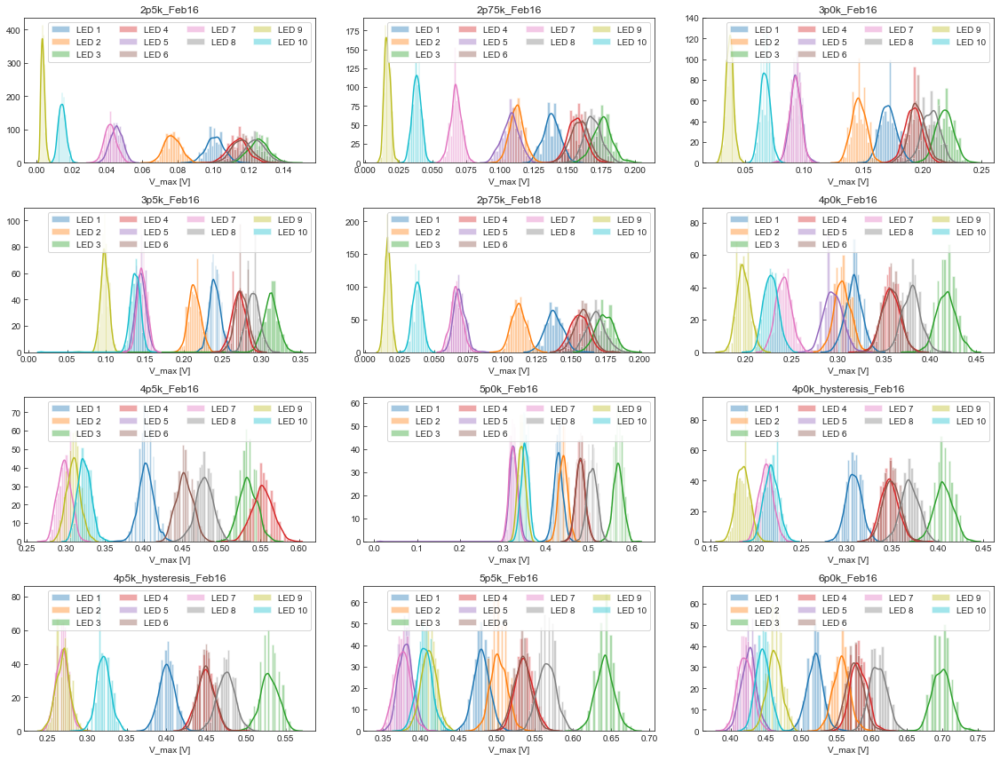

In [50]:
fig = plt.figure(figsize=(16,12))
plot_LED_hists(dfs, outfile="flasher_levels_Feb16_18.png", 
                 show_label=True, ylim=None, plot_dims=[4,3], 
                 bins=None)



/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval
/anaconda3/lib/python3.7/site-packages/seaborn/distributions.py:198: RuntimeWarning: Mean of empty slice.
  line, = ax.plot(a.mean(), 0)
/anaconda3/lib/python3.7/site-packages/numpy/core/_methods.py:85: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/anaconda3/lib/python3.7/site-packages/numpy/lib/histograms.py:815: RuntimeWarning: invalid value encountered in true_divide
  return n/db/n.sum(), bin_edges


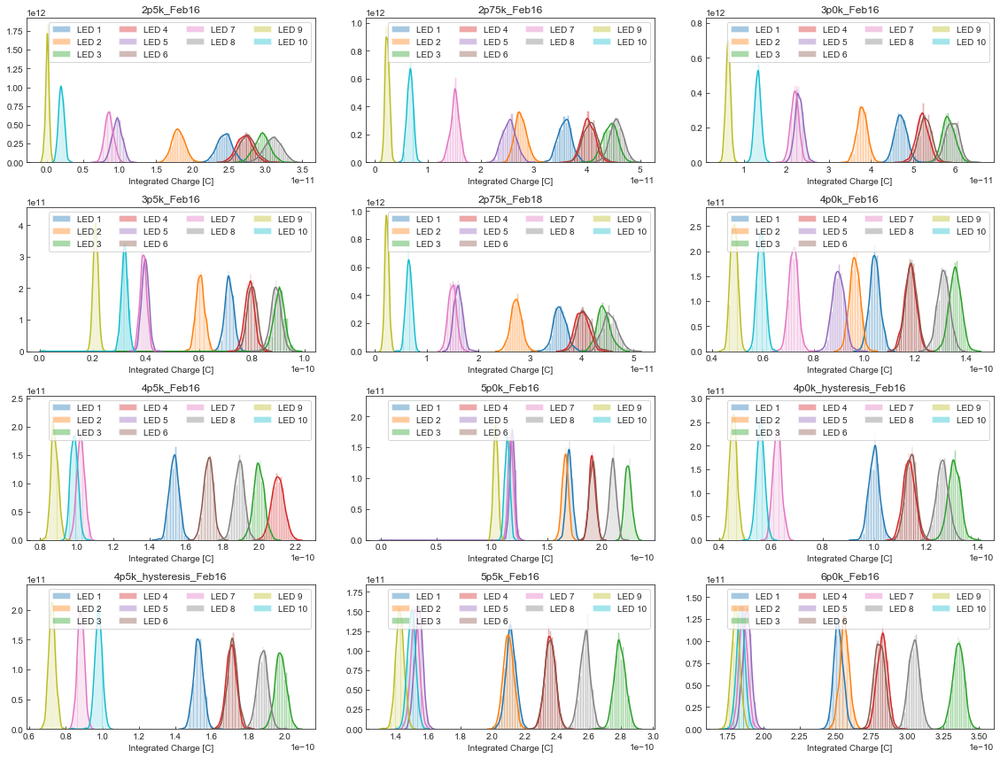

In [95]:
fig = plt.figure(figsize=(16,12))
plot_LED_histsC(dfs, outfile="flasher_levels_Feb16_18_charge_hist_v2.png", 
                 show_label=True, ylim=None, plot_dims=[4,3], 
                 bins=None)




/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval
/anaconda3/lib/python3.7/site-packages/seaborn/distributions.py:198: RuntimeWarning: Mean of empty slice.
  line, = ax.plot(a.mean(), 0)
/anaconda3/lib/python3.7/site-packages/numpy/core/_methods.py:85: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/anaconda3/lib/python3.7/site-packages/numpy/lib/histograms.py:815: RuntimeWarning: invalid value encountered in true_divide
  return n/db/n.sum(), bin_edges


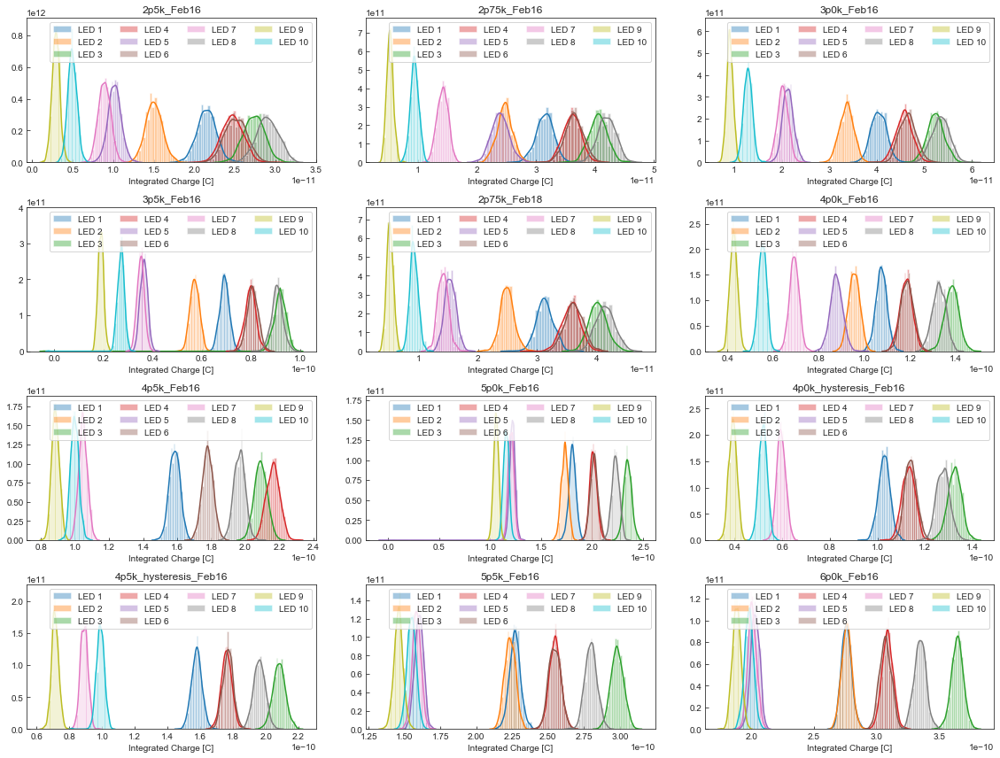

In [96]:
fig = plt.figure(figsize=(16,12))
plot_LED_histsC(dfs, outfile="flasher_levels_Feb16_18_charge_hist_sub_base.png", 
                 show_label=True, ylim=None, plot_dims=[4,3], subtract_baseline=True, 
                 bins=None)



/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval
/anaconda3/lib/python3.7/site-packages/seaborn/distributions.py:198: RuntimeWarning: Mean of empty slice.
  line, = ax.plot(a.mean(), 0)
/anaconda3/lib/python3.7/site-packages/numpy/core/_methods.py:85: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/anaconda3/lib/python3.7/site-packages/numpy/lib/histograms.py:815: RuntimeWarning: invalid value encountered in true_divide
  return n/db/n.sum(), bin_edges


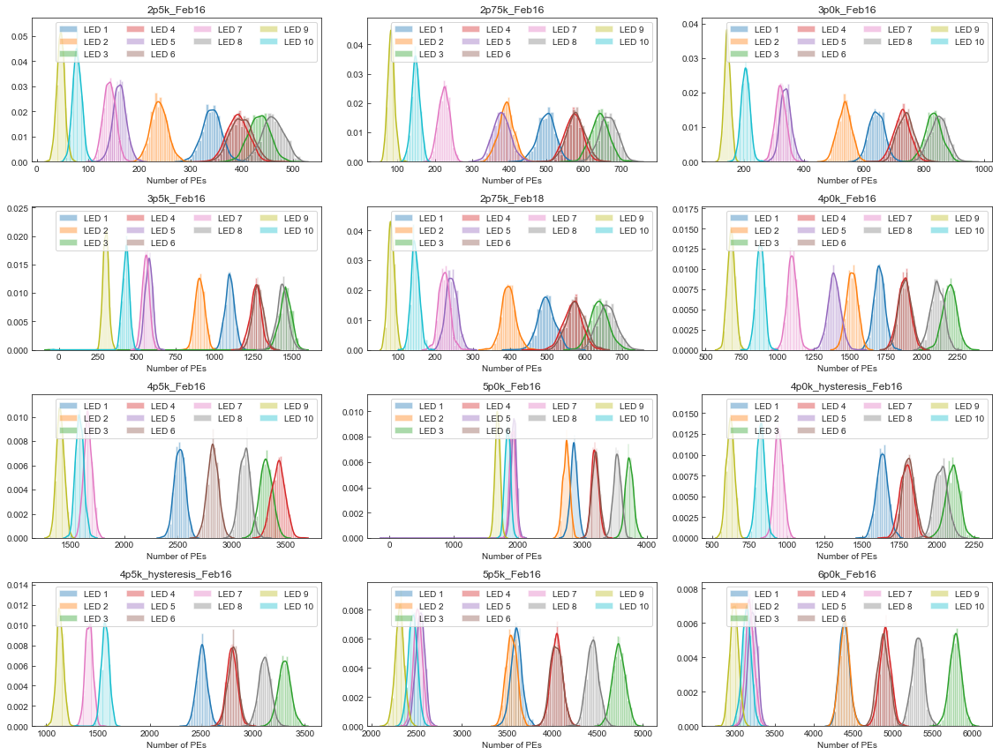

In [259]:
fig = plt.figure(figsize=(16,12))
plot_LED_hists_e(dfs, outfile="flasher_levels_Feb16_18_NPE_hist_sub_base_gain3p93e5.png", gain=3.93e5,  
                 show_label=True, ylim=None, plot_dims=[4,3], subtract_baseline=True, 
                 bins=None)



/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval
/anaconda3/lib/python3.7/site-packages/seaborn/distributions.py:198: RuntimeWarning: Mean of empty slice.
  line, = ax.plot(a.mean(), 0)
/anaconda3/lib/python3.7/site-packages/numpy/core/_methods.py:85: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/anaconda3/lib/python3.7/site-packages/numpy/lib/histograms.py:815: RuntimeWarning: invalid value encountered in true_divide
  return n/db/n.sum(), bin_edges


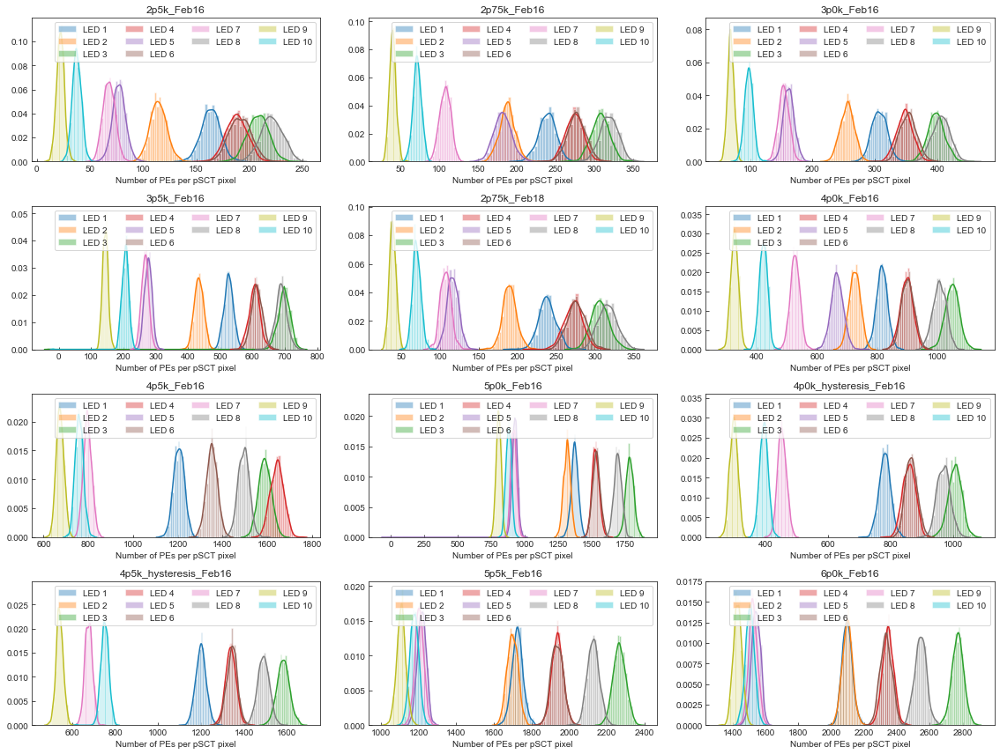

In [310]:
fig = plt.figure(figsize=(16,12))
plot_LED_hists_e_scaled(dfs, outfile="flasher_levels_Feb16_18_NPE_hist_sub_base_gain3p93e5_scaled_18mm2.png", gain=3.93e5,  
                 pix_measure=18, 
                        show_label=True, ylim=None, plot_dims=[4,3], subtract_baseline=True, 
                 bins=None)




/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval
/anaconda3/lib/python3.7/site-packages/seaborn/distributions.py:198: RuntimeWarning: Mean of empty slice.
  line, = ax.plot(a.mean(), 0)
/anaconda3/lib/python3.7/site-packages/numpy/core/_methods.py:85: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/anaconda3/lib/python3.7/site-packages/numpy/lib/histograms.py:815: RuntimeWarning: invalid value encountered in true_divide
  return n/db/n.sum(), bin_edges


scale 18


/anaconda3/lib/python3.7/site-packages/statsmodels/nonparametric/kde.py:488: RuntimeWarning: invalid value encountered in true_divide
  binned = fast_linbin(X, a, b, gridsize) / (delta * nobs)
/anaconda3/lib/python3.7/site-packages/statsmodels/nonparametric/kdetools.py:34: RuntimeWarning: invalid value encountered in double_scalars
  FAC1 = 2*(np.pi*bw/RANGE)**2
/anaconda3/lib/python3.7/site-packages/numpy/core/fromnumeric.py:83: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)


scale 23
scale 24
scale 25


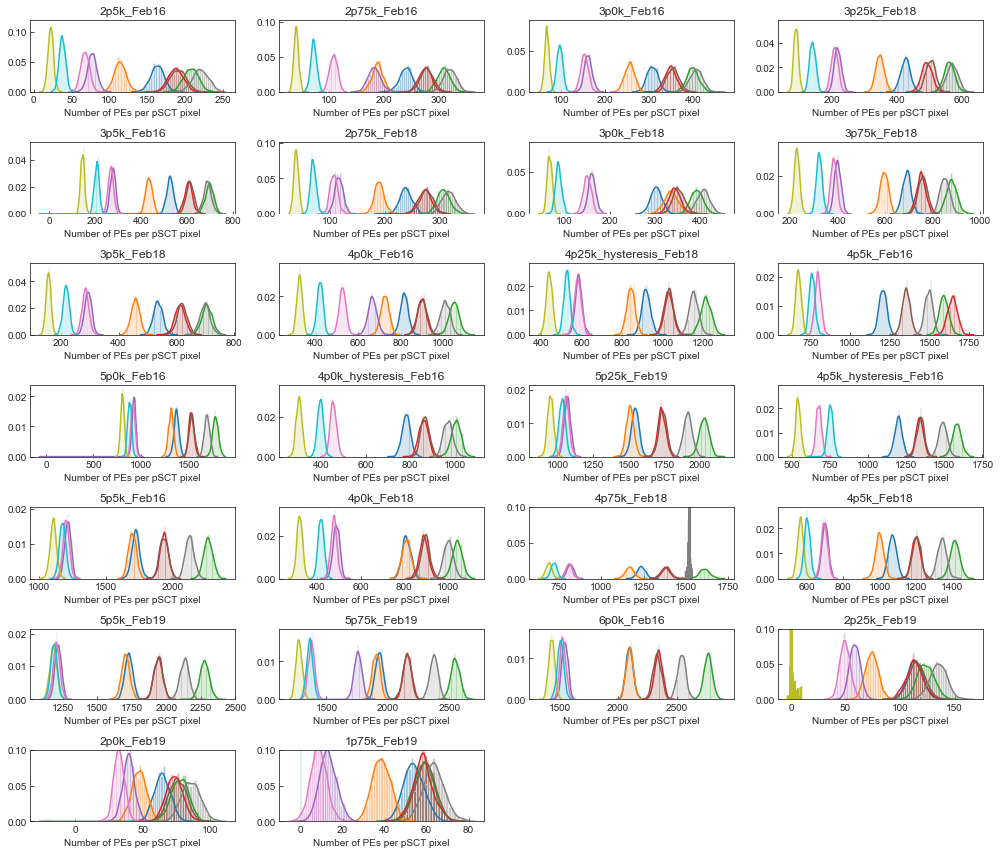

In [312]:
fig = plt.figure(figsize=(14,12))
plot_LED_hists_e_scaled(dfs4, outfile="flasher_levels_Feb16_19_NPE_hist_sub_base_gain3p93e5_scaled_18mm2_v5.png", gain=3.93e5,  
                 pix_measure=18, 
                 show_label=False, ys = [18,23, 24, 25], ylim=[0,0.1], plot_dims=[7,4], subtract_baseline=True, 
                 bins=None)





/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval
/anaconda3/lib/python3.7/site-packages/statsmodels/nonparametric/kde.py:488: RuntimeWarning: invalid value encountered in true_divide
  binned = fast_linbin(X, a, b, gridsize) / (delta * nobs)
/anaconda3/lib/python3.7/site-packages/statsmodels/nonparametric/kdetools.py:34: RuntimeWarning: invalid value encountered in double_scalars
  FAC1 = 2*(np.pi*bw/RANGE)**2
/anaconda3/lib/python3.7/site-packages/numpy/core/fromnumeric.py:83: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)


scale 0
scale 1
scale 2


/anaconda3/lib/python3.7/site-packages/seaborn/distributions.py:198: RuntimeWarning: Mean of empty slice.
  line, = ax.plot(a.mean(), 0)
/anaconda3/lib/python3.7/site-packages/numpy/core/_methods.py:85: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/anaconda3/lib/python3.7/site-packages/numpy/lib/histograms.py:815: RuntimeWarning: invalid value encountered in true_divide
  return n/db/n.sum(), bin_edges


scale 20


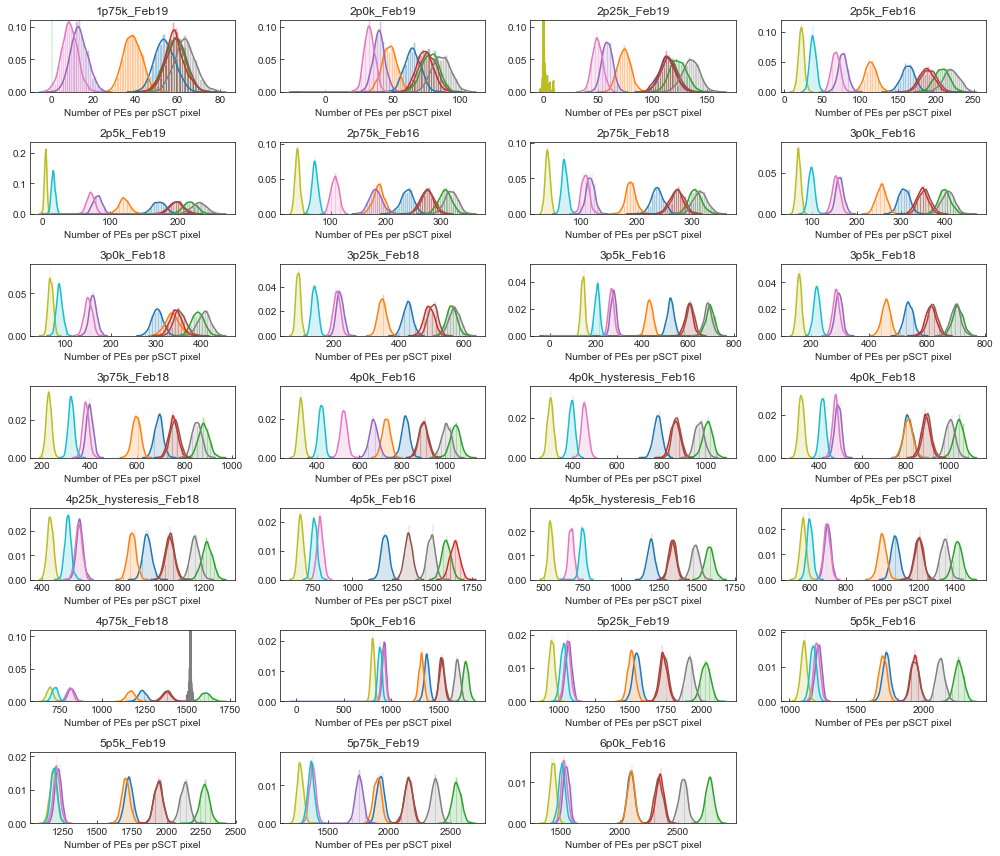

In [430]:
fig = plt.figure(figsize=(14,12))
plot_LED_hists_e_scaled(dfs5, outfile="flasher_levels_Feb16_19_NPE_hist_sub_base_gain3p93e5_scaled_18mm2_v7.png", gain=3.93e5,  
                 pix_measure=18, 
                 show_label=False, ys = [0,1,2,20], ylim=[0,0.11], 
                        plot_dims=[7,4], subtract_baseline=True, 
                 bins=None)






In [36]:
df_feb16_2p75.head()

,LEDs,pot_value_ohm,FWHM_s,half_max_V,fit_trise_s,fit_tdecay_s,fit_peak_V,fit_tpeak_s,fit_baseline_V,fit_redchisq,integrate_window_start,integrate_window_stop,integrated_charge_all,integrated_charge_window
0,1,2p75k_Feb16,8.000000e-09,-0.05588,4.466453e-09,5.672524e-09,0.132984,8.418395e-08,-0.000876,0.000015,6.597234e-08,1.304425e-07,-1.519760e-09,-1.356080e-09
1,1,2p75k_Feb16,1.000000e-08,-0.05016,4.049424e-09,6.452473e-09,0.120488,8.346548e-08,-0.000667,0.000026,6.695427e-08,1.360844e-07,-1.399200e-09,-1.266760e-09
2,1,2p75k_Feb16,9.000000e-09,-0.05368,4.042802e-09,6.000606e-09,0.128274,8.340194e-08,-0.001072,0.000021,6.691772e-08,1.323360e-07,-1.501720e-09,-1.298440e-09
3,1,2p75k_Feb16,9.000000e-09,-0.05324,4.184413e-09,6.365968e-09,0.128322,8.324953e-08,-0.000626,0.000019,6.618791e-08,1.351630e-07,-1.476640e-09,-1.350360e-09
4,1,2p75k_Feb16,9.000000e-09,-0.05588,3.685363e-09,6.529831e-09,0.132358,8.243683e-08,-0.000535,0.000022,6.741004e-08,1.356866e-07,-1.459920e-09,-1.339360e-09


(200,) (200,)
1.6999999999999993e-08 -0.24600000000000002 84 101 8.460000000000628e-08 1.0160000000000627e-07
Start window 5.583966678533661e-08 s, stop window 1.5710390248654538e-07 s, window width 1.0126423570120877e-07 s
integral all = -9.915999999999994e-09
integral window = -9.641999999999995e-09
integral all subtract baseline = -1.0262661284727134e-08
integral all subtract baseline direct = -1.0264403301233301e-08


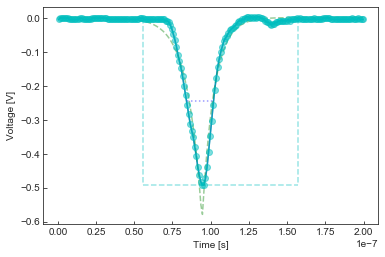

In [137]:
df_trace_ = pd.read_csv("flasher_data/pot_4p75k_Feb18/LED10_pot4p75k_Feb18_trace_999.csv") 
replot_traces(df_trace_)



(200,) (200,)
8.000000000000019e-09 -0.05587999999999999 80 88 8.060000000000628e-08 8.86000000000063e-08
Start window 6.597233824647127e-08 s, stop window 1.3044251902383027e-07 s, window width 6.4470180777359e-08 s
integral all = -1.5197599999999989e-09
integral window = -1.3560799999999991e-09
integral all subtract baseline = -1.3454165095791045e-09
integral all subtract baseline direct = -1.344540411637291e-09


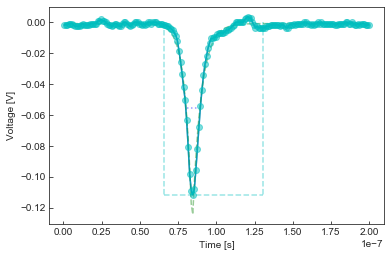

In [46]:
df_trace275 = pd.read_csv("flasher_data/pot_2p75k_Feb16/LED1_pot2p75k_Feb16_trace_0.csv") 
replot_traces(df_trace275)


(200,) (200,)
6.000000000000014 -0.0010400000000000001 79 85 79.60000000000629 85.6000000000063
Start window 70.2470915287468 s, stop window 142.92621854332444 s, window width 72.67912701457765 s (or ns)
integral all = 0.12904
integral window = 0.028079999999999987
integral all subtract baseline = -0.031836604416743165
integral all subtract baseline direct = 0.12903999983831496


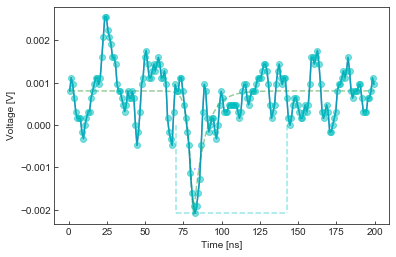

In [247]:
df_trace275 = pd.read_csv("flasher_data/pot_2p5k_Feb16/LED4_pot2p5k_Feb16_trace_0.csv") 
replot_traces(df_trace275)

plt.savefig("LED4_pot2p5k_Feb16_trace_0.pdf")

In [292]:
0.11/0.003

36.666666666666664

(200,) (200,)
6.000000000000014e-09 -0.0010400000000000001 79 85 7.960000000000628e-08 8.56000000000063e-08
Start window 7.1421301116343e-08 s, stop window 1.5263148204442493e-07 s, window width 8.121018092808193e-08 s (or ns)
integral all = 1.2903999999999998e-10
integral window = 3.071999999999997e-11
integral all subtract baseline = -3.2955887875676376e-11
integral all subtract baseline direct = -3.37699375634939e-11


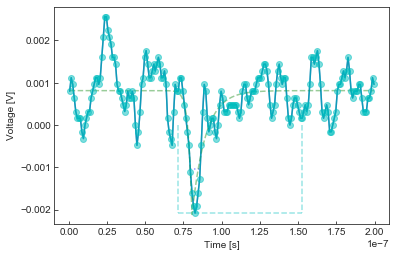

In [250]:
df_trace275 = pd.read_csv("flasher_data/pot_2p5k_Feb16/LED4_pot2p5k_Feb16_trace_0.csv") 
replot_traces(df_trace275, ns=False)

plt.savefig("LED4_pot2p5k_Feb16_trace_0_s.pdf")

In [253]:
PMT_Gain = 3.93e5
e=1.602e-19

In [291]:
3.37699375634939e-11/50, 3.37699375634939e-11/50/PMT_Gain/e

(6.753987512698781e-13, 10.7276647077584)

In [290]:
1.344540411637291e-09/50/PMT_Gain/e

427.1189040535498

In [294]:
# single PE charge:
1*PMT_Gain*e/10e-9*50

0.000314793

In [295]:
10*PMT_Gain*e/10e-9*50

0.0031479299999999993

(200,) (200,)
7.999999999999986 -0.061439999999999995 78 86 78.60000000000629 86.60000000000628
Start window 65.58735481985227 s, stop window 127.66102341259452 s, window width 62.07366859274225 s (or ns)
integral all = -1.5686399999999994
integral window = -1.4073599999999993
integral all subtract baseline = -1.4233685595839738
integral all subtract baseline direct = -1.568639999853998


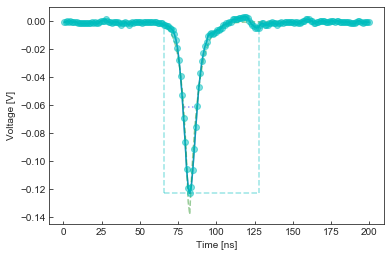

In [249]:
df_trace275 = pd.read_csv("flasher_data/pot_2p5k_Feb16/LED7_pot2p5k_Feb16_trace_0.csv") 
replot_traces(df_trace275)

plt.savefig("LED7_pot2p5k_Feb16_trace_0.pdf")


In [17]:
# lo:  L2 L5 L7 L9 L10 0  1  1
# hi:  L1 L3 L4 L6 L8  1  1  1
#plt.cm
def plot_LED_levels(dfs, outfile="flasher_levels_test_2.png", 
                 show_label=True, ylim=None, xlim=None, plot_dims=[3,2], 
                 bins=None):
    for i, df_flasher2 in enumerate(dfs):
        #plt.subplot(plot_dims[0],plot_dims[1],i+1)
        #plt.title(df_flasher2.pot_value_ohm[0])
        df_flasher_stat2 = pd.DataFrame(df_flasher2.groupby('LEDs').describe())
        df_flasher_stat2['half_max_V']=-df_flasher_stat2['half_max_V']
        #df_sortV2 = df_flasher_stat2['half_max_V'].sort_values(by=['mean'])
        #new_ind2 = df_sortV2.index

        #-df_stat3p5['half_max_V'] ['mean'].values*2
        plt.errorbar(range(df_flasher_stat2.shape[0]), df_flasher_stat2['half_max_V']['mean'].values*2, 
             yerr=df_flasher_stat2['half_max_V']['std']*2, 
                     #fmt='*', color='c', ecolor='c', 
                     capthick=0, label=df_flasher2.pot_value_ohm[0])
        plt.xlabel("Individual LEDs")
        plt.ylabel("Pulse height mean [V]")
        
        if show_label:
            plt.legend(ncol=4)
        if ylim is not None:
            plt.ylim(ylim)
        if xlim is not None:
            plt.xlim(xlim)
        #plt.title(title)
    plt.tight_layout()
    #plt.savefig(outfile)





In [29]:
df_feb16_2p5.head()

,LEDs,pot_value_ohm,FWHM_s,half_max_V,fit_trise_s,fit_tdecay_s,fit_peak_V,fit_tpeak_s,fit_baseline_V,fit_redchisq,integrate_window_start,integrate_window_stop,integrated_charge_all,integrated_charge_window
0,1,2p5k_Feb16,9.000000e-09,-0.03564,3.800525e-09,5.950136e-09,0.087147,8.127604e-08,-0.000692,0.000011,6.577970e-08,1.297985e-07,-9.864000e-10,-8.528400e-10
1,1,2p5k_Feb16,8.000000e-09,-0.03708,3.849174e-09,5.611848e-09,0.087398,8.126988e-08,-0.000868,0.000007,6.557517e-08,1.270336e-07,-9.979200e-10,-8.521200e-10
2,1,2p5k_Feb16,8.000000e-09,-0.03852,3.426058e-09,5.883052e-09,0.092203,8.141271e-08,-0.000707,0.000011,6.744322e-08,1.293881e-07,-9.990000e-10,-8.668800e-10
3,1,2p5k_Feb16,8.000000e-09,-0.03708,3.581337e-09,6.458572e-09,0.088700,8.142124e-08,-0.000603,0.000013,6.681861e-08,1.340899e-07,-1.011600e-09,-8.982000e-10
4,1,2p5k_Feb16,9.000000e-09,-0.03996,3.797334e-09,5.815755e-09,0.095037,8.127199e-08,-0.000751,0.000009,6.578865e-08,1.286986e-07,-1.062000e-09,-9.270000e-10


In [30]:
df_feb16_2p5.groupby('pot_value_ohm').describe()

FWHM_s                                                          \
                count          mean           std           min           25%   
pot_value_ohm                                                                   
2p5k_Feb16     9941.0  8.001811e-09  2.858148e-09  1.000000e-09  7.000000e-09   

                                                           LEDs            \
                        50%           75%           max   count      mean   
pot_value_ohm                                                               
2p5k_Feb16     8.000000e-09  9.000000e-09  8.300000e-08  9941.0  5.508701   

                   ...      integrated_charge_all                \
                   ...                        75%           max   
pot_value_ohm      ...                                            
2p5k_Feb16         ...              -4.280000e-10  2.032800e-10   

              integrated_charge_window                              \
                                 count          mean           std   
pot_value_ohm                                                        
2p5k_Feb16                      9941.0 -8.943802e-10  5.588080e-10   

                                                                       \
                        min           25%           50%           75%   
pot_value_ohm                                                           
2p5k_Feb16    -1.704000e-09 -1.394880e-09 -1.121120e-09 -4.260000e-10   

                             
                        max  
pot_value_ohm                
2p5k_Feb16     3.792000e-11  

[1 rows x 104 columns]

In [18]:
# lo:  L2 L5 L7 L9 L10 0  1  1
# hi:  L1 L3 L4 L6 L8  1  1  1
#plt.cm
def plot_LED_levels2(dfs, outfile="flasher_levels_test_2_subplots.png", 
                     subtract_baseline=True, all_data_duration_s=2e-7, 
                 show_label=False, ylim=None, xlim=None, plot_dims=[3,2], 
                 bins=None):        
    Rterm=50.0
    fig = plt.figure(figsize=(16,12))
    for ii, i in enumerate([6,1,7,8,2,9,3,10,4,5]):
        #for ii, i in enumerate([4,5,3,2,1,6,7,8,9,10]):
        plt.subplot(plot_dims[0],plot_dims[1],ii+1)
        #plt.title(df_flasher2.pot_value_ohm[0])
        for k, df_flasher2 in enumerate(dfs):
            #            
            df_flasher_stat2 = pd.DataFrame(df_flasher2.groupby('LEDs').describe())
            df_flasher_stat2['half_max_V']=-df_flasher_stat2['half_max_V']
            pot_val = df_flasher2['pot_value_ohm'].values[0]
            pot_val = pot_val.split('k')[0]
            pot_val = float('.'.join(pot_val.split('p')))
            if subtract_baseline:
                cs_ = -(df_flasher2[df_flasher2.LEDs==i].integrated_charge_window -
                        df_flasher2[df_flasher2.LEDs==i].fit_baseline_V * all_data_duration_s)/Rterm
            else: 
                cs_ = -df_flasher2[df_flasher2.LEDs==i].integrated_charge_window/Rterm
            if show_label:
                plt.plot(np.ones_like(cs_)*pot_val, cs_, marker='.', ls="", label="LED {}".format(ii+1))
            else:
                plt.plot(np.ones_like(cs_)*pot_val, cs_, marker='.', ls="", )#, label="LED {}".format(ii+1))
        if show_label:
            plt.legend(ncol=4)
            
        plt.title("LED {}".format(ii+1))

        plt.xlabel("Potentiometer value [kOhm]")
        plt.ylabel("Integrated charge [C]")
        
        if show_label:
            plt.legend(ncol=4)
        if ylim is not None:
            plt.ylim(ylim)
        if xlim is not None:
            plt.xlim(xlim)
        #plt.title(title)
    plt.tight_layout()
    plt.savefig(outfile)






In [19]:
# lo:  L2 L5 L7 L9 L10 0  1  1
# hi:  L1 L3 L4 L6 L8  1  1  1
#plt.cm
def plot_NPE_vs_pot(dfs, outfile="flasher_levels_test_2_subplots.png", gain=3.93e5, 
                            dist_measure = 0.91, dist_cam = 1.86, 
                            pix_measure = 18, pixel_cam=36, useLED_bits=[6,1,7,8,2,9,3,10,4,5], 
                    plot_stats=False, figsize=[16,12],
                         subtract_baseline=True, all_data_duration_s=2e-7, 
                 show_label=False, ylim=None, xlim=None, plot_dims=[3,2], 
                 bins=None, ylog=False):        
    Rterm=50.0
    e=1.602177e-19
    scale_factor = 1./Rterm/e/gain/pix_measure*pixel_cam*dist_measure*dist_measure/dist_cam/dist_cam


    fig = plt.figure(figsize=(figsize))
    for ii, i in enumerate(useLED_bits):
        #for ii, i in enumerate([4,5,3,2,1,6,7,8,9,10]):
        plt.subplot(plot_dims[0],plot_dims[1],ii+1)
        #plt.title(df_flasher2.pot_value_ohm[0])
        for k, df_flasher2 in enumerate(dfs):
            #            
            #df_flasher_stat2 = pd.DataFrame(df_flasher2.groupby('LEDs').describe())
            #df_flasher_stat2['half_max_V']=-df_flasher_stat2['half_max_V']
            pot_val = df_flasher2['pot_value_ohm'].values[0]
            pot_val = pot_val.split('k')[0]
            pot_val = float('.'.join(pot_val.split('p')))
            if subtract_baseline:
                cs_ = -(df_flasher2[df_flasher2.LEDs==i].integrated_charge_window -
                        df_flasher2[df_flasher2.LEDs==i].fit_baseline_V * all_data_duration_s)*scale_factor
            else: 
                cs_ = -df_flasher2[df_flasher2.LEDs==i].integrated_charge_window*scale_factor
            if show_label:
                plt.plot(np.ones_like(cs_)*pot_val, cs_, marker='.', ls="", label="LED {}".format(ii+1))
            else:
                plt.plot(np.ones_like(cs_)*pot_val, cs_, marker='.', ls="", )#, label="LED {}".format(ii+1))
        if show_label:
            plt.legend(ncol=4)
            
        plt.title("LED {}".format(ii+1))

        plt.xlabel("Potentiometer value [kOhm]")
        plt.ylabel("Number of PEs per pSCT pixel")
        
        if show_label:
            plt.legend(ncol=4)
        if ylim is not None:
            plt.ylim(ylim)
        if xlim is not None:
            plt.xlim(xlim)
        if ylog:
            plt.yscale('log')
        #plt.title(title)
    plt.tight_layout()
    plt.savefig(outfile)







In [20]:
# lo:  L2 L5 L7 L9 L10 0  1  1
# hi:  L1 L3 L4 L6 L8  1  1  1
#plt.cm
sort_LED_lev=[9,10,7,5,2,1,6,4,8,3]
def plot_NPE_vs_LEDs(dfs, outfile="flasher_levels_test_2_subplots.png", gain=3.93e5, 
                            dist_measure = 0.91, dist_cam = 1.86, 
                            pix_measure = 18, pixel_cam=36, plot_one_pot=None, 
                         subtract_baseline=True, all_data_duration_s=2e-7, 
                 show_label=False, ylim=None, xlim=None, plot_dims=[3,2], 
                 bins=None, ylog=False, figsize=[16,12],
                    plot_stats=True, ):        
    Rterm=50.0
    e=1.602177e-19
    scale_factor = 1./Rterm/e/gain/pix_measure*pixel_cam*dist_measure*dist_measure/dist_cam/dist_cam


    fig = plt.figure(figsize=figsize)
    for k, df_flasher2 in enumerate(dfs):
        pot_val = df_flasher2['pot_value_ohm'].values[0]
        pot_val = pot_val.split('k')[0]
        pot_val = float('.'.join(pot_val.split('p')))
        if plot_one_pot is not None: 
            if plot_one_pot != df_flasher2['pot_value_ohm'].values[0]:
                continue
            plt.subplot(111)
        else:
            plt.subplot(plot_dims[0],plot_dims[1],k+1)
        #for ii, i in enumerate([6,1,7,8,2,9,3,10,4,5]):
        #for ii, i in enumerate([9,10,7,5,2,1,6,4,8,3]):
        for ii, i in enumerate([4,5,3,2,1,6,9,8,10,7]):
            #plt.title(df_flasher2.pot_value_ohm[0])
            #            
            #df_flasher_stat2 = pd.DataFrame(df_flasher2.groupby('LEDs').describe())
            #df_flasher_stat2['half_max_V']=-df_flasher_stat2['half_max_V']
            if subtract_baseline:                    
                cs_ = -(df_flasher2[df_flasher2.LEDs==i].integrated_charge_window -
                        df_flasher2[df_flasher2.LEDs==i].fit_baseline_V * all_data_duration_s)*scale_factor
            else: 
                cs_ = -df_flasher2[df_flasher2.LEDs==i].integrated_charge_window*scale_factor
                
            if plot_stats:
                mean_ = np.mean(cs_)
                std_ = np.std(cs_)
                plt.errorbar([ii+1], [mean_], yerr=[std_], 
                             marker='.', color='k', ecolor='k', alpha=0.8, capthick=0)
            else:
                if show_label:
                    plt.plot(np.ones_like(cs_)*(ii+1), cs_, color='k', marker='.', ls="", label="LED {}".format(sort_LED_lev[ii]))
                else:
                    plt.plot(np.ones_like(cs_)*(ii+1), cs_, color='k', marker='.', ls="", )#, label="LED {}".format(ii+1))
        if show_label:
            plt.legend(ncol=4)
            
        #plt.title("LED {}".format(ii+1))
        plt.title("Potentiometer {}".format(pot_val))


        #plt.xlabel("Potentiometer value [kOhm]")
        plt.xlabel("LED #")

        plt.ylabel("Number of PEs per pSCT pixel")
        
        if show_label:
            plt.legend(ncol=4)
        if ylim is not None:
            plt.ylim(ylim)
        if xlim is not None:
            plt.xlim(xlim)
        if ylog:
            plt.yscale('log')
        #plt.title(title)
    plt.tight_layout()
    plt.savefig(outfile)








In [21]:
def plot_NPE_vs_LEDs_overlay1(dfs, outfile="flasher_levels_test_2_subplots.png", gain=3.93e5, 
                            dist_measure = 0.91, dist_cam = 1.86, 
                            pix_measure = 18, pixel_cam=36, plot_one_pot=None, 
                         subtract_baseline=True, all_data_duration_s=2e-7, 
                 show_label=False, ylim=None, xlim=None, plot_dims=[3,2], 
                 bins=None, ylog=False, figsize=[16,12], cs=['k','c'],labels=['Feb 16', 'Feb 19'],
                    plot_stats=True, ):        
    Rterm=50.0
    e=1.602177e-19
    scale_factor = 1./Rterm/e/gain/pix_measure*pixel_cam*dist_measure*dist_measure/dist_cam/dist_cam


    fig = plt.figure(figsize=figsize)
    plt.subplot(111)
    
    for k, df_flasher2 in enumerate(dfs):
        pot_val = df_flasher2['pot_value_ohm'].values[0]
        pot_val = pot_val.split('k')[0]
        pot_val = float('.'.join(pot_val.split('p')))

        
        print(k)
        #for ii, i in enumerate([6,1,7,8,2,9,3,10,4,5]):
        #for ii, i in enumerate([9,10,7,5,2,1,6,4,8,3]):
        for ii, i in enumerate([4,5,3,2,1,6,9,8,10,7]):
            #plt.title(df_flasher2.pot_value_ohm[0])
            #            
            #df_flasher_stat2 = pd.DataFrame(df_flasher2.groupby('LEDs').describe())
            #df_flasher_stat2['half_max_V']=-df_flasher_stat2['half_max_V']
            if subtract_baseline:                    
                cs_ = -(df_flasher2[df_flasher2.LEDs==i].integrated_charge_window -
                        df_flasher2[df_flasher2.LEDs==i].fit_baseline_V * all_data_duration_s)*scale_factor
            else: 
                cs_ = -df_flasher2[df_flasher2.LEDs==i].integrated_charge_window*scale_factor
                
            if plot_stats:
                if ii==0:
                    label_=labels[k]
                else:
                    label_=""
                mean_ = np.mean(cs_)
                std_ = np.std(cs_)
                plt.errorbar([ii+1], [mean_], yerr=[std_], 
                             marker='.', color=cs[k], ecolor=cs[k], alpha=0.8, capthick=0, label=label_)
            else:
                if show_label:
                    plt.plot(np.ones_like(cs_)*(ii+1), cs_, color=cs[k], marker='.', ls="", label=labels[k])
                else:
                    plt.plot(np.ones_like(cs_)*(ii+1), cs_, color=cs[k], marker='.', ls="", )#, label="LED {}".format(ii+1))
        if show_label:
            plt.legend(ncol=4)
            
        #plt.title("LED {}".format(ii+1))
        plt.title("Potentiometer {}".format(pot_val))


        #plt.xlabel("Potentiometer value [kOhm]")
        plt.xlabel("LED #")

        plt.ylabel("Number of PEs per pSCT pixel")
        
        #if show_label:
        plt.legend(ncol=4)
        if ylim is not None:
            plt.ylim(ylim)
        if xlim is not None:
            plt.xlim(xlim)
        if ylog:
            plt.yscale('log')
        #plt.title(title)
    plt.tight_layout()
    plt.savefig(outfile)





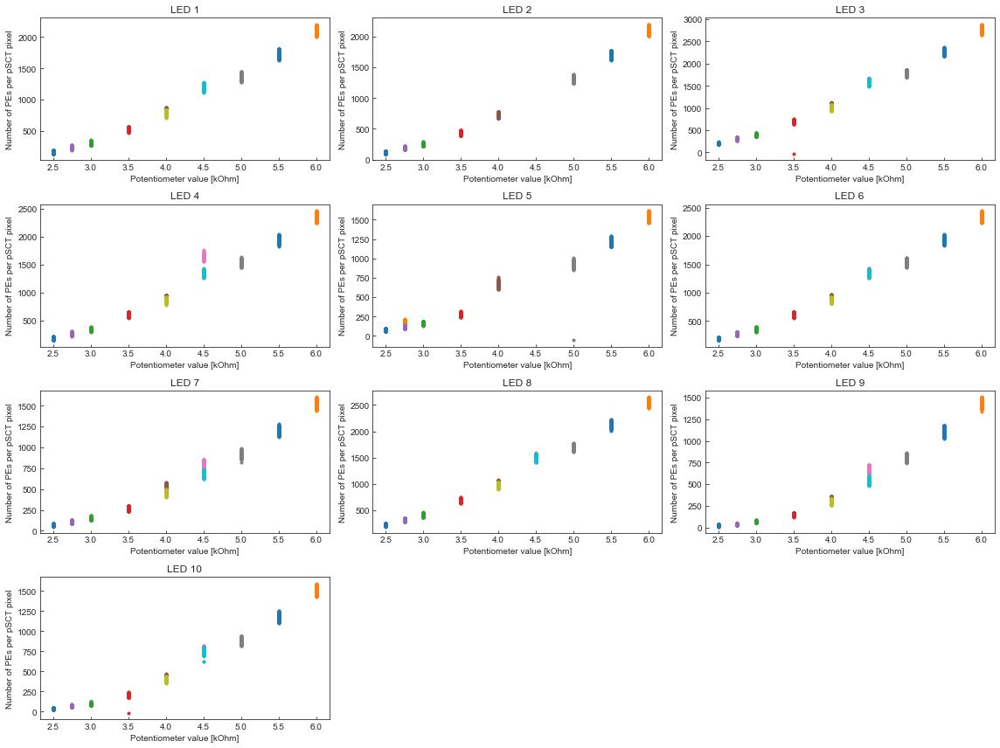

In [264]:
plot_NPE_vs_pot(dfs, outfile="flasher_levels_NPE_vs_pot_scatter_subplots.png", 
                 gain=3.93e5, 
                 dist_measure = 0.91, dist_cam = 1.86, 
                 pix_measure = 18, pixel_cam=36, 
                 subtract_baseline=True, 
                 show_label=False, ylim=None, xlim=None, plot_dims=[4,3], 
                 bins=None)

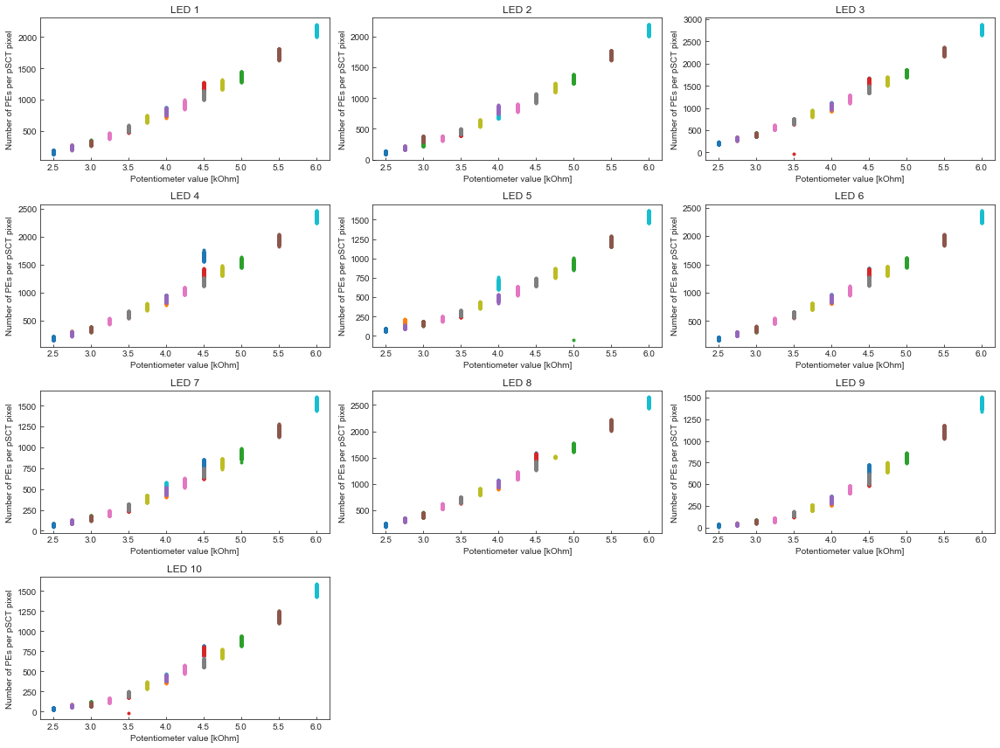

In [265]:
plot_NPE_vs_pot(dfs2, outfile="flasher_levels_NPE_vs_pot_scatter_subplots_v2.png", 
                 gain=3.93e5, 
                 dist_measure = 0.91, dist_cam = 1.86, 
                 pix_measure = 18, pixel_cam=36, 
                 subtract_baseline=True, 
                 show_label=False, ylim=None, xlim=None, plot_dims=[4,3], 
                 bins=None)

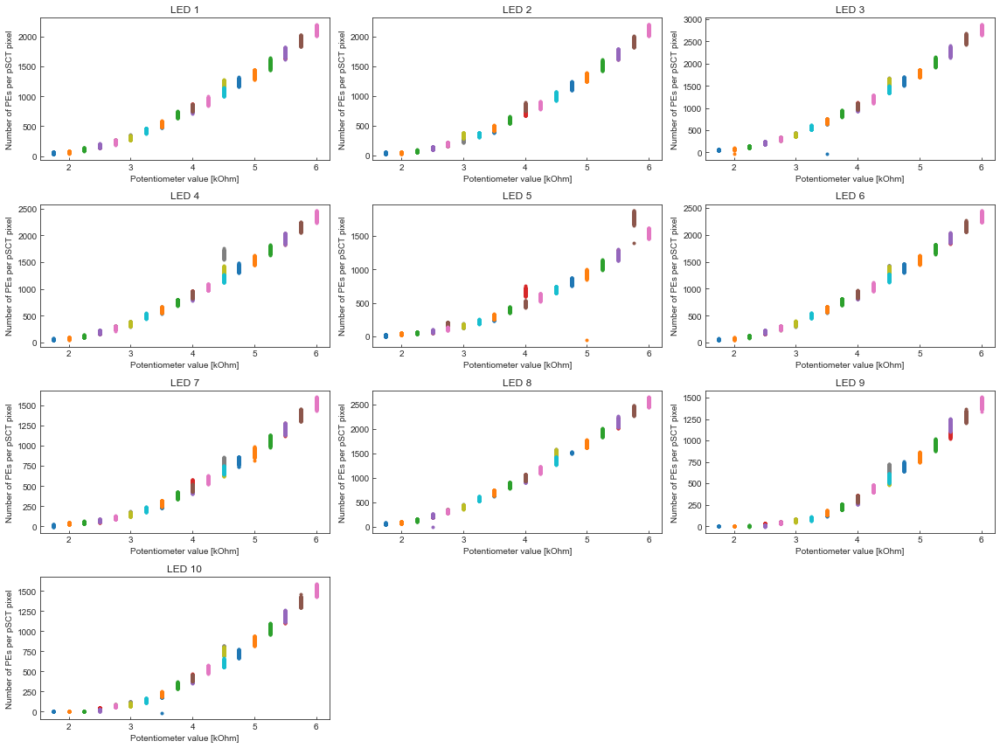

In [433]:
plot_NPE_vs_pot(dfs5, outfile="flasher_levels_NPE_vs_pot_scatter_subplots_v5.png", 
                 gain=3.93e5, 
                 dist_measure = 0.91, dist_cam = 1.86, 
                 pix_measure = 18, pixel_cam=36, 
                 subtract_baseline=True, 
                 show_label=False, ylim=None, xlim=None, plot_dims=[4,3], 
                 bins=None)

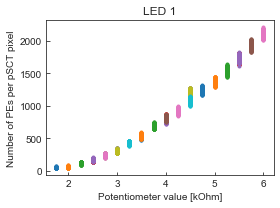

In [432]:
plot_NPE_vs_pot(dfs5, outfile="flasher_levels_NPE_vs_pot_scatter_LED1_v5.pdf", 
                useLED_bits=[6],
                 gain=3.93e5, figsize=[4,3],
                 dist_measure = 0.91, dist_cam = 1.86, 
                 pix_measure = 18, pixel_cam=36, 
                 subtract_baseline=True, 
                 show_label=False, ylim=None, xlim=None, plot_dims=[1,1], 
                 bins=None)

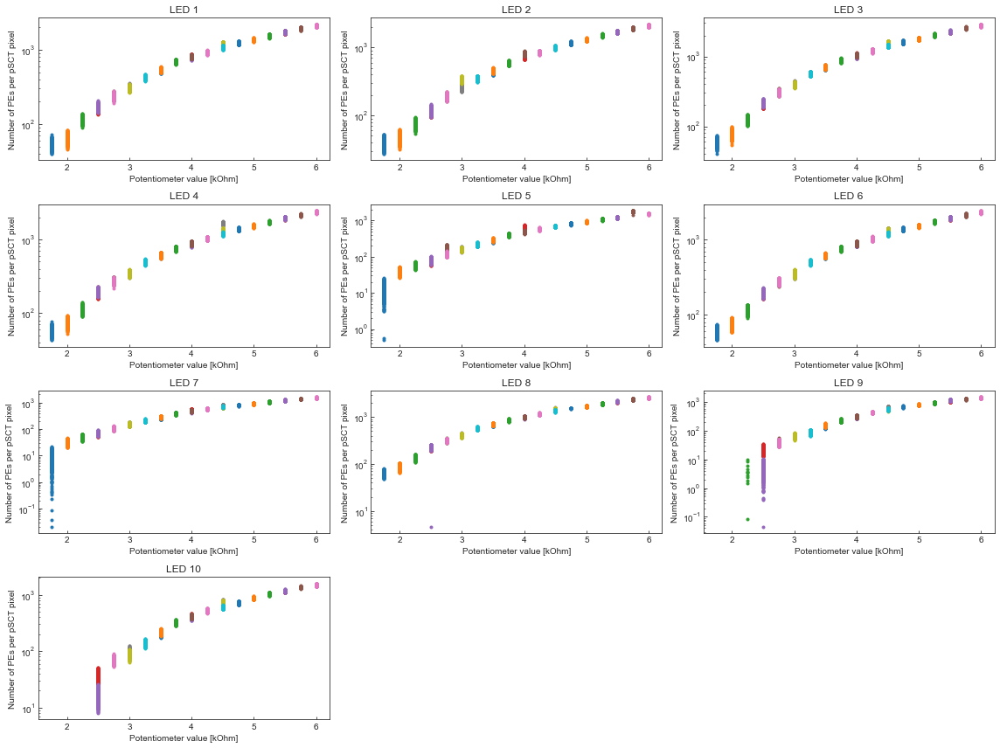

In [434]:
plot_NPE_vs_pot(dfs5, outfile="flasher_levels_NPE_vs_pot_scatter_subplots_v5_ylog.png", 
                 gain=3.93e5, 
                 dist_measure = 0.91, dist_cam = 1.86, 
                 pix_measure = 18, pixel_cam=36, 
                 subtract_baseline=True, ylog=True, 
                 show_label=False, ylim=None, xlim=None, plot_dims=[4,3], 
                 bins=None)

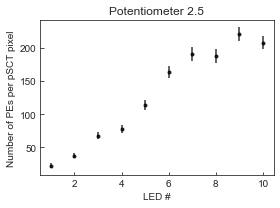

In [426]:
plot_NPE_vs_LEDs(dfs4, outfile="flasher_levels_NPE_vs_LEDs_scatter_pot2p5Feb16_stats_v5.pdf", 
                 gain=3.93e5, plot_one_pot="2p5k_Feb16",
                 dist_measure = 0.91, dist_cam = 1.86, figsize=[4,3],
                 pix_measure = 18, pixel_cam=36, 
                 subtract_baseline=True, 
                 plot_stats=True, 
                 show_label=False, ylim=None, xlim=None, plot_dims=[6,5], 
                 bins=None)



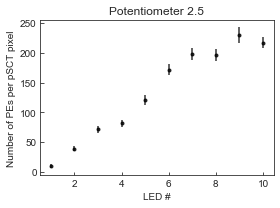

In [469]:
plot_NPE_vs_LEDs([df_feb19_2p5_recalc], outfile="flasher_levels_NPE_vs_LEDs_scatter_pot2p5Feb19_stats_v5.pdf", 
                 gain=3.93e5, plot_one_pot="2p5k_Feb19",
                 dist_measure = 0.91, dist_cam = 1.86, figsize=[4,3],
                 pix_measure = 18, pixel_cam=36, 
                 subtract_baseline=True, 
                 plot_stats=True, 
                 show_label=False, ylim=None, xlim=None, plot_dims=[6,5], 
                 bins=None)




0
1


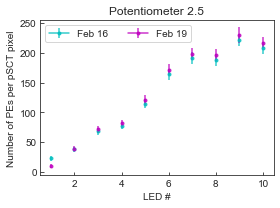

In [484]:
plot_NPE_vs_LEDs_overlay1([df_feb16_2p5, df_feb19_2p5_recalc], outfile="flasher_levels_NPE_vs_LEDs_scatter_pot2p5Feb16_19_stats_v5.pdf", 
                 gain=3.93e5, plot_one_pot="2p5k_Feb19",
                 dist_measure = 0.91, dist_cam = 1.86, figsize=[4,3],
                 pix_measure = 18, pixel_cam=36, 
                 subtract_baseline=True, 
                 plot_stats=True, cs = ['c', 'm'], labels=['Feb 16', 'Feb 19'],
                 show_label=False, ylim=None, xlim=None, plot_dims=[6,5], 
                 bins=None)





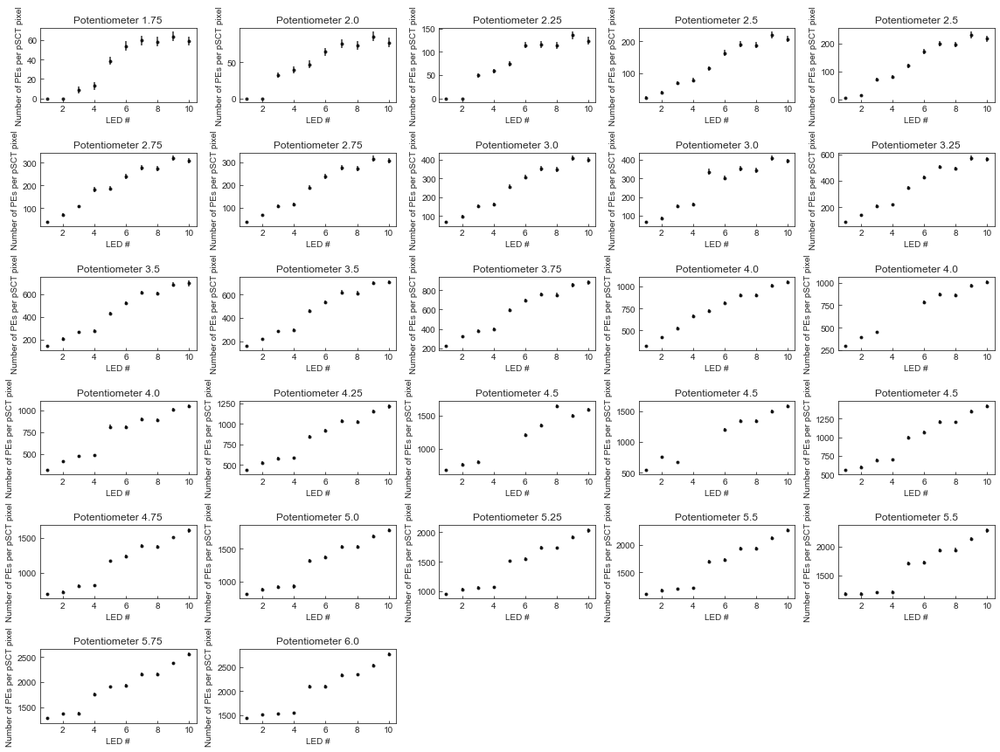

In [435]:
plot_NPE_vs_LEDs(dfs5, outfile="flasher_levels_NPE_vs_LEDs_scatter_subplots_stats_v6.pdf", 
                 gain=3.93e5, 
                 dist_measure = 0.91, dist_cam = 1.86, 
                 pix_measure = 18, pixel_cam=36, 
                 subtract_baseline=True, 
                 plot_stats=True, 
                 show_label=False, ylim=None, xlim=None, plot_dims=[6,5], 
                 bins=None)


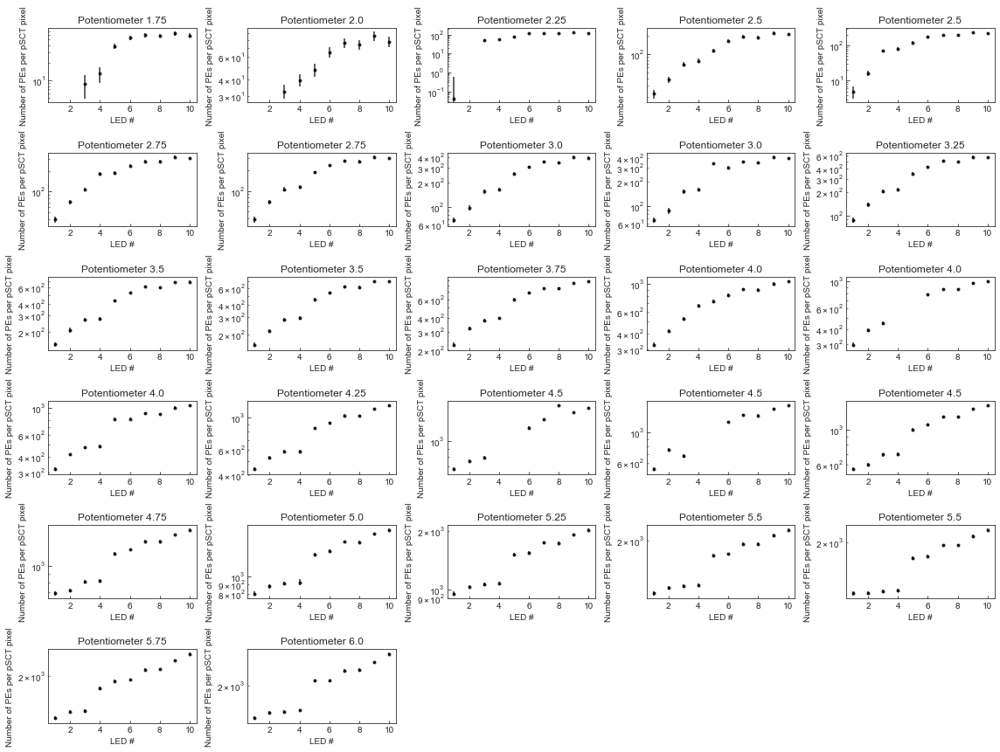

In [436]:
plot_NPE_vs_LEDs(dfs5, outfile="flasher_levels_NPE_vs_LEDs_scatter_subplots_v6_log_stats.pdf", 
                 gain=3.93e5, 
                 dist_measure = 0.91, dist_cam = 1.86, 
                 pix_measure = 18, pixel_cam=36, 
                 subtract_baseline=True, plot_stats=True, 
                 show_label=False, ylim=None, xlim=None, plot_dims=[6,5], 
                 bins=None, ylog=True)

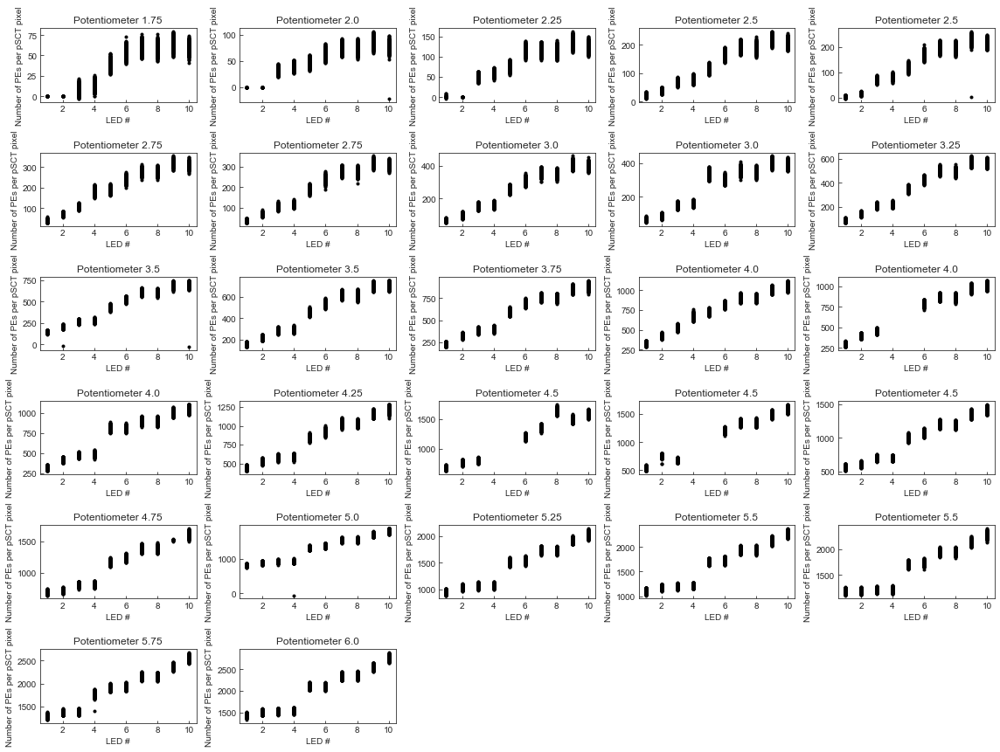

In [437]:
plot_NPE_vs_LEDs(dfs5, outfile="flasher_levels_NPE_vs_LEDs_scatter_subplots_v6.png", 
                 gain=3.93e5, 
                 dist_measure = 0.91, dist_cam = 1.86, 
                 pix_measure = 18, pixel_cam=36, 
                 subtract_baseline=True, plot_stats=False, 
                 show_label=False, ylim=None, xlim=None, plot_dims=[6,5], 
                 bins=None)

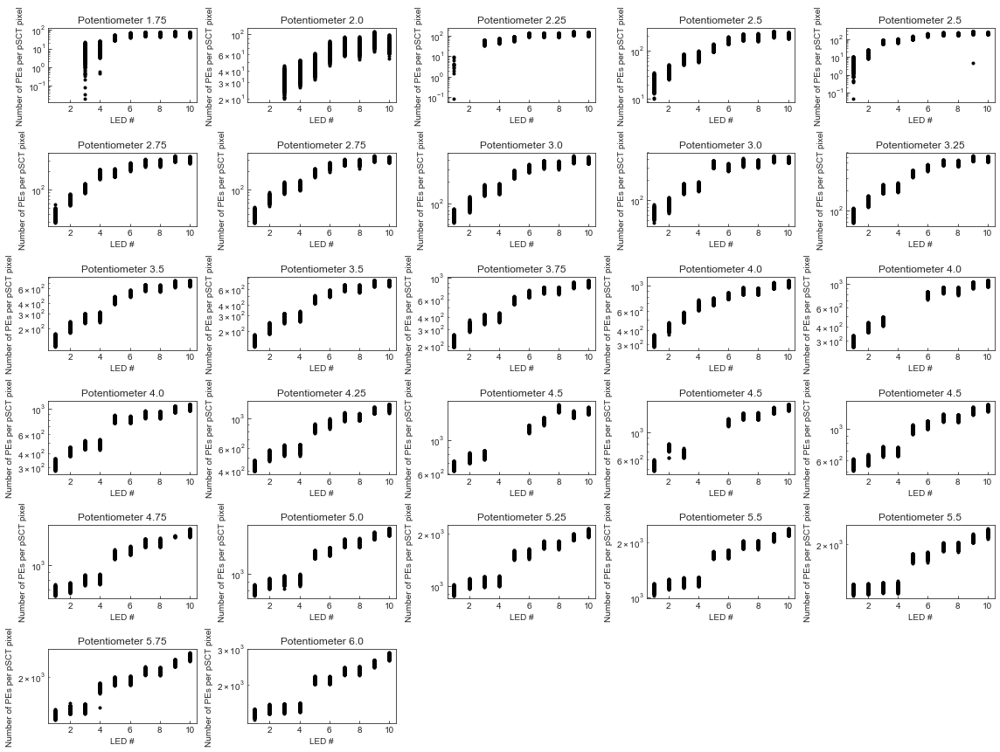

In [438]:
plot_NPE_vs_LEDs(dfs5, outfile="flasher_levels_NPE_vs_LEDs_scatter_subplots_v6_log.png", 
                 gain=3.93e5, 
                 dist_measure = 0.91, dist_cam = 1.86, 
                 pix_measure = 18, pixel_cam=36, 
                 subtract_baseline=True, plot_stats=False, 
                 show_label=False, ylim=None, xlim=None, plot_dims=[6,5], 
                 bins=None, ylog=True)

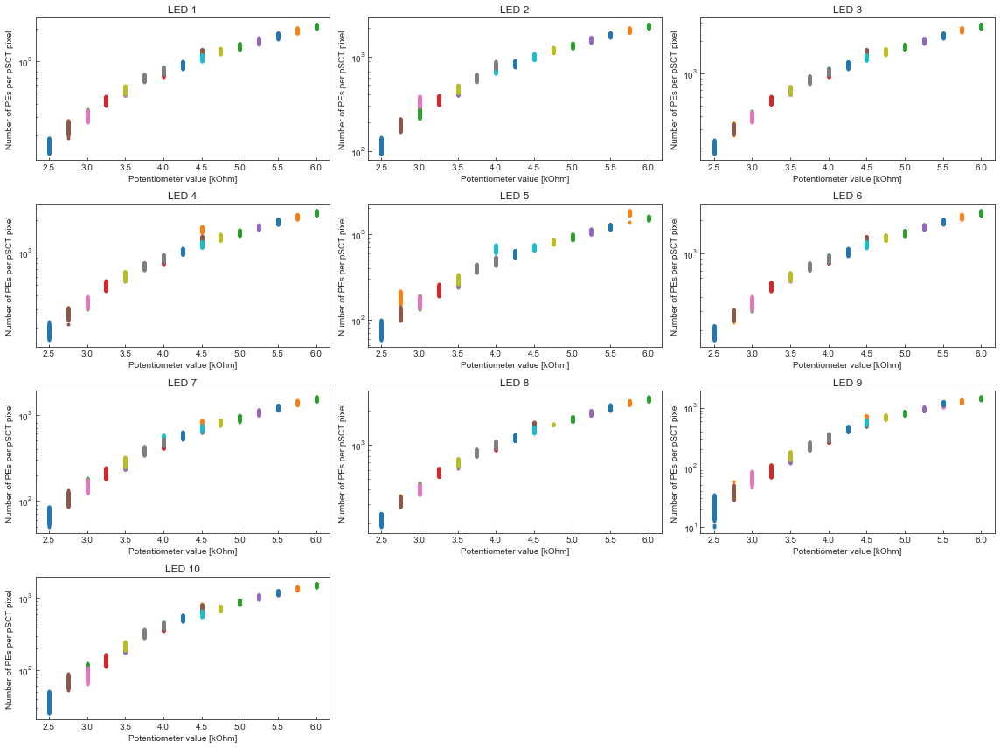

In [272]:
plot_NPE_vs_pot(dfs4, outfile="flasher_levels_NPE_vs_pot_scatter_subplots_log_v4.png", 
                 gain=3.93e5, 
                 dist_measure = 0.91, dist_cam = 1.86, 
                 pix_measure = 18, pixel_cam=36, 
                 subtract_baseline=True, 
                 show_label=False, ylim=None, xlim=None, plot_dims=[4,3], 
                 ylog=True, 
                 bins=None)



In [43]:
df_feb16_2p5.head()

,LEDs,pot_value_ohm,FWHM_s,half_max_V,fit_trise_s,fit_tdecay_s,fit_peak_V,fit_tpeak_s,fit_baseline_V,fit_redchisq,integrate_window_start,integrate_window_stop,integrated_charge_all,integrated_charge_window
0,1,2p5k_Feb16,9.000000e-09,-0.03564,3.800525e-09,5.950136e-09,0.087147,8.127604e-08,-0.000692,0.000011,6.577970e-08,1.297985e-07,-9.864000e-10,-8.528400e-10
1,1,2p5k_Feb16,8.000000e-09,-0.03708,3.849174e-09,5.611848e-09,0.087398,8.126988e-08,-0.000868,0.000007,6.557517e-08,1.270336e-07,-9.979200e-10,-8.521200e-10
2,1,2p5k_Feb16,8.000000e-09,-0.03852,3.426058e-09,5.883052e-09,0.092203,8.141271e-08,-0.000707,0.000011,6.744322e-08,1.293881e-07,-9.990000e-10,-8.668800e-10
3,1,2p5k_Feb16,8.000000e-09,-0.03708,3.581337e-09,6.458572e-09,0.088700,8.142124e-08,-0.000603,0.000013,6.681861e-08,1.340899e-07,-1.011600e-09,-8.982000e-10
4,1,2p5k_Feb16,9.000000e-09,-0.03996,3.797334e-09,5.815755e-09,0.095037,8.127199e-08,-0.000751,0.000009,6.578865e-08,1.286986e-07,-1.062000e-09,-9.270000e-10


In [22]:
# lo:  L2 L5 L7 L9 L10 0  1  1
# hi:  L1 L3 L4 L6 L8  1  1  1
#plt.cm
def plot_fwhm_vs_pot(dfs, outfile="flasher_levels_fwhm_vs_pot_subplots.png", 
                     subtract_baseline=True, all_data_duration_s=2e-7, plot_stats=False, 
                 show_label=False, ylim=None, xlim=None, plot_dims=[3,2], ns=False, 
                  draw_10ns=True, plot_one_LED=0, figsize=[16,12], 
                 bins=None):        
    fig = plt.figure(figsize=figsize)
    for ii, i in enumerate([6,1,7,8,2,9,3,10,4,5]):
        #for ii, i in enumerate([4,5,3,2,1,6,7,8,9,10]):
        if plot_one_LED > 0:
            if (ii+1) != plot_one_LED:
                continue
            plt.subplot(111)
        else:
            plt.subplot(plot_dims[0],plot_dims[1],ii+1)       

        for k, df_flasher2 in enumerate(dfs):
            #            
            df_flasher_stat2 = pd.DataFrame(df_flasher2.groupby('LEDs').describe())
            df_flasher_stat2['half_max_V']=-df_flasher_stat2['half_max_V']
            pot_val = df_flasher2['pot_value_ohm'].values[0]
            pot_val = pot_val.split('k')[0]
            pot_val = float('.'.join(pot_val.split('p')))
            cs_ = df_flasher2[df_flasher2.LEDs==i].FWHM_s
            if plot_stats:
                mean_ = np.mean(cs_)
                std_ = np.std(cs_)
                if ns:
                    mean_ = mean_*1e9
                    std_ = std_*1e9
                plt.errorbar([pot_val], [mean_], yerr=[std_], 
                             marker='.', #color='k', ecolor='k', 
                             alpha=0.8, capthick=0)
            else:
                if show_label:
                    plt.plot(np.ones_like(cs_)*pot_val, cs_, marker='.', ls="", label="LED {}".format(ii+1))
                else:
                    plt.plot(np.ones_like(cs_)*pot_val, cs_, marker='.', ls="", )#, label="LED {}".format(ii+1))
        if draw_10ns:
            plt.axhline(10, ls=':', alpha=0.3, color='k')
        if show_label:
            plt.legend(ncol=4)
            
        plt.title("LED {}".format(ii+1))

        plt.xlabel("Potentiometer value [kOhm]")
        if ns:
            plt.ylabel("FWHM [ns]")
        else:
            plt.ylabel("FWHM [s]")
        
        if show_label:
            plt.legend(ncol=4)
        if ylim is not None:
            plt.ylim(ylim)
        if xlim is not None:
            plt.xlim(xlim)
        #plt.title(title)
    plt.tight_layout()
    plt.savefig(outfile)







In [23]:
# lo:  L2 L5 L7 L9 L10 0  1  1
# hi:  L1 L3 L4 L6 L8  1  1  1
#plt.cm
def plot_x_vs_pot(dfs, outfile="flasher_levels_fwhm_vs_pot_subplots.png", col_name='fit_trise_s',
                     subtract_baseline=True, all_data_duration_s=2e-7, plot_stats=False, ns=False, 
                 show_label=False, ylim=None, xlim=None, plot_dims=[3,2], plot_one_LED=0, figsize=[16,12], 
                 bins=None):        
    fig = plt.figure(figsize=figsize)
    for ii, i in enumerate([6,1,7,8,2,9,3,10,4,5]):
        #for ii, i in enumerate([4,5,3,2,1,6,7,8,9,10]):
        if plot_one_LED > 0:
            if (ii+1) != plot_one_LED:
                continue
            plt.subplot(111)
        else:
            plt.subplot(plot_dims[0],plot_dims[1],ii+1)
        #plt.title(df_flasher2.pot_value_ohm[0])
        for k, df_flasher2 in enumerate(dfs):
            #            
            df_flasher_stat2 = pd.DataFrame(df_flasher2.groupby('LEDs').describe())
            df_flasher_stat2['half_max_V']=-df_flasher_stat2['half_max_V']
            pot_val = df_flasher2['pot_value_ohm'].values[0]
            pot_val = pot_val.split('k')[0]
            pot_val = float('.'.join(pot_val.split('p')))
            cs_ = df_flasher2[df_flasher2.LEDs==i][col_name]
            if plot_stats:
                mean_ = np.mean(cs_)
                std_ = np.std(cs_)
                if ns:
                    mean_ = mean_*1e9
                    std_ = std_*1e9

                plt.errorbar([pot_val], [mean_], yerr=[std_], 
                             marker='.', #color='k', ecolor='k', 
                             alpha=0.8, capthick=0)
            else:
                if show_label:
                    plt.plot(np.ones_like(cs_)*pot_val, cs_, marker='.', ls="", label="LED {}".format(ii+1))
                else:
                    plt.plot(np.ones_like(cs_)*pot_val, cs_, marker='.', ls="", )#, label="LED {}".format(ii+1))
        if show_label:
            plt.legend(ncol=4)
            
        plt.title("LED {}".format(ii+1))

        plt.xlabel("Potentiometer value [kOhm]")
        if ns:
            plt.ylabel("{} [ns]".format(col_name))
        else:
            plt.ylabel(col_name)
        
        if show_label:
            plt.legend(ncol=4)
        if ylim is not None:
            plt.ylim(ylim)
        if xlim is not None:
            plt.xlim(xlim)
        #plt.title(title)
    plt.tight_layout()
    plt.savefig(outfile)



In [485]:
df_feb16_2p5.head()

,LEDs,pot_value_ohm,FWHM_s,half_max_V,fit_trise_s,fit_tdecay_s,fit_peak_V,fit_tpeak_s,fit_baseline_V,fit_redchisq,integrate_window_start,integrate_window_stop,integrated_charge_all,integrated_charge_window
0,1,2p5k_Feb16,9.000000e-09,-0.03564,3.800525e-09,5.950136e-09,0.087147,8.127604e-08,-0.000692,0.000011,6.577970e-08,1.297985e-07,-9.864000e-10,-8.528400e-10
1,1,2p5k_Feb16,8.000000e-09,-0.03708,3.849174e-09,5.611848e-09,0.087398,8.126988e-08,-0.000868,0.000007,6.557517e-08,1.270336e-07,-9.979200e-10,-8.521200e-10
2,1,2p5k_Feb16,8.000000e-09,-0.03852,3.426058e-09,5.883052e-09,0.092203,8.141271e-08,-0.000707,0.000011,6.744322e-08,1.293881e-07,-9.990000e-10,-8.668800e-10
3,1,2p5k_Feb16,8.000000e-09,-0.03708,3.581337e-09,6.458572e-09,0.088700,8.142124e-08,-0.000603,0.000013,6.681861e-08,1.340899e-07,-1.011600e-09,-8.982000e-10
4,1,2p5k_Feb16,9.000000e-09,-0.03996,3.797334e-09,5.815755e-09,0.095037,8.127199e-08,-0.000751,0.000009,6.578865e-08,1.286986e-07,-1.062000e-09,-9.270000e-10


In [24]:
def plot_fwhm_vs_LEDs_overlay1(dfs, outfile="flasher_fwhm_test_2_subplots.png", gain=3.93e5, 
                            dist_measure = 0.91, dist_cam = 1.86, 
                            pix_measure = 18, pixel_cam=36, plot_one_pot=None, 
                         subtract_baseline=True, all_data_duration_s=2e-7, 
                 show_label=False, ylim=None, xlim=None, plot_dims=[3,2], 
                 bins=None, ylog=False, figsize=[16,12], cs=['k','c'],labels=['Feb 16', 'Feb 19'],
                    plot_stats=True, ):        
    

    fig = plt.figure(figsize=figsize)
    plt.subplot(111)
    ns=1e9
    for k, df_flasher2 in enumerate(dfs):
        pot_val = df_flasher2['pot_value_ohm'].values[0]
        pot_val = pot_val.split('k')[0]
        pot_val = float('.'.join(pot_val.split('p')))

        
        print(k)
        #for ii, i in enumerate([6,1,7,8,2,9,3,10,4,5]):
        #for ii, i in enumerate([9,10,7,5,2,1,6,4,8,3]):
        for ii, i in enumerate([4,5,3,2,1,6,9,8,10,7]):
            #plt.title(df_flasher2.pot_value_ohm[0])
            #            
            #df_flasher_stat2 = pd.DataFrame(df_flasher2.groupby('LEDs').describe())
            #df_flasher_stat2['half_max_V']=-df_flasher_stat2['half_max_V']

            cs_ = df_flasher2[df_flasher2.LEDs==i].FWHM_s*ns
                
            if plot_stats:
                if ii==0:
                    label_=labels[k]
                else:
                    label_=""
                mean_ = np.mean(cs_)
                std_ = np.std(cs_)
                plt.errorbar([ii+1], [mean_], yerr=[std_], 
                             marker='.', color=cs[k], ecolor=cs[k], alpha=0.8, capthick=0, label=label_)
            else:
                if show_label:
                    plt.plot(np.ones_like(cs_)*(ii+1), cs_, color=cs[k], marker='.', ls="", label=labels[k])
                else:
                    plt.plot(np.ones_like(cs_)*(ii+1), cs_, color=cs[k], marker='.', ls="", )#, label="LED {}".format(ii+1))
        if show_label:
            plt.legend(ncol=4)
            
        #plt.title("LED {}".format(ii+1))
        plt.title("Potentiometer {}".format(pot_val))

        plt.axhline(10, ls=':', alpha=0.3, color='k')        
        #plt.xlabel("Potentiometer value [kOhm]")
        plt.xlabel("LED # sorted by intensity")

        plt.ylabel("FWHM [ns]")
        
        #if show_label:
        plt.legend(ncol=4)
        if ylim is not None:
            plt.ylim(ylim)
        if xlim is not None:
            plt.xlim(xlim)
        if ylog:
            plt.yscale('log')
        #plt.title(title)
    plt.tight_layout()
    plt.savefig(outfile)






In [518]:
df_feb16_2p5.columns

Index(['LEDs', 'pot_value_ohm', 'FWHM_s', 'half_max_V', 'fit_trise_s',
       'fit_tdecay_s', 'fit_peak_V', 'fit_tpeak_s', 'fit_baseline_V',
       'fit_redchisq', 'integrate_window_start', 'integrate_window_stop',
       'integrated_charge_all', 'integrated_charge_window'],
      dtype='object')

In [520]:
np.log(2)

0.6931471805599453

In [524]:
np.e**(-1/2), 2**(-1/(np.log(2)*2))

(0.6065306597126334, 0.6065306597126334)

In [25]:
def plot_fwhm_vs_LEDs_overlay_fromfit(dfs, outfile="flasher_fwhm_test_2_subplots.png", gain=3.93e5, 
                            dist_measure = 0.91, dist_cam = 1.86, 
                            pix_measure = 18, pixel_cam=36, plot_one_pot=None, 
                         subtract_baseline=True, all_data_duration_s=2e-7, 
                 show_label=False, ylim=None, xlim=None, plot_dims=[3,2], 
                 bins=None, ylog=False, figsize=[16,12], cs=['k','c'],labels=['Feb 16', 'Feb 19'],
                    plot_stats=True, ):        
    

    fig = plt.figure(figsize=figsize)
    plt.subplot(111)
    ns=1e9
    for k, df_flasher2 in enumerate(dfs):
        pot_val = df_flasher2['pot_value_ohm'].values[0]
        pot_val = pot_val.split('k')[0]
        pot_val = float('.'.join(pot_val.split('p')))

        
        print(k)
        #for ii, i in enumerate([6,1,7,8,2,9,3,10,4,5]):
        #for ii, i in enumerate([9,10,7,5,2,1,6,4,8,3]):
        for ii, i in enumerate([4,5,3,2,1,6,9,8,10,7]):
            #plt.title(df_flasher2.pot_value_ohm[0])
            #            
            #df_flasher_stat2 = pd.DataFrame(df_flasher2.groupby('LEDs').describe())
            #df_flasher_stat2['half_max_V']=-df_flasher_stat2['half_max_V']

            cs_ = (df_flasher2[df_flasher2.LEDs==i].fit_trise_s+ df_flasher2[df_flasher2.LEDs==i].fit_tdecay_s) * np.log(2)*ns
                
            if plot_stats:
                if ii==0:
                    label_=labels[k]
                else:
                    label_=""
                mean_ = np.mean(cs_)
                std_ = np.std(cs_)
                plt.errorbar([ii+1], [mean_], yerr=[std_], 
                             marker='.', color=cs[k], ecolor=cs[k], alpha=0.8, capthick=0, label=label_)
            else:
                if show_label:
                    plt.plot(np.ones_like(cs_)*(ii+1), cs_, color=cs[k], marker='.', ls="", label=labels[k])
                else:
                    plt.plot(np.ones_like(cs_)*(ii+1), cs_, color=cs[k], marker='.', ls="", )#, label="LED {}".format(ii+1))
        if show_label:
            plt.legend(ncol=4)
            
        #plt.title("LED {}".format(ii+1))
        plt.title("Potentiometer {}".format(pot_val))

        plt.axhline(10, ls=':', alpha=0.3, color='k')        
        #plt.xlabel("Potentiometer value [kOhm]")
        plt.xlabel("LED # sorted by intensity")

        plt.ylabel("FWHM [ns]")
        
        #if show_label:
        plt.legend(ncol=4)
        if ylim is not None:
            plt.ylim(ylim)
        if xlim is not None:
            plt.xlim(xlim)
        if ylog:
            plt.yscale('log')
        #plt.title(title)
    plt.tight_layout()
    plt.savefig(outfile)







0
1
2


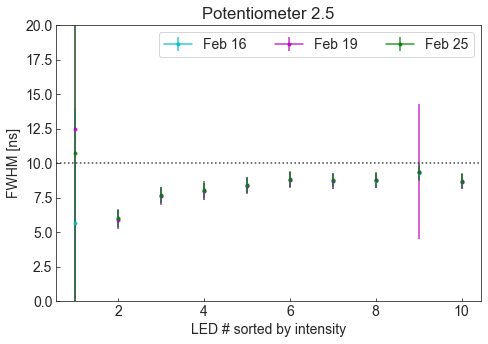

In [546]:
plot_fwhm_vs_LEDs_overlay1([df_feb16_2p5, df_feb19_2p5_recalc, df_feb25_2p5], 
                           outfile="flasher_FWHM_vs_LEDs_scatter_pot2p5Feb16_19_25_stats_v5.pdf", 
                 gain=3.93e5, 
                 dist_measure = 0.91, dist_cam = 1.86, figsize=[7,5],
                 pix_measure = 18, pixel_cam=36, 
                 subtract_baseline=True, 
                 plot_stats=True, cs = ['c', 'm', 'g'], labels=['Feb 16', 'Feb 19', 'Feb 25'],

                 show_label=False, ylim=[0,20], xlim=None, plot_dims=[6,5], 
                 bins=None)



0
1
2


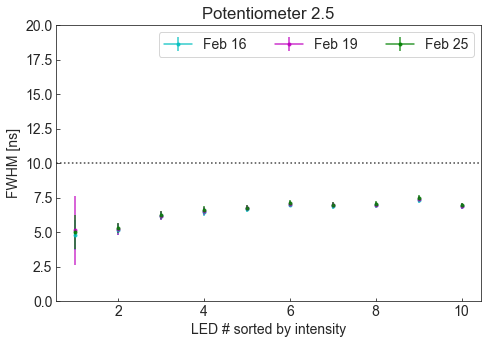

In [547]:
plot_fwhm_vs_LEDs_overlay_fromfit([df_feb16_2p5, df_feb19_2p5_recalc, df_feb25_2p5], 
                                  outfile="flasher_FWHM_vs_LEDs_from_fit_pot2p5Feb16_19_25_stats_v5.pdf", 
                 gain=3.93e5, 
                 dist_measure = 0.91, dist_cam = 1.86, figsize=[7,5],
                 pix_measure = 18, pixel_cam=36, 
                 subtract_baseline=True, 
                 plot_stats=True, cs = ['c', 'm', 'g'], labels=['Feb 16', 'Feb 19', 'Feb 25'],

                 show_label=False, ylim=[0,20], xlim=None, plot_dims=[6,5], 
                 bins=None)



0
1
2


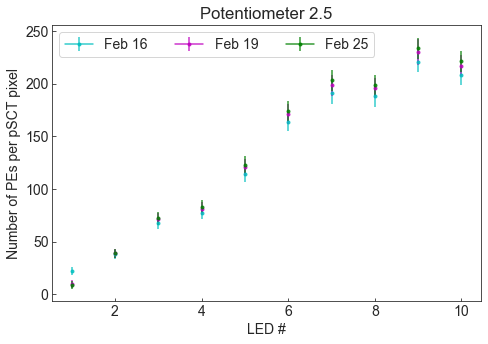

In [536]:
plot_NPE_vs_LEDs_overlay1([df_feb16_2p5, df_feb19_2p5_recalc, df_feb25_2p5], 
                          outfile="flasher_levels_NPE_vs_LEDs_scatter_pot2p5Feb16_19_25_stats_v6.pdf", 
                 gain=3.93e5, plot_one_pot="2p5k_Feb",
                 dist_measure = 0.91, dist_cam = 1.86, figsize=[7,5],
                 pix_measure = 18, pixel_cam=36, 
                 subtract_baseline=True, 
                 plot_stats=True, cs = ['c', 'm', 'g'], labels=['Feb 16', 'Feb 19', 'Feb 25'],
                 show_label=False, ylim=None, xlim=None, plot_dims=[6,5], 
                 bins=None)





In [26]:
def plot_x_vs_LEDs_overlay1(dfs, outfile="flasher_fwhm_test_2_subplots.png", gain=3.93e5, 
                            dist_measure = 0.91, dist_cam = 1.86, col_name='fit_trise_s',ns=1e9, 
                            pix_measure = 18, pixel_cam=36, plot_one_pot=None, 
                         subtract_baseline=True, all_data_duration_s=2e-7, 
                 show_label=False, ylim=None, xlim=None, plot_dims=[3,2], 
                 bins=None, ylog=False, figsize=[16,12], cs=['k','c'],labels=['Feb 16', 'Feb 19'],
                    plot_stats=True, ):        
    

    fig = plt.figure(figsize=figsize)
    plt.subplot(111)
    
    for k, df_flasher2 in enumerate(dfs):
        pot_val = df_flasher2['pot_value_ohm'].values[0]
        pot_val = pot_val.split('k')[0]
        pot_val = float('.'.join(pot_val.split('p')))

        
        print(k)
        #for ii, i in enumerate([6,1,7,8,2,9,3,10,4,5]):
        #for ii, i in enumerate([9,10,7,5,2,1,6,4,8,3]):
        for ii, i in enumerate([4,5,3,2,1,6,9,8,10,7]):
            #plt.title(df_flasher2.pot_value_ohm[0])
            #            
            #df_flasher_stat2 = pd.DataFrame(df_flasher2.groupby('LEDs').describe())
            #df_flasher_stat2['half_max_V']=-df_flasher_stat2['half_max_V']

            cs_ = df_flasher2[df_flasher2.LEDs==i][col_name]*ns
                
            if plot_stats:
                if ii==0:
                    label_=labels[k]
                else:
                    label_=""
                mean_ = np.mean(cs_)
                std_ = np.std(cs_)
                plt.errorbar([ii+1], [mean_], yerr=[std_], 
                             marker='.', color=cs[k], ecolor=cs[k], alpha=0.8, capthick=0, label=label_)
            else:
                if show_label:
                    plt.plot(np.ones_like(cs_)*(ii+1), cs_, color=cs[k], marker='.', ls="", label=labels[k])
                else:
                    plt.plot(np.ones_like(cs_)*(ii+1), cs_, color=cs[k], marker='.', ls="", )#, label="LED {}".format(ii+1))
        if show_label:
            plt.legend(ncol=4)
            
        #plt.title("LED {}".format(ii+1))
        plt.title("Potentiometer {}".format(pot_val))

        #plt.axhline(10, ls=':', alpha=0.3, color='k')        
        #plt.xlabel("Potentiometer value [kOhm]")
        plt.xlabel("LED # sorted by intensity")

        if ns==1e9:
            plt.ylabel("{} [ns]".format(col_name))
        else:
            plt.ylabel(col_name)
        
        #if show_label:
        plt.legend(ncol=4)
        if ylim is not None:
            plt.ylim(ylim)
        if xlim is not None:
            plt.xlim(xlim)
        if ylog:
            plt.yscale('log')
        #plt.title(title)
    plt.tight_layout()
    plt.savefig(outfile)







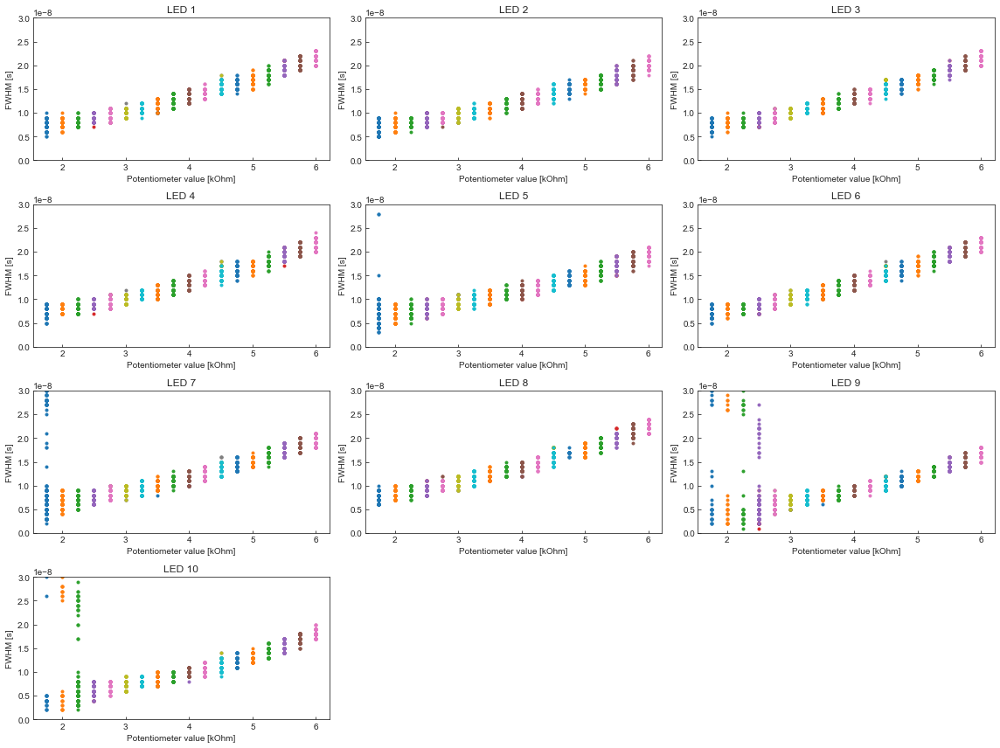

In [466]:
plot_fwhm_vs_pot(dfs5, outfile="flasher_levels_fwhm_vs_pot_scatter_subplots_v6.png", 
                 show_label=False, ylim=[0,3e-8], xlim=None, plot_dims=[4,3], 
                 bins=None)

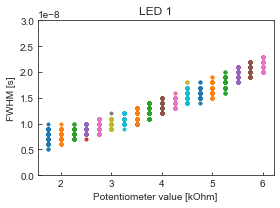

In [447]:
plot_fwhm_vs_pot(dfs5, outfile="flasher_levels_fwhm_vs_pot_scatter_LED1_v6.png", 
                 show_label=False, ylim=[0,3e-8], xlim=None, plot_dims=[4,3], plot_one_LED=1, figsize=[4,3],
                 bins=None)

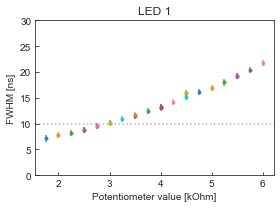

In [449]:
plot_fwhm_vs_pot(dfs5, outfile="flasher_levels_fwhm_vs_pot_scatter_LED1_v6_stats_ns_hline.pdf", 
                 show_label=False, ylim=[0,30], xlim=None, plot_dims=[4,3], plot_stats=True, ns=True, 
                 plot_one_LED=1, figsize=[4,3],
                 bins=None)

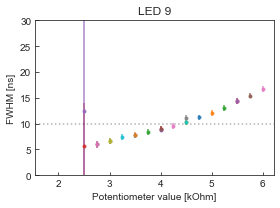

In [463]:
plot_fwhm_vs_pot(dfs5, outfile="flasher_levels_fwhm_vs_pot_scatter_LED9_v6_stats_ns_hline.pdf", 
                 show_label=False, ylim=[0,30], xlim=None, plot_dims=[4,3], plot_stats=True, ns=True, 
                 plot_one_LED=9, figsize=[4,3],
                 bins=None)

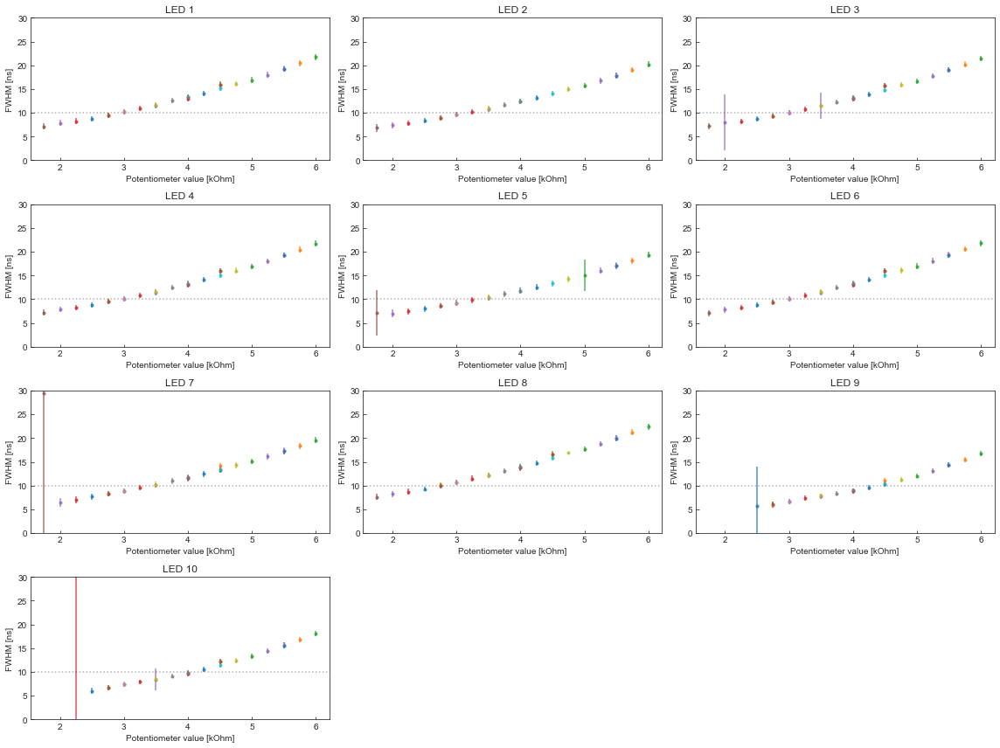

In [454]:
plot_fwhm_vs_pot(dfs4, outfile="flasher_levels_fwhm_vs_pot_scatter_subplots_v5_stats_ns_hline.pdf", 
                 show_label=False, ylim=[0,30], xlim=None, plot_dims=[4,3], plot_stats=True, ns=True, 
                 bins=None)

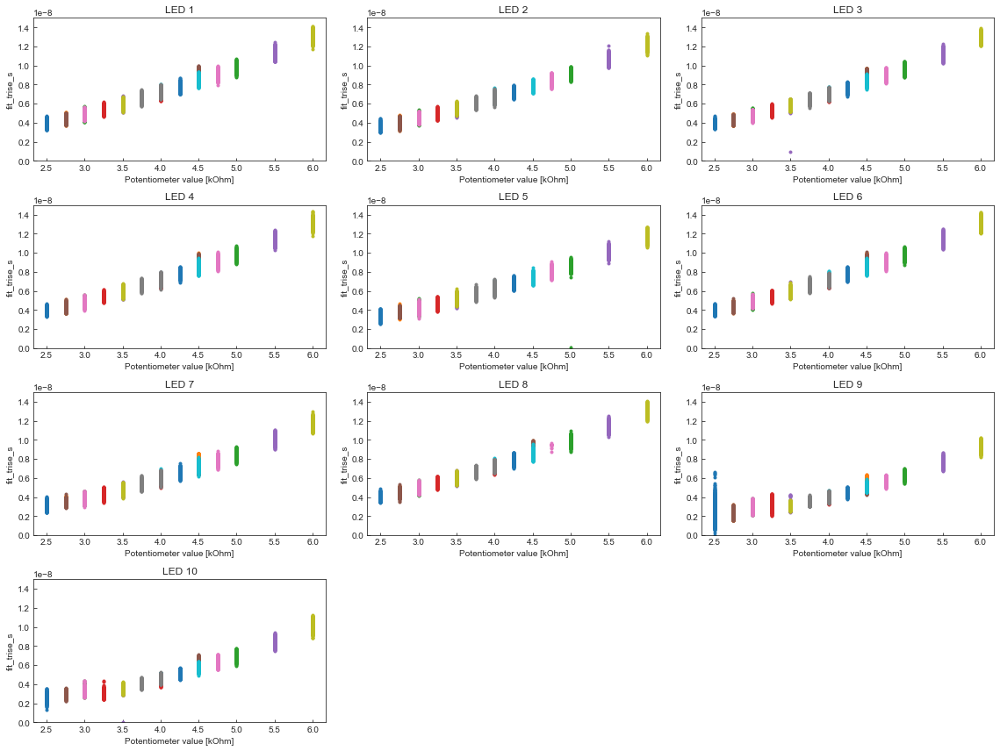

In [335]:
plot_x_vs_pot(dfs3, outfile="flasher_levels_riseT_vs_pot_subplots_v3.png", col_name='fit_trise_s',
                     subtract_baseline=True, all_data_duration_s=2e-7, 
                 show_label=False, ylim=[0,1.5e-8], xlim=None, plot_dims=[4,3], 
                 bins=None)


0
1
2


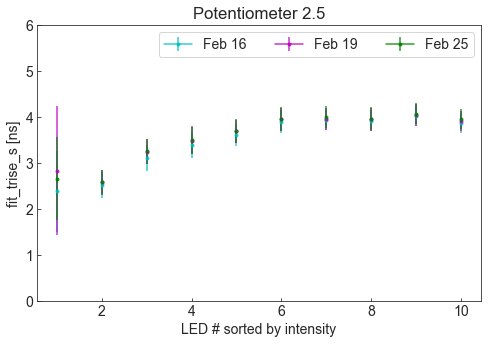

In [543]:
plot_x_vs_LEDs_overlay1([df_feb16_2p5, df_feb19_2p5_recalc, df_feb25_2p5], 
                        outfile="flasher_riseT_vs_LEDs_scatter_pot2p5Feb16_19_25_stats_v5.pdf", 
                 gain=3.93e5, col_name='fit_trise_s',
                 dist_measure = 0.91, dist_cam = 1.86, figsize=[7,5],
                 pix_measure = 18, pixel_cam=36, 
                 subtract_baseline=True, 
                 plot_stats=True, cs = ['c', 'm', 'g'], labels=['Feb 16', 'Feb 19', 'Feb 25'],
                 show_label=False, ylim=[0,6], xlim=None, plot_dims=[6,5], 
                 bins=None)



In [503]:
df_feb16_2p5.columns

Index(['LEDs', 'pot_value_ohm', 'FWHM_s', 'half_max_V', 'fit_trise_s',
       'fit_tdecay_s', 'fit_peak_V', 'fit_tpeak_s', 'fit_baseline_V',
       'fit_redchisq', 'integrate_window_start', 'integrate_window_stop',
       'integrated_charge_all', 'integrated_charge_window'],
      dtype='object')

0
1
2


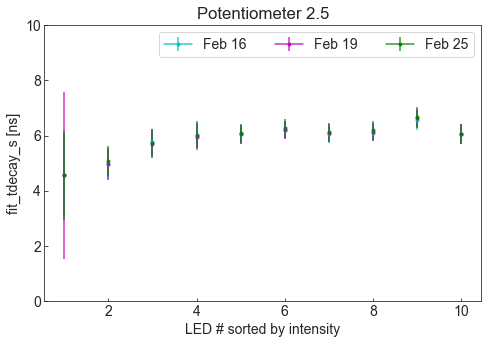

In [544]:
plot_x_vs_LEDs_overlay1([df_feb16_2p5, df_feb19_2p5_recalc,df_feb25_2p5], 
                        outfile="flasher_decayT_vs_LEDs_scatter_pot2p5Feb16_19_25_stats_v5.pdf", 
                 gain=3.93e5, col_name='fit_tdecay_s',
                 dist_measure = 0.91, dist_cam = 1.86, figsize=[7,5],
                 pix_measure = 18, pixel_cam=36, 
                 subtract_baseline=True, 
                 plot_stats=True, cs = ['c', 'm', 'g'], labels=['Feb 16', 'Feb 19', 'Feb 25'],
                 show_label=False, ylim=[0,10], xlim=None, plot_dims=[6,5], 
                 bins=None)




0
1
2


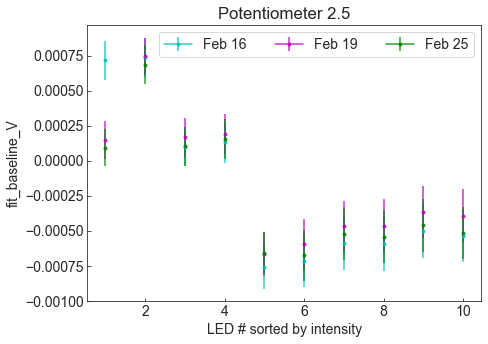

In [545]:
plot_x_vs_LEDs_overlay1([df_feb16_2p5, df_feb19_2p5_recalc, df_feb25_2p5], 
                        outfile="flasher_baseline_vs_LEDs_scatter_pot2p5Feb16_19_25_stats_v5.pdf", 
                 gain=3.93e5, col_name='fit_baseline_V',ns=1,
                 dist_measure = 0.91, dist_cam = 1.86, figsize=[7,5],
                 pix_measure = 18, pixel_cam=36, 
                 subtract_baseline=True, 
                 plot_stats=True, cs = ['c', 'm', 'g'], labels=['Feb 16', 'Feb 19', 'Feb 25'],

                 show_label=False, ylim=None, xlim=None, plot_dims=[6,5], 
                 bins=None)



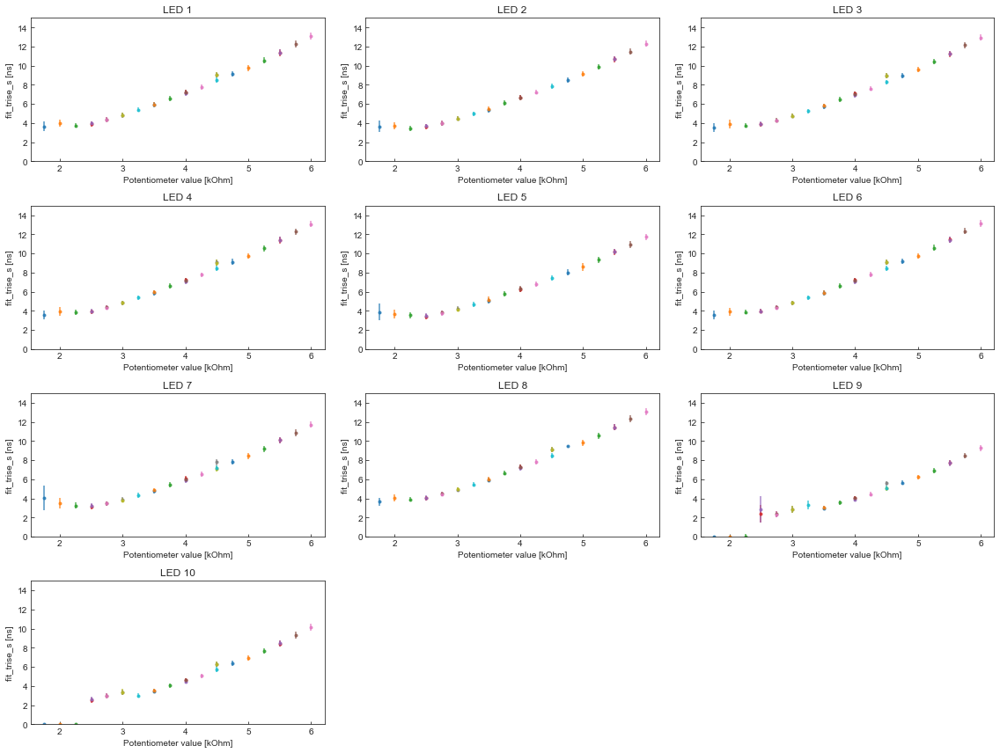

In [464]:
plot_x_vs_pot(dfs5, outfile="flasher_levels_riseT_vs_pot_subplots_v5_stats_ns.png", col_name='fit_trise_s',
                     subtract_baseline=True, all_data_duration_s=2e-7, plot_stats=True,  ns=True, 
                 show_label=False, ylim=[0,15], xlim=None, plot_dims=[4,3], 
                 bins=None)



In [62]:
df_feb16_2p5.head()

,LEDs,pot_value_ohm,FWHM_s,half_max_V,fit_trise_s,fit_tdecay_s,fit_peak_V,fit_tpeak_s,fit_baseline_V,fit_redchisq,integrate_window_start,integrate_window_stop,integrated_charge_all,integrated_charge_window
0,1,2p5k_Feb16,9.000000e-09,-0.03564,3.800525e-09,5.950136e-09,0.087147,8.127604e-08,-0.000692,0.000011,6.577970e-08,1.297985e-07,-9.864000e-10,-8.528400e-10
1,1,2p5k_Feb16,8.000000e-09,-0.03708,3.849174e-09,5.611848e-09,0.087398,8.126988e-08,-0.000868,0.000007,6.557517e-08,1.270336e-07,-9.979200e-10,-8.521200e-10
2,1,2p5k_Feb16,8.000000e-09,-0.03852,3.426058e-09,5.883052e-09,0.092203,8.141271e-08,-0.000707,0.000011,6.744322e-08,1.293881e-07,-9.990000e-10,-8.668800e-10
3,1,2p5k_Feb16,8.000000e-09,-0.03708,3.581337e-09,6.458572e-09,0.088700,8.142124e-08,-0.000603,0.000013,6.681861e-08,1.340899e-07,-1.011600e-09,-8.982000e-10
4,1,2p5k_Feb16,9.000000e-09,-0.03996,3.797334e-09,5.815755e-09,0.095037,8.127199e-08,-0.000751,0.000009,6.578865e-08,1.286986e-07,-1.062000e-09,-9.270000e-10


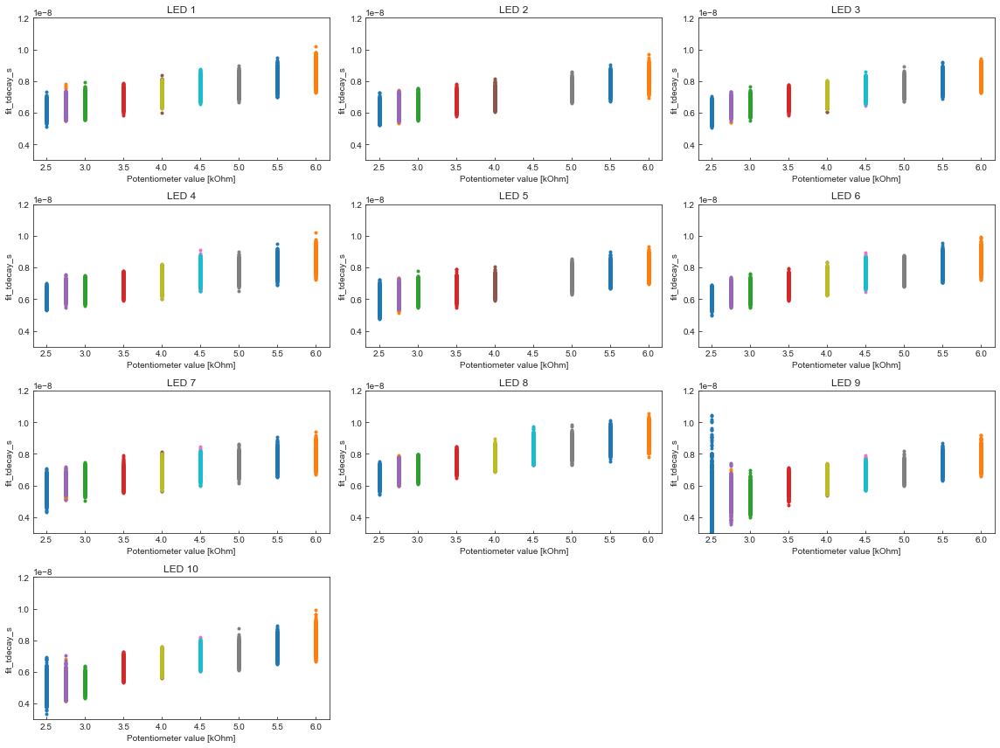

In [65]:
plot_x_vs_pot(dfs, outfile="flasher_levels_decayT_vs_pot_subplots.png", col_name='fit_tdecay_s',
                     subtract_baseline=True, all_data_duration_s=2e-7, 
                 show_label=False, ylim=[0.3e-8,1.2e-8], 
              xlim=None, plot_dims=[4,3], 
                 bins=None)



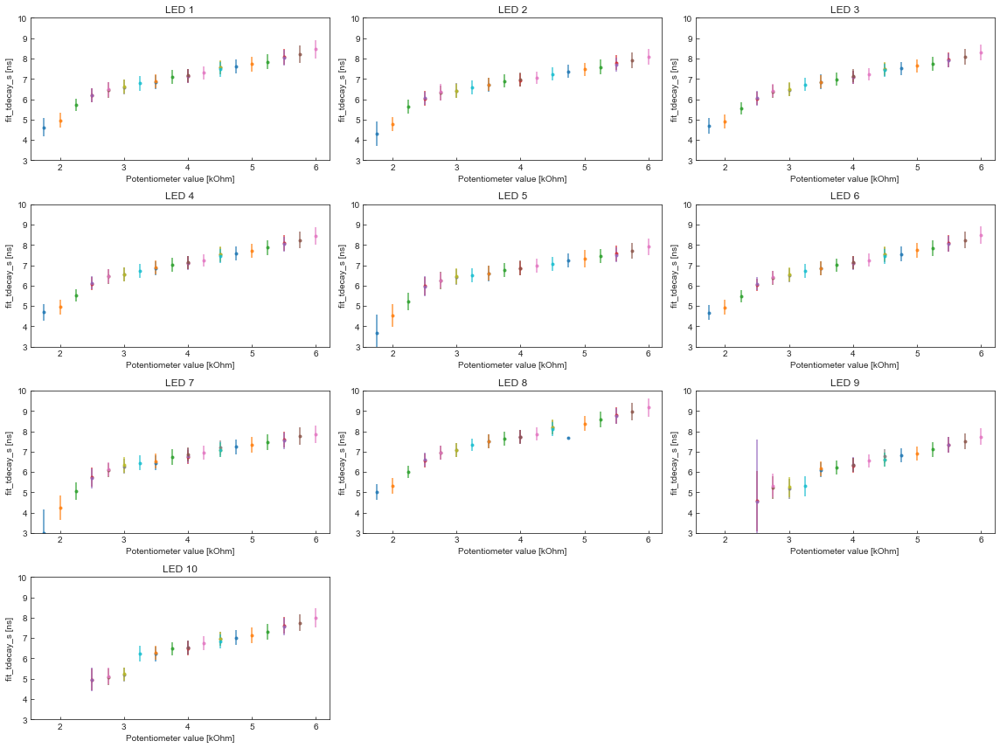

In [465]:
plot_x_vs_pot(dfs5, outfile="flasher_levels_decayT_vs_pot_subplots_v5_stats_ns.png", col_name='fit_tdecay_s',
                     subtract_baseline=True, all_data_duration_s=2e-7, plot_stats=True,  ns=True, 
                 show_label=False, ylim=[3,10], 
              xlim=None, plot_dims=[4,3], 
                 bins=None)




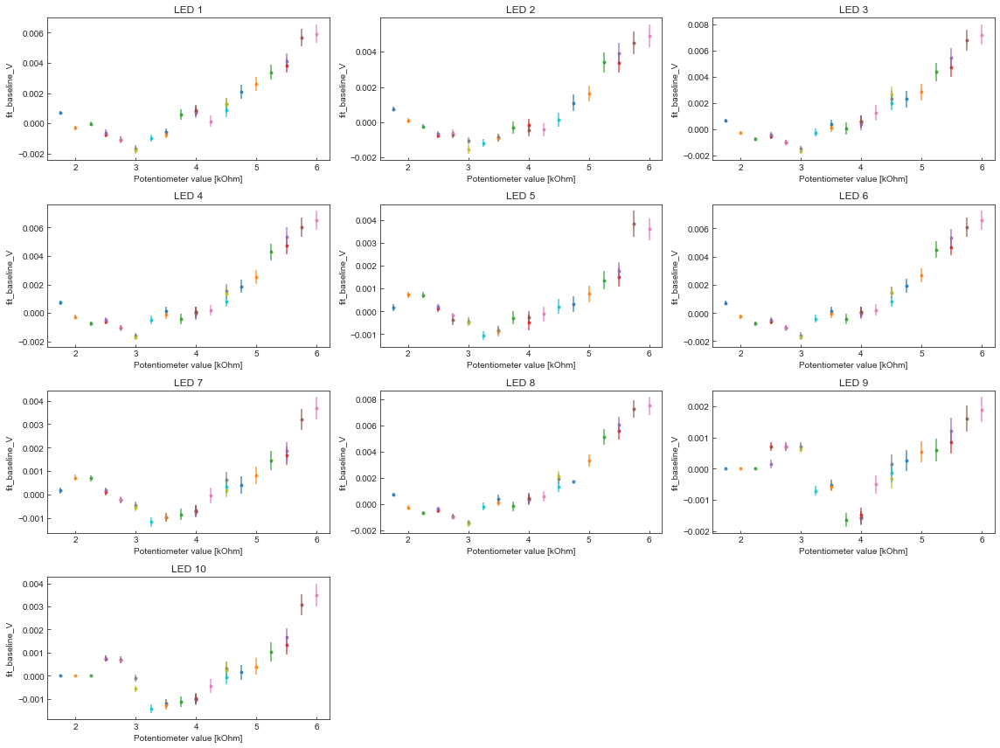

In [467]:
plot_x_vs_pot(dfs5, outfile="flasher_levels_baseline_vs_pot_subplots_v5_stats.png", col_name='fit_baseline_V',
                     subtract_baseline=True, all_data_duration_s=2e-7, plot_stats=True,  
                 show_label=False, #ylim=[0.3e-8,1.2e-8], 
              xlim=None, plot_dims=[4,3], 
                 bins=None)





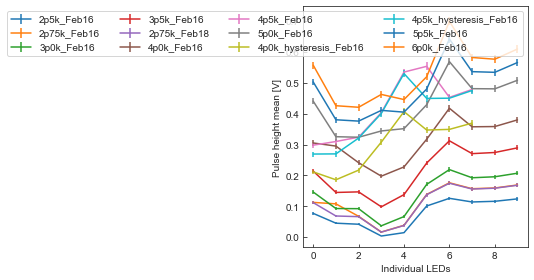

In [60]:
plot_LED_levels(dfs, outfile="flasher_levels_test_2.png", 
                 show_label=True, ylim=None, xlim=None, plot_dims=[3,2], 
                 bins=None)

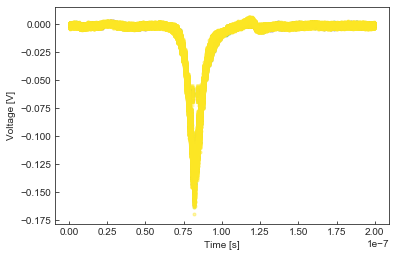

In [274]:
import glob
initial_params=[0.1, 8.e-8, 1.e-9, 10.e-9, 0.]
verbose=False
#for ii, i in enumerate([4,5,3,2,1,6,7,8,9,10]):
plot_name = "pot_2p5k_Feb16_overlay.png"

#fig=plt.figure()
fig, ax = plt.subplots()
cm = plt.get_cmap('viridis')
NUM_COLORS = 50

for ii, i in enumerate([7]):
    k = 0
    for f_ in glob.iglob('flasher_data/pot_2p5k_Feb16/LED{}*.csv'.format(i)):
        #print(f_)
        df = pd.read_csv(f_)
        ts=df['T'].values
        vs=df.V.values
        #print(ts.shape, vs.shape)
        # Fit the trace w exponential 
        #params: amp, tpeak, trise, tdecay, const
        parLCL3, covLCL3 = curve_fit(flare_func_w_const, ts,
                                vs, p0=initial_params, 
                                ) #, 
                                #method='trf', ftol=1e-10, loss='soft_l1') #approx abs

        par_names8=['amplitude', 'tpeak', 'trise', 'tdecay', 'const']
        if verbose:
            for i in range(len(par_names8)):
                print("Flare exponential fit param %d (%s) = %.4g +/- %.4g" % (i, par_names8[i], 
                                                                                                parLCL3[i], 
                                                                                                np.sqrt(abs(covLCL3[i,i]))))

        #def chisq(y_vals, y_expected, y_errs, num_params=1):
            #  for reduced chisq test, under the assumption of Poisson counting
            #  we have lnL = const - (1/2.)*chi2
        chi2LC3L1, dof3L1, redchi2LC3L1 = chisq(vs, 
                                          flare_func_w_const(ts, *parLCL3), 
                                          1, 
                                          5)
        lnL_LC3L1 = -0.5*chi2LC3L1
        if verbose:
            print("fit Chisq is %.3f, dof is %d, reduced Chisq is %.2f" % (chi2LC3L1, dof3L1, redchi2LC3L1))
            print("Log likelihood lnL={0}".format(lnL_LC3L1))



        # calc FWHM
        #wid, half_max, lind, rind = FWHM(ts[ind], vs[ind])
        wid, half_max, lind, rind = FWHM(ts, vs, verbose=verbose)

        #print(wid, half_max, lind, rind, ts[lind], ts[rind])

        # colors = [cm((i+0.1)/NUM_COLORS) for i in range(NUM_COLORS,0,-1)]
        #colors = [cm(1 / 1.3 * (i + 0.3) / NUM_COLORS) for i in range(NUM_COLORS)]
        
        c_ = cm(1 / 1.3 * (k + 0.3) / NUM_COLORS)
        ax.plot(ts, vs, color=c_, marker='.', alpha=0.5)#, label=k)
        ax.hlines(half_max, ts[lind], ts[rind], colors=c_, 
                  #linestyles=":", 
                  linestyles="--",
                  alpha=0.4)
        ax.plot(ts, flare_func_w_const(ts, *parLCL3), color=c_, marker='.', 
                  #linestyles=":", 
                  ls="",
                 alpha=0.4) 
        k+=1
        #print(k)
        
    plt.xlabel('Time [s]')
    plt.ylabel('Voltage [V]')
    #plt.legend(ncol=8)
    plot_name_ = plot_name.split('.')[0]+'_LED_{}'.format(i)+'.'+plot_name.split('.')[1]
    plt.savefig(plot_name_)
    #if show:
    #plt.show()


        #break
    

Start window 5.913363451521784e-08 s, stop window 1.4623772294330768e-07 s, window width 8.710408842808983e-08 s
integral all = -8.333999999999739e-09
integral window = -8.239999999999743e-09


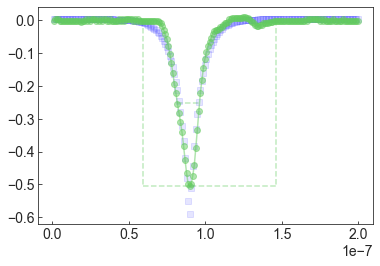

In [64]:
fig, ax = plt.subplots()
#params: amp, tpeak, trise, tdecay, const


ax.hlines(half_max, ts[lind], ts[rind], colors=c_, 
                  #linestyles=":", 
                  linestyles="--",
                  alpha=0.4)

ax.plot(ts, flare_func_w_const(ts, *parLCL3), color='b', marker='s', 
                  #linestyles=":", 
                  ls="",
                 alpha=0.1) 


start_window = parLCL3[1] - 1.5*np.e*parLCL3[2]
stop_window = parLCL3[1] + 3*np.e*parLCL3[3]

ax.vlines(start_window,0, 2*half_max, colors=c_, 
                  #linestyles=":", 
                  linestyles="--",
                  alpha=0.4)
ax.vlines(stop_window,0, 2*half_max, colors=c_, 
                  #linestyles=":", 
                  linestyles="--",
                  alpha=0.4)

ax.hlines(half_max*2, start_window, stop_window, colors=c_, 
                  #linestyles=":", 
                  linestyles="--",
                  alpha=0.4)




print("Start window {} s, stop window {} s, window width {} s".format(start_window, stop_window, stop_window-start_window))
ax.plot(ts, vs, color=c_, marker='o', alpha=0.5)#, label=k)

print("integral all = {}".format(np.trapz(vs, ts)))

int_slice = np.where((ts>=start_window) & (ts <=stop_window))
print("integral window = {}".format(np.trapz(vs[int_slice], ts[int_slice])))


942


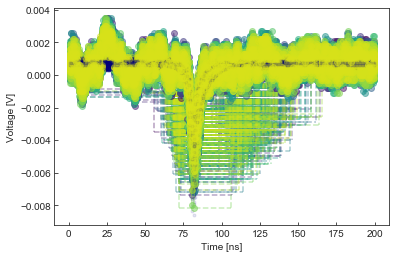

In [281]:
import glob
initial_params=[0.1, 8.e1, 5, 10., 0.]
verbose=False
#for ii, i in enumerate([4,5,3,2,1,6,7,8,9,10]):
plot_name = "pot_2p5k_Feb16_overlay2_nowindow.png"

#fig=plt.figure()
fig, ax = plt.subplots()
cm = plt.get_cmap('viridis')
NUM_COLORS = 1000

#for ii, i in enumerate([7]):
for ii, i in enumerate([4]):

    k = 0
    for f_ in glob.iglob('flasher_data/pot_2p5k_Feb16/LED{}*.csv'.format(i)):
        #print(f_)
        df = pd.read_csv(f_)
        ts=df['T'].values
        ts = ts*1e9
        vs=df.V.values
        #print(ts.shape, vs.shape)
        # Fit the trace w exponential 
        #params: amp, tpeak, trise, tdecay, const
        parLCL3, covLCL3 = curve_fit(flare_func_w_const, ts,
                                vs, p0=initial_params, 
                                ) #, 
                                #method='trf', ftol=1e-10, loss='soft_l1') #approx abs

        par_names8=['amplitude', 'tpeak', 'trise', 'tdecay', 'const']
        
        #params: amp, tpeak, trise, tdecay, const

        c_ = cm(float(k)/float(NUM_COLORS))
        
        wid, half_max, lind, rind = FWHM(ts, vs, verbose=verbose)

        
        ax.hlines(half_max, ts[lind], ts[rind], colors=c_, 
                          #linestyles=":", 
                          linestyles="--",
                          alpha=0.4)

        ax.plot(ts, flare_func_w_const(ts, *parLCL3), color='navy', marker='.', 
                          #linestyles=":", 
                          ls="",
                         alpha=0.1) 


        start_window = parLCL3[1] - 1.5*np.e*parLCL3[2]
        stop_window = parLCL3[1] + 3*np.e*parLCL3[3]

        ax.vlines(start_window,0, 2*half_max, colors=c_, 
                          #linestyles=":", 
                          linestyles="--",
                          alpha=0.4)
        ax.vlines(stop_window,0, 2*half_max, colors=c_, 
                          #linestyles=":", 
                          linestyles="--",
                          alpha=0.4)

        ax.hlines(half_max*2, start_window, stop_window, colors=c_, 
                          #linestyles=":", 
                          linestyles="--",
                          alpha=0.4)




        #print("Start window {} s, stop window {} s, window width {} s".format(start_window, stop_window, stop_window-start_window))
        ax.plot(ts, vs, color=c_, marker='o', alpha=0.5)#, label=k)

        #print("integral all = {}".format(np.trapz(vs, ts)))

        int_slice = np.where((ts>=start_window) & (ts <=stop_window))
        #print("integral window = {}".format(np.trapz(vs[int_slice], ts[int_slice])))
        k=k+1
        
    plt.xlabel('Time [ns]')
    plt.ylabel('Voltage [V]')
    #plt.ylim(-0.015,0.004)
    #plt.legend(ncol=8)
    plot_name_ = plot_name.split('.')[0]+'_LED_{}'.format(i)+'.'+plot_name.split('.')[1]
    plt.savefig(plot_name_)

    
print(k)



1000


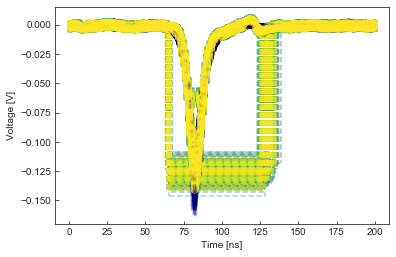

In [282]:
import glob
initial_params=[0.1, 8.e1, 5, 10., 0.]
verbose=False
#for ii, i in enumerate([4,5,3,2,1,6,7,8,9,10]):
plot_name = "pot_2p5k_Feb16_overlay2_nowindow.png"

#fig=plt.figure()
fig, ax = plt.subplots()
cm = plt.get_cmap('viridis')
NUM_COLORS = 1000

for ii, i in enumerate([7]):
#for ii, i in enumerate([4]):

    k = 0
    for f_ in glob.iglob('flasher_data/pot_2p5k_Feb16/LED{}*.csv'.format(i)):
        #print(f_)
        df = pd.read_csv(f_)
        ts=df['T'].values
        ts = ts*1e9
        vs=df.V.values
        #print(ts.shape, vs.shape)
        # Fit the trace w exponential 
        #params: amp, tpeak, trise, tdecay, const
        parLCL3, covLCL3 = curve_fit(flare_func_w_const, ts,
                                vs, p0=initial_params, 
                                ) #, 
                                #method='trf', ftol=1e-10, loss='soft_l1') #approx abs

        par_names8=['amplitude', 'tpeak', 'trise', 'tdecay', 'const']
        
        #params: amp, tpeak, trise, tdecay, const

        c_ = cm(float(k)/float(NUM_COLORS))
        
        wid, half_max, lind, rind = FWHM(ts, vs, verbose=verbose)

        
        ax.hlines(half_max, ts[lind], ts[rind], colors=c_, 
                          #linestyles=":", 
                          linestyles="--",
                          alpha=0.4)

        ax.plot(ts, flare_func_w_const(ts, *parLCL3), color='navy', marker='.', 
                          #linestyles=":", 
                          ls="",
                         alpha=0.1) 


        start_window = parLCL3[1] - 1.5*np.e*parLCL3[2]
        stop_window = parLCL3[1] + 3*np.e*parLCL3[3]

        ax.vlines(start_window,0, 2*half_max, colors=c_, 
                          #linestyles=":", 
                          linestyles="--",
                          alpha=0.4)
        ax.vlines(stop_window,0, 2*half_max, colors=c_, 
                          #linestyles=":", 
                          linestyles="--",
                          alpha=0.4)

        ax.hlines(half_max*2, start_window, stop_window, colors=c_, 
                          #linestyles=":", 
                          linestyles="--",
                          alpha=0.4)




        #print("Start window {} s, stop window {} s, window width {} s".format(start_window, stop_window, stop_window-start_window))
        ax.plot(ts, vs, color=c_, marker='o', alpha=0.5)#, label=k)

        #print("integral all = {}".format(np.trapz(vs, ts)))

        int_slice = np.where((ts>=start_window) & (ts <=stop_window))
        #print("integral window = {}".format(np.trapz(vs[int_slice], ts[int_slice])))
        k=k+1
        
    plt.xlabel('Time [ns]')
    plt.ylabel('Voltage [V]')
    #plt.ylim(-0.015,0.004)
    #plt.legend(ncol=8)
    plot_name_ = plot_name.split('.')[0]+'_LED_{}'.format(i)+'.'+plot_name.split('.')[1]
    plt.savefig(plot_name_)

    
print(k)




In [65]:
ts.shape

(200,)

In [27]:
# lo:  L2 L5 L7 L9 L10 0  1  1
# hi:  L1 L3 L4 L6 L8  1  1  1
#plt.cm
sort_LED_lev=[9,10,7,5,2,1,6,4,8,3]
def plot_NPE_vs_LEDs_long(dfs, pot_val = 2.5, 
                          outfile="flasher_levels_test_long.png", gain=3.93e5, 
                            dist_measure = 0.91, dist_cam = 1.86, 
                            pix_measure = 18, pixel_cam=36, datafile="NPE_vs_pattern.csv", 
                         subtract_baseline=True, all_data_duration_s=2e-7, 
                 show_label=False, ylim=None, xlim=None, 
                 bins=None, ylog=False, 
                    plot_stats=True, ):        
    Rterm=50.0
    e=1.602177e-19
    scale_factor = 1./Rterm/e/gain/pix_measure*pixel_cam*dist_measure*dist_measure/dist_cam/dist_cam

    fig = plt.figure(figsize=(6,6/1.614))
    patterns = []
    means = []
    errs = []
    for k, df_flasher2 in enumerate(dfs):
        #plt.subplot(plot_dims[0],plot_dims[1],k+1)
        #pot_val = df_flasher2['pot_value_ohm'].values[0]
        #pot_val = pot_val.split('k')[0]
        #pot_val = float('.'.join(pot_val.split('p')))
        #for ii, i in enumerate([6,1,7,8,2,9,3,10,4,5]):
        #for ii, i in enumerate([9,10,7,5,2,1,6,4,8,3]):
        #for ii, i in enumerate([4,5,3,2,1,6,9,8,10,7]):
        for ii, i in enumerate(df_flasher2.LEDs.unique()):        
            #plt.title(df_flasher2.pot_value_ohm[0])
            #            
            #df_flasher_stat2 = pd.DataFrame(df_flasher2.groupby('LEDs').describe())
            #df_flasher_stat2['half_max_V']=-df_flasher_stat2['half_max_V']
            if subtract_baseline:                    
                cs_ = -(df_flasher2[df_flasher2.LEDs==i].integrated_charge_window -
                        df_flasher2[df_flasher2.LEDs==i].fit_baseline_V * all_data_duration_s)*scale_factor
            else: 
                cs_ = -df_flasher2[df_flasher2.LEDs==i].integrated_charge_window*scale_factor
                
            mean_ = np.mean(cs_)
            std_ = np.std(cs_)
            patterns.append(str(i)), 
            means.append(mean_)
            errs.append(std_)
        
    means = np.array(means)
    errs = np.array(errs)
    patterns = np.array(patterns, dtype=str)

    ind = np.argsort(means)
    msort = means[ind]
    esort = errs[ind]
    psort = patterns[ind]


    #This is wrong so disable it
    show_label=False
    if show_label:
        plt.errorbar(range(msort.shape[0]), msort, 
                yerr=esort, fmt='.', color='k', ecolor='k', alpha=0.9, capthick=0, 
                    label="LED {}".format(i))
        plt.legend(ncol=4)
    else:
        plt.errorbar(range(msort.shape[0]), msort, 
                yerr=esort, fmt='.', color='k', ecolor='k', alpha=0.9, capthick=0)
    plt.title("Potentiometer {} kOhm".format(pot_val))

    plt.xlabel("LED pattern")

    plt.ylabel("Number of PEs per pSCT pixel")
        
    with open(datafile, 'a') as file:
        file.write("pattern_rank,pattern,NPE,dNPE\n")
        for i, pat in enumerate(psort):
            print("Pattern #{}: {}, NPE {:.2f}+/-{:.2f}".format(i, pat.zfill(10),msort[i],esort[i]))
            file.write("{},{},{:.2f},{:.2f}\n".format(i, pat.zfill(10),msort[i],esort[i]))

    if show_label:
            plt.legend(ncol=4)
    if ylim is not None:
            plt.ylim(ylim)
    if xlim is not None:
            plt.xlim(xlim)
    if ylog:
            plt.yscale('log')
    plt.tight_layout()
    plt.savefig(outfile)









In [577]:
df_feb25_2p5.LEDs[0]

1

In [581]:
df_feb25_2p5.LEDs[0] in df_feb19_2p5_recalc.LEDs

True

In [582]:
i=df_feb25_2p5.LEDs[0] 
i in df_feb19_2p5_recalc.LEDs

True

In [28]:
# lo:  L2 L5 L7 L9 L10 0  1  1
# hi:  L1 L3 L4 L6 L8  1  1  1
#plt.cm
sort_LED_lev=[9,10,7,5,2,1,6,4,8,3]
def plot_NPE_vs_LEDs_long_comp(dfs1,dfs2, pot_val = 2.5, 
                          outfile="flasher_levels_test_long.png", gain=3.93e5, 
                            dist_measure = 0.91, dist_cam = 1.86, 
                            pix_measure = 18, pix_measure2 = 18, pixel_cam=36, #datafile="NPE_vs_pattern.csv", 
                         subtract_baseline=True, all_data_duration_s=2e-7, 
                 show_label=False, ylim=None, xlim=None, 
                 bins=None, ylog=False, 
                    plot_stats=True, ):        
    Rterm=50.0
    e=1.602177e-19
    scale_factor = 1./Rterm/e/gain/pix_measure*pixel_cam*dist_measure*dist_measure/dist_cam/dist_cam
    scale_factor2 = 1./Rterm/e/gain/pix_measure2*pixel_cam*dist_measure*dist_measure/dist_cam/dist_cam


    fig = plt.figure(figsize=(6,6/1.614))
    patterns = []
    raw_patterns=[]
    means = []
    errs = []
    patterns2 = []
    means2 = []
    errs2 = []
    for k, df_flasher2 in enumerate(dfs1):
        #plt.subplot(plot_dims[0],plot_dims[1],k+1)
        #pot_val = df_flasher2['pot_value_ohm'].values[0]
        #pot_val = pot_val.split('k')[0]
        #pot_val = float('.'.join(pot_val.split('p')))
        #for ii, i in enumerate([6,1,7,8,2,9,3,10,4,5]):
        #for ii, i in enumerate([9,10,7,5,2,1,6,4,8,3]):
        #for ii, i in enumerate([4,5,3,2,1,6,9,8,10,7]):
        for ii, i in enumerate(df_flasher2.LEDs.unique()):        
            #plt.title(df_flasher2.pot_value_ohm[0])
            #            
            #df_flasher_stat2 = pd.DataFrame(df_flasher2.groupby('LEDs').describe())
            #df_flasher_stat2['half_max_V']=-df_flasher_stat2['half_max_V']
            if subtract_baseline:                    
                cs_ = -(df_flasher2[df_flasher2.LEDs==i].integrated_charge_window -
                        df_flasher2[df_flasher2.LEDs==i].fit_baseline_V * all_data_duration_s)*scale_factor
            else: 
                cs_ = -df_flasher2[df_flasher2.LEDs==i].integrated_charge_window*scale_factor
                
            mean_ = np.mean(cs_)
            std_ = np.std(cs_)
            patterns.append(str(i))
            raw_patterns.append(i)
            means.append(mean_)
            errs.append(std_)

            found=False
            for k2, df_flasher22 in enumerate(dfs2):
                #print(i, df_flasher22.LEDs.unique())
                if int(str(i).zfill(10)) not in df_flasher22.LEDs.unique():
                    #print("x")
                    print(i, df_flasher22.LEDs.unique())
                    print("Not found...")
                    continue
                found=True
                print("Found...")
                if subtract_baseline:                    
                    cs_2 = -(df_flasher22[df_flasher22.LEDs==i].integrated_charge_window -
                            df_flasher22[df_flasher22.LEDs==i].fit_baseline_V * all_data_duration_s)*scale_factor2
                else: 
                    cs_2 = -df_flasher22[df_flasher22.LEDs==i].integrated_charge_window*scale_factor2

                mean_2 = np.mean(cs_2)
                std_2 = np.std(cs_2)
                patterns2.append(str(i)), 
                means2.append(mean_2)
                errs2.append(std_2)
            if not found: 
                patterns2.append(str(i)), 
                means2.append(0)
                errs2.append(0)
            
    means = np.array(means)
    errs = np.array(errs)
    patterns = np.array(patterns, dtype=str)
    means2 = np.array(means2)
    errs2 = np.array(errs2)
    patterns2 = np.array(patterns2, dtype=str)


    
    ind = np.argsort(means)
    msort = means[ind]
    esort = errs[ind]
    psort = patterns[ind]


    msort2 = means2[ind]
    esort2 = errs2[ind]
    psort2 = patterns2[ind]

    

    #This is wrong so disable it
    show_label=False
    if show_label:
        plt.errorbar(range(msort.shape[0]), msort, 
                yerr=esort, fmt='.', color='k', ecolor='k', alpha=0.9, capthick=0, 
                    label="LED {}".format(i))
        plt.errorbar(range(msort2.shape[0]), msort2, 
                yerr=esort2, fmt='x', color='c', ecolor='c', alpha=0.9, capthick=0,
                     label="LED {}".format(i))
        plt.legend(ncol=4)
    else:
        plt.errorbar(range(msort.shape[0]), msort, 
                yerr=esort, fmt='.', color='k', ecolor='k', alpha=0.9, capthick=0)
        
        plt.errorbar(range(msort2.shape[0]), msort2, 
                yerr=esort2, fmt='x', color='c', ecolor='c', alpha=0.9, capthick=0)        
    plt.title("Potentiometer {} kOhm".format(pot_val))

    plt.xlabel("LED pattern")

    plt.ylabel("Number of PEs per pSCT pixel")
        

    if show_label:
            plt.legend(ncol=4)
    if ylim is not None:
            plt.ylim(ylim)
    if xlim is not None:
            plt.xlim(xlim)
    if ylog:
            plt.yscale('log')
    plt.tight_layout()
    plt.savefig(outfile)


    return patterns, means, patterns2, means2







Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...


(array(['1000000', '100000', '1000000000', '100000000', '10000000',
        '10000', '1000', '100', '10', '1', '1100000', '11000000',
        '101000000', '10100000', '100100000', '1001000000', '110000000',
        '1000100000', '1010000', '1010000000', '110000', '1100000000',
        '10010000', '1100001', '10000001', '11100001', '10100', '110100',
        '11000', '1110100', '101', '1111000', '11', '1110010000', '1001',
        '101001', '1101001', '10110100', '101110100', '10001001',
        '100101001', '110101001', '1011110100', '1101110100', '1101',
        '1101101', '100001101', '1000001101', '11101', '1111', '11101111',
        '1000001111', '110001111', '11111', '1111111', '10011111',
        '1000011111', '110111111', '1100011111', '1011111111',
        '1111111111'], dtype='<U10'),
 array([  19.77942621,   38.56981717,  192.8903832 ,  106.47950404,
          94.98672466,  269.35572867,  339.0658914 ,  295.16294492,
         310.63200106,  348.3130035 ,   48.52304166,  109.4

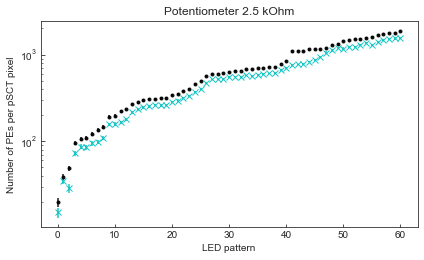

In [47]:
patterns, means, patterns2, means2=plot_NPE_vs_LEDs_long_comp( [dflong28], [dflong4], pot_val = 2.5, 
                                                              
                          outfile="flasher_levels_2p5_Feb28_Mar4_long_log_comp.pdf", gain=3.93e5, 
                            dist_measure = 0.91, dist_cam = 1.86, 
                            pix_measure = 36, pix_measure2=36, pixel_cam=36, 
                         subtract_baseline=True, all_data_duration_s=2e-7, 
                 show_label=False, ylim=None, xlim=None, 
                 bins=None, ylog=True, 
                    plot_stats=True)

patterns, means, patterns2, means2

In [25]:
int(str(1000000).zfill(10)) in dflong28.LEDs.unique()

True

Found...
1000000000 [   1100000   11000000  101000000   10100000  100100000 1001000000
  110000000 1000100000    1010000 1010000000     110000 1100000000
   10010000    1100001   10000001   11100001      10100     110100
      11000    1110100        101    1111000         11 1110010000
       1001     101001    1101001   10110100  101110100   10001001
  100101001  110101001 1011110100 1101110100       1101    1101101
  100001101 1000001101      11101       1111   11101111 1000001111
  110001111      11111    1111111   10011111 1000011111  110111111
 1100011111 1011111111 1111111111]
Not found...
Found...
100000000 [   1100000   11000000  101000000   10100000  100100000 1001000000
  110000000 1000100000    1010000 1010000000     110000 1100000000
   10010000    1100001   10000001   11100001      10100     110100
      11000    1110100        101    1111000         11 1110010000
       1001     101001    1101001   10110100  101110100   10001001
  100101001  110101001 1011110100 11011101

11 [1000000000  100000000   10000000    1000000     100000      10000
       1000        100         10          1]
Not found...
Found...
1001 [1000000000  100000000   10000000    1000000     100000      10000
       1000        100         10          1]
Not found...
Found...
101001 [1000000000  100000000   10000000    1000000     100000      10000
       1000        100         10          1]
Not found...
Found...
1101001 [1000000000  100000000   10000000    1000000     100000      10000
       1000        100         10          1]
Not found...
Found...
100101001 [1000000000  100000000   10000000    1000000     100000      10000
       1000        100         10          1]
Not found...
Found...
110101001 [1000000000  100000000   10000000    1000000     100000      10000
       1000        100         10          1]
Not found...
Found...
1101 [1000000000  100000000   10000000    1000000     100000      10000
       1000        100         10          1]
Not found...
Found...
1101101

(array(['1000000000', '100000000', '10000000', '1000000', '100000',
        '10000', '1000', '100', '10', '1', '1100000', '11000000',
        '10100000', '101000000', '100100000', '110000000', '1001000000',
        '1000100000', '1010000000', '1100000000', '110000', '1010000',
        '10010000', '1110010000', '10100', '110100', '1110100',
        '101110100', '11000', '1111000', '10110100', '1011110100',
        '1101110100', '101', '11', '1001', '101001', '1101001',
        '100101001', '110101001', '1101', '1101101', '1000001101',
        '100001101', '11101', '1111', '11111', '1000001111', '11101111',
        '110001111', '1000011111', '1100011111', '1011111111', '110111111',
        '1111111111'], dtype='<U10'),
 array([ 120.42758431,   81.22590168,   71.18886385,    5.00251147,
          16.3029423 ,  171.46083401,  217.15991997,  195.87020328,
         198.34839657,  229.93585234,   39.35340855,   75.21919687,
          82.643036  ,   76.08267853,   93.96602861,  128.90701933,
 

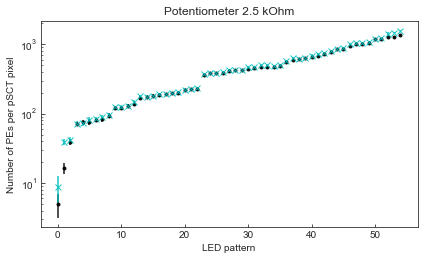

In [42]:
patterns, means, patterns2, means2=plot_NPE_vs_LEDs_long_comp(dfs_long, dfs_long_25, pot_val = 2.5, 
                          outfile="flasher_levels_2p5_Feb19_25_long_log_comp.pdf", gain=3.93e5, 
                            dist_measure = 0.91, dist_cam = 1.86, 
                            pix_measure = 18, pixel_cam=36, 
                         subtract_baseline=True, all_data_duration_s=2e-7, 
                 show_label=False, ylim=None, xlim=None, 
                 bins=None, ylog=True, 
                    plot_stats=True)
patterns, means, patterns2, means2

In [537]:
triglist =  ["0001100000","0011000000","0101000000","0010100000","0100100000",
                 "1001000000","0110000000","1000100000","0001010000","1010000000",
                 "0000110000","1100000000","0010010000","0001100001","0010000001",
                 "0011100001","0000010100","0000110100","0000011000","0001110100",
                 "0000000101","0001111000","0000000011","1110010000","0000001001",
                 "0000101001","0001101001","0010110100","0101110100","0010001001",
                 "0100101001","0110101001","1011110100","1101110100","0000001101",
                 "0001101101",
                 "0100001101","1000001101","0000011101","0000001111","0011101111",
                 "1000001111","0110001111","0000011111","0001111111","0010011111",
                 "1000011111","0110111111","1100011111","1011111111","1111111111",
                    ]
triglist[14]

'0010000001'

In [540]:
float("{0:.3f}".format(0.2/5.7))

0.035

Pattern #0: 0001000000, NPE 5.00+/-1.86
Pattern #1: 0000100000, NPE 16.30+/-2.85
Pattern #2: 0001100000, NPE 39.35+/-4.28
Pattern #3: 0010000000, NPE 71.19+/-5.56
Pattern #4: 0011000000, NPE 75.22+/-6.27
Pattern #5: 0101000000, NPE 76.08+/-6.43
Pattern #6: 0100000000, NPE 81.23+/-6.28
Pattern #7: 0010100000, NPE 82.64+/-6.52
Pattern #8: 0100100000, NPE 93.97+/-6.86
Pattern #9: 1000000000, NPE 120.43+/-7.82
Pattern #10: 1001000000, NPE 122.56+/-7.40
Pattern #11: 0110000000, NPE 128.91+/-8.24
Pattern #12: 1000100000, NPE 135.95+/-8.52
Pattern #13: 0001010000, NPE 170.42+/-9.05
Pattern #14: 0000010000, NPE 171.46+/-9.38
Pattern #15: 1010000000, NPE 181.37+/-9.94
Pattern #16: 0000110000, NPE 186.37+/-9.67
Pattern #17: 1100000000, NPE 190.16+/-9.25
Pattern #18: 0000000100, NPE 195.87+/-9.81
Pattern #19: 0000000010, NPE 198.35+/-9.66
Pattern #20: 0000001000, NPE 217.16+/-9.74
Pattern #21: 0010010000, NPE 224.41+/-10.53
Pattern #22: 0000000001, NPE 229.94+/-12.66
Pattern #23: 0000010100, NPE 

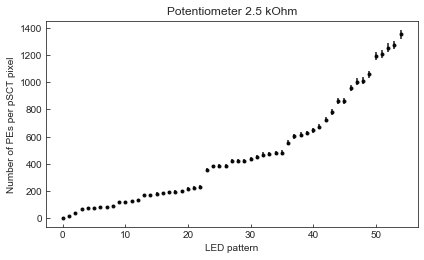

In [39]:
dflong1 = pd.read_csv("flasher_fwhm_pot2p5k_Feb19_binary.csv")
dflong2 = pd.read_csv("flasher_fwhm_pot2p5k_Feb19_long.csv")
dfs_long = [dflong1,dflong2]
plot_NPE_vs_LEDs_long(dfs_long, pot_val = 2.5, 
                          outfile="flasher_levels_2p5_Feb19_long.pdf", gain=3.93e5, 
                            dist_measure = 0.91, dist_cam = 1.86, 
                            pix_measure = 18, pixel_cam=36, datafile="NPE_vs_pattern_2p5_Feb19.csv", 
                         subtract_baseline=True, all_data_duration_s=2e-7, 
                 show_label=False, ylim=None, xlim=None, 
                 bins=None, ylog=False, 
                    plot_stats=True)

Pattern #0: 0001000000, NPE 5.00+/-1.86
Pattern #1: 0000100000, NPE 16.30+/-2.85
Pattern #2: 0001100000, NPE 39.35+/-4.28
Pattern #3: 0010000000, NPE 71.19+/-5.56
Pattern #4: 0011000000, NPE 75.22+/-6.27
Pattern #5: 0101000000, NPE 76.08+/-6.43
Pattern #6: 0100000000, NPE 81.23+/-6.28
Pattern #7: 0010100000, NPE 82.64+/-6.52
Pattern #8: 0100100000, NPE 93.97+/-6.86
Pattern #9: 1000000000, NPE 120.43+/-7.82
Pattern #10: 1001000000, NPE 122.56+/-7.40
Pattern #11: 0110000000, NPE 128.91+/-8.24
Pattern #12: 1000100000, NPE 135.95+/-8.52
Pattern #13: 0001010000, NPE 170.42+/-9.05
Pattern #14: 0000010000, NPE 171.46+/-9.38
Pattern #15: 1010000000, NPE 181.37+/-9.94
Pattern #16: 0000110000, NPE 186.37+/-9.67
Pattern #17: 1100000000, NPE 190.16+/-9.25
Pattern #18: 0000000100, NPE 195.87+/-9.81
Pattern #19: 0000000010, NPE 198.35+/-9.66
Pattern #20: 0000001000, NPE 217.16+/-9.74
Pattern #21: 0010010000, NPE 224.41+/-10.53
Pattern #22: 0000000001, NPE 229.94+/-12.66
Pattern #23: 0000010100, NPE 

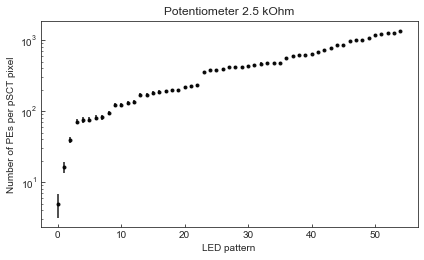

In [403]:
plot_NPE_vs_LEDs_long(dfs_long, pot_val = 2.5, 
                          outfile="flasher_levels_2p5_Feb19_long_log.pdf", gain=3.93e5, 
                            dist_measure = 0.91, dist_cam = 1.86, 
                            pix_measure = 18, pixel_cam=36, datafile="NPE_vs_pattern_2p5_Feb19.csv", 
                         subtract_baseline=True, all_data_duration_s=2e-7, 
                 show_label=False, ylim=None, xlim=None, 
                 bins=None, ylog=True, 
                    plot_stats=True)

Pattern #0: 0001000000, NPE 8.81+/-3.65
Pattern #1: 0000100000, NPE 39.02+/-4.25
Pattern #2: 0001100000, NPE 41.08+/-4.42
Pattern #3: 0010000000, NPE 72.02+/-5.97
Pattern #4: 0011000000, NPE 72.59+/-6.34
Pattern #5: 0101000000, NPE 81.73+/-6.56
Pattern #6: 0100000000, NPE 83.25+/-6.13
Pattern #7: 0010100000, NPE 88.05+/-6.48
Pattern #8: 0100100000, NPE 95.97+/-6.84
Pattern #9: 1000000000, NPE 123.06+/-8.01
Pattern #10: 1001000000, NPE 125.57+/-7.73
Pattern #11: 0110000000, NPE 130.44+/-8.40
Pattern #12: 1000100000, NPE 148.39+/-8.32
Pattern #13: 0000010000, NPE 173.98+/-9.23
Pattern #14: 0001010000, NPE 179.26+/-8.70
Pattern #15: 1010000000, NPE 179.76+/-9.15
Pattern #16: 1100000000, NPE 189.74+/-9.98
Pattern #17: 0000110000, NPE 191.13+/-9.53
Pattern #18: 0000000100, NPE 198.63+/-9.91
Pattern #19: 0000000010, NPE 203.08+/-9.80
Pattern #20: 0000001000, NPE 221.04+/-10.27
Pattern #21: 0010010000, NPE 224.55+/-10.57
Pattern #22: 0000000001, NPE 233.72+/-10.01
Pattern #23: 0001100001, NPE

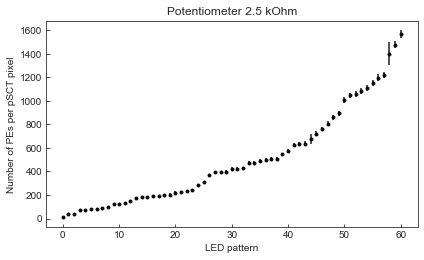

In [41]:
dflong1_25 = pd.read_csv("flasher_fwhm_pot2p5k_Feb25_binary.csv")
dflong2_25 = pd.read_csv("flasher_fwhm_pot2p5k_Feb25_long.csv")
dfs_long_25 = [dflong1_25,dflong2_25]
plot_NPE_vs_LEDs_long(dfs_long_25, pot_val = 2.5, 
                          outfile="flasher_levels_2p5_Feb25_long.pdf", gain=3.93e5, 
                            dist_measure = 0.91, dist_cam = 1.86, 
                            pix_measure = 18, pixel_cam=36, datafile="NPE_vs_pattern_2p5_Feb25.csv", 
                         subtract_baseline=True, all_data_duration_s=2e-7, 
                 show_label=False, ylim=None, xlim=None, 
                 bins=None, ylog=False, 
                    plot_stats=True)

Pattern #0: 0001000000, NPE 8.81+/-3.65
Pattern #1: 0000100000, NPE 39.02+/-4.25
Pattern #2: 0001100000, NPE 41.08+/-4.42
Pattern #3: 0010000000, NPE 72.02+/-5.97
Pattern #4: 0011000000, NPE 72.59+/-6.34
Pattern #5: 0101000000, NPE 81.73+/-6.56
Pattern #6: 0100000000, NPE 83.25+/-6.13
Pattern #7: 0010100000, NPE 88.05+/-6.48
Pattern #8: 0100100000, NPE 95.97+/-6.84
Pattern #9: 1000000000, NPE 123.06+/-8.01
Pattern #10: 1001000000, NPE 125.57+/-7.73
Pattern #11: 0110000000, NPE 130.44+/-8.40
Pattern #12: 1000100000, NPE 148.39+/-8.32
Pattern #13: 0000010000, NPE 173.98+/-9.23
Pattern #14: 0001010000, NPE 179.26+/-8.70
Pattern #15: 1010000000, NPE 179.76+/-9.15
Pattern #16: 1100000000, NPE 189.74+/-9.98
Pattern #17: 0000110000, NPE 191.13+/-9.53
Pattern #18: 0000000100, NPE 198.63+/-9.91
Pattern #19: 0000000010, NPE 203.08+/-9.80
Pattern #20: 0000001000, NPE 221.04+/-10.27
Pattern #21: 0010010000, NPE 224.55+/-10.57
Pattern #22: 0000000001, NPE 233.72+/-10.01
Pattern #23: 0001100001, NPE

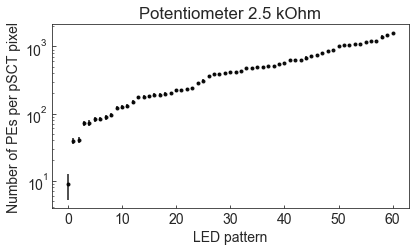

In [556]:
plot_NPE_vs_LEDs_long(dfs_long_25, pot_val = 2.5, 
                          outfile="flasher_levels_2p5_Feb25_long_log.pdf", gain=3.93e5, 
                            dist_measure = 0.91, dist_cam = 1.86, 
                            pix_measure = 18, pixel_cam=36, datafile="NPE_vs_pattern_2p5_Feb25.csv", 
                         subtract_baseline=True, all_data_duration_s=2e-7, 
                 show_label=False, ylim=None, xlim=None, 
                 bins=None, ylog=True, 
                    plot_stats=True)

Pattern #0: 0001000000, NPE 19.78+/-2.30
Pattern #1: 0000100000, NPE 38.57+/-3.32
Pattern #2: 0001100000, NPE 48.52+/-3.62
Pattern #3: 0010000000, NPE 94.99+/-5.29
Pattern #4: 0100000000, NPE 106.48+/-5.57
Pattern #5: 0011000000, NPE 109.43+/-5.32
Pattern #6: 0101000000, NPE 121.24+/-5.53
Pattern #7: 0010100000, NPE 134.02+/-6.26
Pattern #8: 0100100000, NPE 146.02+/-6.57
Pattern #9: 1000000000, NPE 192.89+/-6.94
Pattern #10: 1001000000, NPE 198.00+/-7.50
Pattern #11: 0110000000, NPE 221.18+/-7.38
Pattern #12: 1000100000, NPE 235.99+/-7.89
Pattern #13: 0000010000, NPE 269.36+/-8.56
Pattern #14: 0001010000, NPE 281.27+/-9.09
Pattern #15: 0000000100, NPE 295.16+/-8.92
Pattern #16: 1010000000, NPE 305.51+/-9.09
Pattern #17: 0000000010, NPE 310.63+/-8.85
Pattern #18: 0000110000, NPE 311.87+/-9.65
Pattern #19: 1100000000, NPE 317.42+/-9.36
Pattern #20: 0000001000, NPE 339.07+/-9.69
Pattern #21: 0000000001, NPE 348.31+/-9.14
Pattern #22: 0010010000, NPE 375.25+/-10.19
Pattern #23: 0001100001,

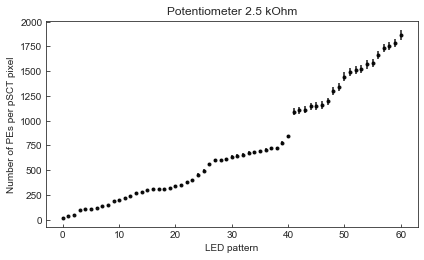

In [13]:
dflong28 = pd.read_csv("flasher_fwhm_pot2p5k_Feb28_long.csv")
plot_NPE_vs_LEDs_long([dflong28], pot_val = 2.5, 
                          outfile="flasher_levels_2p5_Feb28_long.pdf", gain=3.93e5, 
                            dist_measure = 0.91, dist_cam = 1.86, 
                            pix_measure = 36, pixel_cam=36, datafile="NPE_vs_pattern_2p5_Feb28.csv", 
                         subtract_baseline=True, all_data_duration_s=2e-7, 
                 show_label=False, ylim=None, xlim=None, 
                 bins=None, ylog=False, 
                    plot_stats=True)

Pattern #0: 0001000000, NPE 19.78+/-2.30
Pattern #1: 0000100000, NPE 38.57+/-3.32
Pattern #2: 0001100000, NPE 48.52+/-3.62
Pattern #3: 0010000000, NPE 94.99+/-5.29
Pattern #4: 0100000000, NPE 106.48+/-5.57
Pattern #5: 0011000000, NPE 109.43+/-5.32
Pattern #6: 0101000000, NPE 121.24+/-5.53
Pattern #7: 0010100000, NPE 134.02+/-6.26
Pattern #8: 0100100000, NPE 146.02+/-6.57
Pattern #9: 1000000000, NPE 192.89+/-6.94
Pattern #10: 1001000000, NPE 198.00+/-7.50
Pattern #11: 0110000000, NPE 221.18+/-7.38
Pattern #12: 1000100000, NPE 235.99+/-7.89
Pattern #13: 0000010000, NPE 269.36+/-8.56
Pattern #14: 0001010000, NPE 281.27+/-9.09
Pattern #15: 0000000100, NPE 295.16+/-8.92
Pattern #16: 1010000000, NPE 305.51+/-9.09
Pattern #17: 0000000010, NPE 310.63+/-8.85
Pattern #18: 0000110000, NPE 311.87+/-9.65
Pattern #19: 1100000000, NPE 317.42+/-9.36
Pattern #20: 0000001000, NPE 339.07+/-9.69
Pattern #21: 0000000001, NPE 348.31+/-9.14
Pattern #22: 0010010000, NPE 375.25+/-10.19
Pattern #23: 0001100001,

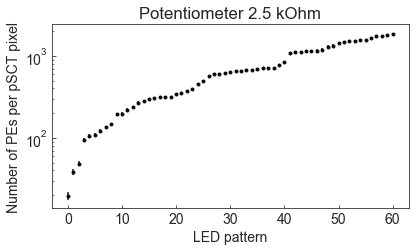

In [588]:
plot_NPE_vs_LEDs_long([dflong28], pot_val = 2.5, 
                          outfile="flasher_levels_2p5_Feb28_long_log.pdf", gain=3.93e5, 
                            dist_measure = 0.91, dist_cam = 1.86, 
                            pix_measure = 36, pixel_cam=36, datafile="NPE_vs_pattern_2p5_Feb28.csv", 
                         subtract_baseline=True, all_data_duration_s=2e-7, 
                 show_label=False, ylim=None, xlim=None, 
                 bins=None, ylog=True, 
                    plot_stats=True)

Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...


(array(['1000000000', '100000000', '10000000', '1000000', '100000',
        '10000', '1000', '100', '10', '1', '1100000', '11000000',
        '10100000', '101000000', '100100000', '110000000', '1001000000',
        '1000100000', '1010000000', '1100000000', '110000', '1010000',
        '10010000', '1110010000', '10100', '110100', '1110100',
        '101110100', '11000', '1111000', '10110100', '1011110100',
        '1101110100', '101', '11', '1001', '101001', '1101001',
        '100101001', '110101001', '1101', '1101101', '1000001101',
        '100001101', '11101', '1111', '11111', '1000001111', '11101111',
        '110001111', '1000011111', '1100011111', '1011111111', '110111111',
        '1111111111'], dtype='<U10'),
 array([ 120.42758431,   81.22590168,   71.18886385,    5.00251147,
          16.3029423 ,  171.46083401,  217.15991997,  195.87020328,
         198.34839657,  229.93585234,   39.35340855,   75.21919687,
          82.643036  ,   76.08267853,   93.96602861,  128.90701933,
 

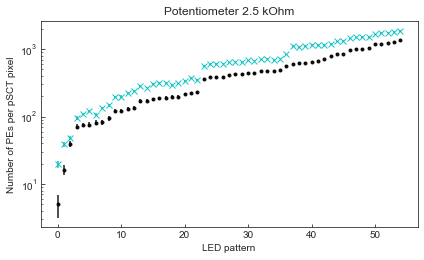

In [43]:
patterns, means, patterns2, means2=plot_NPE_vs_LEDs_long_comp(dfs_long, [dflong28], pot_val = 2.5, 
                                                              pix_measure2 = 36, 
                          outfile="flasher_levels_2p5_Feb19_28_long_log_comp.pdf", gain=3.93e5, 
                            dist_measure = 0.91, dist_cam = 1.86, 
                            pix_measure = 18, pixel_cam=36, 
                         subtract_baseline=True, all_data_duration_s=2e-7, 
                 show_label=False, ylim=None, xlim=None, 
                 bins=None, ylog=True, 
                    plot_stats=True)
patterns, means, patterns2, means2

Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...


(array(['1000000000', '100000000', '10000000', '1000000', '100000',
        '10000', '1000', '100', '10', '1', '1100000', '11000000',
        '101000000', '10100000', '100100000', '1001000000', '110000000',
        '1000100000', '1010000', '1010000000', '110000', '1100000000',
        '10010000', '1100001', '10000001', '11100001', '10100', '110100',
        '11000', '1110100', '101', '1111000', '11', '1110010000', '1001',
        '101001', '1101001', '10110100', '101110100', '10001001',
        '100101001', '110101001', '1011110100', '1101110100', '1101',
        '1101101', '100001101', '1000001101', '11101', '1111', '11101111',
        '1000001111', '110001111', '11111', '1111111', '10011111',
        '1000011111', '110111111', '1100011111', '1011111111',
        '1111111111'], dtype='<U10'),
 array([ 123.05544067,   83.24601993,   72.01881088,    8.81362682,
          39.02033752,  173.98366486,  221.03582922,  198.6313855 ,
         203.0835261 ,  233.71719205,   41.08043635,   72.5

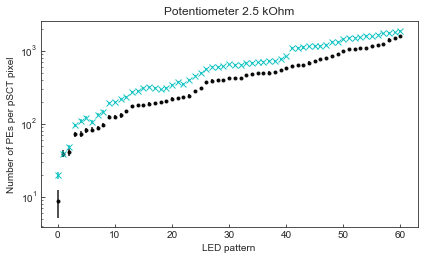

In [48]:
patterns, means, patterns2, means2=plot_NPE_vs_LEDs_long_comp(dfs_long_25, [dflong28], pot_val = 2.5, 
                                                              pix_measure2 = 36, 
                          outfile="flasher_levels_2p5_Feb25_28_long_log_comp.pdf", gain=3.93e5, 
                            dist_measure = 0.91, dist_cam = 1.86, 
                            pix_measure = 18, pixel_cam=36, 
                         subtract_baseline=True, all_data_duration_s=2e-7, 
                 show_label=False, ylim=None, xlim=None, 
                 bins=None, ylog=True, 
                    plot_stats=True)
patterns, means, patterns2, means2

Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...


(array(['1000000000', '100000000', '10000000', '1000000', '100000',
        '10000', '1000', '100', '10', '1', '1100000', '11000000',
        '10100000', '101000000', '100100000', '110000000', '1001000000',
        '1000100000', '1010000000', '1100000000', '110000', '1010000',
        '10010000', '1110010000', '10100', '110100', '1110100',
        '101110100', '11000', '1111000', '10110100', '1011110100',
        '1101110100', '101', '11', '1001', '101001', '1101001',
        '100101001', '110101001', '1101', '1101101', '1000001101',
        '100001101', '11101', '1111', '11111', '1000001111', '11101111',
        '110001111', '1000011111', '1100011111', '1011111111', '110111111',
        '1111111111'], dtype='<U10'),
 array([ 120.42758431,   81.22590168,   71.18886385,    5.00251147,
          16.3029423 ,  171.46083401,  217.15991997,  195.87020328,
         198.34839657,  229.93585234,   39.35340855,   75.21919687,
          82.643036  ,   76.08267853,   93.96602861,  128.90701933,
 

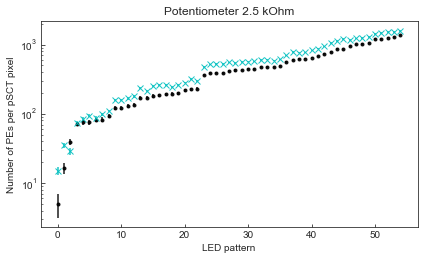

In [49]:
patterns, means, patterns2, means2=plot_NPE_vs_LEDs_long_comp(dfs_long, [dflong4], pot_val = 2.5, 
                                                              pix_measure2 = 36, 
                          outfile="flasher_levels_2p5_Feb19_Mar4_long_log_comp.pdf", gain=3.93e5, 
                            dist_measure = 0.91, dist_cam = 1.86, 
                            pix_measure = 18, pixel_cam=36, 
                         subtract_baseline=True, all_data_duration_s=2e-7, 
                 show_label=False, ylim=None, xlim=None, 
                 bins=None, ylog=True, 
                    plot_stats=True)
patterns, means, patterns2, means2

Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...


(array(['1000000000', '100000000', '10000000', '1000000', '100000',
        '10000', '1000', '100', '10', '1', '1100000', '11000000',
        '101000000', '10100000', '100100000', '1001000000', '110000000',
        '1000100000', '1010000', '1010000000', '110000', '1100000000',
        '10010000', '1100001', '10000001', '11100001', '10100', '110100',
        '11000', '1110100', '101', '1111000', '11', '1110010000', '1001',
        '101001', '1101001', '10110100', '101110100', '10001001',
        '100101001', '110101001', '1011110100', '1101110100', '1101',
        '1101101', '100001101', '1000001101', '11101', '1111', '11101111',
        '1000001111', '110001111', '11111', '1111111', '10011111',
        '1000011111', '110111111', '1100011111', '1011111111',
        '1111111111'], dtype='<U10'),
 array([ 123.05544067,   83.24601993,   72.01881088,    8.81362682,
          39.02033752,  173.98366486,  221.03582922,  198.6313855 ,
         203.0835261 ,  233.71719205,   41.08043635,   72.5

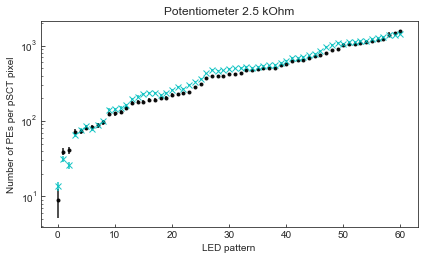

In [54]:
patterns, means, patterns2, means2=plot_NPE_vs_LEDs_long_comp(dfs_long_25, [dflong4], pot_val = 2.5, 
                                                              pix_measure2 = 40, 
                          outfile="flasher_levels_2p5_Feb25_Mar4_long_log_comp.pdf", gain=3.93e5, 
                            dist_measure = 0.91, dist_cam = 1.86, 
                            pix_measure = 18, pixel_cam=36, 
                         subtract_baseline=True, all_data_duration_s=2e-7, 
                 show_label=False, ylim=None, xlim=None, 
                 bins=None, ylog=True, 
                    plot_stats=True)
patterns, means, patterns2, means2

In [549]:
df_NPE_feb19 = pd.read_csv("NPE_vs_pattern_2p5_Feb19.csv")

df_NPE_feb19.head()


,pattern_rank,pattern,NPE,dNPE
0,0,0001000000,5.00,1.86
1,1,0000100000,16.30,2.85
2,2,0001100000,39.35340855429598,4.2769687129639005
3,3,0010000000,71.18886385082227,5.560051806679295
4,4,0011000000,75.21919687359205,6.269421184470796


In [40]:
dflong1_25 = pd.read_csv("flasher_fwhm_pot2p5k_Feb25_binary.csv")
dflong2_25 = pd.read_csv("flasher_fwhm_pot2p5k_Feb25_long.csv")
dfs_long_25 = [dflong1_25,dflong2_25]


dflong28 = pd.read_csv("flasher_fwhm_pot2p5k_Feb28_long.csv")

dflong4 = pd.read_csv("flasher_fwhm_pot2p5k_Mar4_long.csv")



Pattern #0: 0001000000, NPE 15.10+/-2.06
Pattern #1: 0001100000, NPE 28.78+/-3.19
Pattern #2: 0000100000, NPE 34.93+/-2.83
Pattern #3: 0010000000, NPE 73.11+/-4.88
Pattern #4: 0011000000, NPE 85.06+/-4.93
Pattern #5: 0100000000, NPE 86.82+/-4.92
Pattern #6: 0101000000, NPE 94.19+/-5.16
Pattern #7: 0010100000, NPE 97.73+/-5.11
Pattern #8: 0100100000, NPE 109.69+/-5.21
Pattern #9: 1000000000, NPE 156.97+/-6.08
Pattern #10: 1001000000, NPE 158.38+/-6.57
Pattern #11: 0110000000, NPE 166.44+/-6.80
Pattern #12: 1000100000, NPE 178.56+/-6.84
Pattern #13: 0000010000, NPE 215.65+/-7.15
Pattern #14: 0001010000, NPE 234.06+/-8.16
Pattern #15: 0000000100, NPE 246.53+/-8.69
Pattern #16: 1010000000, NPE 251.78+/-8.59
Pattern #17: 0000110000, NPE 259.36+/-8.24
Pattern #18: 0000000010, NPE 260.77+/-8.30
Pattern #19: 1100000000, NPE 261.81+/-8.47
Pattern #20: 0000001000, NPE 282.26+/-8.47
Pattern #21: 0000000001, NPE 294.90+/-9.03
Pattern #22: 0010010000, NPE 316.35+/-8.65
Pattern #23: 0001100001, NPE 

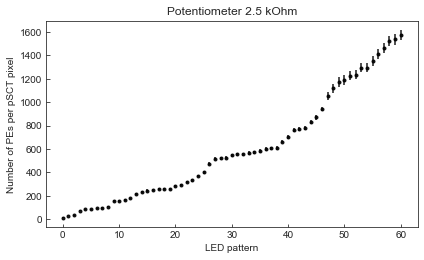

In [12]:
dflong4 = pd.read_csv("flasher_fwhm_pot2p5k_Mar4_long.csv")
plot_NPE_vs_LEDs_long([dflong4], pot_val = 2.5, 
                          outfile="flasher_levels_2p5_Mar4_long.pdf", gain=3.93e5, 
                            dist_measure = 0.91, dist_cam = 1.86, 
                            pix_measure = 36, pixel_cam=36, datafile="NPE_vs_pattern_2p5_Mar4.csv", 
                         subtract_baseline=True, all_data_duration_s=2e-7, 
                 show_label=False, ylim=None, xlim=None, 
                 bins=None, ylog=False, 
                    plot_stats=True)

Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...


(array(['1000000', '100000', '1000000000', '100000000', '10000000',
        '10000', '1000', '100', '10', '1', '1100000', '11000000',
        '101000000', '10100000', '100100000', '1001000000', '110000000',
        '1000100000', '1010000', '1010000000', '110000', '1100000000',
        '10010000', '1100001', '10000001', '11100001', '10100', '110100',
        '11000', '1110100', '101', '1111000', '11', '1110010000', '1001',
        '101001', '1101001', '10110100', '101110100', '10001001',
        '100101001', '110101001', '1011110100', '1101110100', '1101',
        '1101101', '100001101', '1000001101', '11101', '1111', '11101111',
        '1000001111', '110001111', '11111', '1111111', '10011111',
        '1000011111', '110111111', '1100011111', '1011111111',
        '1111111111'], dtype='<U10'),
 array([  19.77942621,   38.56981717,  192.8903832 ,  106.47950404,
          94.98672466,  269.35572867,  339.0658914 ,  295.16294492,
         310.63200106,  348.3130035 ,   48.52304166,  109.4

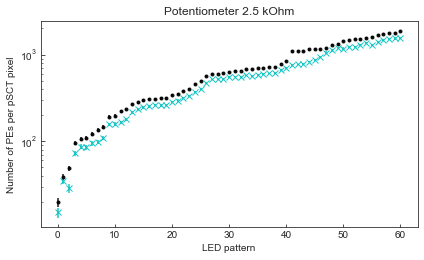

In [44]:
patterns, means, patterns2, means2=plot_NPE_vs_LEDs_long_comp( [dflong28], [dflong4], pot_val = 2.5, 
                                                              pix_measure2 = 36, 
                          outfile="flasher_levels_2p5_Feb28_Mar4_long_log_comp.pdf", gain=3.93e5, 
                            dist_measure = 0.91, dist_cam = 1.86, 
                            pix_measure = 36, pixel_cam=36, 
                         subtract_baseline=True, all_data_duration_s=2e-7, 
                 show_label=False, ylim=None, xlim=None, 
                 bins=None, ylog=True, 
                    plot_stats=True)
patterns, means, patterns2, means2

Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...
Found...


(array(['1000000', '100000', '1000000000', '100000000', '10000000',
        '10000', '1000', '100', '10', '1', '1100000', '11000000',
        '101000000', '10100000', '100100000', '1001000000', '110000000',
        '1000100000', '1010000', '1010000000', '110000', '1100000000',
        '10010000', '1100001', '10000001', '11100001', '10100', '110100',
        '11000', '1110100', '101', '1111000', '11', '1110010000', '1001',
        '101001', '1101001', '10110100', '101110100', '10001001',
        '100101001', '110101001', '1011110100', '1101110100', '1101',
        '1101101', '100001101', '1000001101', '11101', '1111', '11101111',
        '1000001111', '110001111', '11111', '1111111', '10011111',
        '1000011111', '110111111', '1100011111', '1011111111',
        '1111111111'], dtype='<U10'),
 array([  19.77942621,   38.56981717,  192.8903832 ,  106.47950404,
          94.98672466,  269.35572867,  339.0658914 ,  295.16294492,
         310.63200106,  348.3130035 ,   48.52304166,  109.4

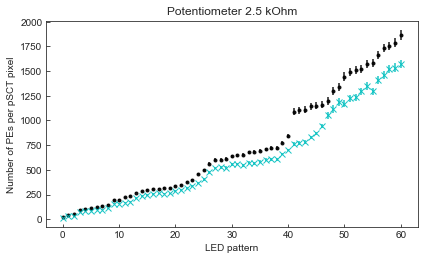

In [45]:
patterns, means, patterns2, means2=plot_NPE_vs_LEDs_long_comp( [dflong28], [dflong4], pot_val = 2.5, 
                                                              pix_measure2 = 36, 
                          outfile="flasher_levels_2p5_Feb28_Mar4_long_comp.pdf", gain=3.93e5, 
                            dist_measure = 0.91, dist_cam = 1.86, 
                            pix_measure = 36, pixel_cam=36, 
                         subtract_baseline=True, all_data_duration_s=2e-7, 
                 show_label=False, ylim=None, xlim=None, 
                 bins=None, ylog=False, 
                    plot_stats=True)
patterns, means, patterns2, means2

In [14]:
df_flasher4new = pd.read_csv("flasher_fwhm_pot4p1k_diffuser_new_setup.csv")

df_flasher_stat4new = pd.DataFrame(df_flasher4new.groupby('LEDs').describe())

df_flasher_stat4new['half_max_V']=-df_flasher_stat4new['half_max_V']
#df_flasher_stat3['max_V']=2*df_flasher_stat3['half_max_V']



df_sortV4new = df_flasher_stat4new['half_max_V'].sort_values(by=['mean'])
#new_ind35 = df_sortV35.index


plot_LED_hist(df_flasher4new, title="pot 4.1k", outfile="flasher_level_4p1k_Feb11.png")

NameError: name 'plot_LED_hist' is not defined

/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


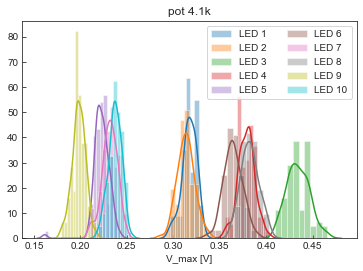

In [38]:
df_flasher4new = pd.read_csv("flasher_fwhm_pot4p1k_diffuser_new_setup_DC_power_source.csv")
plot_LED_hist(df_flasher4new, title="pot 4.1k", outfile="flasher_level_4p1k_DC_power_source_Feb11.png")



In [ ]:
np.tan()

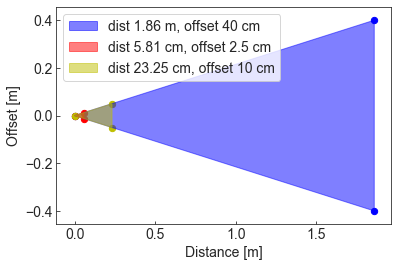

In [58]:
X = np.array([[0,0], [1.86,0.4], [1.86, -0.4]])
X2 = np.array([[0,0], [0.05812,0.0125], [0.05812,-0.0125]])
X3 = np.array([[0,0], [0.2325,0.05], [0.2325,-0.05]])



plt.figure()
plt.scatter(X[:, 0], X[:, 1], s = 40, color = 'b')

t1 = plt.Polygon(X, color='b', alpha=0.5, label="dist 1.86 m, offset 40 cm")
plt.gca().add_patch(t1)

plt.scatter(X2[:, 0], X2[:, 1], s = 40, color = 'r')

t2 = plt.Polygon(X2, color='r', alpha=0.5, label="dist 5.81 cm, offset 2.5 cm")
plt.gca().add_patch(t2)

plt.scatter(X3[:, 0], X3[:, 1], s = 40, color = 'y')

t3 = plt.Polygon(X3, color='y', alpha=0.5, label="dist 23.25 cm, offset 10 cm")
plt.gca().add_patch(t3)


plt.xlabel("Distance [m]")
plt.ylabel("Offset [m]")

plt.legend()

plt.show()


In [552]:
np.tan(np.deg2rad(10))*8*2

2.8212316913354396

In [87]:
df = pd.read_csv(f_)#.apply(pd.to_numeric)
df.apply(pd.to_numeric, errors='coerce')
df.head()
#df['T'].values


,T,V
0,7.999999999780372e-10,0.0
1,1.7999999999780065e-09,0.0
2,2.7999999999779757e-09,0.0
3,3.799999999977945e-09,0.0
4,4.799999999977914e-09,-0.0006


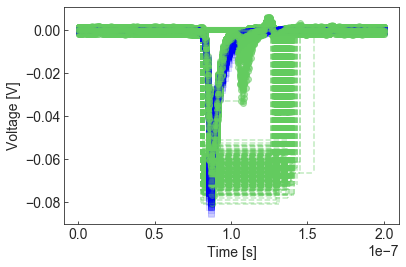

In [90]:
import glob
initial_params=[0.1, 8.e-8, 1.e-9, 10.e-9, 0.]
verbose=False
#for ii, i in enumerate([4,5,3,2,1,6,7,8,9,10]):
pico_setting="8p6"
plot_name = "pico_test{}.png".format(pico_setting)

#fig=plt.figure()
fig, ax = plt.subplots()
cm = plt.get_cmap('viridis')
NUM_COLORS = 50

for ii, i in enumerate([1]):
    k = 0
    for f_ in glob.iglob('flasher_data/picotest/*{}*.csv'.format(pico_setting)):
        #print(f_)
        df = pd.read_csv(f_).apply(pd.to_numeric, errors='coerce').dropna()
        ts=df['T'].values
        vs=df.V.values
        #print(ts.shape, vs.shape)
        # Fit the trace w exponential 
        #params: amp, tpeak, trise, tdecay, const
        parLCL3, covLCL3 = curve_fit(flare_func_w_const, ts,
                                vs, p0=initial_params, 
                                ) #, 
                                #method='trf', ftol=1e-10, loss='soft_l1') #approx abs

        par_names8=['amplitude', 'tpeak', 'trise', 'tdecay', 'const']
        
        #params: amp, tpeak, trise, tdecay, const

        wid, half_max, lind, rind = FWHM(ts, vs, verbose=verbose)

        ax.hlines(half_max, ts[lind], ts[rind], colors=c_, 
                          #linestyles=":", 
                          linestyles="--",
                          alpha=0.4)

        ax.plot(ts, flare_func_w_const(ts, *parLCL3), color='b', marker='s', 
                          #linestyles=":", 
                          ls="",
                         alpha=0.1) 


        start_window = parLCL3[1] - 1.5*np.e*parLCL3[2]
        stop_window = parLCL3[1] + 3*np.e*parLCL3[3]

        ax.vlines(start_window,0, 2*half_max, colors=c_, 
                          #linestyles=":", 
                          linestyles="--",
                          alpha=0.4)
        ax.vlines(stop_window,0, 2*half_max, colors=c_, 
                          #linestyles=":", 
                          linestyles="--",
                          alpha=0.4)

        ax.hlines(half_max*2, start_window, stop_window, colors=c_, 
                          #linestyles=":", 
                          linestyles="--",
                          alpha=0.4)




        #print("Start window {} s, stop window {} s, window width {} s".format(start_window, stop_window, stop_window-start_window))
        ax.plot(ts, vs, color=c_, marker='o', alpha=0.5)#, label=k)

        #print("integral all = {}".format(np.trapz(vs, ts)))

        int_slice = np.where((ts>=float(start_window)) & (ts <=float(stop_window)))
        #print("integral window = {}".format(np.trapz(vs[int_slice], ts[int_slice])))

        
    plt.xlabel('Time [s]')
    plt.ylabel('Voltage [V]')
    #plt.legend(ncol=8)
    plot_name_ = plot_name.split('.')[0]+'_pico_setting{}'.format(pico_setting)+'.'+plot_name.split('.')[1]
    plt.savefig(plot_name_)

    





/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval
Exception ignored in: <function ESP.__del__ at 0x1a2cb8ab70>
Traceback (most recent call last):
  File "/anaconda3/lib/python3.7/site-packages/newportESP.py", line 102, in __del__
    self.ser.close()
AttributeError: 'ESP' object has no attribute 'ser'


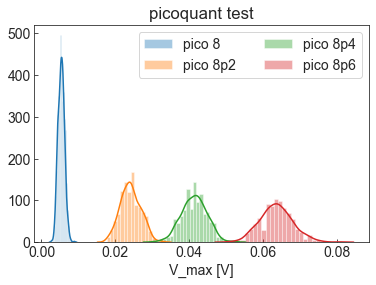

In [127]:
def plot_pico_hist(df_flasher35, title="pot 3.5k", outfile="flasher_level_3p5k_Feb8.png", 
                 show_label=True, ylim=None, 
                 bins=None):
    for ii, i in enumerate(df_flasher35.pot_value_ohm.unique()):
    #for ii, i in enumerate([4,5,3,2,1,6,7,8,9,10]):
        if show_label:
            sns.distplot(-df_flasher35[df_flasher35.pot_value_ohm==i].half_max_V*2, bins=bins, rug=False, axlabel="V_max [V]", label="pico {}".format(i))
        else:
            sns.distplot(-df_flasher35[df_flasher35.pot_value_ohm==i].half_max_V*2, bins=bins, rug=False, axlabel="V_max [V]")#, label="LED {}".format(ii+1))
    if show_label:
        plt.legend(ncol=2)
    if ylim is not None:
        plt.ylim(ylim)
    plt.title(title)
    plt.savefig(outfile)


    
df_pico1 = pd.read_csv("flasher_fwhm_picotest_v1.csv")

plot_pico_hist(df_pico1, title="picoquant test", outfile="picotest1.png")


/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


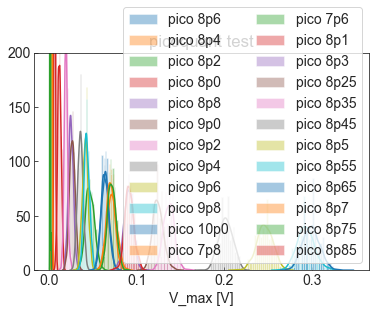

In [278]:
df_pico = pd.read_csv("flasher_fwhm_picotest.csv")

plot_pico_hist(df_pico, title="picoquant test", ylim=[0,200], outfile="picotest_peak_hist_feb14.png")



/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


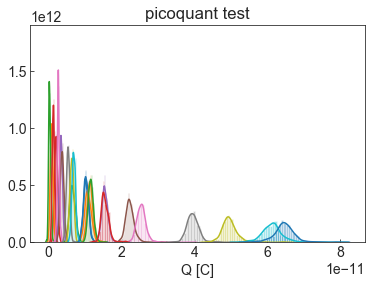

In [280]:
def plot_pico_hist_integral(df_flasher35, title="pot 3.5k", outfile="flasher_level_3p5k_Feb8.png", 
                 show_label=False, ylim=None, 
                 bins=None):
    Rterm=50 #50 ohm terminator
    for ii, i in enumerate(df_flasher35.pot_value_ohm.unique()):
    #for ii, i in enumerate([4,5,3,2,1,6,7,8,9,10]):
        if show_label:
            sns.distplot(-df_flasher35[df_flasher35.pot_value_ohm==i].integrated_charge_window/Rterm, bins=bins, rug=False, 
                         axlabel="Q [C]", label="pico {}".format(i))
        else:
            sns.distplot(-df_flasher35[df_flasher35.pot_value_ohm==i].integrated_charge_window/Rterm, bins=bins, rug=False, 
                         axlabel="Q [C]")#, label="LED {}".format(ii+1))
    if show_label:
        plt.legend(ncol=2)
    if ylim is not None:
        plt.ylim(ylim)
    plt.title(title)
    plt.savefig(outfile)

plot_pico_hist_integral(df_pico, title="picoquant test",  outfile="picotest_peak_hist_integral_Feb14.png")



/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


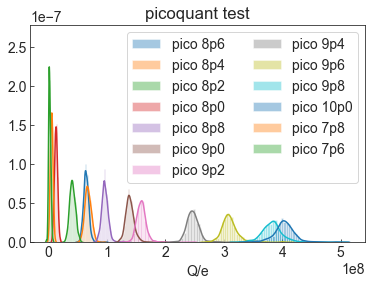

In [139]:
def plot_pico_hist_integral_e(df_flasher35, title="pot 3.5k", outfile="flasher_level_3p5k_Feb8.png", 
                 show_label=True, ylim=None, 
                 bins=None):
    Rterm=50 #50 ohm terminator
    e = 1.602e-19
    for ii, i in enumerate(df_flasher35.pot_value_ohm.unique()):
    #for ii, i in enumerate([4,5,3,2,1,6,7,8,9,10]):
        if show_label:
            sns.distplot(-df_flasher35[df_flasher35.pot_value_ohm==i].integrated_charge_window/Rterm/e, bins=bins, rug=False, 
                         axlabel="Q/e", label="pico {}".format(i))
        else:
            sns.distplot(-df_flasher35[df_flasher35.pot_value_ohm==i].integrated_charge_window/Rterm/e, bins=bins, rug=False, 
                         axlabel="Q/e")#, label="LED {}".format(ii+1))
    if show_label:
        plt.legend(ncol=2)
    if ylim is not None:
        plt.ylim(ylim)
    plt.title(title)
    plt.savefig(outfile)

plot_pico_hist_integral_e(df_pico, title="picoquant test",  outfile="picotest_peak_hist_integral_e.png")




Flare exponential fit param 0 (slope) = 2.875e-24 +/- 2.164e-25
Flare exponential fit param 1 (inter) = -2.398e-23 +/- 1.908e-24
2.8750646379627986e-24 2.164125920337321e-25
Flare exponential fit param 0 (slope) = 2.895e-11 +/- 9.786e-13
Flare exponential fit param 1 (inter) = -2.374e-10 +/- 8.626e-12
2.8951473152583437e-11 9.78601345792743e-13
gain 619889.720013535


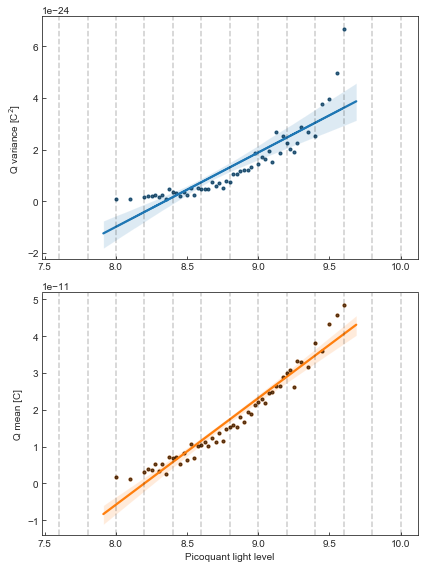

In [29]:
def lin_func(x, a, b):
    return a*x+b
def chisq(y_vals, y_expected, y_errs, num_params=1):
    #returns chi2, dof, red_chi2
    #  for reduced chisq test, under the assumption of Poisson counting
    #  we have lnL = const - (1/2.)*chi2
    if y_vals.shape[0] != y_expected.shape[0]:
        print("Inconsistent input sizes")
        return
    #z = (y_vals[i] - y_expected[i]) / y_errs[i]    
    z = (y_vals - y_expected) / y_errs
    chi2 = np.sum(z ** 2)
    chi2dof = chi2 / (y_vals.shape[0] - num_params)
    return chi2, (y_vals.shape[0] - num_params), chi2dof


def plot_pico_gain_integral(df_flasher35, title="pot 3.5k", outfile="flasher_level_3p5k_Feb8.png", 
                 show_label=True, ylim=None, fit_range=[-1e2,1e5], sub_baseline=False, 
                 bins=None):
    e = 1.602e-19

    Rterm=50 #50 ohm terminator
    N=len(df_flasher35.pot_value_ohm.unique())
    pico_vals = np.zeros(N, dtype=float)
    mus = np.zeros(N, dtype=float)
    sts = np.zeros(N, dtype=float)
    for ii, i in enumerate(df_flasher35.pot_value_ohm.unique()):
    #for ii, i in enumerate([4,5,3,2,1,6,7,8,9,10]):
        pico_vals[ii] = float('.'.join(i.split('p')))
        this_slice=df_flasher35[df_flasher35.pot_value_ohm==i]
        mus[ii]=-np.mean(this_slice.integrated_charge_window/Rterm)
        sts[ii]=np.std(this_slice.integrated_charge_window/Rterm)
        
    fig, axes = plt.subplots(2, figsize=(6,8))
    ax = axes[0]
    ax.plot(pico_vals, sts**2, marker='.', ls="", color='k', alpha=0.3)  
                     #label="pico {}".format(i))
        
        
    axes[1].plot(pico_vals, mus, marker='.', ls="", color='k', alpha=0.3)  
                     #label="pico {}".format(i))
        

    # make cut
    fit_ind = np.where((pico_vals<=fit_range[1]) & (pico_vals>=fit_range[0]))
    pico_vals=pico_vals[fit_ind]
    mus=mus[fit_ind]
    sts=sts[fit_ind]


    sns.regplot(pico_vals, sts**2, marker='.', ax=ax)  

    #ax.title(title)

    #if fit_range is None: 
        
    ax.set_ylabel(r"Q variance [C$^2$]")
    
    parLCL3, covLCL3 = curve_fit(lin_func, pico_vals,
                        sts**2, p0=[1.3911252e-25, -6.50953251e-29], 
                        ) #, 
                        #method='trf', ftol=1e-10, loss='soft_l1') #approx abs

    #min_of_mjd((start_mjd+end_mjd)/2., mjd0=57666.165), f_runwise/plot_f_unit, xerr=15, yerr=df_runwise/plot_f_unit,
    par_names8=['slope', 'inter']
    for i in range(len(par_names8)):
        print("Flare exponential fit param %d (%s) = %.4g +/- %.4g" % (i, par_names8[i], 
                                                                                            parLCL3[i], 
                                                                                            np.sqrt(abs(covLCL3[i,i]))))

    slope1 = parLCL3[0]

    dslope1 = np.sqrt(abs(covLCL3[0,0]))
    print(parLCL3[0], np.sqrt(abs(covLCL3[0,0])))


    
    ax = axes[1]
    ax.plot(pico_vals, mus, marker='.', ls="", color='k', alpha=0.3)  
                     #label="pico {}".format(i))
        

    


    sns.regplot(pico_vals, mus, marker='.', ax=ax) 

    axes[0].plot(pico_vals, lin_func(pico_vals, *parLCL3))

    #old_ind = np.where(pico_vals)
    #ax.plot(pico_vals, mus, marker='.', ls="",) 
    for x_ in np.arange(7.6,10.2,0.2):
        ax.axvline(x_, color='k', ls="--", alpha=0.2)
        axes[0].axvline(x_, color='k', ls="--", alpha=0.2)
        
    #for x_ in [8.225,]:
    #    ax.axvline(x_, color='r', ls="--", alpha=0.2)
    #    axes[0].axvline(x_, color='r', ls="--", alpha=0.2)


    ax.set_ylabel(r"Q mean [C]")
    ax.set_xlabel("Picoquant light level")

    
    parLCL31, covLCL31 = curve_fit(lin_func, pico_vals,
                        mus, p0=[1.3911252e-11, -6.50953251e-11], 
                        ) #, 
                        #method='trf', ftol=1e-10, loss='soft_l1') #approx abs

    #min_of_mjd((start_mjd+end_mjd)/2., mjd0=57666.165), f_runwise/plot_f_unit, xerr=15, yerr=df_runwise/plot_f_unit,
    par_names8=['slope', 'inter']
    for i in range(len(par_names8)):
        print("Flare exponential fit param %d (%s) = %.4g +/- %.4g" % (i, par_names8[i], 
                                                                                            parLCL31[i], 
                                                                                            np.sqrt(abs(covLCL31[i,i]))))

    slope2 = parLCL31[0]

    dslope2 = np.sqrt(abs(covLCL31[0,0]))
    print(parLCL31[0], np.sqrt(abs(covLCL31[0,0])))
    #ax.plot(pico_vals, lin_func(pico_vals, *parLCL31))




    print("gain {}".format(slope1/slope2/e))

    #plt.legend(ncol=2)
    if ylim is not None:
        plt.ylim(ylim)
    plt.tight_layout()
    plt.savefig(outfile)

    
df_pico = pd.read_csv("flasher_fwhm_picotest.csv")

plot_pico_gain_integral(df_pico, title="picoquant test",  outfile="picotest_peak_gain_integral_Feb14_only.png")




/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


Flare exponential fit param 0 (slope) = 2.705e-24 +/- 1.428e-25
Flare exponential fit param 1 (inter) = -2.275e-23 +/- 1.268e-24
2.7054650329263068e-24 1.4281130856282514e-25
Flare exponential fit param 0 (slope) = 3.044e-11 +/- 9.745e-13
Flare exponential fit param 1 (inter) = -2.517e-10 +/- 8.655e-12
3.0436635253122285e-11 9.744847690555625e-13
gain 554859.1773481186


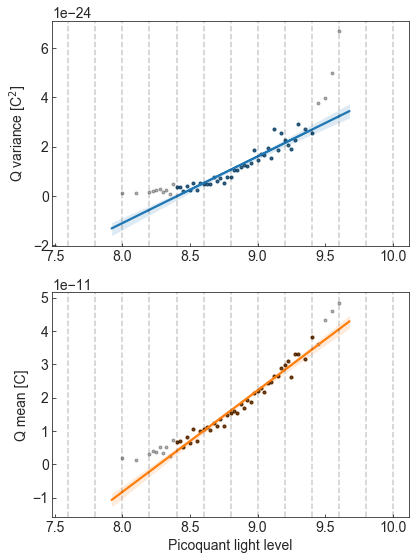

In [444]:

plot_pico_gain_integral(df_pico, title="picoquant test",
                        fit_range=[8.4,9.4], 
                        outfile="picotest_peak_gain_integral_Feb14_only_cut.png")





/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


Flare exponential fit param 0 (slope) = 7.42e-24 +/- 1.678e-24
Flare exponential fit param 1 (inter) = -5.858e-23 +/- 1.395e-23
7.41984401615625e-24 1.677645747764593e-24
Flare exponential fit param 0 (slope) = 4.749e-11 +/- 5.041e-12
Flare exponential fit param 1 (inter) = -3.694e-10 +/- 4.191e-11
4.7491490667481915e-11 5.0407277834766016e-12
gain 975251.1299938341


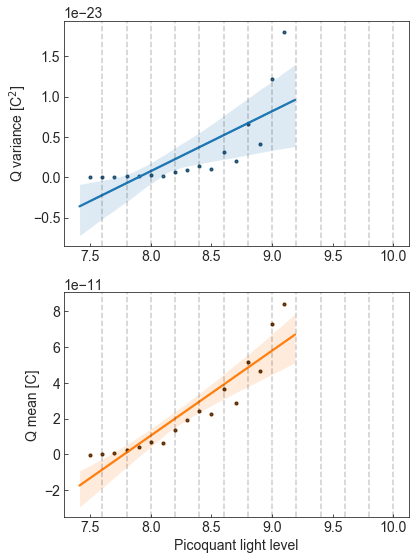

In [470]:
df_pico2 = pd.read_csv("flasher_fwhm_picotest2.csv")
plot_pico_gain_integral(df_pico2, title="picoquant test",
                        #fit_range=[8.4,9.4], 
                        outfile="picotest_peak_gain_integral_Feb14_pico_close_cut.png")






In [68]:
df_feb16_2p5.head()

,LEDs,pot_value_ohm,FWHM_s,half_max_V,fit_trise_s,fit_tdecay_s,fit_peak_V,fit_tpeak_s,fit_baseline_V,fit_redchisq,integrate_window_start,integrate_window_stop,integrated_charge_all,integrated_charge_window
0,1,2p5k_Feb16,9.000000e-09,-0.03564,3.800525e-09,5.950136e-09,0.087147,8.127604e-08,-0.000692,0.000011,6.577970e-08,1.297985e-07,-9.864000e-10,-8.528400e-10
1,1,2p5k_Feb16,8.000000e-09,-0.03708,3.849174e-09,5.611848e-09,0.087398,8.126988e-08,-0.000868,0.000007,6.557517e-08,1.270336e-07,-9.979200e-10,-8.521200e-10
2,1,2p5k_Feb16,8.000000e-09,-0.03852,3.426058e-09,5.883052e-09,0.092203,8.141271e-08,-0.000707,0.000011,6.744322e-08,1.293881e-07,-9.990000e-10,-8.668800e-10
3,1,2p5k_Feb16,8.000000e-09,-0.03708,3.581337e-09,6.458572e-09,0.088700,8.142124e-08,-0.000603,0.000013,6.681861e-08,1.340899e-07,-1.011600e-09,-8.982000e-10
4,1,2p5k_Feb16,9.000000e-09,-0.03996,3.797334e-09,5.815755e-09,0.095037,8.127199e-08,-0.000751,0.000009,6.578865e-08,1.286986e-07,-1.062000e-09,-9.270000e-10


Flare exponential fit param 0 (slope) = 1.685e-24 +/- 1.91e-25
Flare exponential fit param 1 (inter) = -1.398e-23 +/- 1.684e-24
1.684767510040627e-24 1.9102156278661871e-25
Flare exponential fit param 0 (slope) = 2.215e-11 +/- 6.607e-13
Flare exponential fit param 1 (inter) = -1.797e-10 +/- 5.824e-12
2.2147859245826495e-11 6.607234023083721e-13
gain 474838.26798433566


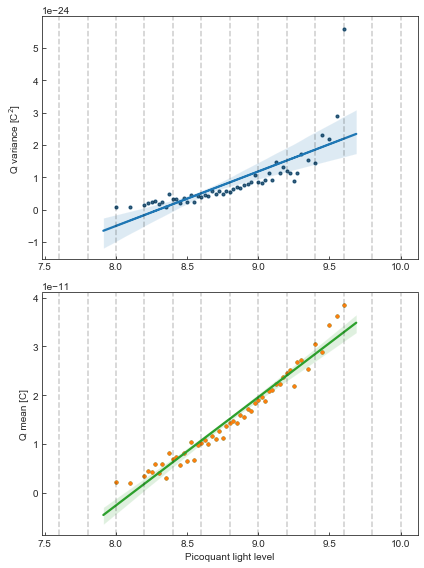

In [30]:
def plot_pico_gain_integral_all(df_flasher35, title="pot 3.5k", outfile="gain_test_all.png", 
                 show_label=True, ylim=None, fit_range=[-1e2,1e5], sub_baseline=True, allTs=2.e-7,
                                ylog=False, 
                 bins=None):
    e = 1.602e-19

    Rterm=50 #50 ohm terminator
    N=len(df_flasher35.pot_value_ohm.unique())
    pico_vals = np.zeros(N, dtype=float)
    mus = np.zeros(N, dtype=float)
    sts = np.zeros(N, dtype=float)
    for ii, i in enumerate(df_flasher35.pot_value_ohm.unique()):
    #for ii, i in enumerate([4,5,3,2,1,6,7,8,9,10]):
        pico_vals[ii] = float('.'.join(i.split('p')))
        this_slice=df_flasher35[df_flasher35.pot_value_ohm==i]
        mus[ii]=-np.mean(this_slice.integrated_charge_all/Rterm-this_slice.fit_baseline_V*allTs/Rterm)
        sts[ii]=np.std(this_slice.integrated_charge_all/Rterm-this_slice.fit_baseline_V*allTs/Rterm)
        
    fig, axes = plt.subplots(2, figsize=(6,8))
    ax = axes[0]


        
    ax.plot(pico_vals, sts**2, marker='.', ls="", color='k', alpha=0.3)  
                     #label="pico {}".format(i))
        
        
    axes[1].plot(pico_vals, mus, marker='.', ls="", color='k', alpha=0.3)  
                     #label="pico {}".format(i))
        

    # make cut
    fit_ind = np.where((pico_vals<=fit_range[1]) & (pico_vals>=fit_range[0]))
    pico_vals=pico_vals[fit_ind]

    mus=mus[fit_ind]
    sts=sts[fit_ind]


        
        
    sns.regplot(pico_vals, sts**2, marker='.', ax=ax)  

    #ax.title(title)

    #if fit_range is None: 
        
    ax.set_ylabel(r"Q variance [C$^2$]")
    
    parLCL3, covLCL3 = curve_fit(lin_func, pico_vals,
                        sts**2, p0=[1.3911252e-25, -6.50953251e-29], 
                        ) #, 
                        #method='trf', ftol=1e-10, loss='soft_l1') #approx abs

    #min_of_mjd((start_mjd+end_mjd)/2., mjd0=57666.165), f_runwise/plot_f_unit, xerr=15, yerr=df_runwise/plot_f_unit,
    par_names8=['slope', 'inter']
    for i in range(len(par_names8)):
        print("Flare exponential fit param %d (%s) = %.4g +/- %.4g" % (i, par_names8[i], 
                                                                                            parLCL3[i], 
                                                                                            np.sqrt(abs(covLCL3[i,i]))))

    slope1 = parLCL3[0]

    dslope1 = np.sqrt(abs(covLCL3[0,0]))
    print(parLCL3[0], np.sqrt(abs(covLCL3[0,0])))


    
    ax = axes[1]
    ax.plot(pico_vals, mus, marker='.', ls="",) 
                     #label="pico {}".format(i))
    sns.regplot(pico_vals, mus, marker='.', ax=ax) 

    axes[0].plot(pico_vals, lin_func(pico_vals, *parLCL3))

    #old_ind = np.where(pico_vals)
    #ax.plot(pico_vals, mus, marker='.', ls="",) 
    for x_ in np.arange(7.6,10.2,0.2):
        ax.axvline(x_, color='k', ls="--", alpha=0.2)
        axes[0].axvline(x_, color='k', ls="--", alpha=0.2)
        
    #for x_ in [8.225,]:
    #    ax.axvline(x_, color='r', ls="--", alpha=0.2)
    #    axes[0].axvline(x_, color='r', ls="--", alpha=0.2)


    ax.set_ylabel(r"Q mean [C]")
    ax.set_xlabel("Picoquant light level")
    if ylog:
        axes[0].set_yscale('log')


    
    parLCL31, covLCL31 = curve_fit(lin_func, pico_vals,
                        mus, p0=[1.3911252e-11, -6.50953251e-11], 
                        ) #, 
                        #method='trf', ftol=1e-10, loss='soft_l1') #approx abs

    #min_of_mjd((start_mjd+end_mjd)/2., mjd0=57666.165), f_runwise/plot_f_unit, xerr=15, yerr=df_runwise/plot_f_unit,
    par_names8=['slope', 'inter']
    for i in range(len(par_names8)):
        print("Flare exponential fit param %d (%s) = %.4g +/- %.4g" % (i, par_names8[i], 
                                                                                            parLCL31[i], 
                                                                                            np.sqrt(abs(covLCL31[i,i]))))

    slope2 = parLCL31[0]

    dslope2 = np.sqrt(abs(covLCL31[0,0]))
    print(parLCL31[0], np.sqrt(abs(covLCL31[0,0])))
    #ax.plot(pico_vals, lin_func(pico_vals, *parLCL31))




    print("gain {}".format(slope1/slope2/e))

    #plt.legend(ncol=2)
    if ylim is not None:
        plt.ylim(ylim)
    if ylog:
        plt.yscale('log')
    plt.tight_layout()
    plt.savefig(outfile)

    
df_pico = pd.read_csv("flasher_fwhm_picotest.csv")

plot_pico_gain_integral_all(df_pico, title="picoquant test",  
                            outfile="picotest_peak_gain_integral_Feb14_only_integrate_all_subBaseline.png")




/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


Flare exponential fit param 0 (slope) = 1.685e-24 +/- 1.91e-25
Flare exponential fit param 1 (inter) = -1.398e-23 +/- 1.684e-24
1.684767510040627e-24 1.9102156278661871e-25
Flare exponential fit param 0 (slope) = 2.215e-11 +/- 6.607e-13
Flare exponential fit param 1 (inter) = -1.797e-10 +/- 5.824e-12
2.2147859245826495e-11 6.607234023083721e-13
gain 474838.26798433566


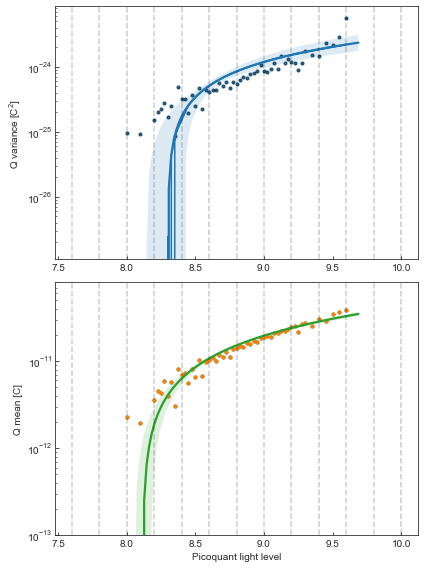

In [204]:
plot_pico_gain_integral_all(df_pico, title="picoquant test",ylog=True,   ylim=[1e-13, 8e-11], 
                            outfile="picotest_peak_gain_integral_Feb14_only_integrate_all_subBaseline_v3_log.png")




/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


Flare exponential fit param 0 (slope) = 1.294e-24 +/- 8.228e-26
Flare exponential fit param 1 (inter) = -1.065e-23 +/- 7.251e-25
1.2939747851498088e-24 8.228274154884878e-26
Flare exponential fit param 0 (slope) = 2.179e-11 +/- 5.981e-13
Flare exponential fit param 1 (inter) = -1.769e-10 +/- 5.271e-12
2.1790425016259882e-11 5.980806221686512e-13
gain 370678.67395182844


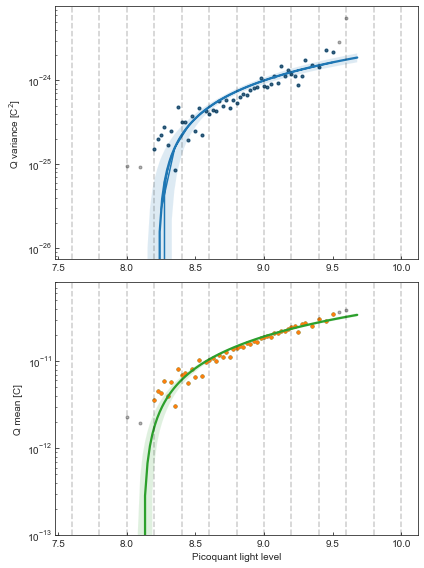

In [210]:
plot_pico_gain_integral_all(df_pico, title="picoquant test",  
                                                    fit_range=[8.2,9.5],  ylog=True, ylim=[1e-13, 8e-11], 
                            outfile="picotest_peak_gain_integral_Feb14_only_integrate_all_cut_sub_baseline_v3_logo.png")



/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


Flare exponential fit param 0 (slope) = 1.114e-24 +/- 6.255e-26
Flare exponential fit param 1 (inter) = -9.088e-24 +/- 5.485e-25
1.1136721644077296e-24 6.25455606769075e-26
Flare exponential fit param 0 (slope) = 2.099e-11 +/- 5.76e-13
Flare exponential fit param 1 (inter) = -1.7e-10 +/- 5.052e-12
2.099018165875585e-11 5.760356726073945e-13
gain 331191.09871977154


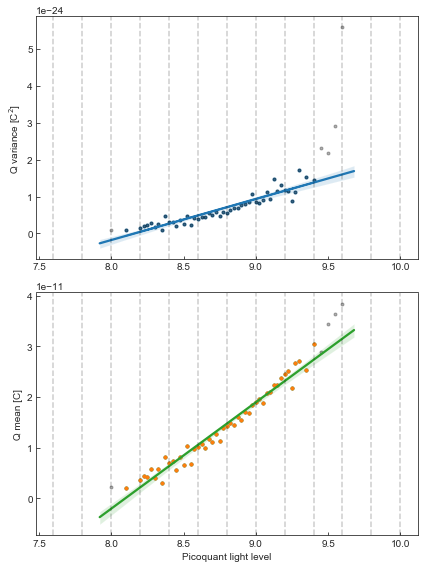

In [241]:
plot_pico_gain_integral_all(df_pico, title="picoquant test",  
                                                    fit_range=[8.1,9.4],  ylog=False, #ylim=[1e-13, 8e-11], 
                            outfile="picotest_peak_gain_integral_Feb14_only_integrate_all_cut_sub_baseline_v4.png")




In [192]:
1.6e-19*4.25e5/1e-8*50

0.00034

In [334]:
df_pico.pot_value_ohm.unique()

array(['8p1', '8p3', '8p25', '8p35', '8p45', '8p5', '8p55', '8p65', '8p7',
       '8p75', '8p85', '8p9', '8p95', '9p05', '9p1', '9p15', '9p25',
       '9p3', '9p35', '9p4', '9p45', '9p5', '9p55', '9p6', '9p225',
       '9p275', '9p2', '9p175', '9p125'], dtype=object)

In [286]:
1.2 % 0.2

0.1999999999999999

[1.81752672e-13]
[-9.82099784e-25]
Flare exponential fit param 0 (slope) = 1.818e-13 +/- 1.448e-14
Flare exponential fit param 1 (inter) = -9.821e-25 +/- 2.025e-25
1.8175267197676648e-13 1.448070360222478e-14
fit Chisq is 0.000, dof is 51, reduced Chisq is 0.00
Log likelihood lnL=-1.1196422781767947e-47


(1134536.0298175185, 90391.4082535879)

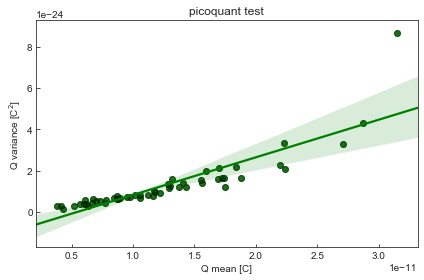

In [31]:
from sklearn import linear_model

def lin_func(x, a, b):
    return a*x+b
def chisq(y_vals, y_expected, y_errs, num_params=1):
    #returns chi2, dof, red_chi2
    #  for reduced chisq test, under the assumption of Poisson counting
    #  we have lnL = const - (1/2.)*chi2
    if y_vals.shape[0] != y_expected.shape[0]:
        print("Inconsistent input sizes")
        return
    #z = (y_vals[i] - y_expected[i]) / y_errs[i]    
    z = (y_vals - y_expected) / y_errs
    chi2 = np.sum(z ** 2)
    chi2dof = chi2 / (y_vals.shape[0] - num_params)
    return chi2, (y_vals.shape[0] - num_params), chi2dof



def plot_pico_var_mean(df_flasher35, title="pot 3.5k", outfile="flasher_level_3p5k_Feb8.png", 
                 show_label=True, ylim=None, int_window_all=False, fit_range=[-1e2,1e5], 
                 sub_baseline=True, allTs=2.e-7,
                 bins=None):
    Rterm=50 #50 ohm terminator
    e = 1.602e-19
    N=len(df_flasher35.pot_value_ohm.unique())
    pico_vals = np.zeros(N, dtype=float)
    mus = np.zeros(N, dtype=float)
    sts = np.zeros(N, dtype=float)
    for ii, i in enumerate(df_flasher35.pot_value_ohm.unique()):
    #for ii, i in enumerate([4,5,3,2,1,6,7,8,9,10]):
        pico_vals[ii] = float('.'.join(i.split('p')))
        this_slice=df_flasher35[df_flasher35.pot_value_ohm==i]
        if int_window_all:
            mus[ii]=-np.mean(this_slice.integrated_charge_all/Rterm-this_slice.fit_baseline_V*allTs/Rterm)
            sts[ii]=np.std(this_slice.integrated_charge_all/Rterm-this_slice.fit_baseline_V*allTs/Rterm)
        else:
            mus[ii]=-np.mean(this_slice.integrated_charge_window/Rterm-this_slice.fit_baseline_V*allTs/Rterm)
            sts[ii]=np.std(this_slice.integrated_charge_window/Rterm-this_slice.fit_baseline_V*allTs/Rterm)
        
    #fig, axes = plt.subplots(2, figsize=(6,8))
    #ax = axes[0]
    fig, ax = plt.subplots()
    ax.plot(mus, sts**2, marker='o', ls="", color='k', alpha=0.3)  
                     #label="pico {}".format(i))
        
    fit_ind = np.where((mus<=fit_range[1]) & (mus>=fit_range[0]))
    mus=mus[fit_ind]
    sts=sts[fit_ind]

    p = sns.regplot(x=mus, y=sts**2, color="g")
    ax.set_ylabel(r"Q variance [C$^2$]")            
    ax.set_xlabel(r"Q mean [C]")
    
    regr = linear_model.LinearRegression()
    #X = df.x.values.reshape(-1,1)
    #y = df.y.values.reshape(-1,1)
    regr.fit(mus.reshape(-1,1), (sts**2).reshape(-1,1))
    print(regr.coef_[0])
    print(regr.intercept_)
    #gain = regr.coef_[0]/e
    
    parLCL3, covLCL3 = curve_fit(lin_func, mus,
                        sts**2, p0=[1.3911252e-13, -6.50953251e-25], 
                        ) #, 
                        #method='trf', ftol=1e-10, loss='soft_l1') #approx abs

    #min_of_mjd((start_mjd+end_mjd)/2., mjd0=57666.165), f_runwise/plot_f_unit, xerr=15, yerr=df_runwise/plot_f_unit,
    par_names8=['slope', 'inter']
    for i in range(len(par_names8)):
        print("Flare exponential fit param %d (%s) = %.4g +/- %.4g" % (i, par_names8[i], 
                                                                                            parLCL3[i], 
                                                                                            np.sqrt(abs(covLCL3[i,i]))))

    gain = parLCL3[0]/e

    d_gain = np.sqrt(abs(covLCL3[0,0]))/e
    print(parLCL3[0], np.sqrt(abs(covLCL3[0,0])))
            
    chi2LC3L1, dof3L1, redchi2LC3L1 = chisq(sts**2, 
                                      lin_func(mus, *parLCL3), 
                                      1, 
                                      2)
    lnL_LC3L1 = -0.5*chi2LC3L1
    print("fit Chisq is %.3f, dof is %d, reduced Chisq is %.2f" % (chi2LC3L1, dof3L1, redchi2LC3L1))
    print("Log likelihood lnL={0}".format(lnL_LC3L1))

    #plt.plot(mus, regr.intercept_+regr.coef_[0]*mus)
    #plt.plot(mus, lin_func(mus, *parLCL3))



    #plt.legend(ncol=2)
    if ylim is not None:
        plt.ylim(ylim)
    plt.title(title)
    plt.tight_layout()
    plt.savefig(outfile)
    return gain, d_gain
    

#df_pico = pd.read_csv("flasher_fwhm_picotest.csv")

gain, d_gain = plot_pico_var_mean(df_pico, title="picoquant test",  sub_baseline=False, outfile="picotest_variance_vs_mean_Feb14_only2.png")

gain, d_gain



[1.81752672e-13]
[-9.82099784e-25]
Flare exponential fit param 0 (slope) = 1.818e-13 +/- 1.448e-14
Flare exponential fit param 1 (inter) = -9.821e-25 +/- 2.025e-25
1.8175267197676648e-13 1.448070360222478e-14
fit Chisq is 0.000, dof is 51, reduced Chisq is 0.00
Log likelihood lnL=-1.1196422781767947e-47


/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


(1134536.0298175185, 90391.4082535879)

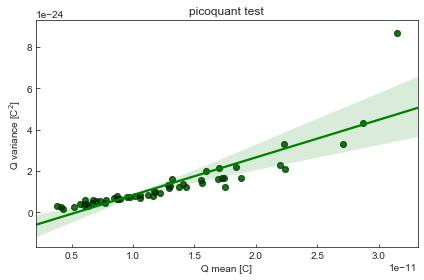

In [76]:
gain, d_gain = plot_pico_var_mean(df_pico, title="picoquant test",  
                                  sub_baseline=True, outfile="picotest_variance_vs_mean_Feb14_only_sub_base.png")

gain, d_gain

[1.41458147e-13]
[-5.83279339e-25]
Flare exponential fit param 0 (slope) = 1.415e-13 +/- 6.834e-15
Flare exponential fit param 1 (inter) = -5.833e-25 +/- 9.424e-26
1.4145814615308077e-13 6.833887471454103e-15
fit Chisq is 0.000, dof is 47, reduced Chisq is 0.00
Log likelihood lnL=-1.6679882509034878e-48


/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


(883009.6513925142, 42658.47360458242)

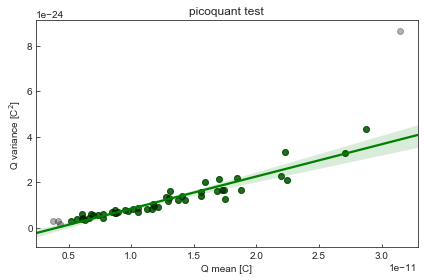

In [85]:
gain, d_gain = plot_pico_var_mean(df_pico, title="picoquant test",  
                                  fit_range=[0.5e-11, 3.0e-11],sub_baseline=False, 
                                  outfile="picotest_variance_vs_mean_Feb14_only_cut2.png")

gain, d_gain




[8.12725176e-14]
[-3.88037328e-25]
Flare exponential fit param 0 (slope) = 8.127e-14 +/- 7.084e-15
Flare exponential fit param 1 (inter) = -3.88e-25 +/- 1.264e-25
8.127251761563688e-14 7.083678088257743e-15
fit Chisq is 0.000, dof is 51, reduced Chisq is 0.00
Log likelihood lnL=-5.749166228209456e-48


/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


(507319.0862399306, 44217.715906727484)

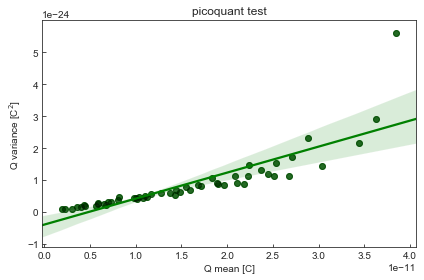

In [77]:
gain, d_gain = plot_pico_var_mean(df_pico, title="picoquant test",  
                                  int_window_all=True, sub_baseline=False, 
                                  outfile="picotest_variance_vs_mean_Feb14_only_integrate_all2.png")

gain, d_gain



[8.12725176e-14]
[-3.88037328e-25]
Flare exponential fit param 0 (slope) = 8.127e-14 +/- 7.084e-15
Flare exponential fit param 1 (inter) = -3.88e-25 +/- 1.264e-25
8.127251761563688e-14 7.083678088257743e-15
fit Chisq is 0.000, dof is 51, reduced Chisq is 0.00
Log likelihood lnL=-5.749166228209456e-48


/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


(507319.0862399306, 44217.715906727484)

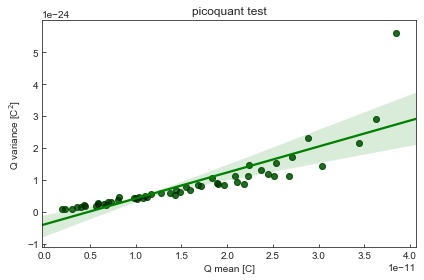

In [86]:
gain, d_gain = plot_pico_var_mean(df_pico, title="picoquant test",  
                                  int_window_all=True, sub_baseline=True, 
                                  outfile="picotest_variance_vs_mean_Feb14_only_integrate_all2.png")

gain, d_gain



[6.83872485e-14]
[-3.31682512e-25]
Flare exponential fit param 0 (slope) = 6.839e-14 +/- 5.358e-15
Flare exponential fit param 1 (inter) = -3.317e-25 +/- 1.079e-25
6.838724850274765e-14 5.3583835420556274e-15
fit Chisq is 0.000, dof is 31, reduced Chisq is 0.00
Log likelihood lnL=-5.848981306217367e-49


/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


(426886.6947737057, 33448.087029061346)

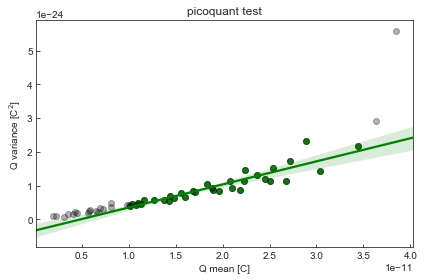

In [87]:
gain, d_gain = plot_pico_var_mean(df_pico, title="picoquant test",  
                                  fit_range=[1e-11, 3.5e-11],sub_baseline=False,
                                  int_window_all=True, outfile="picotest_variance_vs_mean_Feb14_only_integrate_all_cut2.png")


gain, d_gain





[6.80273597e-14]
[-2.71458839e-25]
Flare exponential fit param 0 (slope) = 6.803e-14 +/- 3.914e-15
Flare exponential fit param 1 (inter) = -2.715e-25 +/- 7.221e-26
6.802735944210868e-14 3.9141375966867335e-15
fit Chisq is 0.000, dof is 43, reduced Chisq is 0.00
Log likelihood lnL=-9.479914911001066e-49


/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


(424640.19626784447, 24432.818955597588)

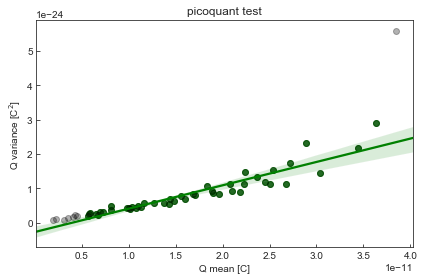

In [88]:
gain, d_gain = plot_pico_var_mean(df_pico, title="picoquant test",  
                                  fit_range=[0.5e-11, 3.7e-11],sub_baseline=True,
                                  int_window_all=True, 
                                  outfile="picotest_variance_vs_mean_Feb14_only_integrate_all_cut_sub_base.png")


gain, d_gain






[6.02184749e-14]
[-1.51805557e-25]
Flare exponential fit param 0 (slope) = 6.022e-14 +/- 3.013e-15
Flare exponential fit param 1 (inter) = -1.518e-25 +/- 5.106e-26
6.021847491705598e-14 3.013123720966451e-15
fit Chisq is 0.000, dof is 47, reduced Chisq is 0.00
Log likelihood lnL=-6.744556837391048e-49


/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


(375895.5987331834, 18808.51261527123)

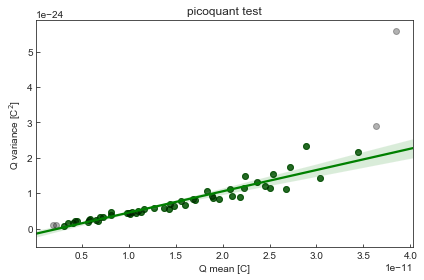

In [244]:
gain, d_gain = plot_pico_var_mean(df_pico, title="picoquant test",  
                                  fit_range=[0.3e-11, 3.5e-11],sub_baseline=True,
                                  int_window_all=True, 
                                  outfile="picotest_variance_vs_mean_Feb14_only_integrate_all_cut_sub_base_v4.pdf")


gain, d_gain







[1.69767575e-13]
[-2.45078428e-24]
Flare exponential fit param 0 (slope) = 1.698e-13 +/- 1.604e-14
Flare exponential fit param 1 (inter) = -2.451e-24 +/- 5.292e-25
1.6976757511948477e-13 1.6038307234492153e-14
fit Chisq is 0.000, dof is 6, reduced Chisq is 0.00
Log likelihood lnL=-9.84054923189108e-49


/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


(1059722.6911328638, 100114.27736886487)

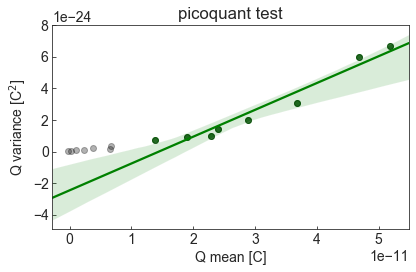

In [467]:
gain, d_gain = plot_pico_var_mean(df_pico2, title="picoquant test",  
                                  fit_range=[1e-11, 4.5e-10],
                                  int_window_all=False, 
                                  outfile="picotest_variance_vs_mean_Feb14_only_integrate_all_cut_pico_close_sub_base.png")


gain, d_gain





[1.36182394e-13]
[-6.92285712e-25]
Flare exponential fit param 0 (slope) = 1.362e-13 +/- 1.217e-14
Flare exponential fit param 1 (inter) = -6.923e-25 +/- 3.317e-25
1.3618239440142218e-13 1.2167945210802186e-14
fit Chisq is 0.000, dof is 15, reduced Chisq is 0.00
Log likelihood lnL=-6.399396175398685e-48


/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


(850077.3682985154, 75954.71417479517)

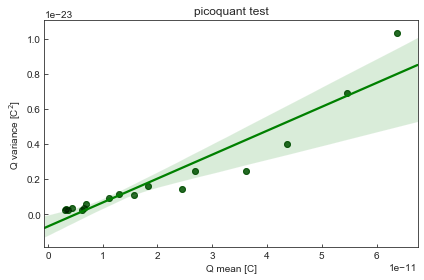

In [91]:
df_pico2 = pd.read_csv("flasher_fwhm_picotest2.csv")


gain, d_gain = plot_pico_var_mean(df_pico2, title="picoquant test",  
                                  fit_range=[0e-11, 4.5e-10],
                                  int_window_all=False, 
                                  outfile="picotest_variance_vs_mean_Feb14_only_integrate_all_cut_pico_close_sub_base.png")


gain, d_gain






In [159]:
p.get_children()

 Text(0.5,1,'picoquant test'),
 Text(0,1,''),
 Text(1,1,''),

/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


Flare exponential fit param 0 (slope) = 3.554e-24 +/- 4.641e-25
Flare exponential fit param 1 (inter) = -2.938e-23 +/- 4.05e-24
3.553975108925275e-24 4.641174100530184e-25
Flare exponential fit param 0 (slope) = 2.847e-11 +/- 2.2e-12
Flare exponential fit param 1 (inter) = -2.312e-10 +/- 1.92e-11
2.8472152275086455e-11 2.2002817349630974e-12
gain 779168.8330887159


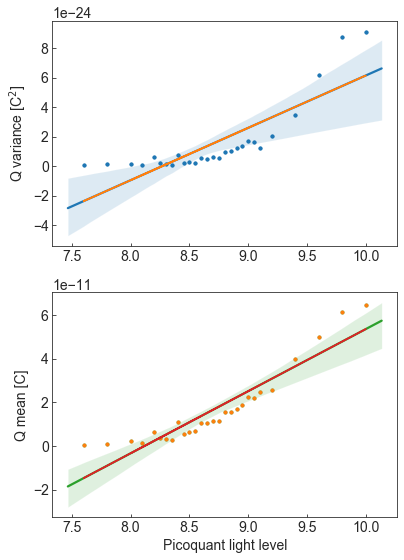

In [283]:
df_pico = pd.read_csv("flasher_fwhm_picotest.csv")

plot_pico_gain_integral(df_pico, title="picoquant test",  outfile="picotest_peak_gain_integral_Feb14_v2.png")



/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


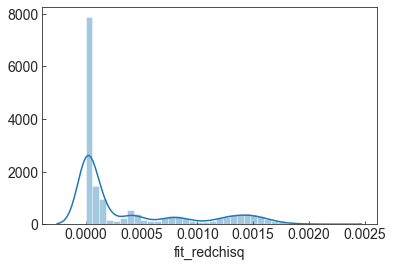

In [131]:
sns.distplot(df_pico.fit_redchisq)
sns.distplot(df_pico.fit_redchisq)


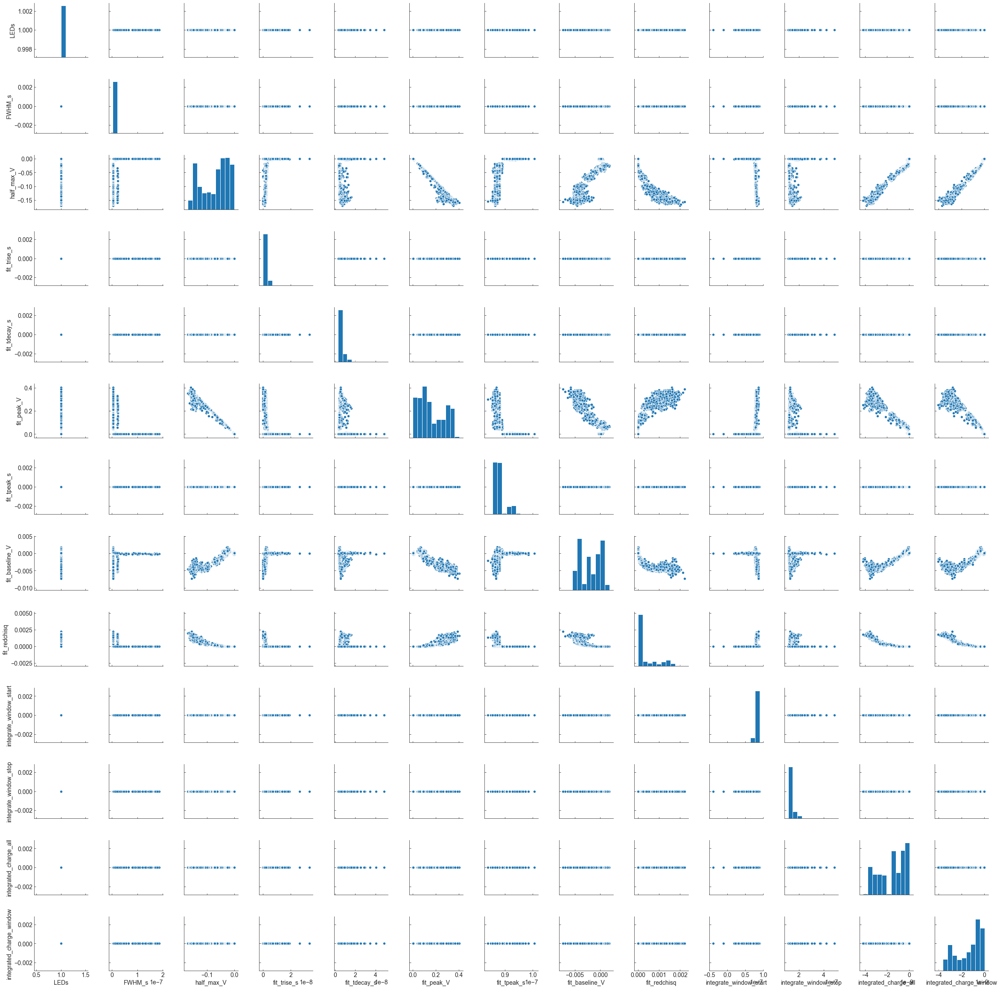

In [190]:
sns.pairplot(df_pico)
plt.savefig("pico_cornerplot.png")

In [130]:
df_pico.head()

,LEDs,pot_value_ohm,FWHM_s,half_max_V,fit_trise_s,fit_tdecay_s,fit_peak_V,fit_tpeak_s,fit_baseline_V,fit_redchisq,integrate_window_start,integrate_window_stop,integrated_charge_all,integrated_charge_window
0,1,8p6,6.000000e-09,-0.0321,2.263454e-09,4.060063e-09,0.079528,8.806771e-08,-0.000274,0.000003,7.883865e-08,1.211769e-07,-5.559000e-10,-5.154000e-10
1,1,8p6,5.000000e-09,-0.0312,2.620083e-09,3.965418e-09,0.073212,8.790041e-08,-0.000635,0.000004,7.721722e-08,1.202378e-07,-6.108000e-10,-5.247000e-10
2,1,8p6,6.000000e-09,-0.0342,2.128576e-09,4.174980e-09,0.085888,8.813076e-08,-0.000494,0.000003,7.945165e-08,1.221771e-07,-6.378000e-10,-5.583000e-10
3,1,8p6,5.000000e-09,-0.0330,2.921735e-09,3.732963e-09,0.079412,8.787318e-08,-0.000022,0.000005,7.596003e-08,1.183149e-07,-5.349000e-10,-5.187000e-10
4,1,8p6,5.000000e-09,-0.0291,2.040037e-09,4.252402e-09,0.072516,8.710376e-08,-0.000368,0.000002,7.878567e-08,1.217814e-07,-5.283000e-10,-4.704000e-10


In [125]:
df_pico1.pot_value_ohm.unique()

array(['8', '8p2', '8p4', '8p6'], dtype=object)

In [191]:
df_flasher4new = pd.read_csv("flasher_fwhm_pot4p1k_diffuser_new_setup.csv")
df_flasher4new.head()


,LEDs,pot_value_ohm,FWHM_s,half_max_V,fit_trise_s,fit_tdecay_s,fit_peak_V,fit_tpeak_s,fit_baseline_V
0,1,4p1k_diffuser_new_setup,1.200000e-08,-0.15825,6.738460e-09,7.027495e-09,0.379165,8.967851e-08,0.000794
1,1,4p1k_diffuser_new_setup,1.200000e-08,-0.18975,6.472716e-09,6.913349e-09,0.459175,8.961248e-08,0.000768
2,1,4p1k_diffuser_new_setup,1.300000e-08,-0.17625,6.234304e-09,7.528803e-09,0.434550,8.863065e-08,0.000932
3,1,4p1k_diffuser_new_setup,1.200000e-08,-0.18975,6.749827e-09,6.648791e-09,0.453360,8.964199e-08,0.001448
4,1,4p1k_diffuser_new_setup,1.300000e-08,-0.19575,6.682114e-09,6.855712e-09,0.474101,8.960865e-08,0.001556


In [204]:
os.path.join(indir,"LED{}_pot4p1k_diffuser_new_setup_trace_{}.csv".format(LED_, index))



'./flasher_data/pot_4p1k_diffuser_new_setup/LED2_pot4p1k_diffuser_new_setup_trace_50.csv'

In [36]:
def fill_in_integrals(df, 
                      indir="./flasher_data/pot_4p1k_diffuser_new_setup/", 
                      file_str="_pot4p1k_diffuser_new_setup_trace_"):
    df["integrate_window_start"] = np.nan
    df["integrate_window_stop"] = np.nan
    df["integrated_charge_all"] = np.nan
    df["integrated_charge_window"] = np.nan

    itrace=0
    LED_=1
    for index, row in df.iterrows():
        if LED_ != row['LEDs']:
            LED_ = row['LEDs']
            itrace=0
        f_ = os.path.join(indir,"LED{}{}{}.csv".format(LED_, file_str, itrace))
        itrace = itrace+1
        if not os.path.exists(f_):
            print("Not Found {}".format(f_))
            continue
        df_trace_ = pd.read_csv(f_)
        # integrate charge:
        start_window = row['fit_tpeak_s'] - 1.5 * np.e * row['fit_trise_s']
        stop_window = row['fit_tpeak_s'] + 3 * np.e * row['fit_tdecay_s']

        ts = df_trace_['T'].values
        vs = df_trace_['V'].values

        charge_all = np.trapz(vs, ts)
        #print("integral all = {}".format(np.trapz(vs, ts)))

        int_slice = np.where((ts >= start_window) & (ts <= stop_window))
        charge_window=np.trapz(vs[int_slice], ts[int_slice])
        #print("integral window = {}".format(np.trapz(vs[int_slice], ts[int_slice])))

        df.loc[index, 'integrate_window_start'] = start_window
        df.loc[index, 'integrate_window_stop'] = stop_window
        df.loc[index, 'integrated_charge_all'] = charge_all
        df.loc[index, 'integrated_charge_window'] = charge_window

    return df


In [229]:
df.to_csv("flasher_fwhm_pot4p1k_diffuser_new_setup.csv", index=False)



In [192]:
df_pico.head()

,LEDs,pot_value_ohm,FWHM_s,half_max_V,fit_trise_s,fit_tdecay_s,fit_peak_V,fit_tpeak_s,fit_baseline_V,fit_redchisq,integrate_window_start,integrate_window_stop,integrated_charge_all,integrated_charge_window
0,1,8p6,6.000000e-09,-0.0321,2.263454e-09,4.060063e-09,0.079528,8.806771e-08,-0.000274,0.000003,7.883865e-08,1.211769e-07,-5.559000e-10,-5.154000e-10
1,1,8p6,5.000000e-09,-0.0312,2.620083e-09,3.965418e-09,0.073212,8.790041e-08,-0.000635,0.000004,7.721722e-08,1.202378e-07,-6.108000e-10,-5.247000e-10
2,1,8p6,6.000000e-09,-0.0342,2.128576e-09,4.174980e-09,0.085888,8.813076e-08,-0.000494,0.000003,7.945165e-08,1.221771e-07,-6.378000e-10,-5.583000e-10
3,1,8p6,5.000000e-09,-0.0330,2.921735e-09,3.732963e-09,0.079412,8.787318e-08,-0.000022,0.000005,7.596003e-08,1.183149e-07,-5.349000e-10,-5.187000e-10
4,1,8p6,5.000000e-09,-0.0291,2.040037e-09,4.252402e-09,0.072516,8.710376e-08,-0.000368,0.000002,7.878567e-08,1.217814e-07,-5.283000e-10,-4.704000e-10


In [34]:
df_new2 = pd.read_csv("flasher_fwhm_pot4p1k_diffuser_new_setup_DC_power_source.csv")


In [37]:
df_new2_fill = fill_in_integrals(df_new2, 
                      indir="./flasher_data/pot_4p1k_diffuser_new_setup_DC_power_source/", 
                      file_str="_pot4p1k_diffuser_new_setup_DC_power_source_trace_")

In [248]:
df_new2_fill.head()

,LEDs,pot_value_ohm,FWHM_s,half_max_V,fit_trise_s,fit_tdecay_s,fit_peak_V,fit_tpeak_s,fit_baseline_V,integrate_window_start,integrate_window_stop,integrated_charge_all,integrated_charge_window
0,1,4p1k_diffuser_new_setup_DC_power_source,1.200000e-08,-0.15975,7.030802e-09,6.576823e-09,0.379697,9.053782e-08,0.000851,6.220296e-08,1.469866e-07,-4.953000e-09,-4.831500e-09
1,1,4p1k_diffuser_new_setup_DC_power_source,1.300000e-08,-0.15675,6.928541e-09,7.053629e-09,0.376032,8.961635e-08,0.001108,6.322048e-08,1.459898e-07,-5.140500e-09,-5.011500e-09
2,1,4p1k_diffuser_new_setup_DC_power_source,1.300000e-08,-0.15225,6.922821e-09,6.600777e-09,0.368120,8.955330e-08,0.000676,6.321075e-08,1.500269e-07,-5.130000e-09,-4.953000e-09
3,1,4p1k_diffuser_new_setup_DC_power_source,1.300000e-08,-0.15225,6.893243e-09,7.116398e-09,0.369395,8.966291e-08,0.001108,6.212010e-08,1.438619e-07,-4.843500e-09,-4.669500e-09
4,1,4p1k_diffuser_new_setup_DC_power_source,1.300000e-08,-0.15825,6.806621e-09,6.949610e-09,0.379092,8.969999e-08,0.000805,6.236285e-08,1.455159e-07,-5.055000e-09,-4.965000e-09


In [38]:
df_concat4 = pd.concat(dfs4)

###
(53,) (307,) (260,)
[1.31096320e-12 3.36608160e-12 3.66154560e-12 2.65154800e-12
 5.32204160e-12 6.34639680e-12 6.88728000e-12 1.02448080e-11
 1.13665552e-11 1.15825024e-11 1.54600480e-11 1.67896160e-11
 1.88536400e-11 2.18224400e-11 2.47346880e-11 2.65273920e-11
 2.62609680e-11 3.29574560e-11 3.16665720e-11 3.81108800e-11
 3.60652480e-11 4.32971640e-11 4.58486640e-11 4.84856800e-11
 3.08911040e-11 3.32142369e-11 2.99203560e-11 2.90341120e-11
 2.66030400e-11 2.45406000e-11 2.29692960e-11 2.20734960e-11
 2.13262994e-11 1.94043600e-11 1.80337000e-11 1.59963520e-11
 1.53934661e-11 1.47680640e-11 1.36464000e-11 1.23920835e-11
 1.13206016e-11 1.05533120e-11 1.01220560e-11 1.06764896e-11
 8.31039360e-12 7.14291200e-12 6.79452000e-12 7.31626028e-12
 5.15201280e-12 5.16796800e-12 3.91690880e-12 3.01540509e-12
 1.78180000e-12] [ 1.31096320e-12  3.36608160e-12  3.66154560e-12  2.65154800e-12
  5.32204160e-12  6.34639680e-12  6.88728000e-12  1.02448080e-11
  1.13665552e-11  1.15825024e-11  1.

(392965.7258494325, 5970.820961932112)

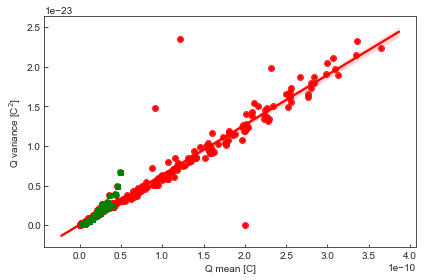

In [45]:
from sklearn import linear_model

def lin_func(x, a, b):
    return a*x+b
def chisq(y_vals, y_expected, y_errs, num_params=1):
    #returns chi2, dof, red_chi2
    #  for reduced chisq test, under the assumption of Poisson counting
    #  we have lnL = const - (1/2.)*chi2
    if y_vals.shape[0] != y_expected.shape[0]:
        print("Inconsistent input sizes")
        return
    #z = (y_vals[i] - y_expected[i]) / y_errs[i]    
    z = (y_vals - y_expected) / y_errs
    chi2 = np.sum(z ** 2)
    chi2dof = chi2 / (y_vals.shape[0] - num_params)
    return chi2, (y_vals.shape[0] - num_params), chi2dof



def plot_pico_LED_var_mean(df_flasher35, df_pico, title="pot 3.5k", outfile="flasher_level_3p5k_Feb8.png", 
                 show_label=True, ylim=None, cut_std=1e-11, all_data_duration_s=2e-7, 
                 bins=None):
    Rterm=50 #50 ohm terminator
    e = 1.602e-19
    N=len(df_pico.pot_value_ohm.unique())

    pico_vals = np.zeros(N, dtype=float)
    mus = np.zeros(N, dtype=float)
    sts = np.zeros(N, dtype=float)
    for ii, i in enumerate(df_pico.pot_value_ohm.unique()):
    #for ii, i in enumerate([4,5,3,2,1,6,7,8,9,10]):
        pico_vals[ii] = float('.'.join(i.split('p')))
        this_slice=df_pico[df_pico.pot_value_ohm==i]
        if np.std(this_slice.integrated_charge_window/Rterm) > cut_std:
                print("Cutting this slice {}".format(this_slice.head()))
                continue

        mus[ii]=-np.mean(this_slice.integrated_charge_window)/Rterm
        sts[ii]=np.std(this_slice.integrated_charge_window/Rterm)
        
    N_flash=len(df_flasher35.pot_value_ohm.unique())*len(df_flasher35.LEDs.unique())
    #flash_vals = np.zeros(N_flash, dtype=float)
    musf = np.zeros(N_flash, dtype=float)
    stsf = np.zeros(N_flash, dtype=float)
    iiii=0
    for ii, i in enumerate(df_flasher35.pot_value_ohm.unique()):
        #for jj, j in enumerate([4,5,3,2,1,6,7,8,9,10]):
        for jj, j in enumerate(df_flasher35.LEDs.unique()):
            #flash_vals[ii] = float('.'.join(i.split('p')))
            #flash_vals[iiii] = float('.'.join(i.split('p')[0:1]))

            this_slice=df_flasher35[(df_flasher35.pot_value_ohm==i) & (df_flasher35.LEDs==j) ]
            if np.std(this_slice.integrated_charge_window/Rterm) > cut_std:
                print("Cutting this slice {}".format(this_slice.head()))
                continue
            musf[iiii]=-np.mean(this_slice.integrated_charge_window-this_slice.fit_baseline_V * all_data_duration_s)/Rterm
            
            stsf[iiii]=np.std(this_slice.integrated_charge_window-this_slice.fit_baseline_V * all_data_duration_s)/Rterm
            iiii = iiii+1


    #mus_all = np.concatenate([mus, musf])
    #sts_all = np.concatenate([sts, stsf])
    mus_all = np.concatenate([mus, musf[~np.isnan(musf)]])
    sts_all = np.concatenate([sts, stsf[~np.isnan(stsf)]])

    
    print("###")
    print(mus.shape, mus_all.shape, musf.shape)
    print(mus, mus_all)
    #fig, axes = plt.subplots(2, figsize=(6,8))
    #ax = axes[0]
    fig, ax = plt.subplots()
    ax.plot(mus_all, sts_all**2, marker='.', ls="", color='r')  
    #                 #label="pico {}".format(i))
    p = sns.regplot(x=mus_all, y=sts_all**2, color="r")
    ax.set_ylabel(r"Q variance [C$^2$]")            
    ax.set_xlabel(r"Q mean [C]")
    
    regr = linear_model.LinearRegression()
    #X = df.x.values.reshape(-1,1)
    #y = df.y.values.reshape(-1,1)
    regr.fit(mus_all.reshape(-1,1), (sts_all**2).reshape(-1,1))
    print(regr.coef_[0])
    print(regr.intercept_)
    #gain = regr.coef_[0]/e
    
    parLCL3, covLCL3 = curve_fit(lin_func, mus_all,
                        sts_all**2, p0=[6.29e-14, 6.44e-25], #method='trf', loss='soft_l1'
                        ) #, 
                        #method='trf', ftol=1e-10, loss='soft_l1') #approx abs

    #min_of_mjd((start_mjd+end_mjd)/2., mjd0=57666.165), f_runwise/plot_f_unit, xerr=15, yerr=df_runwise/plot_f_unit,
    par_names8=['slope', 'inter']
    for i in range(len(par_names8)):
        print("Flare exponential fit param %d (%s) = %.4g +/- %.4g" % (i, par_names8[i], 
                                                                                            parLCL3[i], 
                                                                                            np.sqrt(abs(covLCL3[i,i]))))

    gain = parLCL3[0]/e

    d_gain = np.sqrt(abs(covLCL3[0,0]))/e
    print(parLCL3[0], np.sqrt(abs(covLCL3[0,0])))
            
    chi2LC3L1, dof3L1, redchi2LC3L1 = chisq(sts**2, 
                                      lin_func(mus, *parLCL3), 
                                      1, 
                                      2)
    lnL_LC3L1 = -0.5*chi2LC3L1
    print("fit Chisq is %.3f, dof is %d, reduced Chisq is %.2f" % (chi2LC3L1, dof3L1, redchi2LC3L1))
    print("Log likelihood lnL={0}".format(lnL_LC3L1))

    #plt.plot(mus, regr.intercept_+regr.coef_[0]*mus)
    #plt.plot(mus_all, lin_func(mus_all, *parLCL3))
    #ax.plot(musf, stsf**2, marker='d', color='r',ls="", ms=4)  

    ax.plot(mus, sts**2, marker='s', color='g',ls="", ms=5)
                     #label="pico {}".format(i))


    
    #plt.legend(ncol=2)
    if ylim is not None:
        plt.ylim(ylim)
    plt.title(title)
    plt.tight_layout()
    plt.savefig(outfile)
    return gain, d_gain, mus_all, sts_all
    
gain, d_gain, mus_all, sts_all = plot_pico_LED_var_mean(df_concat4, df_pico, title="",  
                                                        outfile="pico_flash_variance_vs_mean_v4_cut_Feb19_2.pdf")

gain, d_gain




In [57]:
def plot_LED_var_mean(df_flasher35, title="pot 3.5k", outfile="flasher_level_3p5k_Feb8.png", 
                 show_label=True, ylim=None, cut_std=1e-11, all_data_duration_s=2e-7, 
                 bins=None):
    Rterm=50 #50 ohm terminator
    e = 1.602e-19

    N_flash=len(df_flasher35.pot_value_ohm.unique())*len(df_flasher35.LEDs.unique())
    #flash_vals = np.zeros(N_flash, dtype=float)
    musf = np.zeros(N_flash, dtype=float)
    stsf = np.zeros(N_flash, dtype=float)
    iiii=0
    for ii, i in enumerate(df_flasher35.pot_value_ohm.unique()):
        #for jj, j in enumerate([4,5,3,2,1,6,7,8,9,10]):
        for jj, j in enumerate(df_flasher35.LEDs.unique()):
            #flash_vals[ii] = float('.'.join(i.split('p')))
            #flash_vals[iiii] = float('.'.join(i.split('p')[0:1]))
            print("###")
            print("LED {}".format(j))
            this_slice=df_flasher35[(df_flasher35.pot_value_ohm==i) & (df_flasher35.LEDs==j) ]
            if np.std(this_slice.integrated_charge_window/Rterm) > cut_std:
                print("Cutting this slice {}".format(this_slice.head()))
                continue
            musf[iiii]=-np.mean(this_slice.integrated_charge_window-this_slice.fit_baseline_V * all_data_duration_s)/Rterm
            
            stsf[iiii]=np.std(this_slice.integrated_charge_window-this_slice.fit_baseline_V * all_data_duration_s)/Rterm
            iiii = iiii+1


    #mus_all = np.concatenate([mus, musf])
    #sts_all = np.concatenate([sts, stsf])
    mus_all = musf[~np.isnan(musf)]
    sts_all = stsf[~np.isnan(stsf)]

    
    print("###")
    #fig, axes = plt.subplots(2, figsize=(6,8))
    #ax = axes[0]
    fig, ax = plt.subplots()
    ax.plot(mus_all, sts_all**2, marker='.', ls="", color='r')  
    #                 #label="pico {}".format(i))
    p = sns.regplot(x=mus_all, y=sts_all**2, color="r")
    ax.set_ylabel(r"Q variance [C$^2$]")            
    ax.set_xlabel(r"Q mean [C]")
    
    regr = linear_model.LinearRegression()
    #X = df.x.values.reshape(-1,1)
    #y = df.y.values.reshape(-1,1)
    regr.fit(mus_all.reshape(-1,1), (sts_all**2).reshape(-1,1))
    print(regr.coef_[0])
    print(regr.intercept_)
    #gain = regr.coef_[0]/e
    
    parLCL3, covLCL3 = curve_fit(lin_func, mus_all,
                        sts_all**2, p0=[6.29e-14, 6.44e-25], #method='trf', loss='soft_l1'
                        ) #, 
                        #method='trf', ftol=1e-10, loss='soft_l1') #approx abs

    #min_of_mjd((start_mjd+end_mjd)/2., mjd0=57666.165), f_runwise/plot_f_unit, xerr=15, yerr=df_runwise/plot_f_unit,
    par_names8=['slope', 'inter']
    for i in range(len(par_names8)):
        print("Flare exponential fit param %d (%s) = %.4g +/- %.4g" % (i, par_names8[i], 
                                                                                            parLCL3[i], 
                                                                                            np.sqrt(abs(covLCL3[i,i]))))

    gain = parLCL3[0]/e

    d_gain = np.sqrt(abs(covLCL3[0,0]))/e
    print(parLCL3[0], np.sqrt(abs(covLCL3[0,0])))
            
    chi2LC3L1, dof3L1, redchi2LC3L1 = chisq(sts_all**2, 
                                      lin_func(mus_all, *parLCL3), 
                                      1, 
                                      2)
    lnL_LC3L1 = -0.5*chi2LC3L1
    print("fit Chisq is %.3f, dof is %d, reduced Chisq is %.2f" % (chi2LC3L1, dof3L1, redchi2LC3L1))
    print("Log likelihood lnL={0}".format(lnL_LC3L1))

    #plt.plot(mus, regr.intercept_+regr.coef_[0]*mus)
    #plt.plot(mus_all, lin_func(mus_all, *parLCL3))
    #ax.plot(musf, stsf**2, marker='d', color='r',ls="", ms=4)  

    #ax.plot(mus, sts**2, marker='s', color='g',ls="", ms=5)
                     #label="pico {}".format(i))


    
    #plt.legend(ncol=2)
    if ylim is not None:
        plt.ylim(ylim)
    plt.title(title)
    plt.tight_layout()
    plt.savefig(outfile)
    return gain, d_gain, mus_all, sts_all



In [92]:
def plot_LED_var_means(df_flasher35s, title="pot 3.5k", outfile="flasher_level_3p5k_Feb8.png", ms=5, 
                 show_label=True, ylim=None, cut_std=1e-11, all_data_duration_s=2e-7, labels=[],
                 bins=None, cm=plt.cm.jet):
    Rterm=50 #50 ohm terminator
    e = 1.602e-19

    df_all = pd.concat(df_flasher35s)
    N_flash=len(df_all.pot_value_ohm.unique())*len(df_all.LEDs.unique())
    #flash_vals = np.zeros(N_flash, dtype=float)
    musf = np.zeros(N_flash, dtype=float)
    stsf = np.zeros(N_flash, dtype=float)
    iiii=0
    fig, ax = plt.subplots()

    for i_measure,df_flasher35 in enumerate(df_flasher35s):
        iistart = iiii
        for ii, i in enumerate(df_flasher35.pot_value_ohm.unique()):
            #for jj, j in enumerate([4,5,3,2,1,6,7,8,9,10]):
            for jj, j in enumerate(df_flasher35.LEDs.unique()):
                #flash_vals[ii] = float('.'.join(i.split('p')))
                #flash_vals[iiii] = float('.'.join(i.split('p')[0:1]))
                #print("###")
                #print("LED {}".format(j))
                this_slice=df_flasher35[(df_flasher35.pot_value_ohm==i) & (df_flasher35.LEDs==j) ]
                if np.std(this_slice.integrated_charge_window/Rterm) > cut_std:
                    print("Cutting this slice {}".format(this_slice.head()))
                    continue
                musf[iiii]=-np.mean(this_slice.integrated_charge_window-this_slice.fit_baseline_V * all_data_duration_s)/Rterm

                stsf[iiii]=np.std(this_slice.integrated_charge_window-this_slice.fit_baseline_V * all_data_duration_s)/Rterm
                iiii = iiii+1

        print("###")
        #fig, axes = plt.subplots(2, figsize=(6,8))
        #ax = axes[0]
        if i_measure<len(labels):
            label=labels[i_measure]
            print(label)
        else:
            label=None
        ax.plot(musf[iistart:iiii], stsf[iistart:iiii]**2, marker='.', ls="", ms=ms,
                color=cm((0.8+i_measure)*1.0/len(df_flasher35s)),
               label=label)  
        #                 #label="pico {}".format(i))
        p = sns.regplot(x=musf[iistart:iiii], y=stsf[iistart:iiii]**2, scatter_kws={'s':ms},
                        #label=label,
                       color=cm((0.8+i_measure)*1.0/len(df_flasher35s)))
      
    
    mus_all = musf[~np.isnan(musf)]
    sts_all = stsf[~np.isnan(stsf)]


    #ax.plot(mus_all, sts_all**2, marker='.', ls="", color='r')  
    #                 #label="pico {}".format(i))
    #p = sns.regplot(x=mus_all, y=sts_all**2, color="r")

    ax.set_ylabel(r"Q variance [C$^2$]")            
    ax.set_xlabel(r"Q mean [C]")
    
    regr = linear_model.LinearRegression()
    #X = df.x.values.reshape(-1,1)
    #y = df.y.values.reshape(-1,1)
    regr.fit(mus_all.reshape(-1,1), (sts_all**2).reshape(-1,1))
    print(regr.coef_[0])
    print(regr.intercept_)
    #gain = regr.coef_[0]/e
    
    parLCL3, covLCL3 = curve_fit(lin_func, mus_all,
                        sts_all**2, p0=[6.29e-14, 6.44e-25], #method='trf', loss='soft_l1'
                        ) #, 
                        #method='trf', ftol=1e-10, loss='soft_l1') #approx abs

    #min_of_mjd((start_mjd+end_mjd)/2., mjd0=57666.165), f_runwise/plot_f_unit, xerr=15, yerr=df_runwise/plot_f_unit,
    par_names8=['slope', 'inter']
    for i in range(len(par_names8)):
        print("Flare exponential fit param %d (%s) = %.4g +/- %.4g" % (i, par_names8[i], 
                                                                                            parLCL3[i], 
                                                                                            np.sqrt(abs(covLCL3[i,i]))))

    gain = parLCL3[0]/e

    d_gain = np.sqrt(abs(covLCL3[0,0]))/e
    print(parLCL3[0], np.sqrt(abs(covLCL3[0,0])))
            
    chi2LC3L1, dof3L1, redchi2LC3L1 = chisq(sts_all**2, 
                                      lin_func(mus_all, *parLCL3), 
                                      1, 
                                      2)
    lnL_LC3L1 = -0.5*chi2LC3L1
    print("fit Chisq is %.3f, dof is %d, reduced Chisq is %.2f" % (chi2LC3L1, dof3L1, redchi2LC3L1))
    print("Log likelihood lnL={0}".format(lnL_LC3L1))

    #plt.plot(mus, regr.intercept_+regr.coef_[0]*mus)
    #plt.plot(mus_all, lin_func(mus_all, *parLCL3))
    #ax.plot(musf, stsf**2, marker='d', color='r',ls="", ms=4)  

    #ax.plot(mus, sts**2, marker='s', color='g',ls="", ms=5)
                     #label="pico {}".format(i))


    
    plt.legend(ncol=2)
    if ylim is not None:
        plt.ylim(ylim)
    plt.title(title)
    plt.tight_layout()
    plt.savefig(outfile)
    return gain, d_gain, mus_all, sts_all




In [75]:
df_concat7 = pd.concat(dfs6)
df_concat7 = pd.concat([df_concat7, dflong28, dflong4])


Cutting this slice              LEDs    pot_value_ohm        FWHM_s  half_max_V   fit_trise_s  \
24003  1100011111  2p5k_Feb25_long  9.000000e-09     -0.3640  4.342327e-09   
24004  1100011111  2p5k_Feb25_long  9.000000e-09     -0.3640  4.266202e-09   
24005  1100011111  2p5k_Feb25_long  8.000000e-09     -0.3744  3.721723e-09   
24006  1100011111  2p5k_Feb25_long  9.000000e-09     -0.3770  4.185272e-09   
24007  1100011111  2p5k_Feb25_long  9.000000e-09     -0.3666  4.090587e-09   

       fit_tdecay_s  fit_peak_V   fit_tpeak_s  fit_baseline_V  fit_redchisq  \
24003  5.463661e-09    0.880333  8.192671e-08       -0.001684      0.000841   
24004  5.872363e-09    0.881884  8.210319e-08       -0.000297      0.000857   
24005  6.108504e-09    0.906406  8.132533e-08       -0.001629      0.000997   
24006  5.762907e-09    0.910475  8.212898e-08       -0.000861      0.000872   
24007  5.792741e-09    0.895811  8.215649e-08       -0.000526      0.000961   

       integrate_window_start  integr

(1931817.4678609255, 55922.89746149145)

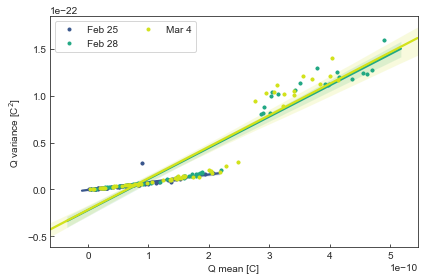

In [94]:
gain, d_gain, mus_all, sts_all = plot_LED_var_means([pd.concat(dfs_long_25),dflong28, dflong4], title="",  
                                                    labels=["Feb 25", "Feb 28", "Mar 4"],cm=plt.cm.viridis,ms=6, 
                                                        outfile="flash_variance_vs_mean_Mar4_Feb28_Feb25_comp.pdf")

gain, d_gain







###
LED 1000000
###
LED 100000
###
LED 1000000000
###
LED 100000000
###
LED 10000000
###
LED 10000
###
LED 1000
###
LED 100
###
LED 10
###
LED 1
###
LED 1100000
###
LED 11000000
###
LED 101000000
###
LED 10100000
###
LED 100100000
###
LED 1001000000
###
LED 110000000
###
LED 1000100000
###
LED 1010000
###
LED 1010000000
###
LED 110000
###
LED 1100000000
###
LED 10010000
###
LED 1100001
###
LED 10000001
###
LED 11100001
###
LED 10100
###
LED 110100
###
LED 11000
###
LED 1110100
###
LED 101
###
LED 1111000
###
LED 11
###
LED 1110010000
###
LED 1001
###
LED 101001
###
LED 1101001
###
LED 10110100
###
LED 101110100
###
LED 10001001
###
LED 100101001
###
LED 110101001
###
LED 1011110100
###
LED 1101110100
###
LED 1101
###
LED 1101101
###
LED 100001101
###
LED 1000001101
###
LED 11101
###
LED 1111
###
LED 11101111
###
LED 1000001111
###
LED 110001111
###
LED 11111
###
LED 1111111
###
LED 10011111
###
LED 1000011111
###
LED 110111111
###
LED 1100011111
###
LED 1011111111
###
LED 1111111111
##

(2090348.191709154, 114798.22697699002)

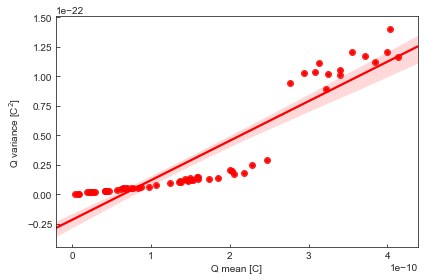

In [58]:
gain, d_gain, mus_all, sts_all = plot_LED_var_mean(dflong4, title="",  
                                                        outfile="flash_variance_vs_mean_Mar4_only.pdf")

gain, d_gain






###
[3.31677589e-13]
[-2.19473833e-23]
Flare exponential fit param 0 (slope) = 3.317e-13 +/- 1.351e-14
Flare exponential fit param 1 (inter) = -2.195e-23 +/- 3.239e-24
3.316775893837348e-13 1.3505141760631902e-14
fit Chisq is 0.000, dof is 59, reduced Chisq is 0.00
Log likelihood lnL=-6.622668680234871e-45


(2070396.937476497, 84301.75880544259)

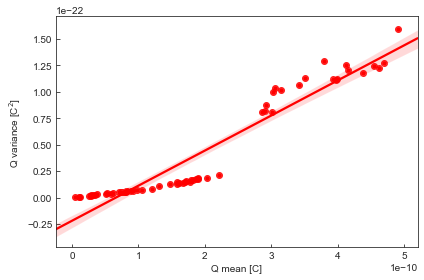

In [54]:
gain, d_gain, mus_all, sts_all = plot_LED_var_mean(dflong28, title="",  
                                                        outfile="flash_variance_vs_mean_Feb28_only.pdf")

gain, d_gain







Cutting this slice              LEDs    pot_value_ohm        FWHM_s  half_max_V   fit_trise_s  \
24003  1100011111  2p5k_Feb25_long  9.000000e-09     -0.3640  4.342327e-09   
24004  1100011111  2p5k_Feb25_long  9.000000e-09     -0.3640  4.266202e-09   
24005  1100011111  2p5k_Feb25_long  8.000000e-09     -0.3744  3.721723e-09   
24006  1100011111  2p5k_Feb25_long  9.000000e-09     -0.3770  4.185272e-09   
24007  1100011111  2p5k_Feb25_long  9.000000e-09     -0.3666  4.090587e-09   

       fit_tdecay_s  fit_peak_V   fit_tpeak_s  fit_baseline_V  fit_redchisq  \
24003  5.463661e-09    0.880333  8.192671e-08       -0.001684      0.000841   
24004  5.872363e-09    0.881884  8.210319e-08       -0.000297      0.000857   
24005  6.108504e-09    0.906406  8.132533e-08       -0.001629      0.000997   
24006  5.762907e-09    0.910475  8.212898e-08       -0.000861      0.000872   
24007  5.792741e-09    0.895811  8.215649e-08       -0.000526      0.000961   

       integrate_window_start  integr

(509605.8714868648, 45644.88646191923)

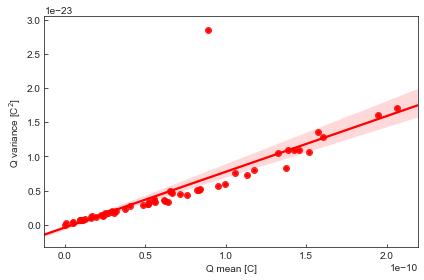

In [56]:
gain, d_gain, mus_all, sts_all = plot_LED_var_mean(pd.concat(dfs_long_25), title="",  
                                                        outfile="flash_variance_vs_mean_Feb25_only.pdf")

gain, d_gain








###
(53,) (449,) (2070,)
[1.31096320e-12 3.36608160e-12 3.66154560e-12 2.65154800e-12
 5.32204160e-12 6.34639680e-12 6.88728000e-12 1.02448080e-11
 1.13665552e-11 1.15825024e-11 1.54600480e-11 1.67896160e-11
 1.88536400e-11 2.18224400e-11 2.47346880e-11 2.65273920e-11
 2.62609680e-11 3.29574560e-11 3.16665720e-11 3.81108800e-11
 3.60652480e-11 4.32971640e-11 4.58486640e-11 4.84856800e-11
 3.08911040e-11 3.32142369e-11 2.99203560e-11 2.90341120e-11
 2.66030400e-11 2.45406000e-11 2.29692960e-11 2.20734960e-11
 2.13262994e-11 1.94043600e-11 1.80337000e-11 1.59963520e-11
 1.53934661e-11 1.47680640e-11 1.36464000e-11 1.23920835e-11
 1.13206016e-11 1.05533120e-11 1.01220560e-11 1.06764896e-11
 8.31039360e-12 7.14291200e-12 6.79452000e-12 7.31626028e-12
 5.15201280e-12 5.16796800e-12 3.91690880e-12 3.01540509e-12
 1.78180000e-12] [ 1.31096320e-12  3.36608160e-12  3.66154560e-12  2.65154800e-12
  5.32204160e-12  6.34639680e-12  6.88728000e-12  1.02448080e-11
  1.13665552e-11  1.15825024e-11  1

(1339010.991824644, 45975.09312018539)

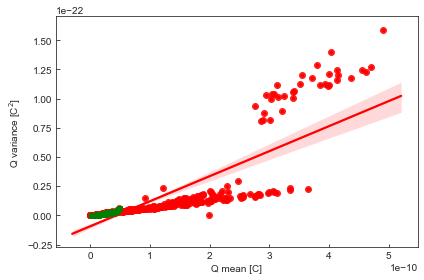

In [46]:
gain, d_gain, mus_all, sts_all = plot_pico_LED_var_mean(df_concat7, df_pico, title="",  
                                                        outfile="pico_flash_variance_vs_mean_Mar4.pdf")

gain, d_gain




Cutting this slice      LEDs                            pot_value_ohm        FWHM_s  half_max_V  \
100     3  4p1k_diffuser_new_setup_DC_power_source  1.200000e-08     -0.1155   
101     3  4p1k_diffuser_new_setup_DC_power_source  1.200000e-08     -0.1175   
102     3  4p1k_diffuser_new_setup_DC_power_source  1.100000e-08     -0.1175   
103     3  4p1k_diffuser_new_setup_DC_power_source  1.200000e-08     -0.1155   
104     3  4p1k_diffuser_new_setup_DC_power_source  1.200000e-08     -0.1185   

      fit_trise_s  fit_tdecay_s  fit_peak_V   fit_tpeak_s  fit_baseline_V  \
100  5.688061e-09  7.285281e-09    0.280427  8.870536e-08       -0.000262   
101  5.995573e-09  6.865510e-09    0.285937  8.956356e-08       -0.000256   
102  6.232361e-09  6.434527e-09    0.283926  8.947773e-08       -0.000139   
103  5.995123e-09  6.880861e-09    0.280118  8.859711e-08       -0.000205   
104  5.810211e-09  6.699226e-09    0.289904  8.855034e-08       -0.000252   

     integrate_window_start  integrat

/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


(281719.5547092992, 28519.100462490234)

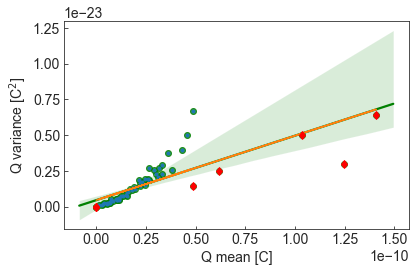

In [415]:
gain, d_gain, mus_all, sts_all = plot_pico_LED_var_mean(df_new2_fill, df_pico, title="",  
                                                        outfile="pico_flash_variance_vs_mean_v3_cut_Feb14.png")

gain, d_gain



###
(13,) (21,) (10,)
[1.03096440e-11 1.08222840e-11 6.55945974e-12 2.02090960e-12
 1.54805840e-11 2.23131360e-11 2.54361240e-11 3.95849120e-11
 4.97488400e-11 6.13139280e-11 6.45919440e-11 8.30763636e-13
 2.94168000e-13] [1.03096440e-11 1.08222840e-11 6.55945974e-12 2.02090960e-12
 1.54805840e-11 2.23131360e-11 2.54361240e-11 3.95849120e-11
 4.97488400e-11 6.13139280e-11 6.45919440e-11 8.30763636e-13
 2.94168000e-13 4.87348000e-11 6.16824000e-11 8.55615588e-11
 9.69732200e-11 1.09974180e-10 1.03499200e-10 1.40904800e-10
 1.24436812e-10]
[2.02731402e-12]
[-1.27032258e-23]
Flare exponential fit param 0 (slope) = 2.027e-12 +/- 1.269e-12
Flare exponential fit param 1 (inter) = -1.27e-23 +/- 8.522e-23
2.0273139289257e-12 1.269187662879303e-12
fit Chisq is 0.000, dof is 11, reduced Chisq is 0.00
Log likelihood lnL=-1.8204590848582439e-44


/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


(12654893.43898689, 7922519.743316498)

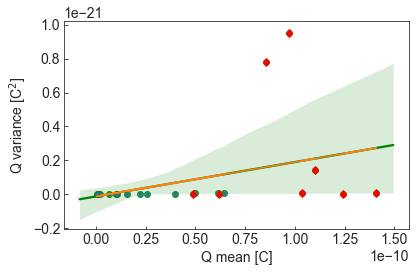

In [271]:
gain, d_gain, mus_all, sts_all = plot_pico_LED_var_mean(df_new2_fill, df_pico, title="",cut_std=1, 
                                                        outfile="pico_flash_variance_vs_mean_v4_nocut.png")

gain, d_gain




Cutting this slice       LEDs pot_value_ohm        FWHM_s  half_max_V   fit_trise_s  \
7693     1           9p6  5.000000e-09      -0.117  1.626785e-09   
7694     1           9p6  5.000000e-09      -0.117  1.450946e-09   
7695     1           9p6  5.000000e-09      -0.129  1.760397e-09   
7696     1           9p6  5.000000e-09      -0.127  1.550043e-09   
7697     1           9p6  5.000000e-09      -0.129  1.883453e-09   

      fit_tdecay_s  fit_peak_V   fit_tpeak_s  fit_baseline_V  fit_redchisq  \
7693  5.270110e-09    0.268020  8.720527e-08       -0.004619      0.000922   
7694  5.809426e-09    0.270162  8.637599e-08       -0.003805      0.000674   
7695  4.592188e-09    0.306344  8.720499e-08       -0.003766      0.000608   
7696  5.068860e-09    0.298681  8.728372e-08       -0.004037      0.000833   
7697  4.401728e-09    0.307552  8.709602e-08       -0.004382      0.000824   

      integrate_window_start  integrate_window_stop  integrated_charge_all  \
7693            8.057218e

[2.9978505e-14]
[3.05098705e-25]
Flare exponential fit param 0 (slope) = 2.998e-14 +/- 4.661e-15
Flare exponential fit param 1 (inter) = 3.051e-25 +/- 1.605e-25
2.9978505003850196e-14 4.661081006407469e-15
fit Chisq is 0.000, dof is 11, reduced Chisq is 0.00
Log likelihood lnL=-2.9221523830543114e-48


/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


(187131.7415970674, 29095.387056226402)

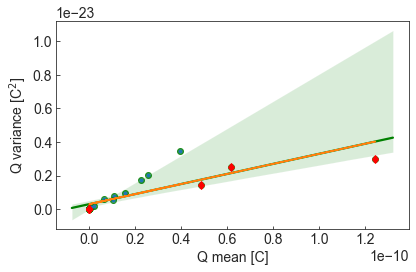

In [275]:
gain, d_gain, mus_all, sts_all = plot_pico_LED_var_mean(df_new2_fill, df_pico, title="",cut_std=2e-12, 
                                                        outfile="pico_flash_variance_vs_mean_v4_cut.png")

gain, d_gain





Cutting this slice      LEDs                            pot_value_ohm        FWHM_s  half_max_V  \
100     3  4p1k_diffuser_new_setup_DC_power_source  1.200000e-08     -0.1155   
101     3  4p1k_diffuser_new_setup_DC_power_source  1.200000e-08     -0.1175   
102     3  4p1k_diffuser_new_setup_DC_power_source  1.100000e-08     -0.1175   
103     3  4p1k_diffuser_new_setup_DC_power_source  1.200000e-08     -0.1155   
104     3  4p1k_diffuser_new_setup_DC_power_source  1.200000e-08     -0.1185   

      fit_trise_s  fit_tdecay_s  fit_peak_V   fit_tpeak_s  fit_baseline_V  \
100  5.688061e-09  7.285281e-09    0.280427  8.870536e-08       -0.000262   
101  5.995573e-09  6.865510e-09    0.285937  8.956356e-08       -0.000256   
102  6.232361e-09  6.434527e-09    0.283926  8.947773e-08       -0.000139   
103  5.995123e-09  6.880861e-09    0.280118  8.859711e-08       -0.000205   
104  5.810211e-09  6.699226e-09    0.289904  8.855034e-08       -0.000252   

     integrate_window_start  integrat

/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


(261752.38762156217, 46889.624182672225)

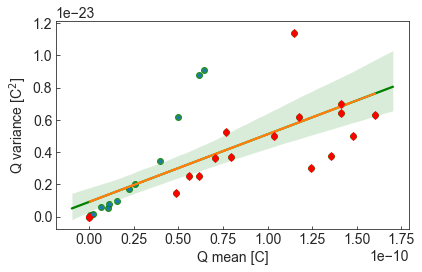

In [277]:
gain, d_gain, mus_all, sts_all = plot_pico_LED_var_mean(df_concat, df_pico, title="",cut_std=10e-12, 
                                                        outfile="pico_flash_variance_vs_mean_v5_cut.png")

gain, d_gain






In [93]:
from newportESP import ESP

In [116]:
esp = ESP('/dev/ttys012')
stage = esp.axis(1) 


SerialException: [Errno 2] could not open port /dev/ttys012: [Errno 2] No such file or directory: '/dev/ttys012'

In [105]:
stage.read()

SerialException: read failed: [Errno 5] Input/output error

In [104]:
stage.move_to(0.2)

TypeError: unicode strings are not supported, please encode to bytes: "1PAb'0.2'\r"

In [114]:
import esp 
#controller = esp.esp("/dev/ttys004",19200,1) # newport controller device, baud rate, default axis 
controller = esp.esp("/dev/tty",19200,1) # newport controller device, baud rate, default axis 

#controller.setpos(20.0,1) # position, axis 
controller.getpos(1) # axis


SerialException: [Errno 2] could not open port /dev/ttys002: [Errno 2] No such file or directory: '/dev/ttys002'

ModuleNotFoundError: No module named 'cv2'

In [4]:
df_pattern25 = pd.read_csv("flasher_patterns_Feb25.csv", sep=r"\s+", header=None, names=['num','pat','npe','dnpe'])
df_pattern25.head()

,num,pat,npe,dnpe
0,0,1000000,8.81,3.65
1,1,100000,39.02,4.25
2,2,1100000,41.08,4.42
3,3,10000000,72.02,5.97
4,4,11000000,72.59,6.34


In [10]:
for i, row in df_pattern25.iterrows():
    assert i==row[0]
    pat=int(row[1])
    npe=row[2]
    dnpe=row[3]
    print("{} & {} & ${:.2f} \pm {:.2f}$ \\\\".format(i, str(pat).zfill(10),npe,dnpe))
    


0 & 0001000000 & $8.81 \pm 3.65$ \\
1 & 0000100000 & $39.02 \pm 4.25$ \\
2 & 0001100000 & $41.08 \pm 4.42$ \\
3 & 0010000000 & $72.02 \pm 5.97$ \\
4 & 0011000000 & $72.59 \pm 6.34$ \\
5 & 0101000000 & $81.73 \pm 6.56$ \\
6 & 0100000000 & $83.25 \pm 6.13$ \\
7 & 0010100000 & $88.05 \pm 6.48$ \\
8 & 0100100000 & $95.97 \pm 6.84$ \\
9 & 1000000000 & $123.06 \pm 8.01$ \\
10 & 1001000000 & $125.57 \pm 7.73$ \\
11 & 0110000000 & $130.44 \pm 8.40$ \\
12 & 1000100000 & $148.39 \pm 8.32$ \\
13 & 0000010000 & $173.98 \pm 9.23$ \\
14 & 0001010000 & $179.26 \pm 8.70$ \\
15 & 1010000000 & $179.76 \pm 9.15$ \\
16 & 1100000000 & $189.74 \pm 9.98$ \\
17 & 0000110000 & $191.13 \pm 9.53$ \\
18 & 0000000100 & $198.63 \pm 9.91$ \\
19 & 0000000010 & $203.08 \pm 9.80$ \\
20 & 0000001000 & $221.04 \pm 10.27$ \\
21 & 0010010000 & $224.55 \pm 10.57$ \\
22 & 0000000001 & $233.72 \pm 10.01$ \\
23 & 0001100001 & $241.78 \pm 10.57$ \\
24 & 0010000001 & $283.39 \pm 11.38$ \\
25 & 0011100001 & $310.46 \pm 12.64$ \\
